In [1]:
import pandas as pd
import os
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from nltk.corpus import stopwords
from nltk.util import ngrams
from sklearn.feature_extraction.text import CountVectorizer
from collections import defaultdict
from collections import  Counter
plt.style.use('ggplot')
stop=set(stopwords.words('english'))
import re
from nltk.tokenize import word_tokenize
import gensim
import string
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from tqdm import tqdm
from keras.models import Sequential
from keras.layers import Embedding,LSTM,Dense,SpatialDropout1D
from keras.initializers import Constant
from sklearn.model_selection import train_test_split
from keras.optimizers import Adam

In [2]:
tweet = pd.read_csv(r'D:\competition\Real or Not\train.csv')
test = pd.read_csv(r'D:\competition\Real or Not\test.csv')
tweet.head(3)

,id,keyword,location,text,target
0,1,NaN,NaN,Our Deeds are the Reason of this #earthquake M...,1
1,4,NaN,NaN,Forest fire near La Ronge Sask. Canada,1
2,5,NaN,NaN,All residents asked to 'shelter in place' are ...,1


In [3]:
print('There are {} rows and {} columns in train'.format(tweet.shape[0],tweet.shape[1]))
print('There are {} rows and {} columns in train'.format(test.shape[0],test.shape[1]))

There are 7613 rows and 5 columns in train
There are 3263 rows and 4 columns in train


d:\python37\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


Text(0, 0.5, 'samples')

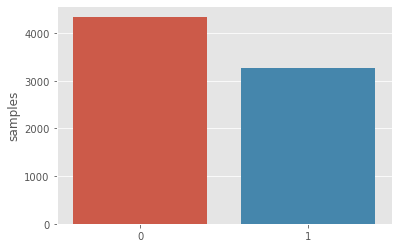

In [4]:
x=tweet.target.value_counts()
#统计对应标签中的对应的0，1数值并画出相应的图
sns.barplot(x.index,x)
plt.gca().set_ylabel('samples')
#将y坐标的对应的数值改为'samples'

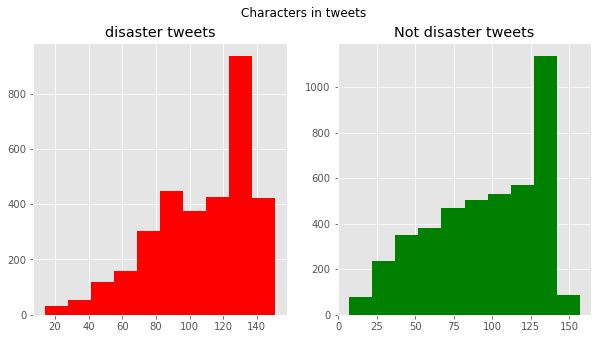

In [5]:
#查看灾难性的推特以及非灾难性的推特的总的字母的数量分布
#实现推特对应的数据分析
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(10,5))
tweet_len=tweet[tweet['target']==1]['text'].str.len()
ax1.hist(tweet_len,color='red')
ax1.set_title('disaster tweets')
tweet_len=tweet[tweet['target']==0]['text'].str.len()
ax2.hist(tweet_len,color='green')
ax2.set_title('Not disaster tweets')
fig.suptitle('Characters in tweets')
plt.show()

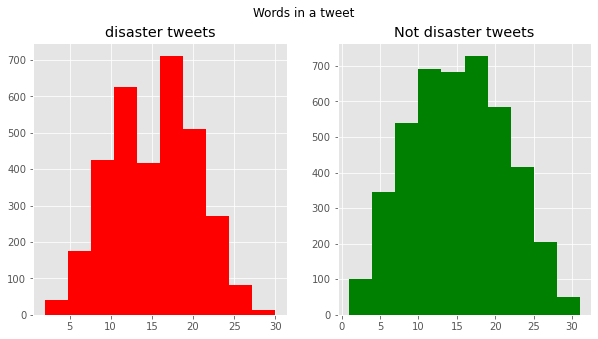

In [6]:
#查看灾难性推特以及非灾难性推特总的单词数量的分布
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(10,5))
tweet_len=tweet[tweet['target']==1]['text'].str.split().map(lambda x: len(x))
ax1.hist(tweet_len,color='red')
ax1.set_title('disaster tweets')
tweet_len=tweet[tweet['target']==0]['text'].str.split().map(lambda x: len(x))
ax2.hist(tweet_len,color='green')
ax2.set_title('Not disaster tweets')
fig.suptitle('Words in a tweet')
plt.show()

d:\python37\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
d:\python37\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0.5, 0.98, 'Average word length in each tweet')

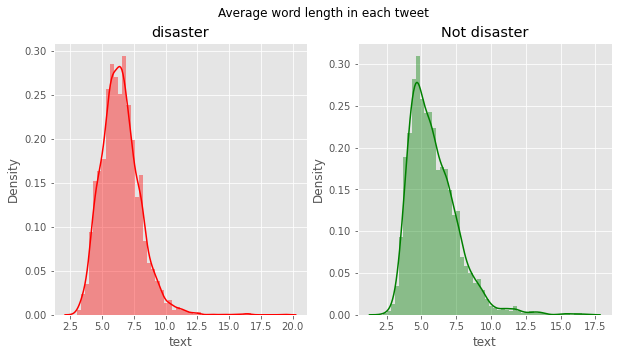

In [7]:
#查看灾难性与非灾难性推特平均的单词长度
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(10,5))
word=tweet[tweet['target']==1]['text'].str.split().apply(lambda x : [len(i) for i in x])
sns.distplot(word.map(lambda x: np.mean(x)),ax=ax1,color='red')
ax1.set_title('disaster')
word=tweet[tweet['target']==0]['text'].str.split().apply(lambda x : [len(i) for i in x])
sns.distplot(word.map(lambda x: np.mean(x)),ax=ax2,color='green')
ax2.set_title('Not disaster')
fig.suptitle('Average word length in each tweet')

In [8]:
def create_corpus(target):
    corpus=[]
    #将对应的语料放入相应的目标标志之中
    for x in tweet[tweet['target']==target]['text'].str.split():
        for i in x:
            corpus.append(i)
    #将所有的字符串都放入corpus的对应数组
    return corpus

<BarContainer object of 10 artists>

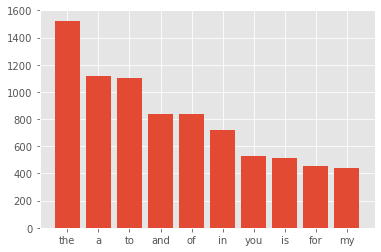

In [9]:
#绘制出非灾难性推特出现频率最高的单词
corpus=create_corpus(0)
dic=defaultdict(int)
for word in corpus:
    if word in stop:
        dic[word]+=1
top=sorted(dic.items(), key=lambda x:x[1],reverse=True)[:10] 
#逆向排序前10个出现次数最高的单词
x,y=zip(*top)
plt.bar(x,y)

<BarContainer object of 10 artists>

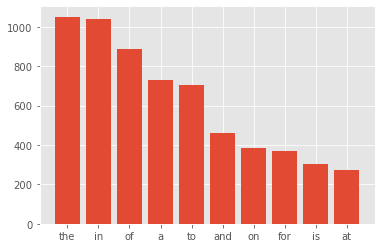

In [10]:
#绘制出灾难性推特中出现频率最高的单词
corpus=create_corpus(1)
dic=defaultdict(int)
for word in corpus:
    if word in stop:
        dic[word]+=1
top=sorted(dic.items(), key=lambda x:x[1],reverse=True)[:10] 
x,y=zip(*top)
#zip()函数用于将可迭代的对象作为参数，将对象中对应的元素打包成
#一个个元组，然后返回这些元组组成的列表
plt.bar(x,y)

special = ***
!"#$%&'()*+,-./:;<=>?@[\]^_`{|}~


<BarContainer object of 18 artists>

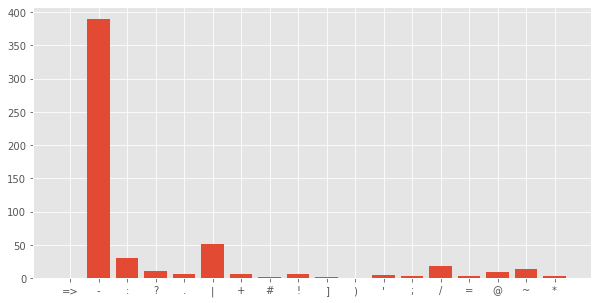

In [11]:
plt.figure(figsize=(10,5))
#figsize=(10,5)表示figure的大小为长、宽(单位为inch)
corpus=create_corpus(1)
dic=defaultdict(int)
import string
special = string.punctuation
print('special = ***')
print(special)
for i in (corpus):
    if i in special:
        dic[i]+=1
x,y=zip(*dic.items())
plt.bar(x,y)

<BarContainer object of 20 artists>

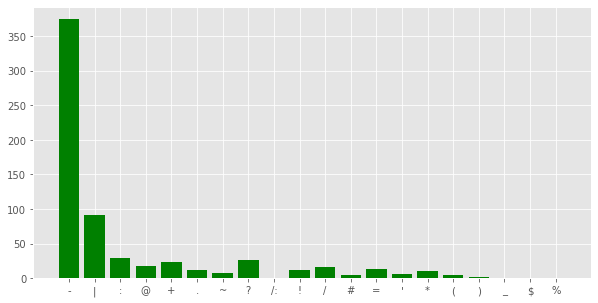

In [12]:
plt.figure(figsize=(10,5))
corpus=create_corpus(0)
dic=defaultdict(int)
import string
special = string.punctuation
for i in (corpus):
    if i in special:
        dic[i]+=1
x,y=zip(*dic.items())
plt.bar(x,y,color='green')

<AxesSubplot:>

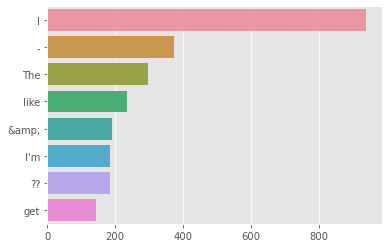

In [13]:
#print('corpus = ***')
#print(corpus)
'''对应的内容为具体的单词
["What's", 'up', 'man?', 'I', 'love']

'''
counter = Counter(corpus)
most = counter.most_common()
#print('counter = ***')
#print(counter)
'''
Counter({'the': 1524, 'a': 1115, 
'to': 1099, 'I': 938, 'and': 840, 'of': 834, 'in': 720})
统计其中每个单词的具体的数量
'''
#print('most = ***')
#print(most)
x = []
y = []
for word,count in most[:40]:
    if word not in stop:
    #不为停留词的时候,x,y压入对应的单词
        x.append(word)
        y.append(count)
sns.barplot(x=y,y=x)

<AxesSubplot:>

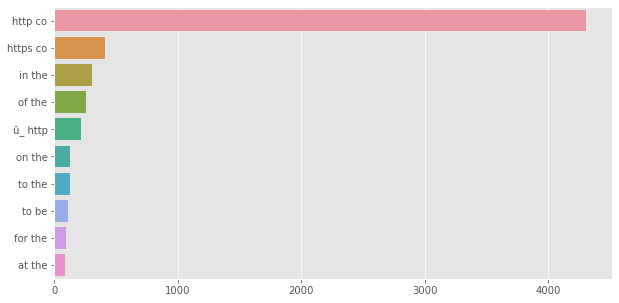

In [14]:
#N-gram对应分析
def get_top_tweet_bigrams(corpus, n=None):
    #!!!在这里面执行函数没有输出是因为没有调用这个函数!!!
    '''
    在信息检索中，Bag of words model假定对于一个文本，
    忽略其词序和语法，句法，将其仅仅看做是一个词集合，
    或者说是词的一个组合，文本中每个词的出现都是独立的，
    不依赖于其他词 是否出现，或者说当这篇文章的作者在任
    意一个位置选择一个词汇都不受前面句子的影响而独立选择的。
    '''
    #print('corpus = ***')
    #print(corpus)
    vec = CountVectorizer(ngram_range=(2, 2)).fit(corpus)
    #corpus为每个句子对应的语料的内容，这一步为实例化分词对象
    #print('vec = ***')
    #print(vec)
    #print(type(vec))
    '''
    CountVectorizer属于常见的特征数值计算类，它只考虑
    每种词汇在该训练文本中出现的频率，会将文本中的词语
    转换为词频矩阵，它通过fit_transform函数计算各个词
    语出现的频率(ngram_range=(2,2)选择2个词进行前后组
    合，构成新的标签值，比如'I like you',选用的2个词
    分别为'I like'和'like you'
    词袋模型的三部曲:1.分词(统计每个词在文本中出现个数)
    2.统计修订词的特征值
    sarcasm.json出对应的结果，可以看出4个文本的词频已经
    统计出来了，左边括号中第一个数字是文本的序号，第二个
    数字是词的序号
    '''
    bag_of_words = vec.transform(corpus)
    #通过fit+transform将文本中的词语转换为词频矩阵
    #print('bag_of_words = ***')
    #print(bag_of_words)
    #transform函数作用：将某操作应用于指定范围的每个元素
    sum_words = bag_of_words.sum(axis=0) 
    #print('sum_words = ***')
    #print(sum_words)
    '''
    sum[axis=0]的结果是普通的相加，比如对应的数组为
    [0 1 2
     2 1 3],此时如果axis=0时，结果为
    [2 2 5],这一步是每一列的结果相加，求最终的结果内容
    '''
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    #print('words_freq = ***')
    #print(words_freq)
    return words_freq[:n]
plt.figure(figsize=(10,5))
top_tweet_bigrams=get_top_tweet_bigrams(tweet['text'])[:10]
x,y=map(list,zip(*top_tweet_bigrams))
#将top_tweet_bigrams对应的两个部分的值转为list的形式并返回
'''print('x = ')
print(x)
print('y = ')
print(y)
'''
sns.barplot(x=y,y=x)

In [15]:
'''
注意需要先找完两个词形成的词组的频率，然后才能继续向后进行操作，
否则的话会发生两个词形成的词组原本不是在一起的情况，接下来进行
数据清洗，
'''
df = pd.concat([tweet,test])
df.shape
df

,id,keyword,location,text,target
0,1,NaN,NaN,Our Deeds are the Reason of this #earthquake M...,1.0
1,4,NaN,NaN,Forest fire near La Ronge Sask. Canada,1.0
2,5,NaN,NaN,All residents asked to 'shelter in place' are ...,1.0
3,6,NaN,NaN,"13,000 people receive #wildfires evacuation or...",1.0
4,7,NaN,NaN,Just got sent this photo from Ruby #Alaska as ...,1.0
...,...,...,...,...,...
3258,10861,NaN,NaN,EARTHQUAKE SAFETY LOS ANGELES ÛÒ SAFETY FASTE...,NaN
3259,10865,NaN,NaN,Storm in RI worse than last hurricane. My city...,NaN
3260,10868,NaN,NaN,Green Line derailment in Chicago http://t.co/U...,NaN
3261,10874,NaN,NaN,MEG issues Hazardous Weather Outlook (HWO) htt...,NaN


In [16]:
#去除对应的urls的内容
example="New competition launched :https://www.kaggle.com/c/nlp-getting-started"
def remove_URL(text):
    url = re.compile(r'https?://www\.\S+')
    #\S匹配任何非空白的字符
    #？代表前面的s可选，r'https?://\S+|www\.\S+'
    #如果使用r'https?://www\.\S+，也是可以对
    #最终的结果进行匹配成功的
    return url.sub(r'',text)
df['text']=df['text'].apply(lambda x : remove_URL(x))

In [17]:
example = """<div>
<h1>Real or Fake</h1>
<p>Kaggle </p>
<a href="https://www.kaggle.com/c/nlp-getting-started">getting started</a>
</div>"""
def remove_html(text):
    html=re.compile(r'<.*?>')
    #.为对应的任意字符，*为任意个字符
    return html.sub(r'',text)
print(remove_html(example))
df['text']=df['text'].apply(lambda x : remove_html(x))


Real or Fake
Kaggle 
getting started



In [18]:
#去除对应的表情符号
def remove_emoji(text):
    emoji_pattern = re.compile("["
                           u"\U0001F600-\U0001F64F"  # emoticons
                           u"\U0001F300-\U0001F5FF"  # symbols & pictographs
                           u"\U0001F680-\U0001F6FF"  # transport & map symbols
                           u"\U0001F1E0-\U0001F1FF"  # flags (iOS)
                           u"\U00002702-\U000027B0"
                           u"\U000024C2-\U0001F251"
                           "]+", flags=re.UNICODE)
    return emoji_pattern.sub(r'', text)
remove_emoji("Omg another Earthquake 😔😔")
df['text']=df['text'].apply(lambda x: remove_emoji(x))

In [19]:
#去除对应的标点符号内容
def remove_punct(text):
    table=str.maketrans('','',string.punctuation)
    ##创建字符映射转换表，并删除指定字符
    return text.translate(table)
example="I am a #king"
print(remove_punct(example))
df['text']=df['text'].apply(lambda x : remove_punct(x))

I am a king


In [20]:
#检查对应的拼写结果是否正确
from spellchecker import SpellChecker
spell = SpellChecker()
def correct_spellings(text):
    corrected_text = []
    misspelled_words = spell.unknown(text.split())
    for word in text.split():
        if word in misspelled_words:
            corrected_text.append(spell.correction(word))
        else:
            corrected_text.append(word)
    return " ".join(corrected_text)
text = "corect me plese"
correct_spellings(text)

'correct me please'

In [21]:
#GloVe for Vectorization:
def create_corpus(df):
    corpus=[]
    for tweet in tqdm(df['text']):
    #在使用python处理比较耗时操作的时候，为了便于观察处理进度
    #这时候就需要进行可视化展示，以便于我们能够及时了解情况
    #tqdm会以一个进度条的形式显示相应的效果
        words=[word.lower() for word in word_tokenize(tweet) if((word.isalpha()==1) & (word not in stop))]
        #word.isalpha()检测字符串中是否只由"字母"组成，如果字符串中至少有一个
        #字符串并且所有的字符都是由字母组成的，将返回True，否则返回False
    #word.isalpha==1    
        corpus.append(words)
    return corpus
corpus=create_corpus(df)
#print('corpus = ***')
#print(corpus)
#corpus中的结果为提取的对应的单词

100%|██████████████████████████████████████████████████████████████████████████| 10876/10876 [00:02<00:00, 4810.70it/s]


In [22]:
embedding_dict={}
with open(r'D:\competition\Real or Not\glove_6B_100d.txt','r',encoding='utf-8') as f:
#这里必须加上对应的encoding='utf-8',否则输出结果会相应的报错
    for line in f:
        values=line.split()
        word=values[0]
        vectors=np.asarray(values[1:],'float32')
        embedding_dict[word]=vectors
f.close()

In [23]:
MAX_LEN=50
tokenizer_obj=Tokenizer()
tokenizer_obj.fit_on_texts(corpus)
sequences=tokenizer_obj.texts_to_sequences(corpus)
#print('sequences = ***')
#print(sequences)
#sequences将对应的句子转化成为相应的单词序号
tweet_pad=pad_sequences(sequences,maxlen=MAX_LEN,truncating='post',padding='post')
#truncating='post':确定需要截断序列(即句子中单词的长度超过MAX_LEN的时候，选择从
#后面截断还是从前面进行截断)

In [24]:
word_index = tokenizer_obj.word_index
print('Number of unique words:',len(word_index))

Number of unique words: 21444


In [25]:
num_words=len(word_index)+1
print('num_words = %d'%num_words)
embedding_matrix=np.zeros((num_words,100))
#embedding初始的长度为推特中出现的单词num_words,
#对应的矩阵长度为100
print('word_index = ***')
print(word_index)
'''
'i': 1, 'the': 2, 'like': 3, 'amp': 4, 'im': 5,
'a': 6, 'fire': 7, 'get': 8, 'new': 9, 'via'}
word_index为两个部分，一个是对应的单词，另外一个
是对应的数值，所以循环的时候使用两个部位，这里的
word_index是之前语料中的推特内容各个单词的对应的
编号
'''
for word,i in tqdm(word_index.items()):
    print('word = ***')
    print(word)
    print('i = ***')
    print(i)
    if i > num_words:
        continue
    emb_vec=embedding_dict.get(word)
    print('emb_vec = ***')
    print(emb_vec)
    '''
    emb_vec为之前从100d文件中读取的相应的内容
    '''
    if emb_vec is not None:
        embedding_matrix[i]=emb_vec
    #不为None的情况下将emb_vec中的对应内容放入
    #到embedding_matrix的对应矩阵之中，i为对应的单词的序号

  0%|▏                                                                             | 54/21444 [00:00<00:39, 536.08it/s]

num_words = 21445
word_index = ***
{'i': 1, 'the': 2, 'like': 3, 'amp': 4, 'im': 5, 'a': 6, 'fire': 7, 'get': 8, 'new': 9, 'via': 10, 'news': 11, 'people': 12, 'one': 13, 'in': 14, 'dont': 15, 'us': 16, 'emergency': 17, 'video': 18, 'disaster': 19, 'would': 20, 'this': 21, 'to': 22, 'police': 23, 'still': 24, 'is': 25, 'got': 26, 'you': 27, 'my': 28, 'suicide': 29, 'body': 30, 'crash': 31, 'burning': 32, 'first': 33, 'storm': 34, 'rt': 35, 'attack': 36, 'time': 37, 'back': 38, 'know': 39, 'california': 40, 'fires': 41, 'buildings': 42, 'see': 43, 'going': 44, 'and': 45, 'man': 46, 'love': 47, 'day': 48, 'two': 49, 'world': 50, 'cant': 51, 'bomb': 52, 'if': 53, 'nuclear': 54, 'full': 55, 'go': 56, 'hiroshima': 57, 'dead': 58, 'youtube': 59, 'watch': 60, 'today': 61, 'life': 62, 'think': 63, 'car': 64, 'train': 65, 'last': 66, 'killed': 67, 'it': 68, 'accident': 69, 'its': 70, 'good': 71, 'of': 72, 'say': 73, 'we': 74, 'make': 75, 'war': 76, 'no': 77, 'how': 78, 'could': 79, 'may': 80, '

 -1.0739e+00 -5.7574e-02  6.2466e-01  5.9499e-01]
word = ***
more
i = ***
82
emb_vec = ***
[-0.38469    0.99338    0.13398   -0.32708   -0.07744    0.17769
 -0.071985   0.1616    -0.1377     0.051739   0.15964    0.016507
 -0.049616  -0.53964    0.24449   -0.62066   -0.345     -0.015009
  0.059399   0.79348    1.2096    -0.094457   0.14585   -0.063804
  0.1468    -0.50725   -0.15582   -0.69462   -0.18542   -0.20292
  0.011547   0.39695   -0.45813   -0.19921    0.32108    0.54069
 -0.0073385  0.12096   -0.77902    0.42854   -0.53546   -0.58143
  0.14424   -0.47396   -0.20623   -0.20815    0.54938   -0.51741
  0.09016   -0.75701   -0.063903  -0.73684   -0.097376   1.2635
 -0.51026   -2.5686     0.4768    -0.54214    2.1144     0.49177
  0.21146    1.5787    -0.28596    0.051544   0.4962    -0.26324
  0.82709    0.50339    0.90994   -0.28113    0.020357  -0.63306
 -0.33049   -0.17052    0.66252   -0.055619  -0.37653   -0.15417
 -1.1648    -0.15672    1.2909     0.12161   -0.48802    0.475

  1%|▌                                                                            | 147/21444 [00:00<00:43, 492.72it/s]

word = ***
mass
i = ***
98
emb_vec = ***
[ 0.42241   1.3921   -0.81157   0.16121  -0.32688   0.53271   0.02065
  0.28038  -0.31516   0.70442  -0.58137  -0.16389   0.24523   0.17444
  0.41084  -0.18906   0.26068   0.25388  -0.25237  -0.33257   0.08624
 -0.52667  -0.23709  -0.38751   0.16895   0.62435   0.25587   0.77368
  0.49564   0.67312  -0.018906 -0.98849  -0.21915   0.36863   0.19088
 -0.52626   1.1513   -0.2223   -0.32033  -0.069429 -0.72083  -0.2403
 -0.51045  -0.34675  -0.22909  -0.2235    1.0389   -0.34859  -0.040357
 -0.04321   0.82784  -0.36531   0.036349  0.39912  -0.22328  -1.8617
 -0.2423    0.59272   2.1586    0.022486 -0.31073   0.12449   0.29068
 -0.8238    0.99652  -0.3312    0.4364   -0.36294   0.62923   0.20374
 -0.14832  -0.62537  -0.36387  -0.27341   0.32725  -0.42718   0.45657
 -0.24695  -0.93909   0.32605   1.249     0.35289  -0.27732   0.22858
 -0.99753  -0.58074   0.81844  -0.41413   0.30263  -0.046789 -0.029918
  0.25089   0.66683   1.05     -0.43866  -1.0563 

  2.6881e-01  6.8968e-01  6.6204e-01  4.7812e-01]
word = ***
truck
i = ***
164
emb_vec = ***
[-0.13959    0.053049   0.098775  -0.75656    0.18649   -0.5453
  0.51948    1.031      0.53502    0.48639    0.27249    0.15508
  0.40621    0.18081   -0.025307   0.26865    0.38571   -0.21049
 -0.28851    0.48076    1.0103     0.11727    0.4438    -0.044604
  0.31954    0.105     -1.046     -0.045288   0.26557    0.2942
  0.044758   0.21819   -0.31754   -0.24927    0.0386    -0.018294
  0.48484    0.2406     1.4252     0.60919    0.62857   -0.9181
  0.67407   -0.049386   0.32595    0.5808    -0.064496   0.097091
 -0.29634   -0.49801   -0.5079     0.15151   -0.28035    1.4427
  0.18603   -0.93646   -1.2371     0.76921    2.1535     0.24301
  0.43864    0.16485    0.61097    0.34103    0.31127   -0.021241
  0.18143   -0.24922   -0.50407    0.36803   -0.40437   -0.78135
  0.3406    -0.33441    0.39221    1.2164     1.4956    -0.067117
 -0.47906   -0.11335    0.38635    0.46424   -0.66364    0.01

  1%|▊                                                                            | 224/21444 [00:00<00:51, 415.62it/s]


word = ***
gon
i = ***
177
emb_vec = ***
[ 0.83646   -0.90392    0.029111  -0.19007   -1.0184     0.42817
  0.04565    0.50307    0.45136    0.10421    0.33726    0.79894
  0.86996    0.33495   -0.42842    0.32015    0.43911    0.65015
 -0.62261    0.33511    0.87585    0.16234   -0.096966   0.5679
 -0.80904    0.70704   -0.061016  -0.091866  -0.60679   -0.15543
 -0.093346  -0.2693    -0.21904   -0.10459   -0.024595   0.41673
  0.11244    0.30521    0.41293   -0.35439   -0.64627    0.36023
 -0.11016   -0.24749    0.32835    0.20428   -0.61607   -0.89698
  0.85993   -0.45731   -0.74151    0.37495    0.76637   -0.18235
 -0.53205    0.88715   -0.18864    0.76177   -0.42086   -0.96275
 -0.39025   -0.61279   -0.090363  -0.67703   -1.2647     0.12562
  0.59414    0.58728   -0.34292    0.39202    0.42602    0.156
 -0.17291   -0.18865    1.1244    -0.35419   -0.36323   -0.94788
  0.25867   -0.36703    0.28096   -0.22732   -0.76929   -0.55568
  0.097553  -0.056209  -0.32876    0.08202    0.798

  0.21983  -0.65031 ]
word = ***
face
i = ***
230
emb_vec = ***
[-0.13234    0.31691    0.67548   -0.29082    0.11674    0.5846
 -0.6859     0.32639   -0.58656   -0.01109   -0.43636    0.34629
  0.1791     0.40488    0.14535   -0.067507  -0.16316    0.43279
 -0.4294    -0.33912   -0.0082742  0.015646   0.068038   0.63244
  0.84129    0.5936     0.27984   -0.61928    0.26884   -0.5104
  0.37507   -0.16799   -0.064193  -0.32503    0.39594   -0.19061
 -0.21194   -0.39461   -0.074421   0.15468   -0.61194   -0.82561
  0.52164   -0.36033   -0.012684   0.30484    0.3812     0.42642
 -0.14906   -0.52745    0.1869    -0.2185    -0.19862    1.6634
  0.26929   -2.0333     0.24169   -0.42761    1.2361     0.43777
  0.25898    0.66032   -0.94538   -0.48365    0.58104   -0.15643
  0.58868    0.47956   -0.64341   -0.21091    0.13704   -0.047705
 -0.63857   -0.37545    0.44312   -0.12098   -0.36055    0.02521
 -0.27534    0.019602   1.4573    -0.093716  -0.39097   -0.056688
 -1.4474    -1.2793    -0.6

  1%|▉                                                                            | 259/21444 [00:00<00:57, 370.14it/s]


word = ***
fall
i = ***
241
emb_vec = ***
[ 0.3264    0.55822   0.25533  -0.10814   0.04654  -0.46577  -0.13963
  0.15362  -0.23483  -0.42804   0.037924  0.22895   0.18672   0.23734
  0.34996   0.037288 -0.46827   0.15487  -0.16487   0.11753   0.30809
 -0.25441   0.30979   0.8051   -0.09219  -0.062635 -0.38575  -0.54978
  0.3019   -0.54258   0.19739  -0.29      0.092703 -0.48055  -0.48191
  0.72779   0.22876  -0.45603   0.037786 -0.32571  -0.42623  -0.058946
 -0.52196   0.18801   0.14141  -0.20073   0.27084  -0.026134  0.13288
 -1.4764   -0.056972 -0.32662   0.30494   0.76331   0.16788  -2.356
 -0.37616  -0.011489  1.9827    0.36153  -0.22095   1.0825   -0.67676
  0.096369  0.48564   0.20256   0.16667  -0.35918   0.13848   0.096536
  0.13312  -0.069298 -0.69095   0.35564  -0.50851  -0.3494   -0.33562
  0.45363  -0.28949   0.032191  0.17248   0.1475   -0.70217  -0.2028
 -0.74759  -0.96593  -0.083909 -0.28699   0.11724   0.066832  0.21283
  0.26471  -0.047237  0.49353  -0.80611  -0.2078

  0.48259   0.31449 ]
word = ***
weapons
i = ***
288
emb_vec = ***
[ 0.33465    0.70526    0.70918   -0.38975    0.065235  -0.8219
  0.51358    0.32944    0.80029    1.5024     0.3072    -0.2785
  0.25148    0.63896   -0.015067   0.20802    0.60844    0.092724
 -1.3046    -0.74759    0.61794   -0.66903    0.31393   -0.99653
 -0.15296    0.60681   -0.43021    0.10205    0.023929   0.32729
  0.0063455 -0.82073   -1.2048    -0.37592    0.65441   -0.45072
  0.768     -1.2163    -0.24202    0.28194   -0.48878   -0.005613
  0.43507   -0.010187   0.6471    -0.97644    0.080101   0.057007
 -0.77482   -0.75209    1.0488     0.76539   -0.15604    1.0791
  0.76112   -1.2804    -0.28986   -0.66816    1.7108    -0.3054
  0.10312    0.564      0.19644    0.23431    0.33441   -0.091124
  0.87525    0.50679   -0.27986    0.80057    0.38307   -1.0389
  0.033644  -0.40953   -0.15721   -0.094996  -0.33952    0.24439
 -1.6455     0.65138    2.0463     0.19755   -0.23566    0.13095
 -1.282      0.69455    

  2%|█▏                                                                           | 326/21444 [00:00<01:02, 336.94it/s]

word = ***
past
i = ***
293
emb_vec = ***
[ 0.092072  0.47135   0.46624  -0.18196   0.089316  0.43127  -0.30261
  0.12273  -0.59361  -0.13984   0.038289  0.1808    0.50042   0.16045
  0.19326   0.11059  -0.3819    0.12897  -0.80822   0.10872   0.72178
  0.69956  -0.14525   0.85323   0.17589  -0.52323  -0.22336  -0.61464
  0.1283   -0.61963   0.10119   0.082335  0.16027   0.41189  -0.35529
  0.10935  -0.57284  -0.38716  -0.71108   0.041671 -0.6351   -0.5846
  0.095456  0.58921   0.028272 -0.074223  0.45053  -0.23882   0.32784
 -0.48341   0.40556  -0.087688 -0.54365   1.4268    0.37219  -2.0344
 -0.24058   0.418     1.7052    0.51365  -0.33233   0.89202  -0.10761
 -0.018437  0.22704  -0.18488   0.55288   0.11414   0.15414   0.095188
 -0.0889    0.092891 -0.15585  -0.57651   0.017436 -0.61082  -0.22996
 -0.15646  -0.83934   0.47421   0.72096   0.93232  -0.13763   0.085555
 -1.4471   -0.092676 -0.29628   0.17313  -0.27948  -0.37559  -0.28956
  0.47992  -0.62933   0.14552  -1.0237   -0.1937

  0.26157  -0.42534 ]
word = ***
stock
i = ***
351
emb_vec = ***
[ 8.6341e-01  6.9648e-01  4.5794e-02 -9.5708e-03 -2.5498e-01 -7.4666e-01
 -2.2086e-01 -4.4615e-01 -1.0423e-01 -9.9931e-01  7.2550e-02  4.5049e-01
 -5.9912e-02 -5.7837e-01 -4.6540e-01  4.3429e-02 -5.0570e-01 -1.5442e-01
  9.8250e-01 -8.1571e-02  2.6523e-01 -2.3734e-01  9.7675e-02  5.8588e-01
 -1.2948e-01 -6.8956e-01 -1.2811e-01 -5.2265e-02 -6.7719e-01  3.0190e-02
  1.8058e-01  8.6121e-01 -8.3206e-01 -5.6887e-02 -2.9578e-01  4.7180e-01
  1.2811e+00 -2.5228e-01  4.9557e-02 -7.2455e-01  6.6758e-01 -1.1091e+00
 -2.0493e-01 -5.8669e-01 -2.5375e-03  8.2777e-01 -4.9102e-01 -2.6475e-01
  4.3015e-01 -2.0516e+00 -3.3208e-01  5.1845e-02  5.2646e-01  8.7452e-01
 -9.0237e-01 -1.7366e+00 -3.4727e-01  1.6590e-01  2.7727e+00  6.5756e-02
 -4.0363e-01  3.8252e-01 -3.0787e-01  5.9202e-01  1.3468e-01 -3.3851e-01
  3.3646e-01  2.0950e-01  8.5905e-01  5.1865e-01 -1.0657e+00 -2.6371e-02
 -3.1349e-01  2.3231e-01 -7.0192e-01 -5.5737e-01 -2.3418e-0

  2%|█▍                                                                           | 414/21444 [00:01<00:55, 379.71it/s]


word = ***
explode
i = ***
368
emb_vec = ***
[-0.40255   0.1182    0.28018  -0.38555  -0.38775   0.65749   0.32778
  0.061368  1.3856    1.1906    0.2515    0.64791   0.11605   0.80291
  0.048922 -0.47195  -0.49193   1.3178   -0.52608  -0.23433   0.56258
 -0.67738   0.23964  -0.34446   0.29807   0.068663 -0.5909    0.41894
  0.70725   0.088674 -0.37691  -0.35755  -0.21366  -0.047922 -0.13155
 -0.25131   0.81555  -0.58275   0.35682   0.037227 -0.055612  0.19947
 -0.65159  -0.5342    0.25711  -0.018549  0.70924   0.53817  -1.1415
 -0.76623  -0.15689   0.29539  -0.19333   0.64862   0.173    -1.0247
 -0.33597   0.57506   0.56017   0.21579  -0.056667  1.5244    0.021032
  0.21767  -0.066076  0.49851   0.29714  -0.48922  -0.17117  -0.37597
  0.10842  -0.4627    0.65611  -0.6172   -0.111    -0.38624   0.58132
 -0.1942   -0.08685   0.3444    0.54613  -0.22259  -0.55588  -0.14558
  0.30508  -0.91671   0.515     0.12665  -0.51847   0.085065  0.27482
  0.91748  -0.25525  -0.18149  -0.16861   0.4

 -0.25028   -1.2931    -0.13555   -0.25115  ]
word = ***
flattened
i = ***
434
emb_vec = ***
[-0.83698    0.78218   -0.27673    0.18097   -0.46686    0.55468
  0.043605   0.491      0.60874    0.73644   -0.032717   0.074323
  0.90937    0.40692    0.49841    0.25471   -0.77091    0.47935
  0.33581    0.33017    0.52815    0.59628    0.58894    0.18239
  0.96347   -0.054334  -0.4893     0.19121   -0.93688    0.25075
  1.1066    -0.64975    0.47128    0.0098165 -0.60131   -0.40868
  0.03496   -0.15374   -0.23115    0.42504    0.36461   -0.8218
  0.15857    0.13857    0.64104    0.3528     0.50558    1.2288
  0.035305  -0.026228  -0.2797    -0.098044   0.37227    0.59636
 -0.10523   -0.409      0.1027     0.42008    0.19983    0.56165
  0.20227    0.98404    0.26782    0.47879    0.099834  -0.29529
 -0.41444    0.52924    0.036515  -0.51773    0.21791   -0.017668
  0.4807    -0.26257    0.39628   -0.22987   -0.0048646  0.90287
 -0.02494    0.29082   -0.055751   0.59085   -1.2524    -0.365

  2%|█▊                                                                           | 504/21444 [00:01<00:51, 404.67it/s]


word = ***
cyclone
i = ***
448
emb_vec = ***
[-0.94559    0.30354    0.58529   -0.067717  -0.92136   -0.41419
  0.7762     0.040362  -0.14009   -0.25995    0.45085   -0.62297
  0.53448   -0.45153    0.8297    -0.5892     0.38659   -0.63676
 -0.092933   0.74921    0.42742    0.42139    0.71681    0.83878
  0.46764    1.3919    -0.0094674  0.11926   -0.63971    0.31185
  1.0792    -0.059007   0.26029    0.98899   -1.3536    -1.0103
 -0.032022   0.20387   -0.62679    0.25808   -1.4776     1.0777
  0.68665    0.07488    1.5665     0.74297    0.0095551  0.081815
  0.85376    0.12299   -0.52795    0.14254    0.30713    0.49414
  0.66034   -0.6847    -0.17502   -0.37544    0.71289    0.82292
 -0.46211    1.1382    -0.37056    0.12633    0.34351    0.49321
 -1.8538     0.20268    1.248     -0.90443   -0.12123   -0.29333
 -0.092193  -0.33729    0.5828     0.73241    0.074213  -0.054425
  0.52804    0.0078177  0.27099    0.097969  -1.1798     0.26641
  0.48552    0.58705    0.4191    -0.51529  

  1.9737e-01 -4.1121e-02 -6.1363e-02  2.7293e-01]
word = ***
half
i = ***
512
emb_vec = ***
[ 1.1202e-01  6.0857e-01  3.5559e-01 -4.7541e-01 -1.6570e-01  6.8022e-01
  5.7314e-01  6.6956e-01 -3.9293e-01  1.0083e-02  4.1612e-01  2.7564e-01
 -2.8052e-01 -1.2875e-03  5.8628e-01 -4.4036e-01 -4.8366e-01 -1.4547e-01
 -4.1673e-02 -1.7629e-03  1.0677e+00  3.4166e-01 -1.4933e-02  4.8078e-01
  3.5863e-01 -6.5313e-01 -3.0566e-01 -7.9166e-02 -3.5043e-01 -5.5137e-01
 -1.1990e-01  3.0892e-01 -6.6982e-02 -6.2160e-01 -1.8448e-01 -1.3999e-01
 -2.9127e-02  9.5533e-01 -4.9302e-01  4.6709e-02 -1.1300e-01 -6.8351e-01
  2.2175e-01  2.1388e-01  4.2182e-01  9.2370e-02  1.2946e-01 -5.6981e-01
 -4.5071e-02 -6.6510e-01 -8.6060e-02 -1.9644e-01 -3.8581e-01  1.2123e+00
 -2.9542e-01 -2.7512e+00 -9.0135e-01 -3.3484e-01  1.6054e+00  3.3258e-01
  2.6919e-01  6.3194e-01  4.8310e-02  7.4459e-02  3.7498e-01  2.6440e-01
  1.4398e-01  2.4082e-01  1.4641e-01 -3.7470e-02  2.3552e-01  5.1620e-01
  1.8345e-01 -2.4450e-01  1.6372

  3%|█▉                                                                           | 545/21444 [00:01<00:55, 379.55it/s]


word = ***
avalanche
i = ***
525
emb_vec = ***
[-0.46241   -0.50068    0.52295   -0.48805   -0.28932    0.035449
  0.43469   -0.32504   -1.4018    -0.72692    0.22391    0.34143
 -0.43631   -0.72684    0.50033    0.40382   -0.33009   -0.11367
 -0.7429     0.51157   -0.52036    0.89364   -0.45146    1.1117
  0.70284   -0.079876   0.29317    0.61233   -0.30809   -0.93228
  0.069406   0.19195   -0.70186    0.80467   -0.3894    -1.5094
 -0.29477    0.44899    0.55216   -0.024122   0.51316    0.66764
 -0.066701  -1.1256     0.50684    0.80842    0.34328    0.22411
  0.57361    0.26453    0.084515   0.027319  -0.72232    0.32762
  0.18513   -1.3076     0.0020132  0.67738    1.0449     0.77011
 -0.27606    0.66598   -0.066933   0.6489     1.0957     0.25052
 -0.26774   -0.2265    -0.23281   -0.15445   -0.50819   -1.3465
  0.0090178  0.54847    0.13562    0.1953     0.19275    0.15348
 -0.77231   -0.06116    0.48912    0.51561   -0.53358   -0.62131
  0.52554   -0.43227    0.079679   0.51043  

  0.3465    -0.32608    0.084863  -0.22479  ]
word = ***
though
i = ***
570
emb_vec = ***
[-2.0048e-01  3.9650e-01  4.1972e-01 -2.4869e-01 -1.8809e-01  2.3210e-02
  1.2773e-02 -1.0152e-01  3.3376e-01 -4.2778e-01 -6.6133e-03 -4.0639e-02
  4.9387e-01 -2.2051e-01  7.1245e-02 -4.5311e-01 -2.4555e-01  6.6647e-02
 -8.8730e-02  4.2404e-01  3.0872e-01 -1.4332e-01  1.7546e-01  1.7099e-03
  1.0690e-01 -1.3362e-01 -1.8550e-01 -7.7892e-01 -1.4670e-01 -1.3940e-01
  1.9643e-01  3.8688e-01 -2.6543e-01 -1.9745e-01  3.0245e-01  5.6152e-01
  1.3029e-01 -2.1034e-02 -2.0259e-01 -2.7721e-01 -2.9965e-01 -2.7535e-01
  2.6620e-01  7.3788e-02 -4.3032e-02 -4.6754e-01  7.7579e-01 -3.6721e-01
  1.5260e-01 -7.0882e-01  5.0964e-01 -1.1478e-01  3.5220e-01  9.7889e-01
  5.9517e-02 -2.5459e+00 -2.5478e-01 -2.8866e-01  1.2855e+00  6.6514e-01
 -1.5178e-01  7.2769e-01  5.2103e-02  6.8940e-02  7.5834e-01 -1.1260e-01
  4.3492e-01  1.1862e-01  1.8554e-01  9.2965e-02 -9.9102e-02 -1.3945e-01
  4.2443e-02 -8.9807e-02  1.9579e-

  3%|██▏                                                                          | 623/21444 [00:01<00:57, 363.21it/s]


word = ***
person
i = ***
579
emb_vec = ***
[ 0.38709    0.32629    0.64524    0.012882  -0.11051    1.1922
  0.37298    0.12726    0.43991    0.086266   0.0039535 -0.049873
  0.81426   -0.33466    0.17671   -0.18838   -0.11255    0.18719
 -0.50361    0.74282    0.33397   -0.19284   -0.29303   -0.4946
  0.15614   -0.085108  -0.024602  -0.38991    0.229      0.25051
  0.10483    1.1478     0.11177   -0.43257    0.4302     0.046693
 -0.75141    0.31403    0.69889    0.12507   -0.42615    0.12931
  0.82835   -0.34128   -0.20273    0.19026   -0.14324   -0.65663
 -0.6439    -0.90877    0.55001   -0.37747    0.76323    1.0133
 -0.27997   -1.7108     0.1313    -0.2171     1.8132     0.3366
  0.16273    0.8153    -0.28179   -0.21643    0.74052    0.084269
  0.66184   -0.0031966  0.18784   -0.3492    -0.24641   -0.46574
  0.3723     0.04385    0.77506    0.33063   -0.028808  -0.99085
 -0.46202   -0.42157    0.047822   0.49535   -0.37944   -0.2011
 -1.4283    -0.15271   -0.076777  -0.012325   0

 -2.1236e-01  2.1338e-01  2.1129e-01  1.2260e-01]
word = ***
might
i = ***
653
emb_vec = ***
[ 2.1247e-01  4.2490e-01  4.8245e-01 -5.6996e-01 -3.0612e-01 -2.8451e-01
  9.5678e-04 -2.2235e-01  3.0323e-01 -1.4414e-01 -4.4098e-01  7.2997e-01
  4.2888e-01 -1.1749e-01 -8.4925e-02 -3.4811e-01 -2.8725e-02  4.5075e-01
 -5.6333e-01  3.2675e-01  1.6659e-01 -2.5830e-01  5.0571e-02 -2.4566e-01
 -1.4028e-01  1.2851e-01 -4.8795e-01 -6.1297e-01  1.5658e-01 -4.4649e-01
  1.7421e-01  7.1430e-01 -3.5738e-01 -2.5616e-02  3.6306e-01  3.6589e-01
  2.0033e-01  1.0092e-01  1.7833e-01 -2.1203e-01 -4.7070e-01 -1.2871e-01
 -2.2372e-01 -8.1140e-01 -2.0325e-01 -9.5703e-02  5.8643e-01 -1.7118e-01
  1.0887e-01 -1.4088e+00  5.6021e-01 -2.5858e-02 -4.5119e-02  9.6823e-01
  2.3033e-01 -2.2730e+00 -1.2916e-01 -2.7317e-01  1.3177e+00  9.0111e-01
 -5.0894e-01  1.3328e+00 -1.2402e-01  2.6447e-02  1.0978e+00  1.1031e-01
  4.3522e-01  3.2336e-01 -5.7308e-01 -7.4328e-01  1.3694e-01 -7.5605e-01
 -4.4990e-01 -3.6537e-01 -2.932

  4%|██▋                                                                          | 752/21444 [00:01<00:44, 465.31it/s]


word = ***
stand
i = ***
673
emb_vec = ***
[-0.13612    0.75246   -0.15088   -0.0048918 -0.31567    0.53922
 -0.41178    0.26722   -0.61059   -0.076718   0.36866    0.2123
  0.36946    0.029842   0.17165   -0.26922    0.14657    0.56998
 -1.061     -0.24061    0.73706    0.27217    0.52977   -0.50969
  0.33509    0.18226   -0.060739  -0.11713    0.37268    0.068256
  0.27863    0.42879    0.28849    0.27475    0.31474    0.87392
  0.23574   -0.54233    0.41801   -0.13482   -0.16791   -0.14025
  0.71693   -0.69491    0.19363   -0.33848    0.22037   -0.19391
 -0.59971   -1.1155     0.050899  -0.17184    0.26848    1.6775
  0.085066  -1.9236    -0.3327    -0.26601    1.2348    -0.084889
 -0.16128   -0.047668  -0.38916   -0.12903    0.48883    0.16844
  0.67925    0.58987   -0.84498   -0.47651    0.19158    0.18976
 -0.1423    -0.45755    0.35057   -0.15183   -0.57518    0.1321
  0.24179   -0.17476    0.36721    0.12553    0.28175    0.17545
 -0.94028   -0.61843   -0.4361     0.35653    0

  3.3721e-01  4.7469e-01  1.6478e-01  2.0384e-01]
word = ***
projected
i = ***
764
emb_vec = ***
[-0.35835   0.55548   0.57999  -0.016114  0.43696  -1.0133   -0.21444
  0.43973  -0.32959   0.37551   0.02797   0.27554   0.091589 -0.54256
  0.8182   -0.68065   0.03097   0.80288   0.60665  -0.25526   0.10659
 -0.64485  -0.24275   0.86887  -0.22093  -0.6809    0.441    -0.028132
 -0.13591  -0.59056   0.16569   0.087549 -0.23452   0.21233  -0.20106
  0.48595  -0.048166 -0.04162  -0.28247   0.59254   0.03826  -0.42131
 -0.30332   1.053     0.34236  -0.38085   0.33396  -0.64907  -0.60955
 -0.47744   0.12153  -0.39816   0.47754   0.61268   0.23605  -1.621
  0.39722  -0.19078   0.95449   0.32817  -0.017174  0.22268  -0.71756
 -0.31531   0.13954   0.52322  -0.15159   0.077159  0.51721  -0.26489
  0.91624   0.30151  -0.34678   0.27763   0.055667 -0.37747  -0.22445
  0.47131   0.12634   0.24614   0.14775   0.30343  -0.66719  -0.35546
 -0.73498  -1.2164    0.51792  -0.36697   0.071058 -0.039313  0.

  4%|██▉                                                                          | 803/21444 [00:01<00:44, 458.91it/s]


word = ***
flight
i = ***
783
emb_vec = ***
[ 1.2190e-01 -6.5646e-01  5.0855e-01  1.4803e-01 -4.5745e-01  1.1827e-01
  4.6018e-01  5.3581e-01 -8.2813e-01  4.0373e-01  5.0201e-01 -5.0410e-02
  6.8212e-01  4.2567e-01  3.9513e-01 -1.0163e+00  2.6394e-01  2.2142e-01
  6.7408e-01 -1.6213e-01  1.3717e-01 -1.1164e-01  2.0477e-01 -3.9182e-01
  4.3068e-01 -7.4969e-03 -1.1939e-01  1.4885e-01  4.8769e-01 -2.6045e-01
 -1.3553e+00  3.5289e-01 -6.3662e-01  2.9303e-01 -2.8167e-01  7.6927e-01
  1.4252e-01  9.8579e-01  7.5879e-01  3.9812e-02 -1.1322e+00 -6.1330e-01
  2.2959e-01 -4.3484e-02  7.4136e-01  3.2916e-01  2.8011e-01 -3.6806e-01
  1.7323e-01  2.1755e-01  2.3531e-01  5.6490e-01 -2.7332e-01  1.3426e+00
  7.1593e-01 -1.7127e+00  5.4045e-01  2.9344e-01  2.6985e+00  2.5432e-01
 -3.0715e-01  9.0095e-01  6.5659e-01 -3.9860e-01 -8.8311e-01 -4.3663e-01
 -9.0197e-01  2.1167e-02 -2.6437e-01  2.4113e-01 -7.5052e-01 -1.0290e+00
 -1.1930e-02  3.3120e-02  4.1661e-01  1.6827e-01  6.9785e-01  1.8665e-02
 -1.39

  4%|███                                                                          | 857/21444 [00:02<00:42, 478.90it/s]


word = ***
miners
i = ***
858
emb_vec = ***
[ 0.6746     1.0179    -0.57297   -0.16345   -0.35873   -0.92027
 -0.61276    0.51696   -0.68835   -0.52373    0.43398    0.5508
  0.61911   -0.67942   -0.75569   -0.44415    0.41657   -0.35486
 -0.80355   -0.060329   1.0916     0.5876     0.0035887  0.058851
 -0.11162   -0.34587   -0.4164     0.53119    0.65325    0.21573
 -0.19228   -0.17798   -0.62143   -0.66201   -0.23017   -0.99278
  0.070585  -0.19632    0.52649    0.01851   -0.57401    0.10047
 -0.043502  -0.33637    0.49204    0.15245   -0.33163    0.35984
  0.19949    0.42852   -0.98382   -0.079364  -0.47986    1.2973
 -0.43888   -0.10353   -0.47082   -0.89536    0.70953    0.65632
 -0.37893    0.13621   -0.24095    0.27247    0.61061    0.40808
  0.60124   -0.43711    0.2792    -1.1981    -0.28517    0.26143
  0.32132    0.091012   0.63709    0.37874    1.239     -0.45026
 -1.15      -0.35002    0.70192    0.28731   -0.03648   -0.81567
 -0.92785   -0.4862     0.58498    0.48626   -

  4%|███▎                                                                         | 908/21444 [00:02<00:47, 436.89it/s]

i = ***
866
emb_vec = ***
[-0.090728   0.48545    0.10712   -0.39908    0.47852    0.46725
  0.64062    0.91219   -1.0121     0.12732    0.92199    0.023376
  0.19655    0.81392    0.1694    -0.13135   -0.26604   -0.025472
 -0.61158    0.34201    0.93331   -0.13451    0.0032018  0.39143
  0.7596    -1.0016    -0.2789    -0.32642   -0.30005    0.35931
  0.19587    0.027893  -0.31228   -0.33626    0.28018    0.119
 -0.1763     0.31186   -0.37048    0.54743   -0.51829   -0.21469
  0.70186   -0.24548    0.46121    0.34881   -0.025165  -0.67807
 -0.17137    0.044035  -0.78905   -0.51038   -0.26326    1.2835
  0.051326  -2.534      0.043636  -0.022349   1.7996     1.3997
 -0.74978    0.92709    0.18243    0.48048    0.2948     0.27161
  0.269      0.71182   -0.11844    0.11265   -0.34046    0.12676
 -0.020973  -0.1484     0.18365    0.60186   -0.30049   -0.4193
 -0.92757   -0.1838     0.99586    0.22228   -0.37084    0.35611
 -1.2263    -0.042407   0.18479   -0.28635    0.21577    0.1357
 -0

word = ***
any
i = ***
932
emb_vec = ***
[-2.3676e-01  1.5659e-01  3.0243e-01 -1.5578e-01 -3.9025e-01  1.1214e-01
 -4.2827e-01 -1.3996e-01  5.0000e-01  2.4438e-01  7.8795e-02  4.6397e-01
  1.4506e-01 -4.6024e-02  3.7514e-01  8.1255e-03 -3.6021e-01  4.4383e-01
 -9.1813e-03  5.2886e-01 -2.0502e-01 -3.2799e-01 -1.7999e-01 -6.4124e-01
 -1.5088e-01 -4.0234e-02 -1.2477e-01 -7.8170e-01  5.4377e-02 -2.5998e-01
  3.0353e-02  3.8581e-01 -1.3027e-01  3.4101e-02  3.5053e-01  2.6333e-01
 -1.4078e-01 -7.4158e-02 -4.0511e-01  1.6175e-02 -1.0350e+00  1.2603e-01
  7.0112e-01 -4.6820e-01  1.0376e-01 -7.5453e-02  3.8597e-01 -4.4495e-01
 -6.2957e-01 -1.2194e+00  7.1918e-01  2.7349e-01  2.3366e-01  8.1710e-01
 -1.0224e-01 -2.4382e+00  4.0213e-01 -3.4281e-01  2.4308e+00  5.3376e-01
 -4.3856e-01  6.5178e-01 -6.3478e-01  4.7431e-01  1.3655e+00 -3.2165e-01
  8.8175e-01  4.6126e-01 -3.6273e-02 -8.9717e-02 -4.8678e-01 -6.2800e-01
 -1.4089e-03 -4.4620e-01  7.6526e-01  1.8874e-01 -2.8533e-01 -7.1153e-01
 -1.5213e+

  5%|███▌                                                                        | 1012/21444 [00:02<00:43, 470.89it/s]


word = ***
couple
i = ***
958
emb_vec = ***
[ 0.4837     0.088745  -0.073151   0.051318  -0.3275     0.74746
  0.054144   0.61107   -0.05108   -0.2678     0.22228    0.25658
  0.30826    0.62268    0.28829   -0.32342   -0.2378     0.15759
 -0.35271    0.65755    0.24609    0.43771   -0.025674   0.30775
  0.21224   -0.39712   -0.45483   -0.982     -0.19753   -0.052708
  0.018413   0.60329    0.50135   -0.39649    0.35899   -0.058255
 -0.23014   -0.30169    0.39023   -0.19789   -0.35491   -0.21334
  0.3732    -0.33388   -0.31402   -0.36057   -0.37855   -0.25309
  0.56737   -0.34403   -0.15237   -0.85112    0.27092    0.89135
  0.24549   -2.0898    -0.64693   -0.0061234  1.1482     0.80402
 -0.071409   1.3941    -0.19377   -0.28956    0.52652    0.035219
  0.5074     0.26473   -0.12295   -0.023803  -0.45656    0.14202
  0.016825  -0.14735    0.0033158  0.66209    0.058578  -0.73612
 -0.217      0.076165   0.13065    0.34779    0.62464    0.34377
 -1.1255    -0.56757    0.12312   -0.41745

 -0.041425  -0.36011   -0.26876   -0.17789  ]
word = ***
soul
i = ***
1026
emb_vec = ***
[ 1.0547e-01  7.6375e-01  1.0361e+00 -2.4419e-01  5.2599e-01  1.2196e+00
  4.1576e-01 -6.4863e-01  6.9776e-02  1.2731e-02  1.3852e-01 -4.2280e-01
  3.2298e-01  2.2646e-01 -3.9881e-01 -3.8776e-01  1.9309e-01 -1.8849e-01
  1.4149e-01  8.9697e-01  4.2599e-01 -6.2295e-01 -4.9316e-01 -9.9692e-01
  5.5262e-02  1.7057e+00 -1.1390e-01 -4.4681e-01  1.1564e+00  2.5380e-01
  2.4692e-01 -2.0825e-01 -2.5075e-01  9.6932e-01 -1.7223e-01 -9.2206e-02
 -1.0046e-01  2.4342e-01  3.2296e-01 -9.5521e-01  9.5858e-02 -8.4786e-02
  4.9023e-02 -3.1437e-01 -9.2977e-02  1.0653e-01 -7.6950e-01  2.3143e-01
  6.9709e-01 -2.8585e-01 -6.7917e-01  3.6261e-01 -2.7220e-02  3.3420e-01
  2.0577e-01 -1.9318e+00  1.5529e-01  1.5879e-01  8.3468e-01  9.0841e-01
  1.0799e+00  8.5740e-01 -3.0172e-01 -2.8763e-01  9.7127e-01  9.7808e-02
  4.2410e-01 -1.1089e-02 -1.0072e-01 -9.3100e-01 -3.6892e-01  3.8349e-01
 -3.0196e-01  5.1523e-01  1.4223e-0

  5%|███▉                                                                        | 1110/21444 [00:02<00:43, 466.03it/s]


word = ***
ave
i = ***
1047
emb_vec = ***
[ 0.24124    0.31398    0.040892   0.28339   -0.16484   -0.39919
 -0.16956    0.52717   -0.18743    0.31137    0.40087    0.36406
 -1.342      0.47649   -0.10631    0.0079718  0.70471    0.33636
 -0.36536    0.10103    0.70537    0.24498    0.33074    0.99341
 -0.34266    0.38041   -0.14681    0.011588   0.59546    0.20432
 -0.61078    0.64359    0.75823    1.0206    -0.059721  -0.029465
  0.039225  -0.6342     0.16407    0.19146    0.38216   -0.12705
 -0.54178   -0.28828    0.49722   -0.026359   0.33026    0.55843
  0.23743    1.0163     0.12058    0.44034   -0.46088   -0.30411
 -1.08      -0.5698    -0.19633    0.34888   -0.53603   -0.37017
 -0.92663   -0.44251   -0.54609   -0.43501   -0.57763    0.025396
  0.3454     0.28194    1.0018    -0.069517  -0.017282  -0.058354
  0.6513    -0.70828    0.79451   -0.25787    0.76777    0.054023
  0.36891   -0.5634    -0.36674   -0.62049   -0.11674    0.22804
 -0.52334   -0.10506   -0.81287   -0.41292 

word = ***
broken
i = ***
1117
emb_vec = ***
[-8.4564e-02  3.5346e-01 -1.6379e-01 -1.8409e-01  3.6931e-03  5.0674e-01
 -5.2212e-02  4.0900e-01  4.5315e-01 -4.1283e-02  1.8745e-01  3.8732e-01
  1.3659e+00  1.0564e+00 -3.4125e-01  1.0131e-01 -1.4462e-01  3.7787e-02
 -1.2223e-01 -3.8709e-01  5.2203e-01 -5.0442e-03  1.5408e-01 -7.6458e-02
  1.2970e+00  9.0670e-02 -8.6906e-01 -3.9709e-01  3.4315e-01  9.5734e-02
  8.7503e-01  3.5229e-01  1.2862e-01 -3.2433e-01 -1.2532e-01 -3.9230e-01
 -3.4234e-01 -3.2296e-01  1.8866e-02  4.5917e-01  6.4123e-02 -2.7876e-01
  5.2860e-01 -4.2159e-01 -3.3292e-01  1.3152e-01 -4.4050e-02  4.3980e-01
  2.4480e-01 -4.4363e-01  4.6822e-01  1.6958e-01 -1.2960e-01  5.0189e-01
  2.0353e-01 -2.1188e+00 -3.9136e-02  3.2108e-01  1.2495e+00  1.4418e+00
  9.3029e-02  7.3064e-01 -5.9638e-01  4.8746e-01  3.8870e-02  2.3540e-01
  5.3311e-01 -5.4371e-03  1.1725e-03 -6.2694e-01 -2.0826e-01  8.7288e-01
  5.8161e-01  1.2437e-01  5.2127e-01 -1.0328e-01  1.5957e-01  4.1192e-01
 -3.02

  5%|████                                                                        | 1158/21444 [00:02<00:48, 414.57it/s]


word = ***
sex
i = ***
1132
emb_vec = ***
[ 1.111      0.48013    0.13021    0.163     -0.56111    1.4578
 -0.42379    0.37193    0.58047    0.21557   -0.5487    -0.1575
 -0.24001    1.1324     0.83155    0.12783    0.40745    0.33613
 -0.40262    0.58941    0.72819   -0.52073   -0.025779   0.25047
 -0.31527    0.4712     0.66625   -0.81607   -0.47809    0.62143
  0.48929    0.47831    0.39856    0.04803    0.84197   -0.20105
 -0.28793   -0.22823   -0.35234    0.0094883 -0.44065    0.11632
 -0.32529   -0.63512   -0.57933   -0.37851   -0.43316   -0.36474
  0.22962   -0.73306    0.3281    -0.0076568 -0.61947    0.93361
  0.24875   -1.6515    -0.29148   -0.51091    1.531      0.20278
 -0.36445    0.38812    0.38594   -1.2082     0.65709    0.32277
  1.4753    -0.28272    0.49458    0.10015   -0.068286  -0.31963
  0.0033251  0.86134   -0.33858   -0.015121  -0.36356   -0.58343
 -0.72953   -0.63969   -0.21859   -0.09647    1.3472     0.2988
 -1.768     -0.64098    0.060858  -0.057027  -0.15

word = ***
together
i = ***
1172
emb_vec = ***
[-0.31508    0.60158   -0.35019   -0.34717    0.46574    0.4527
 -0.1357     0.19878   -0.323     -0.26125    0.33853   -0.29933
  0.38565    0.60084   -0.15641   -0.59661    0.049575   0.25127
 -0.96676   -0.15163   -0.0041038  0.17254    0.56143   -0.11296
 -0.15275   -0.6702    -0.14089   -0.078257   0.29421   -0.32312
 -0.27275    0.49248    0.16198   -0.56452    0.328      0.24062
  0.90282   -0.052391  -0.12577   -0.23908   -0.24036   -0.2646
 -0.02193   -0.33028   -0.81297   -0.19018   -0.66488    0.26357
 -0.31759   -0.8326    -0.69772   -0.30224    0.44849    1.43
  0.037291  -2.675     -0.44305    0.15842    0.95673    0.7717
  0.084508   1.3173    -0.43116   -0.3908     0.39686    0.216
  0.236      0.76186    0.58315   -0.069288   0.15275   -0.11409
 -0.12278   -0.59558    0.20677    0.30343   -0.75862   -0.53003
  0.044068   0.09763    0.086815   0.8108    -0.068028   0.96295
 -1.0308     0.19518    0.29875   -0.03119   -0.686

  6%|████▍                                                                       | 1262/21444 [00:02<00:44, 452.18it/s]


word = ***
begin
i = ***
1195
emb_vec = ***
[-0.0069454 -0.0062469 -0.48311    0.41882   -0.056372  -0.30911
  0.01296    1.0834    -0.22002   -0.26035    0.026099   0.038914
  0.25655    0.15687   -0.085479  -0.79053    0.24899    0.50888
 -0.065775  -0.027805  -0.40364   -0.40028    0.18304    0.24574
 -0.22983    0.20155   -0.12303   -0.30521    0.70472    0.082326
 -0.78861   -0.20706   -0.22613   -0.65368   -0.11042   -0.24053
  0.068949  -0.61956    0.28464   -0.033899  -0.38652   -0.23574
 -0.28306   -0.11457   -0.21721   -0.23316   -0.064925  -0.64685
  0.28473   -1.2279     0.41605   -0.43042   -0.25078    1.2155
 -0.19927   -1.7563    -0.29978   -0.37159    1.8245     0.5141
 -0.59058    1.1665     0.31153   -0.68704    0.96062    0.65728
 -0.12071    0.62855   -0.60873   -0.65923    0.26038   -0.69448
 -1.014     -0.61349   -0.45778    0.1424    -0.38013    0.31758
 -0.65871   -0.3707     0.22093   -0.34523   -0.55206    0.12545
 -0.94518    0.09467    0.48362    0.13249   

  0.33521    0.25504    0.49329   -0.6308   ]
word = ***
ones
i = ***
1279
emb_vec = ***
[ 2.1507e-02  1.0064e+00  1.5414e-01 -1.8981e-01 -2.6225e-01  3.3028e-01
 -3.6749e-01 -4.3124e-01  4.7113e-02 -3.9490e-02 -1.0278e-01 -3.1402e-02
  7.9111e-01  4.4329e-01  4.2681e-01 -4.4359e-01 -2.1828e-01  4.9064e-01
 -1.2376e-01  5.6379e-01  3.7125e-01  2.1677e-01 -4.5953e-02 -3.7382e-02
 -1.9458e-01 -2.5565e-01  5.9710e-02 -2.7211e-01  1.7508e-01  1.3340e-01
  6.7688e-01 -2.1435e-01  1.5370e-01 -6.3433e-01  4.5403e-01  1.5549e-01
 -4.6928e-02 -1.0579e-01  1.4858e-01 -2.0768e-01  1.0246e-01 -6.8386e-01
 -3.3196e-01 -9.4197e-02 -1.4814e-01  9.8903e-02  2.9638e-01  1.5698e-01
 -3.0274e-01 -5.8166e-01  1.0035e-01  2.1697e-01 -9.4387e-02  1.0782e+00
  4.6964e-01 -1.2528e+00  1.4401e-02  2.7296e-01  1.4432e+00  4.6606e-01
 -5.5968e-01  1.0016e+00 -4.1605e-01  1.3588e-01  8.1293e-01 -2.4788e-01
  1.6827e-01  4.2079e-01  8.4435e-02 -8.6273e-01  5.9044e-02 -4.5825e-02
  1.2854e-01 -2.9049e-04 -3.6206e-0

  6%|████▋                                                                       | 1327/21444 [00:03<00:40, 495.64it/s]


word = ***
setting
i = ***
1310
emb_vec = ***
[ 2.0359e-01 -1.8565e-01  3.7971e-01  6.5343e-01  5.0455e-01  5.1102e-01
 -3.5556e-01  3.0971e-01 -5.9846e-01  2.9523e-01 -3.7562e-03 -4.2123e-01
 -2.3417e-01 -2.0557e-01 -6.5777e-02  1.7066e-01 -9.6966e-02  4.3910e-01
 -1.2406e-01 -4.1260e-01  2.0715e-01 -2.0723e-01  5.0790e-01 -3.1285e-01
  1.3553e-01 -3.1905e-01 -7.5471e-01 -3.9526e-02 -9.5506e-01  1.6985e-01
 -6.4634e-01 -4.2639e-01  5.2597e-02 -2.6428e-01  3.0480e-01 -5.5186e-01
 -2.1608e-01 -3.8102e-01 -3.1404e-01 -2.0423e-01 -2.0631e-01  1.7682e-03
  4.5754e-01  1.8898e-01  1.7705e-02 -5.0144e-03 -4.5947e-01 -1.6710e-01
 -2.0570e-01 -8.0304e-01  3.2261e-01 -1.9579e-01 -6.9706e-03  1.2159e+00
 -5.0874e-02 -2.5128e+00  4.5266e-01  1.8406e-01  1.3926e+00  7.6192e-01
 -3.7703e-01  2.6336e-01 -5.0340e-02  5.8239e-02  6.3377e-01 -9.6811e-02
 -1.4703e-02 -1.2779e-01  1.0823e-01 -4.7484e-01 -3.0946e-01 -1.9905e-01
 -1.2596e-01 -3.1079e-01 -2.7700e-01  1.0688e-01  3.2714e-01 -1.8143e-01
 -3.

  6%|████▉                                                                       | 1380/21444 [00:03<00:41, 485.77it/s]

word = ***
storms
i = ***
1378
emb_vec = ***
[-0.74129   -0.071076   0.29653   -0.54404   -0.11871   -0.5837
  0.68555   -0.017455  -0.97009   -0.023685  -0.1509    -0.54033
  0.59795    0.04768    0.52738   -0.46998   -0.59902    0.018819
 -0.1848     0.62191    0.55476    0.49174    0.61654    0.80441
  0.10074    0.40003   -0.71876    0.37076    0.29594   -0.40773
  0.58805   -0.5677     0.20035    0.077146  -0.89318   -0.45237
 -0.0072084 -1.1086     0.17597    0.71488   -1.3101    -0.039616
 -0.44894   -0.19515    0.91914    0.64284    0.61393   -0.27315
  1.0772    -0.48266    0.018013  -0.090401   0.45622    0.31423
  1.1786    -0.83812    0.67561    0.4228     0.39453    1.4748
 -0.51589    1.4896    -0.52556    0.1342     0.58034    0.47632
 -0.60047   -0.48354    1.0616    -1.0209    -0.18649   -0.47702
  0.1696     0.19396    0.45353   -0.27693    0.66349   -0.44345
 -0.023263   1.0066     0.62319   -0.31182   -1.5428     0.26402
 -0.13246   -0.16935    0.086573  -0.13664   

  7%|█████                                                                       | 1431/21444 [00:03<00:43, 464.92it/s]


word = ***
minecraft
i = ***
1400
emb_vec = ***
[-4.4701e-01 -8.8401e-02  4.4925e-01 -1.2254e-01  7.6086e-03 -7.0649e-02
  5.6713e-01 -5.8580e-01 -4.6588e-01  4.7593e-01 -2.3305e-01  8.2487e-02
 -1.0158e-01 -9.1281e-01 -1.0632e-01 -1.6647e-01  3.3754e-01  2.5146e-01
 -3.9351e-01  3.4014e-02 -1.7730e-01 -8.3979e-02 -3.6003e-01 -2.9660e-01
  1.3132e-01  4.3749e-01  1.4344e-01  6.6050e-01 -5.3798e-02  8.0657e-01
  6.9999e-02 -2.9645e-02 -2.3239e-01 -2.7884e-01  4.4646e-01 -3.5458e-01
 -3.8674e-02 -2.1851e-01 -3.0118e-01 -1.2262e+00  2.6091e-01  5.1822e-02
  2.9366e-01  6.0681e-01 -7.7362e-03 -5.0264e-02 -3.8411e-01 -1.1165e-01
 -9.8479e-03  8.1587e-01 -6.6068e-01  2.8975e-01 -3.0987e-02 -4.6056e-01
  2.7372e-01  4.4087e-01  1.7190e-01 -2.9817e-01 -3.6745e-01  7.1992e-01
 -1.8691e-01  4.5915e-04 -6.7980e-01 -7.6523e-02 -8.2687e-02 -9.8687e-02
 -5.8852e-01 -3.2033e-01  5.9245e-02  3.1734e-02  2.5362e-01  1.1038e-01
  1.2796e-01  2.8666e-01 -4.2612e-02  8.5431e-01 -2.3591e-01  8.6811e-01
  

 -0.088689   0.22665   -0.15732    0.017398 ]
word = ***
san
i = ***
1447
emb_vec = ***
[ 0.13317   -0.45947   -0.17568   -0.41665    0.52254    0.76003
  0.19636    0.30631   -0.80412   -0.62298    0.41118   -0.29228
 -0.23421   -0.73438   -0.26603   -0.88624    0.73585    0.25431
 -0.22207    0.45727    0.22764    0.40327   -0.1566     1.0743
 -0.47919    0.11183   -0.44789   -0.9929     0.13798   -0.29609
 -0.3589     0.4923     0.76029    0.98898   -0.32893   -0.44708
  0.11795    0.38237    0.48308   -0.39767    0.50854   -0.98109
  0.052791  -1.0218     0.83046   -0.3347    -0.15328   -0.52733
 -0.014116   0.97941    0.10872    0.0047838 -0.55419   -0.35391
 -0.015066  -2.3287    -0.78256   -0.090469   1.8904     0.45552
 -1.5563     0.60028    0.063885  -1.1637    -0.26872   -0.53501
  0.32882   -0.28331   -0.090458   1.1432     0.10866    0.77525
 -0.49184   -0.58502   -0.20243   -0.288     -0.069854   0.34728
 -0.5653     0.022944   0.03709    0.074384  -1.4413     0.74048
 -0

  7%|█████▍                                                                      | 1527/21444 [00:03<00:45, 438.18it/s]


word = ***
route
i = ***
1471
emb_vec = ***
[-0.11548   -0.051216   0.97933    0.19511    0.87809   -0.11092
  0.18447    1.0116     0.020501  -0.5965     0.01417    0.38478
  0.51713    0.010552   1.1015    -0.62329    1.1338    -0.24736
 -0.32801   -0.096764   1.0715     0.44404    0.21965    0.024701
 -0.65261   -0.2843     0.096234  -0.28553    0.61353   -0.54616
 -1.2009     0.66167    0.33007   -0.24076    0.13745    0.39767
 -0.15512   -0.59965    0.47768    0.87295   -0.40276   -1.2882
  0.22431   -0.14819    0.6783     0.20781    0.5765    -0.42234
 -0.12067    0.9584     0.2256     1.017      0.58159    1.0482
 -0.38265   -2.0998    -0.14641   -0.0031322  1.6564    -0.1715
 -0.92623   -0.25287    0.84152   -0.035541  -0.014686  -0.16946
 -0.32366   -0.22653   -0.2813     0.16292   -0.9783    -1.107
  0.2132    -0.13434    0.57275   -0.7456     0.58738    0.71244
 -0.34051   -0.71171    0.11665    0.27239   -0.20932    0.046798
 -0.71668    0.37348    0.041678  -1.1341    -0.

  1.2951   -0.69336 ]
word = ***
buses
i = ***
1536
emb_vec = ***
[-0.14001    0.050518  -0.68141   -0.85142    0.56684    0.61933
  0.078306   1.6446     0.39257   -0.034847   0.17753   -0.0080781
  0.73843    0.75089    0.51036   -1.3971     0.32201    0.67672
  0.0083034 -0.095699   1.1505     0.059157   0.084638  -0.13313
 -0.34442   -1.0268    -0.43751    0.36626    0.064429   0.12739
 -0.16718    0.41207   -0.93852   -0.088016   0.15969    0.70795
  0.4954     0.11153    0.49264    0.74374   -0.045983  -0.67594
  0.019602   0.1915     0.51427    0.45905    0.43069   -0.22357
  0.37046    0.22147    0.0024442  0.27421   -0.4805     0.88102
  0.18656   -0.96558   -0.35884    1.1434     1.7237    -0.36638
 -0.52203   -0.14194    0.46483    0.7399    -0.0027666  0.7071
 -0.41171   -0.35866    0.0049501 -0.049109  -0.42679   -1.469
  0.15515   -0.65859    0.34636    0.59874    1.5588     0.63171
 -0.22011   -1.0227     0.61169   -0.27583   -0.53198    0.76843
 -0.45569    0.19996   -0

  7%|█████▌                                                                      | 1572/21444 [00:03<00:45, 432.46it/s]


word = ***
modified
i = ***
1557
emb_vec = ***
[-0.57299  -0.072105 -0.033707  0.28248  -0.27585  -0.32891   0.66587
  0.11137  -0.083476  0.6268   -0.45585  -0.08344   0.41354   0.059321
  0.3866   -0.020309  0.13512   0.6808    0.26276  -0.41172  -0.015604
 -0.5012    0.63875   0.35677   0.40393  -0.22355  -0.8361   -0.88343
 -0.37216   0.94311   0.17267   0.81496  -0.88381  -0.18278   0.4917
  0.67024   0.32318  -0.33222  -0.41678   0.44295   0.050508 -0.94058
 -0.02489   0.10113   0.33222   0.14768  -0.015098 -0.021144 -0.45126
 -0.81378   0.025543  0.50494   0.2735    0.42298  -0.028807 -0.82758
 -0.15562   0.2987    1.1048   -0.29258   0.18356   0.72251   0.42941
  0.69848   0.87664  -0.49326  -0.86584   0.3755   -0.12117  -0.16145
 -0.023796 -0.016667  0.10171   0.21019  -0.098235  0.20523  -0.19238
  0.29608  -0.44475  -0.084087 -0.29761  -1.1081   -0.96497   0.28621
 -0.64144   0.56024   0.86755  -0.77715  -0.54883   0.53558  -0.57273
 -0.42069  -0.48895  -0.25948   0.35479  

  8%|█████▋                                                                      | 1616/21444 [00:03<00:49, 397.39it/s]

1604
emb_vec = ***
[-0.1956     0.1218    -0.14697   -0.17431    0.027272   0.14892
  0.4731     0.49777   -0.25523   -0.34899    0.37356    0.1522
  0.38905   -0.074437  -0.10068   -0.093844  -0.52513   -0.18469
 -0.28834    0.053774   0.44942    0.058253  -0.027554   0.50343
  0.064361  -0.019295  -0.066704  -0.53624    0.29895    0.30598
  0.23096   -0.57602   -0.076186  -0.2072    -0.3434     0.54889
 -0.18885   -0.24248   -0.31525   -0.031629  -0.64305   -0.15551
  0.52432   -0.0041391 -0.17003   -0.096468   0.12863   -0.81933
  0.5799    -0.79385    0.14713   -0.87822    0.11689    1.1295
  0.14382   -2.6666    -0.33617   -0.50972    1.5013     1.0947
 -0.43006    1.0257    -0.087838  -0.19095    0.34314    0.64452
 -0.065151   0.13289    0.0073331 -0.018739  -0.25831   -0.0064596
 -0.54696    0.1244    -0.29434    0.52423   -0.24027   -0.22781
 -1.032      0.04645    0.92693   -0.20039   -0.48236    0.28168
 -1.2086    -0.45609    0.47347    0.37101   -0.59232   -0.15799
 -0.106

  8%|█████▊                                                                      | 1657/21444 [00:03<00:50, 392.22it/s]


word = ***
africa
i = ***
1620
emb_vec = ***
[-0.28641   0.8405    1.1178    0.18766   0.073111 -0.24262   0.12002
  0.9052   -0.77801  -0.85173  -0.4676   -0.020806 -0.19993   0.73181
  0.25986  -0.38553   0.36914  -0.70339  -0.70289  -0.59126   0.58044
  0.39457   1.4489    0.17582   0.33718   0.30619   0.47317   0.2699
  0.29119  -0.17729  -0.58554   0.12379  -0.22943  -0.088735  0.47247
 -0.17861  -0.081529  0.41009  -1.0792    0.31882  -1.5519    0.25621
  0.43619  -0.48647   0.50116   0.3456    0.79383   0.020778 -0.48613
 -0.82683  -0.85401   1.0429   -0.66215   0.67788  -0.11185  -2.1778
 -1.5177   -0.54      1.0323   -0.2494   -0.42215  -0.28502  -0.37774
 -1.1053    0.73347   0.24465  -0.67563   0.48788   1.0323   -0.028716
  0.58581  -0.16032  -0.62553  -0.6108    0.6954   -0.42022  -0.42488
  0.33806  -0.77803   0.32911   0.63078   0.35315   0.045762  0.091798
 -0.85967   0.022895 -0.78167  -0.31493  -0.41158   0.053256  0.1855
 -0.019433  0.64313  -0.22149  -0.37251   0.5

  0.17469    0.7198     0.99677    0.013449 ]
word = ***
manchester
i = ***
1673
emb_vec = ***
[ 8.0185e-01  1.4160e-01 -1.2919e-01 -1.1517e+00  4.8088e-01  2.1835e-01
 -2.0696e-02  4.7304e-01 -6.6098e-01  4.0566e-01  4.0768e-01 -8.5499e-01
 -2.7234e-01  7.8166e-02  3.1194e-01 -5.9870e-01  6.1288e-01 -1.2886e-01
 -1.5935e-01  2.6286e-01  2.8977e-01  3.6178e-02 -3.2052e-01 -5.5126e-01
 -9.2243e-03 -6.2656e-01  3.1176e-01  8.6040e-02  3.9015e-02 -6.4649e-02
 -1.2654e+00  5.4107e-01 -2.2887e-02 -4.0368e-01 -3.3580e-02  1.1502e-01
 -3.9354e-01  4.2381e-01 -8.3457e-01  9.4096e-02 -8.9361e-04 -3.9554e-01
  4.0736e-01 -7.5524e-01  6.6900e-01  3.8953e-01  9.8174e-01  2.2108e-01
  1.0175e+00  2.5481e-01  8.8309e-01 -1.8960e-01 -2.0141e-01  2.9950e-01
 -7.3665e-02 -2.4949e+00 -7.9672e-01 -3.4130e-01 -3.4500e-01 -3.2219e-01
 -1.3545e-02 -2.8482e-01 -9.3720e-01 -8.1197e-02 -1.8720e-01  5.6664e-01
 -1.0839e-01  1.0458e+00 -3.5562e-01 -2.3071e-01 -5.0426e-01  2.3137e-01
  6.5212e-01 -1.0431e+00  4.3

  8%|██████▏                                                                     | 1737/21444 [00:04<00:52, 374.14it/s]


word = ***
dark
i = ***
1690
emb_vec = ***
[-1.9250e-01  4.8191e-01  2.4200e-01 -2.8813e-01  4.2773e-01  6.6492e-01
 -3.9417e-01  4.5795e-01 -2.4519e-01  7.1526e-03 -1.5636e-01 -1.3484e-01
  4.3403e-01  3.0483e-01  5.8961e-01  2.5814e-02  3.9088e-01 -2.2635e-01
  9.0327e-01 -4.0662e-01  3.0182e-01 -1.8100e-01 -1.8001e-01 -8.0783e-01
  9.2588e-01  9.4471e-01  4.0950e-01 -3.4413e-01 -2.8963e-01 -9.0913e-02
  5.3241e-01 -6.2725e-01 -5.3168e-01 -9.1398e-01  1.0846e-01  7.3425e-01
  6.9563e-02  2.2437e-01  9.7875e-01  2.6469e-01  2.2588e-01 -9.3845e-01
 -3.7150e-01  1.1159e-01  9.1055e-02 -1.5654e-02 -1.3042e-01  9.0693e-01
  7.0835e-01 -2.7684e-01  4.4326e-01 -3.2484e-01 -1.9900e-02  1.5055e+00
 -3.3263e-02 -2.8035e+00  2.7886e-01  7.3511e-01  8.1262e-01  1.2722e-01
  6.1194e-04  1.6790e+00 -5.6488e-01 -3.5005e-01  9.6566e-01 -4.6501e-01
  6.7824e-01 -4.2077e-01 -3.9746e-01 -3.4664e-01  2.9279e-01 -1.9047e-01
 -2.1853e-02  8.1082e-02 -8.0869e-02  1.6051e-01 -5.2808e-02 -4.1163e-01
  9.332

  0.10754    0.078747  -0.23077    0.41489  ]
word = ***
stealing
i = ***
1744
emb_vec = ***
[ 0.9763    0.17411   0.61433  -0.043979  0.73589   0.72322  -0.34449
  0.066551  0.64072   0.095938  0.041908  0.55225  -0.23084   0.56632
  0.066023  0.057412  0.26484   0.53451   0.28374   0.84254   0.33198
  0.074484  0.52522  -0.6285    0.14438   0.20896  -0.42077  -0.062568
  0.08179   0.17399   0.4946    0.043247 -0.069436 -0.53946  -0.053163
 -0.89447  -0.6012   -0.31498   0.074812  0.14799   0.22731  -0.17832
  0.71619  -0.22735  -0.54848   0.23462  -0.51638  -0.72226  -0.14328
 -0.49736   0.19513   0.27339  -0.094451  0.83457  -0.90539  -0.59956
 -0.33994   0.38938   0.62151   0.172    -0.41703   0.34309  -0.25663
  0.21641  -0.043547  0.065581  1.0608   -0.391     0.40674   0.51834
 -0.71823   0.033699 -0.080814  0.12188  -0.36707   0.90681   0.20903
  0.1975   -0.96755   0.72107   0.96121   0.9066   -0.41129  -0.18656
 -0.41323  -0.19937   0.23025   0.29607  -0.28508  -0.20505   0.0

  8%|██████▎                                                                     | 1778/21444 [00:04<00:51, 383.44it/s]


word = ***
highway
i = ***
1764
emb_vec = ***
[-0.54605   -0.39021    0.9021     0.28285    0.75372   -0.061001
 -0.35798    1.1091     0.23913   -0.53971   -0.010172   0.64613
  0.28336   -0.25551    0.94908   -0.084463   1.4604    -0.0045299
 -0.40339    0.64385    1.2082     0.68486    0.19123   -0.013281
 -0.62599    0.36584   -0.18836   -0.36027    0.43199   -0.19576
 -0.10666    0.99012    0.36328    0.089748  -0.53081    0.013618
  0.071348  -0.39098    0.93026    1.5068     0.30614   -1.1383
  0.12198    0.14351    0.68985    0.32004    0.43554    0.095978
 -0.36169    0.41305   -0.0052845  0.12493    0.32174    0.93422
 -0.16838   -1.7425    -0.0068275  0.006579   1.4832     0.19529
 -0.60449   -0.053818   0.87878    0.44508    0.17413    0.48224
 -0.16423   -0.10442    0.15982    0.62863   -0.80337   -0.75756
  0.70634    0.05942    0.48013   -0.54363    1.3008     1.4741
 -0.36155   -0.90608    0.26618    0.47157   -0.02378   -0.3999
 -0.1914     1.1644    -0.31438   -1.475

  8%|██████▍                                                                     | 1817/21444 [00:04<00:51, 383.42it/s]

emb_vec = ***
None
word = ***
djicemoon
i = ***
1813
emb_vec = ***
None
word = ***
trapmusic
i = ***
1814
emb_vec = ***
None
word = ***
gov
i = ***
1815
emb_vec = ***
[-7.9054e-01  9.1831e-01  3.2247e-01 -1.6828e-01 -6.2614e-01  1.1466e-01
 -1.0035e+00 -4.2489e-02 -8.5232e-02 -4.1199e-01  4.6334e-02  1.0363e-01
  1.4200e-01  9.7588e-01 -1.0164e-01  4.5487e-01  2.0128e-01 -7.1064e-01
  2.9216e-01  2.6759e-01  4.8543e-01 -6.3110e-01  2.4656e-01  2.4087e-01
 -7.7597e-01  7.7650e-01  2.4285e-01 -6.9854e-01 -7.6394e-02 -8.8654e-01
  4.8432e-01  6.3623e-01 -1.8709e-01  5.7531e-01 -2.2733e-01 -4.1375e-01
 -4.8031e-01 -9.8957e-01  3.0913e-01  4.2025e-01 -8.6567e-04  8.0846e-02
  1.7591e-01  9.7229e-02 -1.8916e-01  2.3701e-02 -2.0640e+00 -6.3628e-02
  2.3309e-02 -2.0853e-01 -6.5350e-01 -7.5763e-02 -6.2809e-02  5.0392e-01
 -5.0989e-01 -3.7454e-01  2.5342e-01  2.4082e-01  3.1907e-01 -2.6237e-01
 -3.2449e-01 -1.0611e+00 -6.1900e-02 -5.4392e-01  4.3764e-01  1.0195e+00
 -4.7286e-01  8.5807e-01  2.47

  9%|██████▌                                                                     | 1856/21444 [00:04<00:54, 358.13it/s]


word = ***
sadly
i = ***
1830
emb_vec = ***
[-1.1664e-01  6.9904e-01  6.4537e-01 -1.4022e-01 -2.9819e-01  3.9188e-01
 -1.9046e-01  4.1233e-01  7.5578e-01 -4.4148e-01  4.7725e-02  5.2412e-01
  7.4132e-01 -4.5679e-01 -8.1477e-02 -1.0531e-01 -5.3968e-01  2.3615e-01
 -1.5393e-01  4.2113e-01  8.7707e-02  3.9213e-01  1.1484e-01 -2.2741e-01
  4.2132e-01  2.3178e-01 -3.3190e-01 -1.8127e-01 -3.9960e-02 -1.9923e-01
 -6.5952e-02  1.6710e-01 -2.4230e-01 -3.9509e-02 -3.1928e-01  3.2439e-01
 -1.7900e-01 -4.3729e-02  3.9726e-02 -2.9452e-01  5.0245e-02  4.2815e-01
  1.7343e-01 -6.3578e-02 -3.4961e-01 -1.0696e-01  7.9599e-01  4.6669e-01
 -1.9919e-01 -6.8360e-01  5.6212e-01 -5.5829e-01  4.2631e-01  2.9784e-01
 -7.2587e-02 -5.7311e-01  1.3534e-01  1.5148e-01 -4.6658e-01  2.5780e-01
 -5.8610e-02  7.7388e-01 -1.6747e-01 -2.2120e-01 -8.3112e-02 -2.2661e-01
  3.0936e-01  6.1864e-02 -2.3033e-01  2.4124e-01  3.5971e-01 -3.0059e-03
  3.0154e-01 -1.2836e-01  5.9941e-01 -1.7804e-01 -4.6428e-02  2.3617e-01
 -3.54

i = ***
1876
emb_vec = ***
[ 0.28714   0.18645   0.11928  -0.60942  -0.8362    0.36717  -0.43402
 -0.31614  -0.45435   0.10655   0.55413   0.36961  -0.14833   0.35234
 -0.10849   0.24447  -0.48628   1.2228   -0.89791  -0.04093   0.40597
  0.18107   0.12867  -0.099356  0.35111   0.18938  -1.0414   -0.38033
  0.78081  -0.27899  -0.20924   0.60124   0.48745   0.10357   0.30439
 -0.52294  -0.45195   0.10651  -0.14146   0.35586  -0.35463  -0.091452
 -0.082525 -1.2279   -0.76128  -0.486    -0.10581  -0.39742  -0.57006
 -0.58227  -0.065873  0.77913   0.088427  0.66186  -0.13186  -1.8943
 -0.19344   0.61207   1.2846    0.48151  -0.31764   0.50761  -0.50053
  0.56686   0.16712  -0.56751   0.71929  -0.40803  -0.66984  -0.48078
 -0.40095   0.12559  -0.050239  0.1562    0.1925    0.59498  -0.75382
 -0.016137  0.59435   0.37158   0.44248   0.49286  -0.85108  -0.77917
 -0.38332  -0.49873   0.58688   0.2806    0.36538   0.023646  0.28806
 -0.071067 -0.3486   -0.69111   0.057745 -0.5159   -0.23297   0

  9%|██████▉                                                                     | 1961/21444 [00:04<00:45, 425.12it/s]


word = ***
given
i = ***
1908
emb_vec = ***
[ 7.0142e-02  3.6233e-01  1.4305e-01  2.0523e-01 -8.1832e-02  1.9034e-01
 -1.2274e-01  3.4678e-01 -5.5401e-01 -2.5757e-01 -1.8230e-01  2.4393e-03
  3.6903e-01 -1.6383e-02  2.9376e-01 -2.3490e-01  2.6140e-01 -1.0880e-01
 -2.6901e-01  2.7608e-01 -1.1080e-01 -7.4889e-01 -2.9449e-01 -6.0864e-02
 -1.8098e-01 -3.4645e-01  8.3822e-02 -2.4903e-01  7.4523e-02 -3.8637e-01
  3.0035e-01  2.5506e-01 -2.4716e-01 -1.4641e-02  2.3030e-01  6.0577e-01
 -2.4500e-01  6.6057e-01 -5.7718e-01 -1.4440e-01 -2.8192e-01 -9.5706e-05
  4.9202e-01 -2.2200e-01  5.0774e-01 -1.3233e-01  3.5442e-01 -3.2694e-01
 -1.1881e-01 -4.4936e-01  5.0762e-01 -6.4727e-02  4.4404e-01  1.1831e+00
  2.5772e-02 -2.3000e+00 -7.9122e-02 -4.3718e-01  1.5659e+00  5.6266e-02
  7.0277e-03  6.0538e-01 -6.5555e-01  2.6582e-01  1.0132e+00 -3.6847e-01
  2.0366e-01  2.4896e-01  1.8596e-01  6.8502e-02 -5.5812e-01 -1.0172e-01
  7.1771e-02 -1.6212e-01  5.0519e-01  5.1347e-01 -5.4210e-01 -4.2490e-01
 -9.14

 -1.4823    -0.14016    0.67114    0.0029163]
word = ***
again
i = ***
1977
emb_vec = ***
[ 9.3843e-02 -2.0283e-01  3.4687e-01 -1.6559e-01  9.3731e-02  1.9882e-01
 -6.8497e-02  7.6033e-02  3.1285e-01 -5.9245e-01  1.9608e-01  5.7128e-02
  7.2130e-02 -2.3307e-02  1.3256e-01 -4.4215e-01 -2.2331e-01  5.7460e-01
 -5.6796e-01 -2.9212e-01  4.8023e-01 -1.9122e-01  2.8004e-01  2.3993e-01
  2.8304e-01  1.0797e-01 -7.0790e-01 -5.2382e-01  6.4586e-01  1.6809e-03
 -2.7394e-01  6.7346e-01 -2.0844e-01 -2.4083e-03 -7.6281e-02  3.2356e-01
 -5.3207e-01 -9.3861e-02 -3.9966e-01 -3.9100e-01 -6.3573e-01 -3.3144e-01
  1.6891e-01 -2.7671e-01  2.5438e-01 -2.9795e-01  4.4488e-01 -5.2510e-01
  4.4147e-01 -1.2168e+00 -1.7280e-01 -1.1873e-02  2.7402e-01  1.6268e+00
 -2.3643e-01 -2.8586e+00 -4.3896e-01 -1.3818e-01  1.0943e+00  6.9101e-01
 -2.0175e-01  9.0114e-01 -6.0804e-01  1.4836e-01  6.4141e-01 -3.3438e-02
  2.5421e-01  3.6123e-01 -1.4983e-01  2.5836e-01  1.9554e-01 -2.1860e-01
 -1.2491e-01 -4.3070e-01  2.2501e-

 10%|███████▎                                                                    | 2058/21444 [00:04<00:43, 447.54it/s]


word = ***
c
i = ***
1997
emb_vec = ***
[-1.1752e-01  9.7272e-01 -2.9021e-01  2.5914e-01 -4.2644e-01 -1.4736e-01
  6.2162e-01 -1.2626e-04 -1.5885e+00  3.0567e-01  1.0951e+00 -8.7477e-01
 -8.0877e-01  3.7008e-01  9.8138e-01 -8.7040e-01 -6.9067e-01 -1.0754e-01
  2.3355e-02  3.2394e-01  1.0950e-01 -2.8412e-01  1.1034e+00  5.8392e-01
  2.8271e-01  7.4784e-01  8.0530e-01  1.0216e-01 -1.5370e-02  1.2624e-01
  2.2516e-01  6.6591e-01 -5.9523e-01  5.1642e-01  3.9173e-01  6.7354e-01
  7.1769e-01  5.9060e-01 -1.2889e-01  5.2605e-01  1.9100e-01 -1.1437e-01
 -3.9725e-01 -8.9456e-01  8.1271e-02  6.3898e-01 -5.8567e-01  2.3063e-01
 -1.1845e-01 -4.9358e-01  1.7417e-01  6.0707e-01  1.9180e-01 -4.6645e-01
 -1.1239e+00 -2.2339e+00 -9.5387e-01 -3.0962e-01  1.5652e+00  1.0899e+00
 -3.6337e-01 -8.0285e-01 -6.3040e-01  3.6323e-01  6.9253e-01  3.2473e-01
  1.0351e+00  6.3678e-01  6.3749e-01  1.8845e-01 -5.8410e-01 -3.3264e-02
  5.0673e-02  8.6712e-03  5.9612e-01 -6.4531e-01 -3.8498e-01 -1.9530e-01
 -4.1893e-

 -5.8711e-01  7.5548e-01  7.4394e-01  3.3339e-01]
word = ***
wash
i = ***
2070
emb_vec = ***
[-1.0274     0.50461    0.12139   -1.0512    -0.42454    0.44029
  0.18319    1.2167    -0.12128    0.56951    0.1381    -0.015428
  0.12428    0.48247   -0.29556    0.015183  -0.12867    0.23195
 -0.63336   -0.43174   -0.57261    0.065602   0.18188    0.0053777
 -0.46042    0.95364   -0.8223    -0.16504    0.16244   -0.6081
  0.39056   -0.030335  -0.055827   0.079024  -0.62229   -0.085848
 -0.10257   -0.75841    0.90978   -0.092184  -0.15531   -0.8866
 -1.1638    -0.87344   -0.20763    0.87536   -0.55826   -0.29022
  0.14197   -0.22697   -0.22683    0.019308   0.33268    0.42815
 -0.66033   -0.81368    0.061234  -0.079924   0.7306    -0.50306
  0.11882    0.53406   -0.22214    0.22726    0.71981    0.55306
  1.2443    -0.60839   -0.5449    -0.58314   -0.4782     0.49732
  0.091743  -0.043555   0.71222   -0.062262  -0.34842    0.082716
  0.4716     0.33456   -0.31148   -0.22072   -0.64273    0.

 10%|███████▍                                                                    | 2105/21444 [00:04<00:43, 447.92it/s]


word = ***
sidelines
i = ***
2095
emb_vec = ***
[-0.36661   -0.15864    0.80189   -0.20818   -0.373     -0.042904
 -0.32522    0.36534   -0.4942    -1.1075    -0.31343   -0.031054
  0.76049   -0.38393   -0.13555   -0.19582   -0.82616   -0.067622
  0.0714    -1.9402    -0.23933    0.36021   -0.15535    0.12353
  0.11453   -0.27221   -0.080201   0.1535     0.60874    0.81351
 -1.0858    -0.53585   -0.16235   -0.052584   0.07193    0.92541
  0.072956   0.25158   -0.31299   -0.035582  -0.62348   -0.014118
  0.94933    0.16381   -0.43199   -0.21412   -0.27566    0.7411
 -0.086662  -0.71176    0.11641   -0.56887   -0.067367  -0.032457
 -0.46942   -1.4096    -0.31265   -0.454      0.56225    0.52644
 -0.74049    0.67963   -0.63199   -0.55856   -0.79587    0.34859
  0.1917     0.020944   0.0054004  0.27867    0.21681   -0.41106
 -0.17827   -0.97168   -0.67303    0.3407    -0.74769    0.1502
  0.09992   -0.31457    0.77553    0.30843   -0.1804     0.052086
 -0.6654    -0.4436    -0.84895    0.

 10%|███████▋                                                                    | 2159/21444 [00:05<00:41, 469.94it/s]


word = ***
sweet
i = ***
2160
emb_vec = ***
[ 0.10788   0.38359   0.28845  -0.46449   0.34421  -0.22903   0.52177
 -0.193    -0.38553   0.058983 -0.46683  -0.592     0.19786   0.54469
  0.57186   0.095071 -0.10575  -0.29265   0.26685   1.3345    0.3717
  0.066996  0.31971  -0.38577   0.1413    1.7048   -0.48338  -0.65451
 -0.28762   0.075292 -0.41806   0.17412   0.61419  -0.64793  -0.056309
  0.36988   0.049713  0.18038   0.66285  -0.77667   0.99934  -1.4185
 -0.18059  -0.68405   0.65466  -0.028974 -0.57023   0.28425   0.45744
 -1.044    -0.21911  -0.31009   0.90051   0.21165  -0.82275  -1.6456
  0.26088   0.26911   0.25995  -0.40085   0.48113   1.0746   -0.89147
 -0.61307   0.01759  -1.2063    0.67998   0.070855 -0.018548 -1.1898
 -0.26423   0.2248    0.075769  0.39857  -0.17367   1.268    -0.33442
 -0.56332  -0.020665  0.20727   0.051915 -0.057287 -0.49112   0.56033
 -1.043    -0.72092   0.20734  -0.061083  0.39742   0.43796  -0.30841
  0.71276  -0.79398   0.75881  -1.0199    0.1505

 10%|███████▊                                                                    | 2207/21444 [00:05<00:40, 470.50it/s]


word = ***
jesus
i = ***
2184
emb_vec = ***
[ 0.94643   0.57918  -0.49103  -0.20652   0.37339   0.72459   0.33339
  0.12652   0.061184 -0.37671   0.12436   0.1422    0.52152   0.98777
  0.75776  -0.62971   0.51696   0.98918  -0.87507   1.0423    0.077276
 -1.084    -0.6722    0.39952  -0.37275   0.6003   -0.72227  -0.83177
  0.65756   0.47005   0.25238  -0.76814  -0.31427   0.88102  -0.12067
 -0.06913  -0.80111   0.61329   0.40347  -0.45988  -0.44402   0.38614
  0.8652    0.19478  -0.73483  -0.63006  -0.066725  0.22484  -0.7256
  0.39494   0.67959   0.55602   0.4208    0.73804  -1.0426   -1.7598
 -0.63224   0.17663   0.20555   0.13184   0.45724   0.70742   0.19301
 -1.2473   -0.18313  -0.061671  0.3458   -0.52007  -0.019215 -0.43859
  0.56031   0.68104   0.29088  -0.68654   0.43052  -0.22649  -0.010784
 -0.61747  -0.33862  -0.043619 -0.74054   0.026502 -0.72417   0.17805
 -0.97781  -0.39692  -0.90284  -0.44725   0.66606  -0.74284   0.064959
 -0.565    -0.26515   0.34638  -0.95506  -1.

 11%|███████▉                                                                    | 2255/21444 [00:05<00:41, 461.42it/s]

word = ***
ep
i = ***
2242
emb_vec = ***
[-4.3896e-01 -5.1921e-01  9.4148e-01 -7.9377e-01  1.1881e+00  5.3765e-01
  3.2241e-01  3.4937e-01  2.7939e-01 -2.2718e-01  1.3095e+00 -5.2377e-02
  7.6159e-01  7.9557e-02  4.6377e-01  5.4120e-01  2.3281e-01  4.4158e-02
  4.6475e-01  1.0512e-01  8.5552e-01 -6.8690e-01 -2.6832e-01  3.0322e-01
  2.3614e-02  4.1875e-01  3.7884e-01  2.5707e-01  6.4566e-01  6.8750e-01
 -4.3605e-01  2.0659e-01 -8.7606e-02  6.6082e-01  1.7466e-01  2.0884e-01
  2.3569e-01  1.5996e-01  2.7260e-01 -1.1972e+00  6.9257e-01  2.9953e-01
 -4.4045e-02  5.6016e-01  7.0193e-03 -9.2578e-01 -4.3836e-01 -4.3048e-01
  4.9733e-01 -1.7809e-01 -6.2183e-01  3.2858e-01  8.4892e-02  1.4549e-01
 -5.9131e-02 -1.8486e+00  8.4431e-03 -3.4780e-02  8.9195e-02  2.2600e-01
  6.1700e-01  8.1479e-01 -9.4446e-01 -1.8802e-01  9.0373e-01  1.0554e-03
 -1.9757e-01 -2.4667e-01  5.1510e-01 -1.5645e+00  3.6502e-01  8.2250e-01
 -6.7615e-02  3.0330e-01 -4.2072e-01  1.0240e+00  8.1953e-02 -8.1990e-02
 -4.2682e-

 11%|████████▏                                                                   | 2302/21444 [00:05<00:41, 461.60it/s]


word = ***
sing
i = ***
2267
emb_vec = ***
[-0.24557   0.5036   -0.18018  -0.66226   0.26796   1.1913   -0.86658
  0.033613 -0.031217 -0.26771  -0.18715   0.49953  -0.53884   0.8555
 -0.031516 -0.92412   0.56468   0.44458  -0.37197   0.3869    0.58732
 -0.25851  -0.2085   -0.53022  -0.011997  0.11178  -0.92195  -0.31911
  1.5292    0.80267  -0.88901   0.054051  0.98104   0.44106  -0.25249
  0.38584   0.41951   0.3743    0.010268 -1.4199    0.37172   0.58083
 -0.55317  -0.033263  0.14519   0.34066  -0.43268  -0.7007    0.51387
 -1.2578   -0.86926  -0.37211   0.72518   0.13732  -0.35877  -1.0388
  0.58953   0.21689   0.51927   0.38103   0.13336   1.2248   -0.57749
 -0.70551  -0.5294    0.25746   0.89907   0.45331  -0.36341   0.017261
 -0.039879  0.24255  -0.34305  -0.83855   0.056367 -0.013646 -0.86471
 -0.56915   0.69678  -0.6308   -0.11756  -1.0834    0.39176  -0.11411
 -1.6788   -0.1014   -0.18441  -0.067108  0.17558   1.3233    0.37334
 -0.41581  -0.038054  0.032084 -0.093055 -0.285

  0.58882  -0.090994]
word = ***
arrive
i = ***
2325
emb_vec = ***
[-0.65854   -0.14608    0.41519    0.091758  -0.26047   -0.10689
  0.18573    1.1951     0.10263   -0.23271   -0.086623   0.36807
  0.4366     0.5963     0.011099  -0.65771    0.44754    0.36165
 -0.62135   -0.3035     0.17687   -0.27335    0.23338   -0.16426
 -0.24217    0.017246  -0.2341     0.12191    1.1853     0.096774
 -0.74996   -0.38569   -0.17991    0.080868   0.52066    0.70531
 -0.077736   0.13446    0.40527   -0.47198   -0.92935   -0.32233
 -0.27252   -0.21405    0.26356   -0.041561  -0.49849   -0.046257
  0.55956   -0.40949    0.67234    0.032125   0.30197    0.48026
  0.056926  -1.0442    -1.0161    -0.36452    1.1995     0.11432
 -0.6937     1.1517    -0.40915   -0.5624    -0.13844    0.45623
 -0.86756    0.22683   -0.58799   -0.36834   -0.28132   -1.2025
 -0.80595   -0.87278    0.5188     0.42859   -0.14264   -0.19
 -0.1987    -0.22774    0.14583    0.19259   -0.44908   -0.34437
 -0.5986    -0.13187    0

 11%|████████▍                                                                   | 2394/21444 [00:05<00:45, 419.24it/s]


word = ***
forward
i = ***
2346
emb_vec = ***
[ 0.18053    0.31075    0.24728   -0.40231    0.054777  -0.18709
 -0.034072  -0.27284   -0.33679   -0.081939   0.11103   -0.33879
 -0.34198   -0.55652    0.061599  -0.46533   -0.6225     0.24107
 -0.90105   -0.50312    0.058017   0.62797   -0.65365    0.1049
  0.26577    0.1141    -0.287     -0.77135   -0.016415   0.12766
 -0.92222    0.78701   -0.15839    0.057719   0.3238    -0.86148
  0.34435    0.0074696 -0.37507    0.088689  -0.14812   -0.03897
  0.82784   -0.020706  -0.55795    0.25527   -0.60077   -0.0033262
  0.25833   -0.45268    0.60741    0.27258   -0.71414    1.1712
  0.2681    -2.1914    -0.50019   -0.18577    1.4071     0.42153
 -0.58351    0.84542   -0.83556    0.61308    0.71066    0.054705
 -0.2872     1.0565    -0.54106    0.20108    0.81185   -0.31956
  0.34597   -1.476      0.4436    -0.19698   -0.47523    0.41173
  0.10645   -0.54005    0.13962    0.52645   -0.60491   -0.094504
 -0.57404   -0.45465    0.53644    0.1843

[-0.24042  -0.11595   0.74688   0.82379  -0.26551   0.029352 -0.45806
  0.78535  -0.59157   0.10349  -0.41493  -0.2187    0.50607   0.37258
  0.15637  -0.4439   -0.65703  -0.50672   0.24075  -0.51023   0.11459
  0.3722    0.19256  -0.43375   0.31883  -0.49198  -0.14654  -0.83808
  0.073616 -0.12842   1.1205    0.35597   0.50747  -0.40079   0.2747
  0.27955   0.15025   0.13449   0.26474   0.37791  -0.38435  -0.83421
 -0.46129  -0.31332   0.3       0.37249   0.40937   0.351     0.42166
  1.0553   -0.46424   0.27272   0.1112    0.096318 -0.45713  -1.933
 -0.060247 -1.0084    1.6152    0.59302   0.02666   0.9007    0.18974
  1.0339    0.70697   0.37803   0.55118   0.013524 -0.05169  -0.74058
  0.49647  -0.3636    0.43614   0.051203  0.008385 -0.28091  -0.8416
  0.30243   0.11592  -0.6193   -0.44369   0.89856  -0.54547  -0.84553
 -0.56625  -0.22415   0.079214 -0.37321   0.82901   0.57609   0.17013
 -0.54596  -0.10901   1.2763   -0.70867   0.45423   0.1169   -0.48513
  1.0024   -0.80312 ]
wo

 11%|████████▋                                                                   | 2448/21444 [00:05<00:42, 448.57it/s]


word = ***
vacant
i = ***
2424
emb_vec = ***
[ 4.1320e-01  9.0364e-02  3.0125e-01 -8.7454e-02  5.9011e-01  1.7161e-01
 -7.1832e-01  8.1641e-01  5.3224e-01  1.9841e-01  6.3614e-01 -1.1304e-01
  7.9254e-01 -3.3519e-01  3.5348e-01 -5.5233e-01 -1.4614e-01  7.8978e-01
  3.5007e-01 -5.6127e-01  5.5513e-01  6.8145e-01  1.5595e-01 -3.5000e-01
  6.3080e-02 -1.7701e+00  7.5721e-01 -5.5286e-01  1.3226e-01  7.5680e-01
  3.3208e-01 -5.0288e-01  6.7806e-02 -4.2707e-01 -2.6735e-01  7.2593e-01
 -8.9669e-01  6.2791e-02 -2.2545e-01 -1.3374e-01  5.2752e-01 -8.7169e-01
  1.0010e+00 -8.1235e-01  3.5983e-01  6.6787e-01 -9.7890e-02  9.2102e-01
 -3.6710e-01 -3.1518e-01 -4.3504e-01 -1.0101e+00  2.7840e-02  6.0298e-01
  8.8585e-01 -1.4597e+00  4.9430e-01 -6.9848e-02  5.3926e-01 -3.5628e-01
  1.2694e-02  4.8679e-01  4.8885e-01  1.7959e-01  6.7356e-01 -7.3300e-01
  9.7109e-01 -5.8361e-02 -4.1161e-01 -3.2510e-01  1.2495e-01  3.1479e-01
  1.1230e-01 -1.2432e-02 -1.3787e-01 -6.9848e-01 -7.7584e-01  7.5138e-01
 -6.6

 12%|████████▊                                                                   | 2501/21444 [00:05<00:40, 469.33it/s]

word = ***
grove
i = ***
2500
emb_vec = ***
[ 0.088284   0.25219   -0.24668    0.015724   0.21721    0.30717
  0.36915    0.59524    0.037095  -0.81882   -0.43292    0.066247
  0.41428   -0.2819    -0.14181    0.21072    1.2479     0.025636
 -0.56193    0.39977   -0.31776    0.40459    0.29197    0.22049
  0.29723    0.60958    0.088334  -0.08635   -0.45915    0.76849
 -0.29224    0.75772    0.58814   -0.16792   -0.34839    0.55467
  0.052197   0.05137    1.0687    -0.35279   -0.56032   -0.28817
 -0.33013    0.1284     0.63444   -0.12668    0.33758    0.33426
  0.15848    0.43211   -0.34486   -0.88789   -0.47172   -0.20134
 -0.014284  -1.6763     0.19923   -0.36049    0.37927   -0.048246
  0.11413    0.53607    0.058648  -0.030547  -0.34942   -1.205
  0.86559   -0.40998   -0.25156   -0.28396   -0.51223    0.5701
 -0.11068   -0.94687   -0.23142   -0.3063     1.1706     0.56121
 -0.22436    0.18094   -0.031955   0.074944  -0.71521    0.50728
  0.47656   -0.096159   0.28408   -0.56178    

 12%|█████████                                                                   | 2560/21444 [00:05<00:37, 499.08it/s]


word = ***
barely
i = ***
2526
emb_vec = ***
[-1.1206e-01  7.1719e-01  2.6325e-01  4.2979e-01  2.6990e-01  8.5137e-01
  3.9487e-01  9.3569e-02  6.6808e-01 -3.5920e-01  8.2743e-01  2.3508e-01
  1.5466e-01 -8.6486e-02  6.2311e-01 -2.9610e-01 -3.0283e-01  5.1744e-01
  3.0419e-01 -4.6689e-01  2.0549e-01  4.8994e-01  1.0895e-01 -4.0543e-01
  1.2137e-01 -5.0017e-01 -8.5996e-01 -7.3982e-01  1.8484e-01 -3.8574e-01
  2.0395e-01  1.1404e-01  3.2143e-01  2.4483e-01  2.2350e-01  6.2744e-02
 -3.3703e-01  1.1621e-01 -4.6337e-02  8.7573e-01 -3.4552e-02 -7.6472e-01
  2.0121e-01  1.5446e-01  2.3053e-01 -1.5248e-01  6.1049e-01  5.5718e-02
  6.1632e-01 -1.4050e+00 -1.0331e-01 -4.7549e-01  1.1580e-01  1.0863e+00
  4.5187e-01 -1.6111e+00 -4.8021e-01 -1.8119e-01  5.4981e-01  5.1807e-01
  5.9828e-01  6.1811e-01 -5.9732e-01 -2.7432e-01  2.5188e-02  1.6891e-01
  6.0344e-01  9.8540e-02 -7.8120e-02 -1.8894e-01 -2.1419e-03 -6.1440e-02
  1.0269e-03  5.0528e-01  2.9693e-01  5.3297e-01 -5.3923e-01 -3.3326e-01
 -4.2

 12%|█████████▎                                                                  | 2617/21444 [00:05<00:36, 516.00it/s]


pond
i = ***
2605
emb_vec = ***
[-3.4728e-01 -2.5529e-01  3.6414e-01 -3.6959e-01 -2.0245e-01 -2.9464e-01
  1.4350e-01  5.5360e-01  1.7476e-01 -1.1188e+00 -6.1690e-01  9.8928e-01
  2.0091e-01 -1.8326e-01  2.5173e-01  2.8666e-02  2.8439e-01  2.8971e-01
 -3.2405e-01 -2.5273e-01 -5.8049e-01  1.2126e+00  2.7358e-01 -6.5695e-02
  5.4355e-01  4.5415e-01 -1.1638e+00  5.4521e-02 -4.2754e-01  5.5261e-01
 -5.6917e-01  2.2603e-01  3.6281e-01  2.8394e-01  3.0406e-01 -1.4751e-01
 -2.3263e-01  6.0531e-01  7.9065e-01 -6.5859e-01  2.0595e-02 -7.2190e-01
 -6.1743e-01 -2.5413e-01  7.1941e-01  4.7496e-01 -1.6435e-01  2.8845e-01
  4.7273e-02  6.2346e-01 -2.8182e-01 -7.3881e-01  3.8844e-01  4.4738e-01
 -6.8594e-01 -1.8187e+00  1.2808e-01 -7.2161e-01  2.9732e-03  2.8082e-01
 -3.8803e-01  3.6449e-01  5.8062e-01  1.1909e+00  6.1657e-01  2.1179e-01
  9.7514e-01 -7.7719e-01  2.3994e-01 -7.7088e-01 -2.5943e-01  5.8535e-01
  1.7731e-01 -1.6057e-03 -2.5405e-01  8.4465e-02  7.2982e-01  2.0436e-01
  4.1081e-02  9.30

 12%|█████████▍                                                                  | 2670/21444 [00:06<00:37, 502.05it/s]


word = ***
delay
i = ***
2634
emb_vec = ***
[-0.25245  -0.74319   0.1967    0.26584  -0.043656 -0.3589   -0.016486
  0.50271   0.067236  0.016378 -0.23498   0.43618  -0.22913  -0.39196
 -0.33875  -0.52913  -0.70537  -0.22202   0.39421   0.26647  -0.29942
 -0.34979   0.13388   0.096257 -0.17653   0.59102  -0.38263  -0.028561
  0.21626   0.17985  -0.070434  0.010215 -0.17631  -0.19394  -0.50602
  0.11831   0.73052  -0.44073   0.38455   0.44543  -1.2282   -0.2108
  0.57297   0.14419  -0.17274  -0.5956    0.47504  -0.851     0.082108
 -1.0263    0.74891  -0.14873  -0.023203  0.58485   0.11581  -1.597
  0.079397 -0.2151    1.4297    0.54847  -0.54766  -0.24349   0.46271
 -0.13401   0.8613   -0.33016   0.075559  0.54307  -0.4999   -0.73553
 -0.31858  -0.1739   -0.63772  -0.26698   0.19913   0.28796  -0.12589
  0.13223  -0.64927   0.5158    0.21966  -1.0051   -0.19134  -0.20625
 -1.8709    0.26632   0.84205   0.20188  -0.017117 -0.30407  -0.31035
  0.1575   -0.4486   -0.26724   0.34104   0.0

 -0.22263   -0.21393    0.3911    -0.60752  ]
word = ***
nasa
i = ***
2692
emb_vec = ***
[-0.61997   -0.30389    0.50071   -0.049392  -0.1019    -1.3245
  0.12358    0.5068    -0.31251    0.56891    0.56281   -0.27366
  0.54643   -0.18257   -0.65332   -1.3818     0.53441    1.1687
  0.2266     0.44678   -0.89806   -0.076903  -0.62178    0.15198
  0.30956    0.24217   -0.39487    0.80086    0.15955    0.067783
 -0.74128    0.56371   -1.0507     0.91653   -0.22458    0.4434
 -0.47308    0.38023    0.45302    0.32273   -1.2665    -0.38568
 -0.53704    0.8142    -0.24357   -0.012272  -0.35048   -0.084688
 -0.31497    0.42545    1.2985    -0.7637    -0.39993    0.4679
  0.15846   -1.8784     0.46986    0.19169    1.2875     0.51015
 -0.041444   0.93159    0.75387    0.82352    0.34686    0.016886
 -0.39455    0.53876   -0.027953   0.39322    0.40157    0.45219
 -0.46392    0.41133   -0.28475   -0.22975    0.62368    0.21011
 -1.011      0.2524    -0.059952  -0.094109  -0.08484   -0.017724
 

 13%|█████████▊                                                                  | 2769/21444 [00:06<00:41, 454.43it/s]


word = ***
written
i = ***
2714
emb_vec = ***
[-0.5609     0.28994    0.060228  -0.13211    0.78981    1.0458
 -0.14082   -0.45442   -0.49544   -0.42794    0.25381   -0.11594
  0.14987    0.65688    0.07293   -0.17705    0.47421   -0.022322
 -0.50119    0.42308    0.17668   -0.37       0.069799   0.15929
  0.33087   -0.5657    -0.20157   -0.28567   -0.17298    0.2968
  0.0068805  0.33127   -0.19815    0.091712  -0.39092    0.49759
  0.068313  -0.14777   -0.40098   -0.19878   -0.22289    0.58561
 -0.1999     0.8001    -0.051538  -0.88246   -0.76492   -0.99908
 -0.03954   -0.0076396  0.54378    0.46907    0.9573     0.46997
 -0.16622   -1.9906    -0.24068    0.056097   0.91024    0.24552
  0.4053     1.1699    -0.56123   -0.62984    1.3325    -0.87803
  0.69885    1.2443     0.011258  -0.15069   -0.31303    1.051
  0.29877   -0.22629    0.057647   0.74823   -0.16278    0.30696
 -1.1076    -0.37318   -0.24766   -0.58769   -0.32812   -0.48413
 -1.6908     0.31543    0.21469   -1.0659    -

 -0.72212   -0.1008    -0.24643   -0.017692 ]
word = ***
chris
i = ***
2773
emb_vec = ***
[-0.37058  -0.67807   0.68365  -1.8257    0.033376 -0.19271   0.23817
  0.20734  -0.59292  -0.68866   0.056996 -0.45526   0.050337  0.38388
  0.5716   -0.58939  -0.065345 -0.15682  -0.71076   0.80948   0.28472
  0.33693   0.16452  -0.10708   0.93074   0.63066   0.31136  -0.47565
  0.26755   0.43212  -0.54809   0.45665  -0.13095   0.41672   0.07025
 -1.0302   -0.21576   0.34737  -0.52304   0.43099  -0.39802  -0.25244
  0.39093   0.58856  -1.1839    0.31923  -1.0152   -0.32431  -0.099747
 -0.12774   0.20104   0.16763  -0.59854  -0.25134   0.49871  -2.4691
 -0.88555  -0.14335  -0.037509  0.87851   0.086941 -0.097006 -0.59662
  0.63888   0.72839  -0.87794   0.71174   1.1118   -0.26572   0.3617
 -0.43472   0.17808  -0.57865  -0.20282   0.3917   -0.37085  -0.37463
  0.024523  0.017991 -0.43885   0.093244 -0.019675  0.20245  -0.0862
 -0.30843  -0.20882  -0.15978  -0.37059  -0.3803   -0.33614   0.24756
 -

 13%|█████████▉                                                                  | 2821/21444 [00:06<00:39, 470.09it/s]


word = ***
nuke
i = ***
2798
emb_vec = ***
[-0.45033    0.54091    1.1569    -0.41963   -1.4583    -0.91289
  0.37975   -0.22566    0.12482    0.61373    0.082741   0.58112
 -0.56069    0.56566   -0.23104    1.0555     0.52804   -0.1384
  0.083636  -0.6353    -0.16048   -0.31728    0.081659   0.32322
  0.15889    0.62823   -1.0034     0.76891    0.45946    0.21728
 -0.8006     0.093634  -0.097065   0.64366    0.05408   -0.31452
  0.13471   -1.6093     0.02518    0.15669   -0.17599   -0.053008
  0.29497   -0.79419    0.4462    -0.26743   -0.54715   -0.10284
 -0.20728    0.50217    0.63087    0.5549    -1.0536     0.069844
 -0.39957   -0.29942   -0.36449    0.086916   0.61778   -1.2344
 -0.12239   -0.026741  -0.89504   -0.5627     0.21235    0.61957
  0.46409    0.35952   -0.21051    0.16011    0.42421   -0.015989
 -0.22976   -0.50096   -0.62675    0.13919    0.7001    -0.33024
 -0.50688    0.1672     0.14139   -0.62119    0.5756     0.32079
 -0.39765    0.75875    0.47815    0.39342   

 13%|██████████▏                                                                 | 2869/21444 [00:06<00:39, 466.50it/s]


word = ***
seem
i = ***
2862
emb_vec = ***
[-0.26964   0.6261    0.57021  -0.38486  -0.072307  0.11566  -0.048361
 -0.12756   0.38524  -0.60366  -0.32386   0.18317   0.40688  -0.19073
 -0.33351  -0.59891  -0.43262   0.72252  -0.23666   0.28882   0.45421
  0.30468   0.27635  -0.72543  -0.06518   0.01549  -0.12483  -0.74329
 -0.080065 -0.55712   0.35      0.23209  -0.37383  -0.5137    0.38779
  0.27775   0.096963  0.10306   0.16375  -0.29721   0.24413   0.078268
 -0.57476  -0.19796  -0.34639  -0.60285   0.91607   0.69274   0.28213
 -1.3331    0.61069  -0.4133    0.11011   0.7575    0.36647  -1.8228
  0.26702  -0.036191  0.64569   0.15559  -0.61321   1.3804   -0.35842
 -0.22164   0.84488   0.23326   0.47525   0.083592 -0.66894  -0.66652
  0.052949 -0.6416   -0.26454  -0.23485  -0.20492  -0.35641  -0.052768
  0.1998   -0.46893  -0.25629  -0.06242  -0.039661 -0.62664  -0.46761
 -2.0954   -0.67723  -0.13357   0.16686  -0.45563  -0.47285   0.04559
  0.035588 -0.12667  -0.53201  -0.5112   -0.

 14%|██████████▎                                                                 | 2917/21444 [00:06<00:41, 442.28it/s]

word = ***
charge
i = ***
2883
emb_vec = ***
[-2.4721e-01 -2.7690e-01 -1.0375e-01 -1.3303e-01  6.0187e-01  4.4537e-01
 -9.3017e-02  2.3689e-01 -2.4786e-01  8.5850e-01  2.6734e-01  3.8254e-01
 -4.8156e-01  5.2321e-01  1.8246e-01 -4.6518e-01 -8.0128e-02  1.9023e-01
 -6.4031e-01  1.9684e-01  2.8202e-01 -3.4249e-01  4.8984e-04 -9.0319e-02
 -2.4112e-01  1.0048e-03  2.7834e-01 -1.6982e-01 -6.5294e-02 -9.3219e-02
  8.0833e-02  3.2557e-01 -5.2481e-01 -5.4079e-01 -7.9047e-03 -4.8871e-02
 -2.4054e-01  2.0605e-01  3.0753e-01 -8.0323e-02 -1.5851e-01 -1.8979e-01
  6.1842e-01 -5.3245e-01  3.0098e-01  2.0676e-01  9.5705e-02 -8.6249e-01
 -1.1894e-01 -8.5449e-01  1.0568e+00 -4.6670e-01  1.1373e-01  1.1560e+00
 -2.3108e-01 -1.5182e+00 -2.8349e-01 -4.4547e-01  1.8925e+00  3.7129e-01
 -3.3839e-02 -7.1328e-01  1.1752e-02  4.4797e-02  3.3612e-01 -2.6643e-01
  5.1826e-01  5.0310e-01  1.7071e-01  4.0565e-01  3.5669e-02 -7.6190e-01
 -6.3026e-02 -3.5451e-01  5.7579e-02  2.4302e-01  1.1704e-02  2.2590e-01
 -1.02

i = ***
2938
emb_vec = ***
[ 0.13031   -0.05906    0.54653    0.37892    0.068815   0.94844
  0.0074548  0.70141   -0.0030567  0.62607    0.18308    0.5883
 -0.083827   0.22181   -0.34006    0.058937   0.63839    0.31089
 -0.41289   -0.20349    0.26882    0.24012   -0.22396   -0.47396
 -0.013279  -0.60765   -0.52067   -0.48668   -0.68429   -0.19747
  0.37125   -0.054062   0.81666    0.52074    0.077039   0.80581
  0.15803   -0.51441    0.21836   -0.28654    0.070915  -0.54668
  0.30305    0.23372    0.59953   -0.049871  -0.62483    0.29762
  0.77829   -0.18834   -0.58174   -0.98021    0.82262    0.022905
  0.16264   -2.0856    -0.78601   -0.5987     0.040545  -0.062536
 -0.71243    0.95975    0.30931    0.24514    0.47078   -0.69922
  0.4243    -0.32081   -0.39363    0.15053   -0.20605    0.29382
 -0.17612   -0.46109   -0.16192   -0.57403    0.62312    0.46738
 -0.4163     0.53696   -0.16614    0.030594   0.51797    0.1024
  0.84549    0.063814  -0.019958  -0.57147    0.027288  -0.6575

 14%|██████████▋                                                                 | 3007/21444 [00:06<00:42, 437.05it/s]


word = ***
step
i = ***
2959
emb_vec = ***
[ 9.1283e-02 -1.3298e-01  4.5574e-02  5.7397e-01  1.2798e-01 -2.5741e-01
 -3.1773e-01  1.5083e-02  1.4022e-01  9.3969e-02 -1.9571e-01  2.3213e-01
 -9.8885e-02 -2.6327e-01 -1.7580e-01  3.8815e-02 -8.2291e-02  4.3005e-01
 -2.6276e-01 -5.4948e-02  1.6215e-01  2.8607e-01 -3.7713e-01 -3.3628e-02
 -1.5081e-02  5.7431e-01 -2.6606e-01 -1.1841e-01  4.7796e-01  4.7606e-02
 -3.9022e-01  1.5104e-01  1.0986e-01 -1.6621e-01  2.1371e-01 -1.2967e-01
  1.5631e-01 -5.9072e-01 -2.9002e-01 -3.0319e-01 -7.4237e-01  3.5617e-01
  6.5016e-01 -4.5941e-01 -6.6763e-01  3.6254e-01 -1.4174e-01  7.5756e-02
 -2.1092e-01 -9.1589e-01  2.8997e-01 -6.8477e-01 -1.3191e-01  1.3280e+00
 -2.6196e-01 -2.3121e+00 -3.3532e-01 -1.4399e-03  1.8206e+00  2.8158e-01
 -3.5182e-01  5.1504e-03 -1.4696e-01  6.3539e-03  1.0286e+00  3.6732e-01
 -4.3699e-01  6.7276e-01 -3.6086e-01 -4.5750e-01  3.4755e-01 -3.0973e-01
 -6.5635e-01 -7.7671e-01  1.9948e-01 -1.1126e-01 -7.8124e-01  1.7665e-01
  4.961

  0.26418   1.3109  ]
word = ***
lez
i = ***
3027
emb_vec = ***
[-1.9771e-01 -4.2421e-01 -4.3531e-01  3.3510e-04 -9.1418e-02 -3.1734e-01
 -8.0040e-02 -1.1472e-03  3.6818e-01 -2.3939e-01  6.4216e-01 -1.1879e-02
 -6.4404e-01  9.5013e-02  4.9207e-01 -5.7060e-02  4.4577e-01 -2.8635e-02
  3.7939e-02  4.3391e-01 -6.0942e-01 -1.4780e-01 -6.3296e-01  7.9298e-02
 -1.8495e-02 -7.3022e-02 -7.2402e-01  1.0738e-02  1.6270e-01 -2.2262e-01
 -2.4463e-01 -8.0822e-01  1.3693e-01 -2.6000e-01  1.9768e-01 -3.5099e-01
  1.9978e-01 -3.7686e-01  4.9303e-01  1.3335e-01  2.5281e-01  4.4688e-01
 -9.6842e-01  6.3664e-01  2.0250e-02  4.0565e-02 -9.7648e-02  2.6896e-01
  1.8467e-01  2.6635e-01  6.3527e-02 -3.8354e-01 -1.4731e-01 -5.6232e-01
  3.9267e-02  5.7143e-01  3.6702e-01  5.4308e-01 -3.8408e-01 -6.2837e-01
  3.8049e-01 -3.3834e-01  3.9944e-01  1.9456e-01 -2.5511e-02  5.2859e-01
 -1.8137e-01 -3.9489e-01 -3.2401e-01 -4.8143e-01  2.9400e-01  1.4936e-01
 -4.4999e-01 -2.6813e-01 -2.0931e-01  3.6399e-01  6.1950e-01

 15%|███████████                                                                 | 3117/21444 [00:07<00:38, 478.91it/s]


word = ***
jewish
i = ***
3057
emb_vec = ***
[ 0.83935   0.4943   -0.87561   0.31289  -0.218     0.88071  -0.29242
 -0.57463   0.10978   0.84219  -1.0095   -0.60166   0.32606   0.34837
 -0.24299   0.17183   0.14764  -0.53032  -1.4613    0.73922   0.098924
  0.096275 -0.52605   0.098549  0.29356  -1.3505   -0.11721  -0.99307
  0.41211   0.5709   -0.1678    0.1567   -0.1408    0.43364  -0.57596
 -1.0626    0.68738   0.23398   0.29069   0.30214  -0.63614  -0.40156
  0.33199   0.62801   0.35772  -1.2984    0.37102   0.79467  -0.456
  0.061556  0.47766  -0.010732  0.84778   0.073824 -1.3747   -1.4217
 -0.11764  -0.074013  1.7756    0.90873   0.77057   0.87027   0.73861
 -0.41608   1.5976    0.10496   0.29511   0.10425   0.28774  -0.97624
 -0.033953 -0.62612  -0.47127  -0.13958  -0.23314   0.1516    0.040486
  0.043174 -1.0223   -0.28299   0.092575  0.5866    0.087272  0.7221
 -0.5568    0.045217 -0.54786   0.053356  0.4211   -0.27764  -0.25826
 -0.28619   0.76177  -0.033153 -1.25     -0.13

 -0.24804  -1.0344  ]
word = ***
reward
i = ***
3126
emb_vec = ***
[ 0.70715    0.10404   -0.072744   0.025057   0.24732    0.12195
 -0.27894   -0.077417  -0.23198    0.3638     0.18672    0.56909
 -0.31635   -0.38125   -0.18907    0.17741    0.36154   -0.53358
 -0.42781    1.2119    -0.16373   -0.52632   -0.8       -0.33105
  0.12048    0.48224   -0.0086637  0.061027   0.057805  -0.92399
  0.36383    0.32277   -0.35765   -0.0079183  0.52382   -0.26712
 -0.37957    0.45036   -0.74361   -0.27602    0.27345   -0.031007
  0.32246   -0.60293    0.28225   -0.22959    0.38223   -0.32357
 -0.37521   -0.68256    0.17264   -0.5802     0.61082    1.0044
 -0.007259  -0.63536    0.5433    -0.9777     1.1399    -0.58679
  0.12483    0.058851  -0.62514    0.058948   0.20573   -0.29362
 -0.47402    0.55835    0.67563   -0.37842    0.1973    -0.39399
 -0.43955   -0.42417    0.13574    0.56117    0.43434   -0.21651
 -0.047728   0.59317    0.70017    0.15307   -0.56073   -1.0373
 -1.0536     0.49104    

 15%|███████████▏                                                                | 3166/21444 [00:07<00:39, 467.42it/s]

word = ***
theyd
i = ***
3149
emb_vec = ***
None
word = ***
utterly
i = ***
3150
emb_vec = ***
[-4.7895e-01  1.3291e-01  8.3396e-01  2.2959e-01 -1.9133e-01  9.5712e-01
  3.5414e-01  3.0369e-01  6.4171e-01  1.5689e-01  4.5643e-01  2.3512e-01
 -2.2311e-01 -4.1208e-01 -4.4146e-01 -3.9744e-02 -7.7441e-01  7.9316e-01
 -3.5468e-01  7.4296e-01  6.1032e-01  2.4187e-01  7.3998e-01 -9.2456e-01
  5.9067e-01  2.9061e-01  1.1083e-01  1.9158e-01 -1.3614e-01 -3.0082e-01
  4.1858e-01  1.6768e-01 -7.1514e-01 -4.8038e-01 -1.1803e-01 -4.3737e-02
 -3.4527e-01 -4.6335e-01 -4.5068e-01 -5.0718e-01 -1.1694e-01  6.3313e-01
 -1.4167e-01  9.8242e-02  1.5003e-01 -2.8128e-01  4.0235e-01  1.4210e+00
 -2.6862e-01 -7.0009e-01  2.1696e-01 -1.0547e-02  1.0712e+00  3.2771e-01
 -2.9740e-01 -9.3156e-01  6.9537e-01  2.6344e-01 -2.9798e-02 -7.6172e-01
 -8.9673e-02 -2.1749e-01 -4.9464e-01 -5.1082e-01  6.2135e-01 -6.3093e-01
  4.8374e-01  2.1123e-01 -4.9225e-01 -5.3207e-01  3.5638e-01 -5.9625e-01
 -1.0830e-01  2.4104e-01  4.9

 15%|███████████▍                                                                | 3214/21444 [00:07<00:41, 434.46it/s]


word = ***
hinton
i = ***
3194
emb_vec = ***
[-3.3801e-01 -6.3173e-01 -5.2613e-01 -2.0758e-01 -8.4856e-02 -1.9194e-01
 -6.9258e-02 -1.7041e-01  1.2256e-01 -6.0449e-01  2.2757e-01  3.2436e-01
  2.9516e-01  1.2153e-01  4.0491e-01 -1.0187e-02  1.2269e-01 -1.4295e-01
  7.5973e-02  4.3177e-03 -2.5585e-02 -1.5876e-02  7.4731e-01  2.2686e-01
  1.3647e-01  1.3832e-01  9.1219e-02  1.0941e-01 -4.2073e-01 -9.9475e-02
 -2.0659e-01  1.4328e-01  3.0974e-01 -8.9850e-02  1.9775e-04  4.1163e-01
  4.0939e-02  1.1822e-01  2.7464e-01 -1.0337e-01 -5.5463e-01  4.1077e-01
 -4.6594e-01 -1.4731e-01 -5.2065e-02  8.1967e-01  2.6105e-01 -7.3249e-01
  3.1711e-02  4.8073e-01 -4.9703e-01 -3.9028e-01 -6.1850e-01 -3.2308e-01
  2.0667e-01 -5.2732e-01  1.2012e-01 -6.1628e-01 -8.6314e-01  1.7012e-01
  4.6551e-01  2.1764e-01  1.5472e-01 -5.9497e-02 -3.6840e-01 -9.9161e-01
  6.3482e-01  1.9305e-02 -1.5109e-01  4.5093e-01  3.5315e-03  5.2383e-01
 -1.7323e-01 -4.1125e-01 -2.8012e-01  1.5987e-02  6.0006e-01  4.7648e-02
 -5.7

 15%|███████████▌                                                                | 3262/21444 [00:07<00:41, 442.58it/s]


word = ***
idc
i = ***
3221
emb_vec = ***
[-0.14981    0.28733    0.35499   -0.38973    0.47243   -1.4402
  0.10038    0.17576    0.53887   -0.30903    0.70027    0.074583
  0.63754   -0.21907    0.26175    0.51537    0.55118    0.17292
  0.30275    0.082811   0.067422  -0.20529    0.10192    0.8505
 -0.26099    0.13356    0.56958    0.32368   -0.45585    0.61847
 -0.22082    0.078382  -0.14919    0.60786    0.52947    0.31488
  0.13066    0.80946    0.67353   -0.19668   -0.057289  -0.36609
 -1.2032     0.37864   -0.92626   -0.58414    0.7723    -0.64342
 -0.87762    0.0637     0.77648   -0.2629    -0.13025   -0.9353
  0.11228   -0.77324   -0.4396     0.012328  -0.68976    0.15031
 -0.42662   -1.2547     0.074708   0.45316   -1.1529     0.056503
 -0.14906    0.37555    1.2823     0.87957    0.67033    1.0472
 -0.3823    -1.0805    -0.43142   -0.91633    0.096377  -0.92064
 -0.63958   -0.45116    0.90757    0.34207   -0.67079    1.2107
 -0.43043   -0.42114    0.44643    0.0092085  0.15

 15%|███████████▊                                                                | 3319/21444 [00:07<00:38, 472.36it/s]


word = ***
fitness
i = ***
3290
emb_vec = ***
[ 1.2616e-01 -1.0562e-01 -9.2165e-02 -1.5796e-01 -1.1061e+00  3.3929e-01
  3.9888e-01  5.8206e-01 -9.0425e-01  5.5248e-01  5.4863e-01 -6.7036e-01
  4.2678e-02 -9.6557e-01 -2.4748e-01  6.1195e-02  5.4422e-01  6.7411e-01
 -5.2050e-01  1.7967e-01 -4.9281e-01 -5.4141e-02 -2.7657e-01 -1.1134e-01
 -1.4840e-01  5.8370e-01  1.6138e-01 -9.3429e-01 -9.4973e-01  4.3390e-01
 -4.8648e-01 -2.9313e-01 -6.8829e-01  1.2111e-01  5.7014e-01  8.2412e-01
 -5.8467e-01  7.5872e-01 -1.0716e+00 -3.3775e-01 -3.5569e-02  3.2768e-01
  4.3287e-01 -1.1058e+00 -9.1871e-04  2.8764e-01 -1.8553e-01  4.5781e-02
  5.3049e-01 -6.2249e-01  3.3631e-01 -3.3011e-01 -7.4252e-01  2.9787e-01
  1.6055e+00 -1.7939e+00  1.4737e-01 -4.4421e-01  9.4026e-01  3.2284e-01
  7.3310e-01  2.4290e-01  3.2121e-01  5.5427e-02 -1.3092e-01  7.0252e-01
  1.4660e-01 -7.4516e-01  2.9240e-01  1.0443e-01  2.2894e-01  6.6806e-01
  1.9536e-01 -4.0347e-02 -4.0467e-02  1.2818e-01  1.5734e-01 -1.7398e-01
  3.

 16%|███████████▉                                                                | 3368/21444 [00:07<00:38, 464.34it/s]


word = ***
whether
i = ***
3325
emb_vec = ***
[ 0.1831     0.071334   0.51973    0.28152   -0.73838   -0.19004
 -0.40061    0.11198    0.43915   -0.33939   -0.0053599  0.58355
  0.61121   -0.26813   -0.12163   -0.38225    0.25377    0.29938
 -0.54787    0.11579   -0.25466   -0.75992    0.12552   -0.39287
 -0.49885   -0.10186    0.22551   -0.72486   -0.38819    0.43328
  0.044013   0.48015   -0.16207    0.19621    0.033025   0.24269
  0.25174   -0.045093   0.15632   -0.149     -0.94822   -0.3505
  0.50713   -0.51479   -0.642     -0.16986    0.12894   -0.75156
 -0.43863   -1.0851     0.70147    0.19298    0.34976    0.79741
 -0.33531   -2.1075     0.35847   -0.50255    1.7013     0.6923
 -0.14856    0.82449    0.34182    0.067685   1.2073     0.33974
  0.37971    0.83421   -0.67764    0.18652    0.25088   -0.33098
 -0.22703   -0.40789    0.082059  -0.11957    0.031203  -0.81614
 -0.83155    0.073011   0.76781   -0.47868   -0.49831   -0.31939
 -1.5544    -0.95814    0.23632    0.51148   

  0.33756    0.62864   -0.18698    0.3738   ]
word = ***
tries
i = ***
3382
emb_vec = ***
[-0.14513    0.10317    0.45384   -0.57476   -0.0055527  0.71207
 -0.53124   -0.15586    0.15069   -0.46402    0.31831   -0.077063
 -1.2642     0.44104    0.34062    0.59501   -0.057143   0.19402
 -0.9365     0.78784    0.57698   -0.35684    0.20981   -0.43254
  0.41877    0.094021  -1.0215    -0.43483    0.22834    0.12616
 -0.78885    0.87584   -0.77575   -0.009983   0.026601  -0.46164
 -0.46963   -0.19749   -0.27144    0.095418  -0.52954    0.085041
  0.070799  -0.66959   -0.80934    0.44805   -0.67632   -0.27993
  0.38371   -0.20563   -0.1422     0.060961  -0.38433    1.382
  0.66639   -2.4017    -0.58119   -0.45707   -0.058801  -0.25663
 -0.28501   -0.53958    0.045995   0.18392    0.27275    0.29167
 -0.1607     0.33742   -0.35063   -0.038501  -0.11464   -0.14389
 -0.52649   -0.45962    0.2017    -0.30008   -0.73545   -0.29604
  0.088791   0.58062   -0.093606   0.55507   -0.2381    -0.091577

 16%|████████████                                                                | 3416/21444 [00:07<00:39, 457.26it/s]


word = ***
hahaha
i = ***
3408
emb_vec = ***
None
word = ***
attendance
i = ***
3409
emb_vec = ***
[ 0.46223    0.4953     0.33495    0.35415   -0.81483    0.20497
 -0.13623    0.60625   -0.40234   -0.21002   -0.33343   -0.8495
  0.76225   -0.79513    0.063035  -0.22229   -0.10139    0.47222
  0.28832    0.29591   -0.21315   -0.23132    0.055237   0.095392
  0.1835    -1.3804    -0.13813   -0.14953    0.27775   -0.35055
  0.12807   -0.11372    0.65979    1.0517    -0.27451    0.59886
 -0.0082207  0.66026   -1.1087     0.12183    0.16833    0.12034
  0.18743    0.35567    0.64074   -0.66107    0.30063   -0.8247
  0.44652   -1.1545     0.70117   -0.94336   -0.19714    0.30356
  0.22815   -1.4074     0.26212   -0.058507   0.94109    0.76594
 -0.57172   -0.11822    0.12624   -0.48518   -0.16581   -0.17895
  0.066892  -0.079492   1.0975     0.046753   0.18521   -0.32536
 -0.16971   -0.16662    0.09162    0.32396    0.17438   -0.28693
 -0.10966   -0.25071    0.28607    0.16151    0.047111  

 16%|████████████▎                                                               | 3463/21444 [00:07<00:40, 441.58it/s]


whales
i = ***
3459
emb_vec = ***
[ 0.14798    0.71088    0.27325   -1.1646    -0.011406  -0.74116
  0.31088   -0.026339  -0.52853   -1.2389    -0.19415    1.6192
  1.1086    -0.22305    0.63681   -0.26482    0.01592   -0.23438
 -0.044395   0.57498    0.48819    0.29608    0.55942   -0.16546
  0.88935    0.42674   -1.6665    -0.24037   -0.13778   -0.028025
 -0.59617    0.22052   -0.57522    1.2053    -0.16064   -1.0108
 -0.3296     0.0098804 -0.065903  -0.58792   -0.64742   -0.69046
 -0.7709     0.63935    0.31349    0.2464     0.97059   -0.21884
 -1.2439     0.25987    0.28414    0.086178  -0.65091    0.62637
 -1.0207     0.05924    0.19445   -0.9369     0.70787   -0.027008
 -0.57514    1.0531     0.37614   -0.35255    1.048      1.1267
 -0.69636   -0.38276    0.60731   -0.042379   0.030073  -0.53141
  0.53123   -0.030245  -0.91338    0.27344   -0.38453   -0.38317
  0.5754     0.43215    0.2139    -0.45634   -0.26634    0.77892
 -0.92177   -0.19545    1.1689     0.22108    0.37707   

 16%|████████████▍                                                               | 3515/21444 [00:07<00:38, 461.60it/s]


word = ***
darude
i = ***
3490
emb_vec = ***
None
word = ***
walked
i = ***
3491
emb_vec = ***
[ 0.70212    0.70055    0.1104    -0.008088   0.22164    0.76563
 -0.12612    0.65848   -0.17805   -0.38087    0.24746    0.32986
  0.53482    0.30154    0.36103   -0.32929   -0.017765   0.90352
 -0.75093   -0.81548    1.0445     0.92566    0.15655   -0.28116
  0.8567     0.094994  -1.0983    -0.20349    0.64177    0.31932
  0.058998   0.47069    0.46415    0.5055     0.22831    0.1516
 -0.20081    0.14163    0.41103    0.82518   -0.13956   -0.2057
  0.6176     0.33118   -0.13191   -0.03873   -0.44417    0.21448
  0.57963   -0.041423  -0.054617  -0.45662   -0.16182    0.77948
 -0.4519    -1.4723    -0.60641    0.74697    0.88953    1.382
  0.0099446  0.63469   -0.11252   -0.0090946 -0.35639   -0.57144
  0.69817   -0.11636   -0.65071    0.66683   -0.40414    0.32561
 -0.42132   -1.6618     0.26655    0.99453   -0.4163    -0.68036
  0.27819    0.014623   0.12175    0.65793   -0.41451   -0.3167

 17%|████████████▌                                                               | 3562/21444 [00:08<00:39, 456.70it/s]

word = ***
sr
i = ***
3549
emb_vec = ***
[-0.33495   -0.33248    1.2016     0.8702     0.88971    0.44665
  0.045068   0.83632    0.35976   -0.88443    0.36512    0.47848
  0.91675    0.06792    0.98742    0.14536    1.201      0.012497
  0.38261    0.30505    0.36501    0.42367    0.58825    0.72899
 -0.20152    0.1323     0.67724   -0.11699    1.1908    -0.15774
 -0.38307    1.599      0.25902   -0.6142    -0.99596    0.37608
  0.79307   -0.5913     0.51786    0.80368   -0.10849   -1.3153
  0.63543   -0.16134    0.55669    0.14968    0.67825   -0.17401
 -0.45174    1.038     -0.68169    0.32431    0.27328    0.083184
 -0.099738  -0.61352   -0.43596   -0.73769    0.18592    0.12377
 -0.28779    0.0049554  0.55926    0.4187    -0.49468    0.40181
  0.26602    0.018099  -0.33071    0.9965    -0.33122   -0.88294
 -0.17122    0.21815    0.84726   -0.82029    0.25229    1.125
  0.093083  -1.2076    -0.58567    0.011116   0.033306  -0.28409
  0.040519   1.1067    -0.069501  -1.347      0.37

 17%|████████████▊                                                               | 3609/21444 [00:08<00:40, 445.28it/s]


word = ***
mens
i = ***
3581
emb_vec = ***
[ 0.44797   -0.70423   -0.1007    -0.010545  -0.7357     0.87635
  0.29508    0.5351     0.403      0.38636    0.67013    0.0013408
  0.24678    0.25628   -1.2295     0.76234    0.67448    0.073616
 -0.094578  -0.34068    0.27623   -0.12922   -0.43198    0.16111
  0.17988    0.25799    0.52034   -1.0487     0.024306   0.050277
 -0.24688   -0.7173    -0.58923   -0.78806    0.38713   -0.27512
 -0.66748    0.92595   -0.61803    0.44124    0.5685     0.6335
 -0.66478   -0.2761     0.2799     0.2068    -0.36718   -0.010178
 -0.61495    0.1072    -0.44782    0.059149   0.070378  -0.091496
 -0.19059    0.15666    0.65443    0.21457   -0.2959     0.30523
 -0.33778   -0.56714   -0.85104    0.036848   0.55918    0.25524
  0.07962    0.15261   -0.41564   -0.56209    0.13767    0.10389
  0.023722  -0.11829    0.44325    0.92889    0.20326   -0.15521
  0.48174   -1.1837     0.82895    0.41295    0.73964   -0.16445
  0.3883     0.058637  -0.73333   -0.3917

 17%|████████████▉                                                               | 3664/21444 [00:08<00:37, 470.17it/s]


word = ***
contact
i = ***
3633
emb_vec = ***
[-0.43478  -0.51267   0.40578   0.52137  -0.35568   0.32976   0.23419
 -0.15936   0.31586  -0.54594   0.3138   -0.70569   1.1156    0.48594
  0.53766  -0.055233 -0.27961  -0.84228  -0.57556  -0.16578  -0.31564
  0.27578  -0.17691  -0.39477   0.44226  -0.036465  0.34452  -0.59693
  0.39264  -0.075709  0.11477   0.56591  -0.12395   0.0125    0.34746
  0.10702   0.19217  -0.24726   0.21666   0.085812 -0.7461   -0.13351
 -0.18309  -0.65207  -0.11926   0.16878  -0.89002  -0.37022   0.41394
 -0.77481   0.59904   0.73688  -0.24805   0.39603   0.34857  -1.2779
 -0.31636  -0.25857   1.8497    0.4339   -0.12828   0.85646  -0.072554
 -0.3953    0.38191  -0.029402  0.38835   0.41486   0.84898   0.1749
 -0.9167   -0.40529   0.41614  -0.70333   0.75637  -0.054669  0.20977
 -0.59508  -1.1995    0.15935  -0.01756   0.25922   0.13016   0.013179
 -1.143     0.41302   0.7668    1.2854    0.093156 -0.21658  -0.31344
  0.22395   0.67544  -0.16051  -0.264     0

 17%|█████████████▏                                                              | 3721/21444 [00:08<00:35, 495.97it/s]


word = ***
refugee
i = ***
3669
emb_vec = ***
[-6.1733e-02  5.5503e-01 -4.7868e-01 -1.6563e-01 -1.7630e-01  4.7312e-01
 -3.0781e-01  3.1378e-01  1.2538e+00  2.8954e-01 -7.9919e-01  1.9532e-01
  1.9549e-01  3.7431e-01  5.1898e-01  1.7025e-01 -1.3702e-01 -1.1295e+00
 -7.4695e-01  1.6805e-01  2.0265e-01  8.4673e-01  6.4025e-01  6.1311e-01
  1.4498e-01 -8.6272e-01 -1.6610e-01 -7.3915e-01 -1.0416e-01  2.1688e-01
 -1.0789e-01 -1.1196e+00  3.1184e-01  1.3036e+00 -1.6765e-01 -7.7633e-01
  3.3794e-01  1.1331e+00  7.8101e-02 -3.6850e-01 -1.3061e+00  3.6779e-01
  2.5076e-02  2.1385e-03  1.3710e+00 -1.6504e-01 -5.7263e-01  6.4790e-01
 -2.8974e-01  3.2415e-01  1.7787e-01  7.8816e-03  4.6375e-01  9.2118e-01
  4.9586e-02 -6.8054e-01  8.1828e-03 -6.8665e-01  1.7681e+00  5.9854e-01
 -5.3645e-02 -1.7189e-01  2.4450e-01 -5.1781e-01  1.5045e+00  3.1425e-01
 -5.0692e-01  2.8945e-01 -4.3780e-01  4.4252e-01  7.1941e-02 -1.0984e+00
 -8.0042e-01 -5.2953e-01  6.2388e-01  7.7462e-01 -1.1285e-01  8.2011e-02
 -5.

  0.57078   -0.27376    0.76008   -0.97167  ]
word = ***
nh
i = ***
3741
emb_vec = ***
[-0.8071    0.029628  1.0214   -0.096707  0.083017  0.12777  -0.084387
  0.56005  -0.36331  -0.37254   0.53331   0.30106  -0.18016   0.018535
  1.4976    0.59645   0.93084  -0.48449  -0.14943   0.55349  -0.042937
  0.42198   0.1755    0.0598   -1.1539   -0.081231  0.53306   0.088422
  0.078957 -0.88327  -0.78113   1.0046    0.21234  -0.29137  -0.16532
 -0.30165  -0.028183 -0.48917   0.21211   1.4851    0.58723  -0.41836
 -0.33753   0.32152  -0.1227   -0.08214   0.21744   0.25776   0.15081
  0.79951  -0.67551   0.15159   0.68118  -0.49767  -0.73623  -0.6693
  0.059024  0.54665  -0.44162   0.17447  -0.35467  -0.59112  -0.042491
  0.37885  -0.67709   1.4843   -0.22585   0.22522   0.40641   0.30542
 -0.43177  -0.62005   1.1729   -0.38075  -0.085295 -1.1594    0.32672
 -0.08105  -0.44463  -1.2728   -0.25962  -0.4813    0.22136   0.043973
  0.59464   0.27272  -0.51426  -0.45012  -0.015195  0.72076  -0.8172

 18%|█████████████▌                                                              | 3835/21444 [00:08<00:33, 528.35it/s]


word = ***
grounds
i = ***
3775
emb_vec = ***
[ 0.34808   -0.0064914 -0.01992    0.53568   -0.21989    0.52516
 -0.61006    0.37855   -0.026218  -0.033168  -0.23047    0.49059
  0.35854   -0.37672    0.13791   -0.19787    0.49842    0.54122
 -0.77602    0.42808   -0.18253    0.050199   0.99977   -0.47994
 -0.098708  -0.17139   -0.21578   -0.65301   -0.90028    0.52586
  0.14075   -0.302      0.2503     0.28459   -0.0065893  0.77386
 -0.23036   -0.077099  -0.72125   -0.27162   -0.35391   -0.35567
  0.42344   -0.64155    0.74294   -0.4861     0.4892     0.090043
 -0.31138   -0.24044    0.86205   -0.48649   -0.038625   0.93419
 -0.27722   -1.4713     0.035527  -0.90974    1.8801     0.066615
 -0.90232    0.19694    0.37533    0.25573    0.67312   -0.54653
  0.16561   -0.43835   -0.62831   -0.33645   -0.24967   -0.36295
  0.12311   -0.52057   -0.41396    0.14659    0.54819    0.24464
 -0.49596    0.78178    0.14348   -0.37992    0.43166    0.12049
 -0.43607   -0.21478    0.076304   0.4509

 -0.095047 -0.74174 ]
word = ***
bieber
i = ***
3842
emb_vec = ***
[ 0.34029    0.16608    0.027844   0.0077945  0.4292    -0.16895
  0.21934   -0.023127   0.098138  -0.43466   -0.22792    0.62451
 -0.23509   -0.13548    0.99084   -0.33923    0.8532     0.012612
 -0.22232    0.39014    0.076858  -0.34107    0.15365    0.51998
 -0.065389   0.59828    0.44838   -0.045374   0.39421   -0.034738
 -0.056667   0.46296    0.22957    0.81013   -0.20837    0.13251
 -0.25614    0.049234  -0.29586   -0.3636     0.52525    0.688
 -0.05624    0.82329   -0.16732    0.060657   0.069603  -0.26346
  0.55936   -0.077146   0.22633   -0.34545    0.11003   -0.29184
 -0.51179   -0.47535    0.29434   -0.089578  -0.84364    0.98091
  0.61017   -0.16198    0.20997    0.81675   -0.19579    0.60054
  0.42194    0.1134    -0.14319   -0.37883    0.21886    0.092938
 -0.14439   -0.16943    0.15001    0.52676    0.8774    -0.14542
  0.61499   -0.96491    0.21468   -0.10996    0.59959    0.038125
 -0.37617   -0.37655 

 18%|█████████████▊                                                              | 3889/21444 [00:08<00:35, 501.17it/s]


word = ***
auto
i = ***
3877
emb_vec = ***
[-9.9381e-02  1.6813e-01  6.1681e-01  1.5910e-01 -1.0625e-01 -1.5783e+00
 -2.3596e-01  3.4268e-02  4.9108e-01 -2.4345e-01 -9.2083e-02 -6.2267e-01
 -2.8833e-01 -4.2159e-01 -7.1274e-01  7.1008e-01  7.4987e-01  5.2810e-02
  4.9125e-01  1.5341e-01  8.6150e-01 -2.9953e-02 -4.5595e-02  4.9259e-01
  2.1407e-01 -6.5167e-01 -6.5388e-01 -3.3897e-01 -2.0776e-02  1.3616e-02
 -2.4328e-01  1.8481e-01 -5.0859e-01 -3.6772e-01 -3.9521e-01  6.5482e-01
  6.3989e-01 -4.3005e-01  4.0891e-01  1.7698e-01  7.3052e-01 -5.9605e-01
  2.5720e-02  1.5444e-01 -5.7654e-01  2.1767e-01  3.5650e-01  2.0143e-01
  8.4497e-02 -9.9673e-01 -6.3003e-01 -4.1597e-01 -1.0242e+00 -9.0400e-03
  6.1599e-01 -8.9047e-01 -9.5809e-01  3.5751e-01  1.6330e+00  5.4597e-01
  5.0011e-01  2.1608e-02 -6.7311e-02  3.6553e-01  1.7531e-01  1.8559e-01
  3.2697e-05  3.2423e-01 -6.2753e-02 -7.4011e-02 -4.5030e-01 -1.5447e-01
 -9.1747e-01 -5.5940e-02  4.6937e-01  2.2454e-01  7.1543e-01 -4.0894e-02
 -1.534

 18%|█████████████▉                                                              | 3940/21444 [00:08<00:36, 473.39it/s]


3923
emb_vec = ***
[-1.0736    -0.51205    0.80983    0.031378  -0.30343    0.33078
  1.0814    -0.48323   -1.4025    -0.11138   -0.78608    0.17204
  0.75131    0.75702    0.21031    1.0438    -0.47619    0.132
  1.0867     0.48364   -0.83736    0.49204   -0.06869    0.8922
  0.9693     1.1185    -0.027633   0.71151   -0.0030992  0.26018
 -0.44926   -0.094793   1.235      0.19624    0.9295     1.16
  0.68789   -0.1809     0.92062    0.37315   -0.94248   -0.070531
  0.098774  -0.24301    0.31894   -0.36051   -0.27679    0.45965
 -0.52756    0.37063   -0.47846   -0.09979    0.095825   0.047961
 -0.83807    0.25493   -1.2599    -0.5113     0.71563   -0.22303
  0.4024     1.1329     0.046408   0.49848    0.43907   -0.098242
 -0.57496   -1.041     -0.12036   -0.049745  -0.18921   -0.63581
 -0.36701    0.57701    0.17524   -0.69177   -0.2832    -0.41872
 -1.1705     1.0982    -1.4478    -0.6492    -0.5072     0.69864
  0.46338   -0.12084    0.06869   -1.2037     0.49695    0.12237
 -0.0025

 19%|██████████████▏                                                             | 3995/21444 [00:08<00:35, 491.74it/s]


word = ***
carried
i = ***
3952
emb_vec = ***
[-0.39027  -0.091883 -0.9567   -0.87037   0.50224   0.45865   0.24944
  0.42114  -0.6732    0.68272   0.2501    0.5186    0.89491   0.41789
  0.32395  -0.07995   0.055802  0.018614 -0.70543  -0.54974   0.6752
 -0.25045  -0.12721  -0.012397  0.13398  -0.32099  -0.39462   0.62433
 -0.082665  0.048285  0.40414   0.010185 -0.073484  0.44907   0.059783
 -0.16813   0.2211   -0.21491  -0.30076   0.46298  -0.51589  -0.26679
 -0.021039  0.015825  0.084914 -0.2385    0.42892  -0.13485  -0.36967
 -0.16517   0.31372   0.67509   0.32887   1.2812   -0.09683  -1.6935
 -0.38613   0.25418   1.698     0.3473   -0.04839   0.7682    0.070508
 -0.053194  0.51991   0.30141  -0.24631   0.15056  -0.016379  0.54667
 -0.061045 -0.57763   0.44101   0.022944  0.35615   0.65992   0.045507
  0.33534  -1.1338   -0.12548   0.72887   0.070534 -0.14722   0.20123
 -1.1166   -0.70331   0.51785  -0.47321  -0.45398   0.2006   -0.23755
 -0.47654   0.2449    0.17876  -0.39312  -

 19%|██████████████▎                                                             | 4045/21444 [00:09<00:36, 478.99it/s]


word = ***
tr
i = ***
4015
emb_vec = ***
[-1.1918     0.24268    0.26108   -0.11683   -1.0873     0.39531
  0.5506    -0.4212    -0.31682   -0.27482    1.2691     0.53538
 -0.1827     0.24178   -0.45602    0.52404    0.50267   -0.47271
 -0.19425    0.86107    0.23028   -0.91346    0.73711   -0.20007
 -0.059838   0.92268   -0.36198    0.48498   -0.72556   -1.0656
  0.18881    0.60985   -0.51217   -0.092749  -0.047755   0.66753
  0.0855     0.48321    0.13595    0.34804    0.54659   -0.71683
 -0.88597   -0.42519   -0.06643   -0.6561     0.060367  -0.13701
  0.47828   -0.29462    0.06579    0.10003   -0.44026   -0.34311
 -0.18953    0.36072    0.30884    0.55251   -0.81502   -0.043576
 -0.10158   -0.24184   -0.3658    -0.17494    0.57785    0.1673
 -0.25324   -0.33381    0.76724   -0.086823  -1.1522     0.57901
 -0.3375    -0.62906   -0.34326   -1.2347     0.1604    -0.343
 -0.27073   -1.5554    -0.10145   -0.85657    0.27758    0.5225
  0.18099    0.59897    0.0033544 -0.91367    0.5546

 19%|██████████████▌                                                             | 4094/21444 [00:09<00:36, 479.79it/s]


word = ***
catches
i = ***
4047
emb_vec = ***
[-0.28514   -0.23046    0.78848   -0.62313   -0.0018248  0.026979
  0.17408   -0.15257   -0.6283    -0.68995    0.45032    0.27447
  0.047995   0.54341    0.41816    0.68196   -0.47696    0.5799
 -0.14556    1.3324     0.089945   0.26421    0.11094   -0.66034
  0.98272    0.59138   -0.89564    0.097419   0.19645   -0.50142
 -0.72606    0.53148   -0.10993    0.42945   -0.49975    0.090491
 -0.73166    0.0099979 -0.35535    0.74206   -0.44289   -0.41894
  0.54775   -0.1795     0.18408    0.22555   -0.15525   -0.57705
  0.08498   -0.014973   0.17471    0.31592   -0.31462    1.0768
 -0.22652   -0.81657   -0.31103   -0.20811    0.27558    0.13652
 -0.85671   -0.22888   -0.13578    0.40461   -0.46004    0.46281
  1.0419    -0.83714    0.20661    0.34184   -0.22374   -0.34756
  0.70436    0.65107    0.16092   -0.10984   -1.1132    -0.24469
  0.40064    0.038943   0.63445    0.47244   -0.12079   -0.13361
 -0.77629   -0.8599     0.9522    -0.71581 

 -0.33752   -0.16165   -0.30001   -0.33326  ]
word = ***
looping
i = ***
4107
emb_vec = ***
[ 0.39696   -0.32654    0.0075367 -0.30982    0.30301    0.78352
  0.13262    0.29218   -0.38701    0.23977    0.27254   -0.053471
  0.5387    -0.020901   0.82559    0.62708   -0.23746    0.47713
  0.71788   -0.7233     0.47045    0.98783    0.13812    0.40665
  0.60512    0.34751   -1.0064     0.78768    0.22654   -0.19378
 -0.74829    0.14856   -0.035022   0.38804    0.19078   -0.13624
 -0.15589   -0.34275   -0.099288  -0.25884   -0.21063    0.48061
 -0.26957   -0.0054471  0.15268    0.38776    0.093621  -0.46012
  0.30422    0.61549    0.14123    0.67415   -0.092143   0.055969
  0.43509   -0.52393    0.019289   0.67945    0.76635   -0.32232
  0.64486    0.43243    0.6961     0.38902   -0.61494   -0.32207
  0.12125    0.15859   -0.24889   -0.75479   -0.52616    0.47696
  1.1486    -0.27168    0.1314    -0.11106   -0.17133   -0.10023
  0.7217     0.24853   -0.10315    0.47438   -0.1858    -0.27

 19%|██████████████▋                                                             | 4147/21444 [00:09<00:35, 491.45it/s]


word = ***
noahanyname
i = ***
4137
emb_vec = ***
None
word = ***
faroeislands
i = ***
4138
emb_vec = ***
None
word = ***
administration
i = ***
4139
emb_vec = ***
[-1.5696e-02 -2.7760e-01  6.4958e-01  9.8753e-02  2.6078e-01 -6.1791e-01
 -6.5950e-01  2.6671e-01  5.2102e-01  4.3487e-01 -4.5897e-02 -4.6661e-01
  1.7493e-01  2.8990e-01 -5.6306e-01 -1.0409e-01  4.0967e-01 -1.6370e-01
 -3.9668e-01 -5.5902e-01 -5.7512e-02  6.6967e-02 -9.4879e-02 -5.2706e-01
 -1.2687e+00  6.3660e-02 -4.4738e-01 -3.2558e-01 -3.9790e-01 -2.9017e-01
  5.7490e-01  7.7183e-01 -4.3741e-02  3.6580e-01 -6.3529e-01  9.4531e-01
 -3.9132e-01 -8.1621e-02 -1.5900e-03  4.6828e-01 -1.2199e+00 -5.8182e-01
  5.5686e-01  2.1848e-01  7.7710e-02 -6.1588e-01  3.0271e-01 -1.8020e-01
 -1.2170e-01 -7.0348e-01  8.8226e-01 -5.5919e-01  3.3244e-01  1.3442e+00
  3.7305e-01 -1.9564e+00  6.7724e-01 -5.2262e-01  1.5737e+00  3.7213e-01
  1.2665e-01 -6.9045e-02  1.7943e-01  7.3366e-02  6.7762e-01  1.0469e-02
 -2.9975e-01  7.3478e-01  1.0315

 20%|██████████████▊                                                             | 4197/21444 [00:09<00:38, 452.85it/s]


word = ***
whelen
i = ***
4189
emb_vec = ***
[-1.1163   -0.51865   0.060754 -0.35612   0.55482  -0.4131    1.0157
  1.0545   -0.51266   0.54057  -0.69374  -0.38361  -0.2329    0.074866
 -0.4915    0.78154   0.030547 -0.85509  -0.32557   0.41007  -0.52514
 -0.23431  -0.23314  -0.48024   1.1816    0.56246  -0.29649   0.25571
 -0.20592   0.83209  -0.49325  -0.14719  -0.78367   0.65677  -0.039125
  0.72777  -0.087917 -0.54272  -0.87089   1.4548   -0.30855   0.14323
  0.1355    0.41613   0.48696   0.28173   0.45102   0.84145  -0.68521
 -0.96131  -0.035144  0.49468   0.31498  -0.29692   0.47146   1.0386
  0.029494 -0.053904 -0.28778  -0.061602  0.63637  -0.14967   1.4825
  0.073991  0.74841  -0.61533  -1.2721   -0.028835 -0.1816    0.3575
 -0.084968  0.18813  -0.93559   0.71623  -0.93569   0.69058   0.10433
 -0.046937  0.32983  -0.11663  -0.76995  -1.111    -0.087946  0.8757
  0.44373   1.2169    0.24635  -1.0384   -0.10665   1.2743    0.080459
  0.13012  -0.42078  -0.13079   0.28215   0.07

 20%|███████████████                                                             | 4244/21444 [00:09<00:39, 434.94it/s]


word = ***
soudelors
i = ***
4213
emb_vec = ***
None
word = ***
precipitation
i = ***
4214
emb_vec = ***
[-1.5366     0.33703    0.40452    0.65909   -0.40817   -0.69847
  0.65303    0.56651   -1.0819    -0.60602   -0.44308   -0.91323
  0.63088   -0.7206     0.94523   -0.1847    -0.20404   -1.0276
  0.73874   -0.15891   -0.5275     0.39909    0.21124    1.0683
 -0.38433    0.36146    0.17235    0.047897  -0.043667  -0.80633
  0.4195    -0.44388    0.50815    0.14793   -0.16281    0.10745
  1.0837    -0.3715    -0.41745    0.31484   -0.28035   -0.079068
 -1.0974    -0.18278    0.076824  -0.44326    0.28812   -1.1393
  0.13808   -0.50396    0.75191   -0.32363    1.1606     0.24003
  0.57421   -0.54656    0.38565   -0.46048    0.32786    0.49948
  0.18662    1.0659    -0.66687    0.080108   0.36401   -0.079072
 -0.16684   -1.5843     1.7678    -0.927     -0.30038   -0.90218
  0.9803     1.5399     0.69423    0.28068   -0.0042321 -1.0826
  0.074163   0.52789    0.085897   0.32036   -1.192

 20%|███████████████▏                                                            | 4292/21444 [00:09<00:38, 446.30it/s]


word = ***
odds
i = ***
4266
emb_vec = ***
[-0.42872    0.43618    0.8431     0.45115   -0.37585   -0.30019
 -0.29071   -0.43741   -0.38768   -0.29713   -0.15337    0.54495
  0.18762   -0.34715   -0.086522  -0.3373    -0.29655   -0.59437
  0.06057    0.21893    0.2064     0.13049   -0.078768  -0.0099301
  0.35412   -0.32532   -0.28193   -0.57013   -0.13876   -0.21945
  0.26086   -0.19982    0.12104   -0.093701   0.14966    0.18247
 -0.53882    0.031381   0.025308  -0.3128    -0.0028431  0.27444
 -0.12019   -0.70682   -0.062872  -0.97376    0.45332    0.12368
 -0.47767   -0.75805    0.58434   -0.24682    0.44686    1.3578
  0.70493   -1.6296     1.2096    -0.092167   0.17548   -0.10304
 -0.36857   -0.57999    0.014606  -0.22684    0.070863   0.18857
 -0.40829    0.57618   -0.47901    0.12985   -0.086879   0.38272
 -0.22386    0.51318   -0.42696   -0.51467   -0.31229   -0.84391
 -0.29633    0.12294    0.21177   -0.046205  -0.41868   -0.54214
 -0.70225   -0.66028   -0.52102    0.30305   

 20%|███████████████▎                                                            | 4338/21444 [00:09<00:41, 416.48it/s]


word = ***
cairo
i = ***
4297
emb_vec = ***
[ 0.12803   -1.0182    -0.25004    0.13601    0.2636     0.21212
  0.54771    0.55383    0.26724    0.56343   -0.28683   -0.62674
  0.82712    0.26308   -0.19705    0.32804   -0.64674   -0.97684
 -0.28848   -0.54562   -0.10089   -0.12725    0.16751   -0.17871
  0.33191   -0.65943    0.17391   -0.44978    0.82659    0.094356
 -0.53691   -0.47784   -0.12445    0.76886   -1.0838     0.69914
  0.1496     0.70589   -0.29428    0.61799   -0.73269   -0.046661
  0.15213   -0.15493    0.3171    -0.55743    0.060752   0.57309
 -0.086752   0.42238   -0.017934   0.10573    1.1978     0.55587
 -1.2687    -1.3732    -1.1382     0.11967    0.55165    0.11543
 -1.1605     0.091743  -0.32897   -1.0452    -0.41718    0.45222
 -0.33401    0.31982   -0.88351    0.021984   0.096745  -0.96148
 -0.41761   -1.1008    -0.070157   0.28995    0.40354   -0.089458
 -0.81148   -0.03295    0.38213    0.62138   -0.33097   -0.038698
 -0.2687     0.93963    0.084414  -0.3625

[-3.5029e-02  3.5055e-01 -3.7747e-01 -2.7484e-01 -4.6507e-01 -1.0469e+00
  2.6530e-01 -1.0274e+00 -1.5118e-01 -4.3337e-01  2.8249e-01  3.0586e-02
  4.1676e-02 -8.0440e-01 -2.5877e-01  7.6451e-01 -1.1719e-01 -2.6887e-01
  3.1177e-01  1.2424e-01 -8.2664e-02 -4.4980e-01  3.4401e-01  5.3207e-01
  7.7049e-01 -1.8074e-01 -7.9733e-02 -4.3636e-01 -6.3873e-01 -2.2136e-01
 -3.6726e-01  8.3501e-01 -1.8382e-02  3.4585e-01  8.1993e-01  1.1494e-01
  5.3179e-02 -3.2708e-01  6.1461e-01 -5.5759e-01  1.6368e-01 -1.0126e+00
  7.3822e-02  4.1195e-01 -1.1873e+00  9.6243e-02  9.7531e-03  3.5168e-01
 -1.2006e-02 -8.6820e-01 -8.2064e-01  2.1357e-01 -3.4402e-01  3.0030e-01
 -4.2657e-02 -1.0223e+00 -7.7814e-01  2.5033e-01  1.9737e+00 -7.9433e-02
  6.2742e-01  1.9720e-01 -1.5116e-01  9.7084e-01 -5.7882e-01 -3.6337e-01
  4.6025e-01  7.4539e-01  1.0926e-01  8.0638e-02 -3.6327e-01  6.8294e-01
 -3.6216e-01  2.7323e-02 -4.2555e-01  5.6643e-01 -6.9598e-02  1.8757e-01
  4.1806e-01  4.3339e-01  1.1513e+00  1.0872e-03 -1

 21%|███████████████▌                                                            | 4397/21444 [00:09<00:37, 456.01it/s]

word = ***
features
i = ***
4378
emb_vec = ***
[-0.91315   0.52068   0.52159  -0.23121   0.80796   0.25935  -0.20256
  0.42668  -0.13956  -0.21921   0.51554  -0.73389   0.53582  -0.21232
  0.79067   0.53811   0.3032   -0.05212  -0.057012  0.40063  -0.052851
 -0.77129  -0.057076  0.097978  0.82288  -0.55195   0.25604  -0.07858
 -0.699     0.059553 -0.10052   0.43803  -0.56704   0.33566   0.64149
  0.070507  0.08403  -0.35672  -0.16489  -0.26754   0.81599  -0.39411
 -0.062935  0.54127   0.093678  0.20113  -0.48238  -0.38477   0.49032
  0.15653  -0.043209  0.11105   0.046561  0.39973   0.54844  -2.6855
 -0.037825 -0.049946  1.0792    0.27768  -0.26852   1.423     0.34791
  0.071782  1.0683   -0.50817   0.42987   0.17687   0.65716  -0.18722
 -0.32541   0.50489   0.13095   0.23955   0.40812   0.097217  0.41889
  0.46535   0.16192  -0.56665  -0.1388   -0.79638   0.30669  -0.25045
 -0.91406   0.23068  -0.16399  -0.42263   0.053392  0.27816   0.067892
 -0.066828  0.043433 -0.2546   -0.15557  -

 21%|███████████████▊                                                            | 4460/21444 [00:09<00:34, 496.34it/s]


word = ***
amirite
i = ***
4457
emb_vec = ***
None
word = ***
soft
i = ***
4458
emb_vec = ***
[-6.5892e-01  7.8152e-01 -1.1128e-01 -1.3389e-01  3.6517e-01  3.4194e-01
  6.7949e-02 -3.0243e-02 -4.5515e-01 -1.0964e-01  1.0063e-01 -3.5952e-01
  2.5145e-01  6.5197e-01  7.7296e-01  3.2745e-01 -1.8533e-01 -4.5715e-01
  9.4431e-01 -1.3449e-01  3.5201e-01  7.1410e-01  5.6510e-02 -2.5327e-01
 -5.5560e-01  1.4836e+00 -3.9134e-01 -6.5651e-01 -6.2671e-01  1.4609e-01
  4.1416e-01  5.0490e-01 -3.3398e-02 -5.1214e-01  7.0785e-02  4.5871e-01
  2.2622e-01  5.4872e-01 -5.5997e-02 -2.9782e-01  2.8820e-01 -1.0675e+00
 -9.8561e-02 -3.5826e-02 -2.5367e-01 -2.8247e-01  1.6590e-01  1.6567e-01
 -1.9723e-01 -7.9197e-01  3.7323e-02  1.2280e-01  2.8916e-01  4.0465e-01
  2.2216e-01 -1.7866e+00  2.1398e-01  3.3452e-01  1.5740e+00  7.5493e-02
  3.6617e-01  4.8083e-02 -5.4097e-01  2.4675e-01  6.1999e-01 -3.5447e-01
  1.0029e+00 -4.0652e-01 -9.9025e-02 -1.1534e+00  1.7762e-01  6.8047e-04
  1.2128e-01  3.0979e-01 -2.7

 21%|███████████████▉                                                            | 4512/21444 [00:10<00:37, 452.47it/s]


word = ***
ahh
i = ***
4488
emb_vec = ***
[-0.71751   -0.2346     0.09708   -0.26972   -0.13967   -0.11644
  0.45899   -0.33868    0.84647   -0.6481     0.2472    -0.19235
  0.23414   -0.48178    0.28257    0.036081  -1.3917     1.0021
 -0.58082    0.33934    0.9715     0.63798   -0.4039    -0.10719
  0.49883    0.9543    -0.38994   -0.11088    0.073823  -0.30266
  0.43447   -0.021962  -0.0074021  0.48781   -0.90607   -0.38674
  0.52532    0.59202   -0.11388   -0.90177    0.75243    0.097649
 -0.10971   -0.092362  -0.092914  -0.2027     0.066983   0.071043
 -0.079008  -0.2521    -0.92644    1.0067    -0.26785   -0.14845
 -1.4821     1.0197     0.42288    0.10847   -0.6305    -0.20079
 -0.648     -0.50815    0.16289   -1.334      0.25311    0.038394
 -0.15439   -0.73775   -1.2298     0.18004    1.1735    -0.096202
 -0.45252   -0.11248    0.36476    0.40063    0.46946   -0.62386
  0.20491   -0.60156    1.457     -0.27382    1.3562    -0.073964
 -0.23968    0.080509   0.55294    0.39791 

  2.2305e-01  5.7731e-01 -4.0198e-01  7.3649e-01]
word = ***
basic
i = ***
4523
emb_vec = ***
[-0.26856    0.6559     0.064675   0.49685   -0.017103  -0.29713
 -0.2498    -0.10622   -0.018357   0.51989    0.15085   -0.29347
  0.26016    0.24355   -0.16174   -0.3219    -0.039009   0.41975
 -0.082028  -0.24394   -0.03684   -0.73352    0.70898   -0.33316
  0.11844   -0.59756   -0.11862   -0.79497   -0.96396    0.021329
 -0.24734    0.8511    -0.39183   -0.37471   -0.043133   0.55161
 -0.071718   0.4992     0.049616  -0.21639   -0.0040826 -0.067965
  0.40324    0.091231  -0.48203    0.43353   -0.71907   -0.11802
 -0.4709    -0.64695    0.32064    0.13858   -0.17715    0.6697
  0.29961   -1.1808     1.2482    -0.40982    2.3297    -0.024472
  0.19348   -0.034497  -0.68993   -0.48949    0.9623     0.16395
 -0.38371   -0.34473    0.13478   -0.0031644 -0.28652    0.33547
  0.41695    0.23863    0.41502    0.86003   -0.42756    0.33562
 -0.65593   -0.31828    0.26979    0.08922   -0.49216    0.

 21%|████████████████▏                                                           | 4560/21444 [00:10<00:42, 392.99it/s]


word = ***
figured
i = ***
4541
emb_vec = ***
[ 2.2391e-01  2.2579e-01  3.1218e-01 -2.2745e-01 -4.7353e-01 -3.5173e-01
  3.5248e-01 -9.6701e-02  2.7576e-01 -3.0572e-01  2.9553e-01  5.3943e-01
  1.3102e-01 -2.5781e-01 -2.4886e-01 -3.0946e-01 -5.0118e-01  7.1822e-01
 -1.6872e-01  2.4685e-02  2.5445e-02  5.3892e-01 -2.0875e-01 -5.7402e-01
 -1.9920e-01 -2.1944e-01 -1.7587e-01 -4.8190e-01 -1.9930e-01 -6.2457e-01
 -3.5465e-01  6.3541e-01  2.5754e-01  1.6603e-02  2.4175e-01  2.0811e-01
 -5.0519e-01  4.8654e-02  6.2175e-01 -1.5151e-01 -1.7218e-02  1.8384e-01
  1.6265e-01 -4.9626e-01 -8.2458e-01 -1.5901e-01  4.3389e-01 -3.5639e-01
  9.6884e-02 -9.0441e-01 -3.9180e-02 -4.3412e-04  1.3623e-01  1.8254e-01
 -1.5993e-01 -8.7968e-01 -2.1183e-01  6.5872e-02  9.9253e-02  7.7406e-01
 -2.3429e-01  7.2900e-01 -4.3292e-01 -5.2925e-02  5.3112e-01  8.3830e-03
  4.2982e-01  3.2700e-01 -3.8117e-01  9.1553e-02  4.3888e-01 -4.2744e-02
 -3.7394e-02 -5.5739e-03 -1.9348e-01  1.6901e-01 -5.0833e-02 -3.0376e-01
 -7.

i = ***
4584
emb_vec = ***
None
word = ***
barry
i = ***
4585
emb_vec = ***
[ 0.24617   -0.065138  -0.22871   -1.0691     0.087196   0.18913
  0.045576  -0.0020166 -0.97544   -0.64131    0.33845   -0.12894
  0.0069667  0.10931    0.10572   -0.5089     0.31264    0.37123
 -0.52081    0.45675   -0.071573  -0.23524    0.3795    -0.29361
  0.21712    0.31005   -0.14272   -0.73316    0.078591   0.38862
  0.0039803  0.4206     0.28239    0.349      0.067222   0.36648
  0.018401   0.44866    0.0038343  0.44439    0.65996   -0.1232
 -0.068896   0.27636    0.48375    0.015322  -0.14363   -1.3297
  0.016885  -0.7092     0.87601   -0.10864   -0.15421    0.092184
  0.53679   -1.6991    -0.26906    0.45855   -0.030041   0.15601
  0.37633    0.21708   -0.015319  -0.43356    0.34468   -0.15728
  1.2347     0.7554    -0.21888    0.64905   -0.48929    0.73261
 -0.37446   -0.70334   -0.065948  -0.69155    0.316     -0.03156
 -0.080336   0.71039    0.38219    0.19171   -0.29994   -0.20379
 -0.14       0.

 22%|████████████████▍                                                           | 4642/21444 [00:10<00:48, 348.28it/s]


word = ***
weathernetwork
i = ***
4595
emb_vec = ***
None
word = ***
acute
i = ***
4596
emb_vec = ***
[-0.27819   0.56678   0.3884    0.84791  -0.53553  -0.18567  -0.60427
 -0.44929   0.34041   0.071683 -0.65044  -0.088743  0.48758   0.76811
  0.94387  -0.13674  -0.72936  -0.64575   0.017628 -0.76741   0.17246
 -0.16447  -0.31963  -0.21573   0.15466   0.67228   1.2784    0.32499
 -0.4789    0.25096   0.055028  0.24313   0.22682   0.12384  -0.48391
  0.17257   0.13424   0.6006   -0.26424   0.38991  -0.099567  0.80221
 -0.49071  -0.88432   1.1949    0.40789   0.66688  -0.030903 -0.15984
  0.097689  0.20293  -0.72925  -0.012839  0.27378   0.22162  -1.4481
  0.48884  -0.70355   0.18466   0.14802  -0.062758  0.41424  -0.1657
 -0.1627    0.37181   0.12785   0.14275  -1.4923    0.31049  -0.30264
 -0.84813  -0.031897 -0.48436   0.87284   0.96238   0.19979  -0.63098
  0.48002  -0.6893   -0.51801   0.9677    0.46549  -0.68891   0.31669
 -1.4688   -0.089803  0.35369   0.65514  -1.1702   -0.1301 

word = ***
monkey
i = ***
4652
emb_vec = ***
[ 0.55728   0.94528   0.12147  -0.86701  -0.5365    0.45899  -0.40052
 -0.1448   -0.32785  -0.7008   -0.43132   0.40547   0.2963    0.17696
 -0.019476  1.3261    0.24329   0.60944   0.69402   0.12236   0.48385
 -0.37456   0.14055  -0.2703    0.58917   1.685    -0.62407   0.36975
 -0.17109   0.43155   0.24027  -0.12191   0.67969   0.63967   0.34018
  0.37717  -0.6332    0.25064   0.33078  -0.85847  -0.46645   0.21815
  0.10676  -0.85819  -0.10833   0.48403  -0.18312   0.40172   0.17097
  0.27863  -0.88857   0.11719   0.34951   0.6892   -0.59388  -0.89845
 -0.63677  -0.27224   0.30779   0.20499   0.010213  0.93806  -0.19937
 -0.17317   0.38762   0.8639   -0.26021   0.021339  0.2179    0.35936
 -0.36847   0.45029   0.22993   0.047417 -0.58253   0.35259  -0.070769
 -0.2916   -0.16002   0.52779  -0.18906  -0.29073  -0.45748  -0.26572
 -0.48567   0.69581   0.45401  -0.37453   0.27763  -0.26322   0.059477
 -0.46154   0.11672  -0.2217    0.44765  -0

 22%|████████████████▌                                                           | 4679/21444 [00:10<00:48, 342.50it/s]

emb_vec = ***
[ 0.34292    0.11687   -0.13553   -0.23414    0.34019    0.15634
 -0.12034   -0.13907   -0.14979   -0.15386    0.19636   -0.72771
  0.020992  -0.16429   -0.12262   -0.92412    0.41765   -0.20554
  0.077052  -0.013773  -0.48718    0.27525   -0.10325   -0.20635
  0.22047   -0.066505  -0.0033276 -0.6655     0.8278     0.23999
 -0.5606     0.76173    0.098961  -0.91028    0.25405   -0.09523
  0.31556   -0.089819  -0.3611    -0.23377   -0.58926    0.054112
  0.51034    0.36782    0.30102    0.095573   0.35919    0.066333
 -0.037544  -0.46581    0.20136    0.098719  -0.47362    0.68613
 -0.30376   -1.8733     0.17288   -0.56124    0.51436    0.82337
 -0.58684    0.1787    -0.051111   0.019956   0.1008     0.548
 -0.21969    0.81826    0.13075    0.46727   -0.027256  -0.076615
 -1.0498    -0.64332   -0.4444    -0.13629    0.093388  -0.22798
 -0.57967   -0.36796    0.48299    0.15252   -0.072776   0.13184
 -0.52577   -0.082557  -0.39672    0.32042    0.09878   -0.027952
 -0.34681

 22%|████████████████▋                                                           | 4724/21444 [00:10<00:45, 365.58it/s]

[ 4.6137e-01 -3.4640e-01  2.4177e-01 -4.4915e-01  1.1242e+00 -6.2495e-01
 -7.7564e-02 -3.3062e-01  6.0176e-02 -2.5537e-02  1.2526e+00 -6.7194e-01
  4.7599e-01 -1.7374e-01 -2.2029e-01 -2.0242e-01  3.9479e-01  5.7557e-02
 -3.4837e-01 -2.1547e-01 -1.4127e-02 -3.3842e-02  7.1191e-01  5.8046e-02
 -4.1774e-01  5.2280e-01  4.4411e-01  6.8510e-01 -2.2699e-01  3.4825e-02
  2.6210e-01  8.2468e-01 -8.8401e-01  1.2592e-01  1.1549e-01  1.6234e-01
  5.4253e-01  4.3480e-01  1.3080e-01 -4.7297e-01  5.1209e-02  2.9050e-01
 -6.2363e-01 -4.5574e-01 -5.6200e-02 -3.4987e-01 -1.4049e-01  8.2216e-01
 -4.4404e-01 -3.0503e-01 -7.2128e-01  2.9327e-01  5.7445e-01  3.7797e-01
 -2.0771e-01 -1.3023e-01 -1.0916e-01  3.1832e-01  8.1611e-01 -3.8194e-02
  2.4200e-01 -6.0126e-01  1.1956e-01  2.6206e-01  1.5438e-01 -6.7944e-01
  3.4531e-01  2.7650e-01  8.6880e-01  5.4424e-01  3.3823e-01  6.7475e-01
 -1.1677e+00 -6.2349e-01 -2.9764e-01 -4.7822e-01  5.0285e-01 -4.0333e-02
 -9.4890e-01 -7.8045e-02 -3.7787e-01 -3.1256e-01  3

 22%|████████████████▉                                                           | 4762/21444 [00:10<00:46, 360.63it/s]


word = ***
courage
i = ***
4738
emb_vec = ***
[-0.017748  0.45039  -0.13472   0.30131  -0.29127   0.615    -0.63903
 -0.64055  -1.0256   -0.3148    0.33103   0.035089 -0.22897  -0.44824
 -1.2161   -0.0616    0.63223   0.80993  -1.4641    0.63036   0.30596
 -0.79982  -1.0241   -0.82953   0.61685   1.2051    0.21448   0.1207
  1.024    -0.86889   0.60841   0.38072  -0.66365   0.092457  0.1746
 -0.12129  -0.015722  0.19353   0.11154   0.53481   0.082024  0.06321
  0.64721  -0.36393  -0.59812  -0.080281  0.86664  -0.54369   0.1263
 -0.50326   0.12425  -0.061097  0.11245   1.7734    0.50409  -0.78731
  0.51471  -0.28822   0.19268  -1.1154    0.62942   0.72451  -0.65368
  0.030763  0.14502   0.38622   0.071783 -0.14488   0.31608  -0.1759
  0.33686   0.21065  -0.33963  -0.26382   0.89462   0.99024  -0.32555
  0.1125   -0.56938  -0.27484  -0.15876   0.57097   0.4785   -0.040317
 -0.73139  -0.32589   0.078704  0.4315   -0.57495  -0.79388  -0.29977
 -0.86943   0.025568  1.0581   -0.41116  -0.06

 22%|█████████████████                                                           | 4804/21444 [00:10<00:44, 375.65it/s]

word = ***
fkn
i = ***
4793
emb_vec = ***
None
word = ***
finishing
i = ***
4794
emb_vec = ***
[ 0.47863   -0.14732    0.0048129  0.08906    0.1468    -0.35811
  0.55183    0.38606   -0.85624    0.42981    1.0958    -0.101
 -0.37629   -0.28391   -0.3957    -0.23491   -0.61439   -0.15746
  0.34723   -0.27434    0.017955   0.42048    0.69954    0.38554
  0.13731   -0.545     -0.23806   -0.46769    0.48006   -0.86351
 -1.4103     0.13561    0.043519  -0.43423    0.37437    0.068847
 -1.0989     0.026985  -0.61817    0.90802   -0.0047176 -0.19357
  0.43917   -0.069153  -0.039573   0.30702    0.46517   -0.26724
 -0.27701   -1.1119    -0.30296   -0.52144   -0.25813    1.0194
 -0.50167   -1.9047    -0.2109     0.27997    0.75963    0.49949
 -0.65291    0.17082   -0.21364    0.57438    0.32665   -0.12462
  0.22419    0.12786   -0.29206    0.032946  -0.74416    0.52014
 -0.18546    0.26362    0.11481    0.66107   -0.63351   -0.13115
  0.14747   -0.56529   -0.2133     0.72372   -0.84692    0.043

 23%|█████████████████▏                                                          | 4848/21444 [00:10<00:42, 389.01it/s]


word = ***
empty
i = ***
4807
emb_vec = ***
[-0.29204    0.64575    0.24976   -0.33605    0.077665   1.0841
 -0.27241    0.66749    0.48728    0.15991    0.18769    0.21757
  0.0077355  0.24046    0.17862   -0.38966   -0.30731    0.81439
  0.049521  -0.87165    0.71485    1.0322    -0.092907  -0.7421
  0.41597   -0.57233   -0.35456   -0.080297  -0.05921    0.15824
  0.57835   -0.52434   -0.15678   -0.16694   -0.033042   0.15589
  0.10569    0.21303    0.073171  -0.49352    0.55671   -0.82302
  0.22235   -0.063038   0.74383    0.20141   -0.4908     0.63604
 -0.69346   -0.052511   0.5209    -0.55951    0.24557    0.58954
 -0.11281   -2.0787    -0.11635    0.043638   1.3001     0.22195
 -0.28784    0.35742    0.10761    0.3214     0.20978   -0.11597
  1.1219    -0.61732   -0.98757   -0.55427    0.1392    -0.31913
  0.8476    -0.47502    0.16578    0.54902    0.025257   0.30665
 -0.34682    0.35183    0.12504    0.14964   -0.60664    0.21595
 -0.47435   -0.28296    0.29273   -0.23071   -0

  0.94135  -0.18622 ]
word = ***
quotes
i = ***
4867
emb_vec = ***
[-0.92398    0.66984    0.79743   -0.0053873  0.59194    0.014375
 -0.06486   -0.39028   -0.29142   -0.044666   0.1012     0.092398
 -0.3363     0.44266    0.40703    1.0711    -0.49734   -1.3059
 -0.035193   0.59051    0.065228  -0.85706   -0.38988    0.82276
 -0.31708   -0.61531   -0.018217   0.35515    0.11844    0.21325
 -0.27693    0.21465   -1.0339    -0.17637   -0.62488    0.44097
 -0.51173    0.048595  -0.44733    0.11967   -0.4767    -0.59852
 -0.080591   0.033989  -0.25359   -0.52695   -0.96277   -0.43272
  0.28736   -1.0835     1.9369     0.37042    0.63185    0.45961
 -0.50677   -0.56613   -0.36451    0.58513    0.037511   0.24953
 -0.28549    0.44215    0.06405   -0.1782     0.45453   -0.79193
  0.22794    0.044773  -0.14045    0.027255  -0.49788    0.30187
  0.032042  -1.0533     1.0522    -0.022542   0.55822    0.23585
 -0.65562   -0.76187    0.19      -0.99828    0.78337   -0.91995
 -0.62835   -0.29614  

 23%|█████████████████▍                                                          | 4927/21444 [00:11<00:43, 375.41it/s]

4880
emb_vec = ***
[-0.28018    0.98127    0.22949   -0.40374    0.31289   -0.77759
  0.083905   0.082691   0.019805   0.89086   -0.42994    0.71138
 -0.29332    0.11414   -0.633     -0.023601  -0.13431   -0.15416
  0.10488   -0.12101   -0.35554   -0.25877   -0.18901    0.54829
  0.33537    0.57979    0.42195    0.73052    0.16707    0.53885
 -0.26968    0.086596  -1.1952     0.17564    0.22529    0.20658
  0.39       0.16303   -0.4214    -0.023306  -0.30594    0.27007
 -0.48039   -0.034694   0.089624  -0.35544    0.033541   0.3026
 -0.073262   0.0042058  0.29552    0.63472   -0.24383   -0.034244
  0.2767    -0.15413   -0.56646   -0.73995   -1.2622    -0.24857
  0.0058623 -0.42922    0.15667    1.2745     1.1542     0.32041
  1.2302    -0.81839    0.26417   -0.51795    0.25106   -0.41943
  0.37182    1.4879    -0.59299   -0.29318    0.063002  -0.41968
 -0.38675    0.059184   0.074514   0.10675   -0.13727    0.34405
  1.0972     1.4117     0.98512   -0.24261   -0.23746   -0.15861
 -0.95

 -0.067809 -0.41315 ]
word = ***
surgery
i = ***
4939
emb_vec = ***
[-0.51635    0.10051   -0.52304    0.011466  -0.23808   -0.033753
  0.53723    0.78034   -0.0096834  0.28352   -0.26312    0.072466
  0.74556    0.70145    0.54701   -0.084788  -0.32537    0.40547
  0.25237   -0.24509   -0.8564    -0.47265   -1.3194     0.83055
  0.40787    0.94401    0.46469   -1.6281     0.56467    0.38401
 -0.39984    0.19788   -0.45214    0.064549  -0.17755    0.29551
 -1.2243     0.55762   -0.69712    0.079155   0.09058    0.081146
  0.64772   -1.0211    -1.1328     0.46109    0.21796    0.031789
  0.13476   -0.33591    0.58865   -0.079798  -0.10943   -0.19613
  0.10581   -2.188     -0.25783   -0.87841    1.0084     1.7148
 -0.071036   0.98579    0.56031    0.4873    -0.23039    0.32584
 -0.23331   -0.38889   -0.51704   -0.20715   -0.76592    0.38692
 -0.53091    1.1428     0.3407    -0.67911   -0.35204    1.2231
 -0.086517  -0.60962    0.70342    0.080274  -0.34836    0.48476
 -1.7702     0.25485

 23%|█████████████████▊                                                          | 5034/21444 [00:11<00:37, 441.21it/s]


word = ***
healthcare
i = ***
4949
emb_vec = ***
[ 0.20881   0.69862  -0.034452  0.73604   0.18596  -0.43762  -0.019734
 -0.65691  -0.44216  -0.24903   0.15767  -0.68411  -0.22452   0.014217
 -0.13599  -0.35658   0.94354   0.45306  -0.26191   0.034562 -0.55129
 -0.32352   0.036452  0.72712  -1.0279    0.30952   0.55031  -0.15128
 -1.7849    0.072924  0.41714   0.85313   0.2054    0.069523 -0.53157
  0.39973  -0.60208   0.86608  -0.22207   0.34463  -0.16122   0.26073
 -0.46693  -0.39837  -0.44056   0.54208  -0.16825   0.91387   0.13716
 -0.21881  -0.01051   0.062893 -0.55455   0.30961   0.31194  -0.88841
  1.0005   -0.51475   1.1927   -0.014975  0.70991  -1.0636   -0.10877
 -0.33186   0.050608  0.13826  -0.13859   0.21601   1.2684   -0.093018
 -0.20851  -0.052211 -0.26244  -0.10419   0.40778  -0.66524   0.14911
  0.43133  -0.3129   -0.74754   0.030596  0.54554   0.48164   0.5021
 -1.5039   -0.12404   0.30589   0.044779 -0.5096    0.1566    0.94783
 -0.47802  -0.094553  0.016544 -0.8615

word = ***
midnight
i = ***
5040
emb_vec = ***
[ 1.4899e-01 -7.5524e-01 -2.0750e-02  1.7618e-01 -1.6270e-01  7.0838e-01
  2.4114e-01  1.1197e+00 -2.2586e-01 -4.4974e-01  1.6461e-01  1.4305e-01
  5.3075e-01  1.2774e-01  3.7619e-01 -3.3553e-01  2.5774e-01  2.9761e-01
 -2.0408e-01 -1.5597e-01  5.7122e-01 -6.0846e-01 -3.3730e-01 -4.0326e-01
  8.5093e-01  7.5802e-01 -3.9011e-01  3.2722e-01  3.2271e-01  6.1567e-02
 -1.9091e-01 -7.2333e-01 -6.3263e-04 -2.4852e-01 -1.7590e-01 -1.8185e-01
 -1.9713e-03 -7.8061e-01  3.5297e-01 -3.9405e-01 -1.8464e-01 -1.7479e-01
 -1.3731e-01  8.0197e-01  5.2398e-02 -1.0038e+00 -6.3170e-01 -3.8182e-01
  5.0927e-01 -5.6114e-01  6.3161e-03 -3.6807e-01 -7.7283e-02  5.7585e-01
 -5.3445e-01 -1.6665e+00 -5.4687e-01  5.2461e-01  1.2697e+00  5.9206e-01
 -2.0818e-01  1.0248e+00 -6.1931e-01 -6.9159e-01 -1.1509e-01 -4.6915e-02
 -5.7002e-01 -1.5716e-01 -2.7231e-01 -4.2852e-01 -8.2289e-01 -7.9262e-01
 -3.2840e-02 -1.7557e-01 -1.0269e-01  1.0404e-01  1.0963e-01 -3.2227e-01
 -5.

 24%|██████████████████                                                          | 5087/21444 [00:11<00:35, 462.45it/s]


word = ***
luchaunderground
i = ***
5060
emb_vec = ***
None
word = ***
directly
i = ***
5061
emb_vec = ***
[-0.47946    0.077179   0.30087    0.37776    1.0395     0.54897
 -0.3241    -0.15147    0.52727   -0.33077    0.35846   -0.061005
  0.5162     0.032633   0.0088963 -0.59882   -0.39848    0.26368
 -0.70036   -0.31402   -0.077175  -0.17994    0.16441   -0.12978
 -0.76573   -0.46464   -0.22068   -0.012031   0.42404    0.22904
  0.77481    0.98108   -0.015773   0.09335    0.19208    0.6224
 -0.058261  -0.21187   -0.47732   -0.039936  -0.29692   -0.18794
 -0.45249   -0.19965   -0.13108    0.18804   -0.14567    0.0695
 -0.51777   -0.58996    0.22389    0.35309    0.63578    0.85663
 -0.35044   -1.4954    -0.3266    -0.58357    1.7767    -0.17265
  0.12599    0.73609    0.41577    0.076602   0.68361    0.045633
  0.22806    0.20991    0.10945    0.20332   -0.30436   -0.36411
  0.6176    -0.66518    0.5689    -0.44838    0.21093    0.027202
 -0.63878    0.13959    0.27067    0.31203   -

 24%|██████████████████▎                                                         | 5152/21444 [00:11<00:32, 504.24it/s]


word = ***
bypass
i = ***
5151
emb_vec = ***
[-0.38602   -0.59546    0.0084705  0.23266    0.51967   -0.12331
 -0.34303    0.89832    0.94969    0.42531   -0.33332    0.62691
  0.25705    0.16058    0.23313   -0.22079    0.37526    0.021778
 -0.24967   -0.51666    0.084833  -0.46464   -0.73248    0.18806
 -0.18942    0.19726    0.30245   -1.2142     0.89352    0.19596
  0.059647   0.57423    0.35481   -0.47732    0.084677   0.16684
 -0.27572   -0.45899    0.023267   0.68232    0.106     -0.22554
  0.050401  -0.72606   -0.042015   0.16766    0.64485   -0.70205
  0.20545    0.44427   -0.32785    0.41358    0.45684   -0.082663
 -0.26687   -1.3146     0.14357   -0.81922    0.61111    0.16485
  0.026399  -0.096483   1.0132     0.69848   -0.0089619  0.59854
 -0.43745   -0.37644   -0.62363   -0.65691   -1.1469    -0.38293
 -0.094913   0.55325   -0.060131  -1.4766     0.19941    1.1489
  0.36693   -0.92621    1.0839    -0.17492   -0.13736    0.68564
 -1.3991     0.79049    0.38545   -0.17953 

 24%|██████████████████▍                                                         | 5205/21444 [00:11<00:34, 476.30it/s]

recovered
i = ***
5162
emb_vec = ***
[ 0.15083    0.28173   -0.098777  -0.44391   -0.31302   -0.20809
  0.85176    0.067529   0.4451    -0.39769    0.63929    0.85234
  0.49436    0.014276  -0.1694     0.13206    0.12677    0.043074
 -0.35659   -0.0054581  0.88538   -0.031733  -0.068237   0.41518
  0.0069671 -0.34497   -0.13058   -0.46019   -0.0055968  0.31831
 -0.043872  -0.51049   -1.0693     0.483      0.41518   -0.80689
 -0.34392    0.085203   0.020613   0.18011   -0.34682   -0.95167
  0.54226   -0.0063053  0.25505    0.43253    0.53667    0.44439
  0.52491   -1.0321     0.29829    0.37539    0.48804    0.43342
  0.3818    -1.1241    -1.0373    -0.60504    1.0508     1.1488
  0.038747   1.108     -0.54188    0.755     -0.51061    0.040085
  0.38386   -0.0559    -0.15963    0.23274   -0.1289     0.53594
  0.6938     0.58353    0.70367   -0.045795  -0.95375    0.67788
 -0.83216    0.34074    0.7064     0.84262   -0.27393   -0.29173
 -0.7125    -0.9949     0.94442   -0.095847  -1.1202

 25%|██████████████████▋                                                         | 5256/21444 [00:11<00:33, 484.92it/s]


word = ***
midst
i = ***
5233
emb_vec = ***
[ 0.11068   -0.053545   0.35484    0.086115  -0.046494   0.28069
 -0.41854    0.062592  -0.058263  -0.18577    0.056481  -0.099778
  0.061209  -0.2067    -0.23094   -0.52947   -0.42896    0.33633
  0.061536  -0.2813    -0.087674   0.53028    0.0063858 -0.12128
 -0.043593   0.097872  -0.3443     0.15278    0.022549  -0.36877
 -0.28057   -0.26776    0.3887    -0.29812   -0.20202   -0.33116
  0.090718  -0.43686    0.31122    0.18091   -0.217      0.35461
  0.6603     0.22978    0.19813    0.36547    0.66157    0.49686
  0.062291  -0.59795   -0.13342   -0.44627    0.057402   0.69765
 -0.12144   -1.4484     0.40284   -0.24214    0.59397    0.21698
 -0.19947    0.7424     0.036766  -0.7809     0.50442    0.062321
  0.31723   -0.55971    0.028534  -0.1313     0.5997     0.017145
 -0.90405    0.027576  -0.4123     0.19765   -0.42991   -0.020079
 -0.9328     0.10446    0.2507     0.63709   -0.35423    0.83166
 -0.14372   -0.24892   -0.41153   -0.3038

 25%|██████████████████▊                                                         | 5308/21444 [00:11<00:32, 493.19it/s]


word = ***
trials
i = ***
5259
emb_vec = ***
[ 0.63892   0.34137  -0.59952   0.11199  -0.25507  -0.41063   0.1389
  0.40193  -1.4113   -0.36867   0.45841   0.76944  -0.03645   0.14235
 -0.35349   0.22276  -0.12112   0.20214  -0.45909  -0.14658  -0.083435
 -0.67695   0.45927   0.28878  -0.38125   0.23639   0.45279  -0.57373
 -0.22601   0.22853   0.047931 -0.64453  -0.43567   0.2025    0.79437
  0.28244  -0.2246    0.072143 -0.56103   0.28488  -0.73869  -0.1196
 -0.29278  -0.87992   0.029114 -0.48228   1.1794   -1.2559   -0.03461
 -0.24248   0.15221  -0.18242   0.082705  1.1179    0.084658 -0.58903
 -0.45762  -0.065093  1.3404   -0.075638 -0.96766   0.78569   0.71897
 -0.14825   0.87549   0.012363 -0.69462   0.33358  -0.59302   0.70427
 -0.25634  -0.36239  -0.19074   0.72684  -0.20035  -0.13859   0.11956
 -0.33721  -0.55887  -0.3652    0.88197   0.33141  -0.032745  1.1714
 -2.0449    0.2858    0.14512   0.17647  -0.30616   0.071756 -0.19072
 -0.30057   0.21111   0.74112   1.238     0.29

5327
emb_vec = ***
[ 0.16238   -0.3373    -0.24415   -0.036053   0.12717    0.41297
  0.15265    0.23246   -0.42773   -0.71423    0.69332    0.1686
  0.39746    0.14219   -0.31621   -0.72088   -0.16003    0.17733
 -0.14495   -0.26379    0.67311    0.90779    0.52047   -0.13696
 -0.31429   -0.71758   -0.14982   -0.70389    0.44791    0.073398
 -0.033242   0.14199    0.34531    0.65033    0.010394   0.94755
  0.058567  -0.0047846  0.17679   -0.34284   -0.31971   -0.37521
  0.75292   -0.1035     0.45971   -0.36878    0.11353    0.53531
  1.0423    -1.1089     0.19391   -0.69931    0.11326    0.90523
  0.12302   -1.8101    -0.28229   -0.42172    0.71377    0.70548
 -0.068874   0.31897   -0.54652   -0.13504    0.17066    0.24518
 -0.12982    0.053308  -0.41339    0.47496   -0.21569    0.0032189
  0.17123   -0.063068  -0.1067     0.26807   -0.12807   -0.21364
  0.19554   -0.24145    0.050128   0.2931    -0.66754    0.13753
 -0.71948   -0.43059   -0.20476    0.058859  -0.4917     0.031449
 -0

 25%|███████████████████▏                                                        | 5408/21444 [00:12<00:33, 477.72it/s]


word = ***
magnetraction
i = ***
5342
emb_vec = ***
None
word = ***
ash
i = ***
5343
emb_vec = ***
[-1.0946    0.30842  -0.26935  -0.98551  -0.39      0.025002 -0.57767
 -0.056504  0.24674  -0.44692   0.30697  -0.21356   0.41819   0.49068
 -0.10395  -0.83162   0.33176  -0.10615   0.65546   0.14384  -0.094079
  0.73371  -0.050787  0.54427   0.84083   0.64038   0.077258  0.48225
 -0.23973   0.40994  -0.33263  -0.59606  -0.52261   0.27573  -0.93422
  0.16437   0.39715   0.093835 -0.024074  0.51024  -1.2841   -0.49651
 -0.79799   0.33975   0.78399   0.71082   0.212     0.07837   0.44121
 -0.24861   0.41512  -0.18566  -0.51424   0.52268  -0.9166   -1.0405
 -0.14023   0.4123    1.116     0.4149    0.98766   1.1065   -0.096554
 -0.29683   0.50129  -0.14055   0.94939  -0.6733   -0.020238 -1.2373
 -0.32067  -0.32981   0.10782  -0.23576  -0.10408  -0.13015   1.4195
 -0.6599   -0.062801  0.63823   0.7135    0.047177 -0.1525   -0.69964
  0.87698  -0.47511   0.74665  -0.21074   0.84198   0.79307  

 -0.23947   -0.24245    1.0433    -1.2234   ]
word = ***
rifle
i = ***
5414
emb_vec = ***
[-0.10544    0.16762   -0.4052    -0.30043   -0.0094031  0.15563
  0.99849    0.7489    -0.70023    0.64269    0.30628   -0.46085
 -0.012131  -0.45434    0.057478   0.76962   -0.070914  -0.45445
 -1.3355    -1.5453     0.7881    -0.10113    0.3584     0.055082
  0.1563     0.50511   -0.91539   -0.2225     0.27435    0.4103
  0.48658    0.75028   -0.72494   -0.17016    1.1116    -1.0152
 -0.65316   -0.2465     0.77753    0.13922    0.59201   -0.018495
  0.16954   -0.37742    0.079167  -0.50824    0.50772    0.026041
 -0.86096   -0.91452   -0.23076    0.32532   -0.11732    0.74143
  0.40308   -0.79155    0.029564  -0.24731    0.91653    0.18221
  0.77184    0.96114    0.52365    2.4797    -0.32591   -0.39234
  0.21831   -0.2221    -0.36293    1.0606     0.43766   -0.80634
  1.4039    -0.076607   0.045549   0.49009    0.15976   -0.22187
 -1.1452    -0.44795    0.65762    0.0090189  0.5072    -0.50643

 25%|███████████████████▎                                                        | 5457/21444 [00:12<00:34, 462.66it/s]


word = ***
transmission
i = ***
5436
emb_vec = ***
[ 0.31354    0.30971    0.57302    0.17034    0.24435   -0.5628
  0.23149    0.6709     0.098399  -0.039788   0.38968    0.62957
  0.25705    0.24331    0.90466   -0.45192   -0.4523    -0.41508
  0.70009   -0.79902   -0.19888   -0.55761    0.43776    0.35015
  0.93854   -0.26014    0.41654    0.80064   -0.35149    1.2245
  0.41107    0.75371    0.016479   0.13708    0.26022   -0.49736
 -0.14719   -0.52714    0.20473    0.32069    0.34345    0.048206
 -0.98977   -0.81828   -0.23968    0.42925    0.80252   -0.98575
 -0.1297    -0.33276    0.031361   0.96565   -0.82932    0.90568
  0.98325   -1.0278    -0.36136    0.35576    1.7318     0.059492
  0.34744   -0.53778    0.40306    0.01054    0.91226    0.72594
 -0.2569    -0.98563    0.33842    0.27222   -0.43718   -0.31297
  0.63441   -0.13351    1.3802    -0.23114    0.5306    -0.040499
 -0.67044   -0.4024     0.13813   -0.26634   -0.21893    0.37511
 -1.5561     0.83845    0.99853   -0.

 26%|███████████████████▌                                                        | 5504/21444 [00:12<00:35, 454.44it/s]


bicycle
i = ***
5494
emb_vec = ***
[ 0.54217   -0.05124   -0.45694   -0.38304    0.76744    0.13192
 -0.063976   1.2326     0.14523   -0.043504  -0.021684  -0.33369
  0.1646    -0.58794    0.18938    0.64579    0.82866    0.09491
 -0.41431   -0.45651    0.86653    0.22941    0.14539   -0.53921
  0.59669    0.13401   -0.98379   -0.39303    0.18019   -0.2709
 -0.91332    0.32942   -0.14647   -0.26151    0.51716    0.64256
 -0.1665     0.11611    0.75729    0.45073    0.51363    0.35352
  0.76265   -0.69365   -0.49295    0.3219     0.35335   -0.39146
  0.10336   -0.22413   -0.871      0.22063   -0.49509    0.69746
  0.72511   -0.77549   -0.30182    1.2647     1.4695     0.18988
  0.3742     0.27359    0.4371     0.78787   -0.1263     0.32172
 -0.35766   -0.78586    0.33553   -0.1661    -0.72808   -0.16378
  0.83671    0.0023205  0.32254   -0.2352     1.5485     0.064839
 -0.4897    -1.0458     0.1637     0.55555    0.040819   0.29733
 -0.0073817  0.04771   -0.57215   -0.16822   -0.63049 

 26%|███████████████████▋                                                        | 5550/21444 [00:12<00:35, 449.88it/s]


word = ***
dwight
i = ***
5518
emb_vec = ***
[ 3.8007e-01  5.7596e-01  1.8446e-01 -7.7334e-01 -6.5156e-02 -2.1383e-01
  1.2007e-01  5.2515e-02 -3.1671e-01 -5.4881e-01  5.5926e-01 -1.7583e+00
 -9.0455e-01  3.3337e-01  4.5932e-01 -5.5988e-01  8.2185e-01  1.4327e-01
 -4.8542e-01 -1.9104e-01 -1.0551e-01 -4.8575e-01  3.8894e-01 -5.7550e-01
  2.0698e-01  3.5588e-02  9.3510e-02 -4.3316e-02  3.1734e-01 -1.5088e-01
  3.8593e-01  9.3171e-01  8.7070e-01  5.7876e-02 -2.3265e-01  2.6506e-01
 -7.6688e-02  2.6747e-01 -9.8964e-02  2.3329e-02 -2.1736e-01  2.5062e-01
  5.8160e-01  7.7281e-02 -2.4162e-01  8.9299e-01 -2.9169e-01 -3.5853e-01
  3.9722e-01 -2.1123e-01  5.0100e-01  1.0831e-01  3.0088e-01 -1.2739e-01
  7.7096e-01 -1.1565e+00  1.0930e-01  1.4594e-01  1.3992e-02  2.6662e-01
 -2.5453e-01  1.9591e-01  3.4464e-01 -2.4611e-01 -3.1244e-01 -3.9739e-01
  7.5687e-01  4.1540e-01 -3.9288e-01  6.9909e-01 -5.1272e-01  2.9704e-02
 -8.4996e-01 -2.9145e-01 -1.8604e-01 -3.4473e-02  3.7694e-02  5.5373e-01
  1.2

 26%|███████████████████▊                                                        | 5600/21444 [00:12<00:34, 462.89it/s]


word = ***
xmen
i = ***
5581
emb_vec = ***
None
word = ***
xv
i = ***
5582
emb_vec = ***
[-6.0014e-01  3.6131e-01  2.5905e-01  4.7933e-01 -8.7114e-01  1.0342e+00
  8.8064e-01  1.5374e-01 -1.3351e+00 -2.2686e-01 -3.5156e-01 -9.8951e-01
 -4.2978e-01  1.8774e-01  4.2367e-01  3.6023e-02  2.2760e-01 -3.2974e-02
 -3.7555e-01 -3.8598e-01 -3.7497e-01 -7.2779e-01 -1.5247e-01  2.6825e-01
  4.9676e-01 -5.6166e-01 -6.2503e-02 -2.8856e-01  8.4246e-01 -7.0186e-02
 -1.8464e-01 -1.7435e-01  5.4726e-02 -2.6174e-01  2.9106e-02  9.9941e-01
 -4.1069e-01  4.7807e-01 -7.3331e-01 -2.0555e-01  1.4683e-03  7.3598e-01
  1.8161e-01 -9.7763e-01  7.0150e-01  4.5271e-01 -1.3177e-01 -9.3342e-02
  8.3869e-01 -6.5147e-01 -5.6622e-01  8.5436e-01 -4.8407e-01 -1.8971e-01
 -4.5876e-01 -6.5911e-01 -9.8513e-02 -7.0414e-02 -3.9600e-01 -5.8139e-02
 -4.8829e-01 -3.5167e-01  2.1648e-01  2.5712e-01 -3.0085e-01 -3.3161e-01
 -1.1104e+00  2.4524e-01 -1.9806e-01  1.8973e-01  1.3238e+00 -7.9366e-01
  1.6710e-02  1.3892e-01  8.5981e-

 26%|████████████████████                                                        | 5647/21444 [00:12<00:35, 445.57it/s]


word = ***
software
i = ***
5603
emb_vec = ***
[-4.8313e-01  9.7512e-02  4.2272e-01  1.2839e-01  8.5410e-01 -4.3493e-01
  2.6898e-01 -8.3213e-01  6.6669e-01  3.0788e-02  6.7363e-01 -4.0815e-01
  1.2029e-01 -1.1085e+00 -4.5477e-01  5.1113e-01  1.0006e+00  5.5024e-01
 -8.5106e-02  9.4422e-01 -1.1990e+00 -7.4196e-01  7.0293e-01  7.6283e-01
  1.4172e-01 -3.2193e-01  1.4060e-01  2.2069e-01 -1.0145e+00 -1.6814e-01
  6.2811e-02  1.4302e+00 -1.0836e+00 -3.7961e-01  7.7368e-01  3.0549e-01
 -3.7952e-01 -2.9545e-01  7.1657e-01 -9.9682e-01 -8.5295e-04  2.1322e-01
 -3.8389e-01 -3.5367e-03 -6.9680e-01 -1.5571e-01 -1.4479e-01 -1.4187e-01
  4.2062e-01  5.0618e-02  1.3847e-01  3.5100e-01 -1.3624e-01  7.0072e-02
  1.5085e-01 -1.5165e+00 -6.1000e-01  1.0282e-01  2.3155e+00  2.0706e-01
  1.0192e-01 -5.5595e-02 -4.7912e-01  5.0309e-01 -4.9704e-01  8.0358e-02
  8.7016e-01 -4.3046e-01  1.0241e+00  2.1893e-01 -2.2226e-01  7.5044e-01
 -5.0148e-01 -4.1103e-01 -1.8741e-01 -6.3694e-02 -3.3939e-01  5.5495e-01
 -4

 -0.78918   -0.072808   0.19082    0.13068  ]
word = ***
cyber
i = ***
5663
emb_vec = ***
[ 3.1220e-01 -1.7587e-01  1.6162e-01 -4.7615e-01  2.4244e-04  4.6641e-01
 -5.4406e-01 -9.5927e-01  4.6351e-01  9.7718e-01  3.1191e-02 -3.4830e-01
 -2.8138e-01 -2.2424e-02 -1.1041e-01  6.8864e-01  6.6473e-01  3.9612e-02
 -9.4392e-01 -1.3819e-01 -1.0997e-01 -2.6545e-01  2.7965e-02  1.8638e-01
 -8.7853e-02  2.9535e-01  2.4723e-01  2.4421e-01 -8.5378e-01 -4.5879e-01
 -3.4539e-01  3.7576e-02  2.5569e-02  2.4404e-01  9.7422e-01  2.6493e-01
 -9.4453e-01 -4.2633e-01  4.8625e-01  1.3779e-01 -3.3455e-01  5.8865e-01
 -4.3413e-01  4.9477e-01  3.9565e-01  3.7152e-01 -6.5833e-02  3.4171e-01
  2.4074e-01  2.7319e-01 -2.6732e-02 -2.2674e-01 -9.5529e-01 -7.0978e-02
 -1.3043e-01 -7.9938e-01  9.0165e-01  1.0203e-01  1.0684e+00  2.3664e-01
 -6.4228e-01  2.4614e-01 -4.5782e-01 -5.6996e-01 -3.1267e-01  4.8179e-01
  1.4965e-01  1.6521e-02  4.8500e-01  6.7096e-01  1.5836e-01 -1.1037e+00
  1.2002e-01 -1.3232e-01 -1.0756e+

 27%|████████████████████▏                                                       | 5697/21444 [00:12<00:34, 458.42it/s]


word = ***
roses
i = ***
5688
emb_vec = ***
[-0.62949    0.55855   -0.43264   -0.4152     0.12669    0.41267
  0.53076   -0.012029  -0.53103   -0.24043   -0.78101   -0.024615
  0.095114   0.90215    0.13242   -0.26961    0.78147    0.48705
  0.0051957 -0.3987    -0.098104  -0.26182    0.056368   0.41299
  1.1171     0.33437   -0.12754   -0.3524     0.67557   -1.0766
 -0.15163   -0.67948    0.69303   -0.0069819  0.26405    0.66165
  0.52464   -0.52035    0.46414   -0.63967    0.75645    0.036594
 -0.050835  -0.63558    0.60696   -0.43246   -0.5391     0.6526
 -0.23594   -0.69405   -0.06289   -0.84749    0.05343    0.4775
 -0.23544   -0.52003   -0.056893   0.79021    0.076357  -0.045845
  0.51704    1.2585    -0.42169    0.081547   0.14388   -0.030904
  0.69453   -0.076906   0.53088   -0.91026    0.20476    0.78799
 -0.72629   -0.34857   -0.18438    0.90186    0.62912    0.11811
 -0.58093    0.24141    0.55827    0.088876   0.12834    0.21006
 -0.12333   -0.08473   -0.070611  -0.71924  

 27%|████████████████████▎                                                       | 5744/21444 [00:12<00:39, 400.86it/s]


word = ***
manufactured
i = ***
5728
emb_vec = ***
[-0.16861    0.33234   -0.27341    0.12753    0.1881    -0.97155
  0.97531    0.14069    0.20999    0.061435   0.12072   -1.1681
  0.81499    0.78551    0.53505   -0.12645    0.65274    0.95476
 -0.20325   -0.59015    0.83863   -0.20467    0.59504    0.22148
  0.027348  -0.35057    0.1264     0.048037  -0.67281    0.20539
  0.31942    0.30193   -0.61296   -0.14399    0.64366    0.62378
  0.70777   -0.46956   -0.2497    -0.41207    0.58128   -0.36075
 -0.29429   -0.03878    0.1575    -0.31871    0.66821   -0.089735
 -0.15728   -0.8186    -0.21742    0.93436    0.23584    0.058135
  0.1554    -0.58174   -1.1693     0.32499    1.149     -0.62573
  0.76702    0.26481   -0.044075   1.1666    -0.056657  -0.19038
  0.4559    -0.08063   -0.020632  -0.040238   0.088862  -0.074554
  0.051523   0.65169    0.39306    0.57822    0.56084    0.18677
 -0.71169    0.18911    0.58164   -0.091862  -0.52428    0.85611
 -0.67373    0.0071855  0.26035   -0

 27%|████████████████████▌                                                       | 5802/21444 [00:13<00:35, 440.06it/s]

word = ***
balcony
i = ***
5753
emb_vec = ***
[ 3.5046e-01  2.2900e-01  6.4719e-01  9.0075e-01  1.3385e-02  1.3331e+00
 -6.3821e-01  3.9163e-01  1.6396e-01  2.7212e-01  3.4880e-01  3.8808e-01
 -6.4977e-01  6.2116e-02  2.0419e-01  2.6580e-02 -6.9608e-01  2.0872e-01
  8.6846e-04 -1.1115e+00  3.8258e-02  8.1375e-03  4.3979e-02 -4.0500e-01
  9.2916e-01 -8.3606e-01 -6.6612e-01  2.1773e-01  2.7199e-01 -3.6855e-01
  5.5082e-01 -2.8750e-01  9.3915e-01  1.0564e+00  2.6942e-01  1.0095e+00
  1.8620e-01  1.3415e-01  6.2785e-01 -1.9344e-01  2.4016e-01 -1.3349e-01
  1.9737e-01  1.8298e-01  6.4613e-01  4.3148e-01 -8.1060e-01  3.7197e-01
  1.0730e-01  1.1179e-01  1.4096e-02 -1.6981e-01  8.6302e-02  8.6058e-01
 -3.8827e-01 -1.3890e+00  2.6378e-01 -9.8478e-02  4.1874e-01 -8.1347e-02
 -6.4200e-01  6.5771e-01  2.0251e-01  4.6609e-01 -6.4961e-01  5.5415e-02
  6.8492e-01 -9.6509e-02 -3.9150e-01 -3.0893e-01  5.0196e-02 -3.7378e-01
  9.5930e-01 -3.8878e-01 -5.0642e-01  1.8284e-01  3.3167e-01  4.1548e-01
  8.7

 -0.41194   0.21466 ]
word = ***
fragile
i = ***
5827
emb_vec = ***
[-1.0348    0.54349   0.68169   0.094519 -0.42791  -0.41015  -0.34916
 -0.58516   0.56275  -0.13304  -0.69048   0.48977   0.91354  -0.51944
 -0.3833    0.63447   0.25345  -0.52325   0.5898    0.26813   0.048272
 -0.23516   1.0742   -0.079812  0.72717  -0.029771 -0.99691  -0.63986
 -0.78176   0.22149   0.61553  -0.33115  -0.25484  -0.34208   0.033486
 -0.82447   0.56472   0.16293   0.067736 -0.30434  -0.43914  -0.20699
  0.80887   0.054734  0.11837   0.045661  0.43153   0.85142  -0.14705
 -0.76299  -0.099917  0.040942  0.20022   0.53624   0.50592  -1.8347
  0.95667  -0.51095   0.50497   0.69123  -0.57281   0.62828  -0.52953
 -0.43426   0.25674   0.9586    0.077523  0.11239   0.35608  -1.2785
  1.0407    0.30442  -0.17094  -0.099137  0.95911  -0.32067  -0.68289
  0.54169  -0.17817   0.12397   0.88174   0.71258  -0.064605  1.2128
  0.028189  0.078026  0.70437   0.5513   -0.64131  -0.53709   0.29757
  0.13977  -0.27007   0

 27%|████████████████████▋                                                       | 5849/21444 [00:13<00:35, 443.90it/s]


word = ***
marvellous
i = ***
5849
emb_vec = ***
[-0.2382     0.024562  -0.33101   -0.16053   -0.38863    0.26856
  0.1416     0.46647    0.12454    0.25152    0.10356    0.13047
  0.073151  -0.4662    -0.15582    0.40032   -0.39066    0.39965
  0.27652    0.58981    0.26727    0.42778   -0.33848   -0.46672
  0.29519   -0.059249  -0.071783   0.71822    0.068812  -0.65561
 -0.57666   -0.20223    0.22677   -0.25959   -0.33775    0.24194
 -0.97868    0.41416   -0.17491   -0.44384    0.28137    0.94172
  0.47633   -0.026043   0.16874    0.6791     0.65845    0.056547
 -0.10341    0.1287    -0.17878    0.19025    0.19601    0.081813
 -0.12248   -0.075183   0.56139    0.62477   -0.35959   -0.51807
 -0.27883    0.13067   -0.84661    0.11935   -0.12464    0.0085682
  0.079976  -0.28696   -0.22367   -0.84596    0.34422    0.27482
  0.38293   -0.080621   0.32199    0.31449   -0.21496   -0.082077
  0.069743   0.3943    -0.10089    0.37259    0.39947    0.05827
 -0.16308   -0.0092022  0.55977   -

 27%|████████████████████▉                                                       | 5895/21444 [00:13<00:42, 364.81it/s]


word = ***
contrast
i = ***
5889
emb_vec = ***
[-0.30243    0.66266    0.20472    0.31974    0.11364    0.12138
 -0.048352  -0.13178   -0.46544   -0.0070331 -0.53304   -0.77121
 -0.09076   -0.14894    0.68804    0.026969  -0.46573   -0.22647
  0.31272    0.032709   0.36286   -0.47868   -0.20603    0.24804
 -0.058888  -0.33876    0.10194    0.083834  -0.20225   -0.71081
  0.45203    0.44135   -0.38641   -0.3337     0.29997    0.43726
  0.50553    0.18666   -0.15038   -0.2077    -0.027184  -0.81204
 -0.059375   0.49479   -0.32351   -0.31601    0.73987    0.11282
 -0.02364   -0.65416    0.55095   -0.22921    0.49775    0.84341
  0.26937   -1.9637     0.12524   -0.31284    0.6785    -0.24627
 -0.13327    0.19962    0.10183   -0.20734    0.53294    0.15426
  0.3428    -0.19117    0.27916   -0.07276   -0.026606   0.32939
 -0.031532   0.053992   0.29582   -0.10742    0.16048   -0.22244
 -0.098631  -0.12615    0.33803    0.077536  -0.20169   -0.19681
 -1.2581    -0.18346   -0.21375   -0.07329

 28%|█████████████████████                                                       | 5935/21444 [00:13<00:42, 364.24it/s]

emb_vec = ***
[-0.56768    0.11262   -0.44424   -0.52576    0.48377    0.19542
 -0.058278   0.50652    0.63436    0.2912     0.39256   -0.086438
 -0.090668   0.52555    0.62034    0.092137  -0.033169   0.64724
  0.32014   -0.55587   -0.25915    0.21106   -0.37623   -0.15658
  0.22912   -0.25308   -0.26829    0.015413  -0.86493   -0.64844
 -0.11575   -0.029977  -0.029895   0.25989    0.0065021  0.54473
  0.5903     0.30146    0.3271     0.16034    0.34891    0.39968
  0.18841   -0.5075    -0.88294    0.19114   -0.19       0.6782
  0.094794   0.37726   -0.77788    0.12944    0.23477    0.13972
 -0.1017     0.52425    0.123      0.37385   -0.41226   -0.093283
  0.24918    0.14696    0.021292   0.049614  -0.43381   -0.081779
  0.42966   -0.27291    0.024362  -0.20835    0.027273  -0.28565
 -0.099225   0.11887   -0.66809    0.09159   -0.099432  -0.046511
  0.037979   0.063122   0.4261    -0.03104   -0.10056   -0.1516
  0.31642   -0.20774    0.0030259 -0.098302  -0.45642    0.75377
 -0.00436

 -0.8768    -1.3641     0.35633   -0.47716  ]
word = ***
ton
i = ***
5974
emb_vec = ***
[-0.095926   0.71809   -0.25563   -0.22244   -0.53571   -1.2353
  0.47974    0.60357   -0.36848    0.89682    0.62867    0.16204
 -0.48078    0.087694   0.18981   -0.56924   -0.039724  -0.019156
 -0.10006   -0.070838   1.9553     0.45337   -0.59963   -0.030309
  0.57589   -0.094969  -0.5371    -0.17068    0.21105    0.2551
 -0.28687   -0.20259   -0.072459  -0.31733    0.057308  -0.18436
  0.20572    0.67234    0.62673   -0.0029474  0.17113   -0.57872
  0.44763   -0.49023    0.34037    0.11426   -0.76268   -1.0036
 -0.79037   -0.043272  -0.058573   0.03623    0.27496    0.68774
 -0.96545   -0.45195   -0.95577    0.1616     1.0539    -0.87651
  0.35079    0.35044   -1.0444     0.59513   -0.52101   -0.13667
  0.052658  -0.18961    0.70158   -0.2316     0.60211    0.12198
  0.50754    0.53728   -0.029931   0.50002    0.079636  -0.24682
 -0.58131    0.66945    0.29097   -0.39387   -0.25929   -0.068735
 -

 28%|█████████████████████▍                                                      | 6039/21444 [00:13<00:36, 419.48it/s]


word = ***
condos
i = ***
5984
emb_vec = ***
[ 0.24129   0.27505  -0.35342  -0.12688   0.083838 -0.16088   0.096431
  0.25757   0.31318   0.81164   0.72986   0.17108   0.17348  -0.22413
  0.55156  -0.41321  -0.69819   0.90228  -0.077111  0.50134   0.45018
  0.60546   0.24303   0.035338  0.062396 -0.9153    0.18116  -0.95421
 -1.2876   -0.40336   0.21738  -0.22529  -0.2791    0.45131   0.99711
  0.94745   0.55368  -0.63407   0.49378  -0.78479   0.6484   -0.55256
 -0.38864   0.014135  0.48967   0.38813  -0.1368    0.35202   0.73207
 -0.31935  -0.74642  -0.53311  -0.059476 -0.32991  -0.04972  -0.47478
  0.43155   0.13419   0.1147   -0.15845  -0.85969   0.37201   0.40154
 -0.18723  -0.22991   0.21345   1.0621   -0.52513  -0.17002  -0.95787
 -0.10673  -0.24677  -0.53245  -0.43354  -0.28146  -0.17156   0.12608
  0.52669   0.076409  0.23833   0.088759 -0.049079  0.065424  0.24327
  1.03     -0.090049 -0.052397 -0.55566  -0.14335  -0.80646  -0.4497
 -0.015766  0.72211  -0.81705  -0.60913  -0.

word = ***
marines
i = ***
6060
emb_vec = ***
[-0.34545    0.3493     0.19234   -0.29798   -0.17752    0.12664
  0.20995   -0.03631   -0.32639    0.82325    1.1463     0.055893
  0.63329   -0.086794  -0.27243   -0.7785    -0.016633  -0.65763
 -0.855     -0.3056     1.7991    -0.71764    0.56067   -0.067518
 -0.38089    0.25369   -0.39341    0.044788   0.77132   -0.28936
 -0.51478   -0.43426   -0.44167    0.023072   0.6061    -0.38304
 -0.70379    0.38167    1.0148     0.21947   -0.29667    0.10565
  0.25899    0.19539    0.37477    0.56469   -0.37852    0.18864
  0.30027   -0.70957    0.096568  -0.2691    -0.46508    0.84744
 -0.27182   -0.46364    0.3228    -1.4383     1.0261     0.89299
 -0.48071    1.0745     0.75517    0.17404   -0.1881     0.093402
 -0.63897    0.11539   -1.0655     1.1389     0.33421   -0.25196
 -0.81043   -0.22609    0.27       1.0346     0.29539    0.46504
 -0.46332    0.12544    0.73014   -0.20101   -0.073988   0.58443
 -0.36987   -0.46234    0.40425    0.0247

 29%|█████████████████████▋                                                      | 6134/21444 [00:13<00:34, 442.38it/s]

word = ***
unable
i = ***
6071
emb_vec = ***
[-0.21654   -0.41339   -0.22776    0.16672   -0.7891     0.14201
 -0.37505    0.23582    0.84603   -0.30635    0.20114    0.43525
  0.28613   -0.40481   -0.62122   -0.67102    0.13842    0.38074
 -0.21679   -0.032346   0.032108  -0.30869    0.53388   -0.2366
 -0.25932   -0.5289    -0.44321   -0.5041     0.85231    0.084059
 -0.030545   0.12411   -0.51079    0.085044   0.29183    0.079167
 -0.2396     0.022748   0.045498   0.32779   -0.50401    0.21816
  0.1009    -0.60133    0.35017    0.041777   0.12773    0.17273
  0.12555   -0.60402    0.14787    0.11432    0.52337    0.89423
  1.0423    -1.8933    -0.31712   -0.62183    1.1878     0.39676
 -0.0068403 -0.022945  -0.55149    0.12997    0.51059   -0.264
  0.02732    0.41654   -0.47107   -0.52965   -0.31652   -0.43339
 -0.077492  -0.32131    0.44694    0.088231  -0.64757    0.061566
 -0.32903   -0.17301    0.43595    0.54798   -0.787     -0.044379
 -1.5272    -0.54606    0.2324     0.73502  

  0.45545  -0.33639 ]
word = ***
sewer
i = ***
6147
emb_vec = ***
[ 0.54625    0.61342    0.27144   -0.8515     0.14399   -0.27802
 -0.20114    0.53495    0.96041    0.65163   -0.48045    0.70394
 -0.54715   -0.0039674  0.30999   -0.71023    0.44523    0.43771
  0.41597   -0.23237   -0.53073   -0.14658   -0.092264  -0.19663
 -0.093744  -0.52672   -0.52892   -0.35025    0.03562   -0.099662
  0.33358   -0.74475    0.53913    0.31538   -0.38132    0.23178
 -0.59841   -0.79619    0.78091    0.44881    1.1682    -0.63324
 -0.59561   -0.5081     0.72837    0.33802   -0.53405   -0.59959
  0.058125   0.55948   -0.24974    0.22304    0.40314    0.31229
 -0.31125   -0.53423    0.98703    0.04287    0.46127    0.61563
  0.30127   -0.63915    0.012145   1.14       0.43692    0.59012
  0.096372  -0.76763    1.0286    -0.61056   -0.41378    0.07759
  0.48301   -0.087257   0.086583  -0.75429    0.70405    0.31097
 -0.030745  -0.0074691  0.64677    0.23819   -0.19386    0.85806
 -0.9811     0.60129   

 29%|█████████████████████▉                                                      | 6182/21444 [00:13<00:33, 450.83it/s]

6153
emb_vec = ***
[-1.6344e-02 -1.2389e-01  7.0978e-01  2.1221e-01 -7.1393e-01  5.3021e-01
 -3.7114e-01  1.6839e-01  3.3475e-01 -1.0248e-01 -1.3532e-01 -1.0185e-01
 -3.6532e-02 -2.7367e-01  6.2799e-01  4.1463e-01 -7.4690e-01 -4.0581e-01
  6.4295e-01 -2.9931e-01  3.5570e-01  2.0649e-01  2.7148e-01 -2.5844e-01
  3.2020e-01 -6.4975e-02 -6.0751e-01  3.8322e-01  3.3922e-01  2.0213e-01
 -1.9516e-01  3.5284e-01  2.6920e-01 -7.3461e-01  1.1371e-01  1.3331e-01
 -4.3448e-01 -1.6268e-01  2.6191e-01 -2.3181e-01 -1.6178e-01  2.2609e-01
  1.5755e-01 -8.3524e-02 -1.0324e+00 -2.4161e-02  5.8630e-01  7.6912e-01
 -1.5221e-03 -1.1835e-01  1.3688e-01 -5.8123e-01  2.6461e-01  5.9151e-01
  1.5793e-01 -1.7570e+00  7.0818e-01 -1.2459e-01  1.8234e-01  1.6731e-01
 -2.3969e-01  4.8685e-01 -2.6023e-02  1.2475e-01  3.5032e-01 -9.0844e-01
  7.8809e-01 -3.5910e-02 -3.5403e-01 -5.3264e-01 -1.2343e-01 -3.2958e-01
 -1.5780e-01 -1.5627e-01  1.2530e-01  2.9781e-01 -6.5900e-01 -1.9648e-01
  3.6213e-01 -2.3404e-01 -1.9034

 29%|██████████████████████                                                      | 6228/21444 [00:14<00:34, 435.25it/s]


word = ***
bouta
i = ***
6227
emb_vec = ***
None
word = ***
sooo
i = ***
6228
emb_vec = ***
[-5.7526e-04 -2.4919e-01  5.7066e-01  5.8422e-02 -7.3003e-01  1.1823e-01
 -1.9193e-01  6.5597e-01  1.4313e-01 -5.5157e-01  5.6773e-01  4.4604e-01
 -4.4834e-01 -4.9307e-01 -3.3894e-01 -4.4964e-01 -7.2097e-01  3.3897e-01
  1.7793e-01  4.9798e-01  2.4343e-01  1.4675e+00  3.0488e-02  1.2600e-01
  1.1113e-01  4.2449e-01  1.3145e-01  2.2834e-01 -2.1490e-01 -2.6198e-01
 -8.6262e-02  9.9023e-02  3.1515e-01  3.6155e-01  2.4172e-01  6.9172e-01
 -1.2176e-01 -2.8895e-01 -4.4474e-01 -5.0071e-01  1.0269e+00  9.4512e-01
  1.0751e-01  4.0465e-02 -2.4289e-01 -9.3170e-01  8.5395e-01  5.9459e-01
  5.9017e-01 -1.7661e-01 -1.5357e-01 -1.9164e-01 -4.5092e-02 -5.9907e-01
 -5.2310e-01  5.6944e-01  7.7533e-01  6.0530e-01  1.8685e-02 -7.7802e-01
  1.7551e-01  2.8449e-01 -8.3262e-01 -1.4063e-01 -1.6721e-01 -5.6296e-02
  4.2993e-01  3.0004e-01  2.3169e-01 -7.5369e-01  7.4278e-01 -3.4869e-02
 -5.2283e-02  8.1963e-01 -2.544

 29%|██████████████████████▏                                                     | 6273/21444 [00:14<00:35, 428.63it/s]


word = ***
wine
i = ***
6235
emb_vec = ***
[-0.47653    0.42094    0.17424   -0.055753   0.20437    0.36403
  1.0813     0.32602    0.096341  -0.44363   -0.74458   -0.6448
 -0.27985    0.2217    -1.0897     0.202      0.8254    -0.52245
 -0.72036    0.81185   -0.69102    0.1812    -0.32257   -0.83526
 -0.17702    0.57224   -0.34872   -0.72935   -0.42368   -1.06
 -0.18188   -0.084373   0.062678  -1.3184     0.57558    1.197
  0.30817    0.10862    0.22514   -0.62833    0.091748  -0.82288
 -0.049971  -0.86486    1.0282    -0.1852    -0.69624   -0.86056
  0.22834   -0.95931    0.71462   -0.05277   -0.6747     0.044696
 -1.131     -1.5243    -1.0981     0.57741    1.2551    -0.64939
  0.59221    0.69888    0.14731   -0.014479  -0.036558  -0.55963
  0.72571   -0.85365    0.86099   -0.7257     0.21203    0.97805
  0.78385    0.24171   -0.38193   -0.25032   -0.12833   -0.80771
 -0.41962    0.23718    0.29573    0.067321  -0.77306    0.60458
  0.0396    -0.45494   -0.62801   -0.58062   -0.228

emb_vec = ***
[ 0.031204  0.18956   0.8144   -0.67885  -0.91775   0.37111  -0.17619
  0.12022   0.26777  -0.95672  -0.75168   0.063486  1.5576    0.041386
  0.13821   0.12606  -0.96106  -0.44587   0.3124   -0.7227   -0.093629
  0.79422  -0.67036   0.98867   1.3048    0.70916  -0.085671 -0.26292
  0.27431   0.34255   0.030231  0.23044   0.8434   -0.27841  -0.47935
  0.44144  -0.60146   0.39757   0.10789   0.64889   0.25511   0.42802
  0.91675  -0.74138  -0.89019  -0.028473 -0.014931  0.47292   0.088317
 -0.27501  -0.14563  -0.07119  -0.41759  -0.25098  -0.2305   -1.2416
  0.61975  -0.20311   0.54811   0.93856   0.37544   0.80988  -0.74594
  0.85355  -0.28866   0.14709   0.68237  -0.43411  -0.51435  -0.22701
 -0.75409   0.21972  -0.11151   0.71157   0.50964   0.26995  -1.0199
  0.85648   0.47004   0.11606   0.32534   0.049633 -0.80807   0.17781
 -1.1639   -0.17757  -0.25069   1.3172   -0.90119   0.25832  -1.0756
  0.26538  -0.13905   0.48174  -0.3316    1.4024    0.035419 -0.13674
 -0.08

 30%|██████████████████████▌                                                     | 6365/21444 [00:14<00:35, 429.35it/s]


word = ***
thereof
i = ***
6315
emb_vec = ***
[ 0.014447 -0.093598  1.0536    0.031493 -0.06575   0.57465   0.18428
  0.039399  0.24349   0.1011   -0.13446   0.47836   0.46092   0.4038
 -0.084321 -0.43953   0.079518  0.71727  -0.43986   0.040213 -0.21945
 -0.35575  -0.23293  -0.76603   0.091942  0.29221   0.2323   -0.16302
 -0.45989  -0.69237   0.43369   0.13561  -0.33942  -0.87917   0.052529
  0.27675   0.79678   0.3312   -0.14164   0.030434  0.32261   0.39446
  0.066601  0.21344  -0.42235  -0.36475   0.095892 -0.35279   0.10622
 -0.61001   0.39271   0.69576  -0.041351  0.19594  -0.039299  0.55263
  0.46279  -0.72045  -0.070501 -0.27905  -0.76409   0.62101   0.1876
 -0.063019  0.35061  -0.59956  -0.21761  -0.74029   0.62022  -0.65102
 -0.48404  -0.13743   0.4424    0.51715   0.59124  -0.081798 -0.59932
 -0.08711  -0.65302  -0.24441  -0.17692  -0.77422  -0.56974   0.39179
 -1.0359    0.53658  -0.25338  -0.25403   1.4496   -0.14852  -0.67747
 -0.47189  -0.32241   0.32429   0.19859  -0.

 -1.1935e+00 -6.8584e-01  5.8750e-01  3.3840e-01]
word = ***
jar
i = ***
6398
emb_vec = ***
[-7.3943e-01  3.7109e-01  4.5179e-02 -7.5075e-01 -1.3840e-01  9.3269e-01
  4.1804e-01 -4.2418e-01  7.0146e-01  1.8062e-01  4.7598e-01  7.3282e-02
  9.0242e-02  3.3871e-01 -1.9992e-01  2.0789e-01  3.0743e-01 -4.0680e-02
  1.7201e-01 -7.9760e-02 -1.9427e-01  7.6831e-02 -3.2076e-01 -6.3877e-01
  1.9677e-01  9.5689e-01 -7.3652e-02  6.7563e-02 -5.9098e-01 -1.0451e-01
  7.3277e-01 -2.5477e-01  2.8394e-01 -7.1072e-02 -5.9283e-01 -1.3257e-01
 -1.2937e-03  1.2277e+00  2.5309e-01 -1.8359e+00  5.6453e-01 -8.7913e-01
  3.7399e-01 -8.3699e-01  3.5724e-01  6.3383e-02 -7.7714e-01  4.3683e-01
  2.3010e-01 -5.5040e-01 -3.4209e-01 -1.1259e-01  2.7473e-01  4.8774e-01
 -1.4819e+00 -7.3210e-01 -4.4348e-01 -4.9339e-01  1.6899e-01  7.0089e-02
 -7.2832e-02  6.4793e-01  3.0872e-01  4.7025e-01 -1.7750e-01 -4.3031e-01
  4.9586e-01 -5.0571e-02 -8.2946e-01 -2.6673e-01  7.4613e-01  8.4713e-01
  4.9074e-01  7.4334e-02 -4.3358

 30%|██████████████████████▉                                                     | 6488/21444 [00:14<00:29, 506.20it/s]


word = ***
carlos
i = ***
6405
emb_vec = ***
[ 0.34805   -0.39878    0.59422   -0.18868    0.95169    0.20915
  0.28344    0.34685   -0.7399    -0.49139    0.44098    0.054385
 -0.99732    0.16495    0.3603    -0.15737    0.21921    0.43757
 -0.50917    0.69748   -0.14875   -0.082851   0.44362    1.1381
 -0.12409    0.35195   -0.10905   -1.068      1.8688     0.19079
 -0.48674    0.16537   -0.25791    0.69479    0.035372   0.087586
 -0.52567    0.62681   -0.01423    0.51008    0.97721   -0.57377
  1.3388    -0.048876   0.030145   0.10526   -0.073588   0.16606
 -0.21305    0.72894    0.15255    0.068643  -0.7256     0.13597
  0.013498  -1.197     -1.2676     0.60371    0.59465    0.98487
 -0.32299    0.11995   -0.15477   -0.50483    0.18732   -0.83586
  0.32727   -0.093279   0.33746    0.2024     0.34851    0.48908
 -0.74671   -1.3455     0.09129   -0.089888  -0.054826   0.18343
 -0.47253    0.43867    0.6749    -0.37583   -0.54267   -0.45045
 -0.45312   -0.10573   -0.79676    0.71246 

 -0.20999   -0.52738   -0.41115    0.17256  ]
word = ***
amcx
i = ***
6513
emb_vec = ***
None
word = ***
viab
i = ***
6514
emb_vec = ***
None
word = ***
twx
i = ***
6515
emb_vec = ***
[ 0.38672   0.27848   0.34407  -0.88274  -0.99098  -0.038236  0.41391
  0.40239   0.74621   0.8528    1.2268    0.35592   0.41207   0.5674
  0.036135  0.055034  0.14869  -1.2988   -0.36834  -0.55471   0.66651
 -0.23425  -0.82455   0.82582  -0.094965  0.94693   1.187    -0.42022
 -0.43004   0.67234  -0.12108   0.39789   0.36203  -0.59914   0.38315
 -0.27938   0.15756   0.12294  -0.067707  1.0597    0.59324  -0.69395
 -0.56304   0.48017   0.13103  -0.89893  -0.84722  -1.0848    0.3947
 -0.77551  -0.60265   1.0586    0.27025  -0.35053  -0.015299  0.2123
  0.65693   0.81776  -0.3243   -1.7721    0.54906  -0.31093   0.18789
 -0.17497   0.30325   0.61371  -0.22276  -0.69029  -0.26037   1.2175
  0.15708  -0.29907  -0.70187  -0.31679  -1.2147   -1.4008    0.16492
 -0.047172 -0.61019  -0.91735  -0.31323  -1.0295  

 31%|███████████████████████▏                                                    | 6541/21444 [00:14<00:29, 512.03it/s]


word = ***
piles
i = ***
6532
emb_vec = ***
[-0.62752    0.81552   -0.25499   -0.70853   -0.25079    0.58927
 -0.79127    0.44909    0.41999    0.080459   0.9841     0.9027
  0.43676    0.28961    0.44918   -0.2042     0.56261    0.47701
  0.46742   -0.37703   -0.0222     1.0676     0.27826   -0.26905
  0.47563   -0.29244   -0.20662    0.28295   -0.47519   -0.11551
  0.84006   -0.94746   -0.2846    -0.13448   -0.53907    0.11852
  0.34677   -0.80698    0.028195   0.43948   -0.28215   -0.32479
 -0.3253    -0.32234   -0.24713    0.32824   -0.81583    0.78915
  0.035316   0.1719     0.59453   -0.59557   -0.18853    0.75679
  0.16257   -0.56254   -0.35353    0.16642    0.56614    0.045434
 -0.11938    0.69625   -0.44331    0.72849    0.19958   -0.26734
  0.65874   -0.275     -0.0074007 -1.1297     0.030956   0.13517
  0.38366    0.060422   0.10554    0.85094    0.35832    0.37144
 -0.023211   0.6626     1.1776     0.93798   -0.57061   -0.40054
  0.30826   -0.74127   -0.32174   -0.44446   

  0.46357   -0.89562    0.7175     0.95284  ]
word = ***
httptcosdgoutwntb
i = ***
6569
emb_vec = ***
None
word = ***
exciting
i = ***
6570
emb_vec = ***
[-0.13683    0.51377    0.21399   -0.21741   -0.25195   -0.31082
  0.44466    0.43974   -0.20163   -0.44593    0.34979   -0.28359
 -0.88988   -1.0842     0.090645   0.12998   -0.50241    0.47813
  0.41181    0.99842    0.4292    -0.11267   -0.19923   -0.6703
  0.34905    0.17557    0.074778   0.32571   -0.096932  -0.17602
 -1.4855     0.2105     0.026116  -0.6365     0.65528   -0.6364
 -1.0683     0.069508  -0.3654    -0.57513    0.26       0.18444
  0.15272   -0.62869   -0.60025    0.46087    1.0298     0.2378
  0.15557   -0.56644    0.069718  -0.53783    0.082366   0.13805
  0.33513   -1.6513     0.084986   0.64344    0.72226   -0.1644
 -0.97798    1.236     -0.42179   -0.28179    0.78088   -0.43861
  0.54527    0.084239   0.11012   -0.5272     0.88194   -0.45657
  0.091223  -0.28501    0.22829    0.1809    -0.066531  -0.55963
  0.0

 31%|███████████████████████▎                                                    | 6594/21444 [00:14<00:36, 404.27it/s]


word = ***
bud
i = ***
6587
emb_vec = ***
[ 0.19006   -0.2545    -0.32135   -0.83425   -0.23603   -0.61239
  0.55079    0.25238    0.037403  -1.3358    -0.73153   -1.2523
 -0.22699    0.53988    0.17424   -0.40492   -0.25292   -0.124
 -0.12276    0.29443   -0.20864   -0.11216   -1.2984    -0.41006
  0.94308    0.53454   -0.016463  -0.80933    0.14197    0.63007
  0.032847   0.28102    0.90927    0.31597   -0.37982    0.22619
 -0.055129   0.32863    0.11219    0.22376    0.12615   -0.54302
 -0.11551   -0.67992   -0.12711    0.59199   -0.19463   -0.47712
 -0.31456   -1.1379     0.16483   -0.36465    0.35684   -0.06658
 -0.036499  -0.27516   -0.26608    0.96842    0.2117     0.32181
  0.13651    0.93231    0.40761    0.91293    0.57871   -0.47853
  0.73029    0.44803   -0.17046   -0.22086    0.63896   -0.65265
 -0.71059   -0.53886   -0.24809    0.055803  -0.35794   -0.52862
 -0.58989    0.37096   -0.44991   -0.55858   -0.40062    0.041085
  0.42902    0.41619   -0.30561   -0.44518    0.0

 31%|███████████████████████▌                                                    | 6639/21444 [00:15<00:38, 385.23it/s]


word = ***
renison
i = ***
6634
emb_vec = ***
[ 0.46494  -0.1434   -0.79066  -0.069802 -0.018787 -0.7763   -0.35398
 -0.45125  -0.304     0.014097 -0.39157  -0.034163 -0.014582  0.23471
 -0.37802  -0.57356  -0.68839   0.3678    0.46089  -0.072499  0.057068
  0.090547  0.1564   -0.040253 -0.30805   0.29526   0.64381  -0.17256
 -0.50732   0.044552 -0.022015  0.16057   0.12944  -0.39401   0.1804
 -0.23417   0.039104  0.078243  0.62326  -0.25352   0.14788   0.33752
 -0.34797   0.41614  -0.61068   0.39786   0.50152   0.28439   0.38454
  0.45503   0.093304 -0.070303  0.29379  -0.64744  -0.085536  0.32344
 -0.052763 -0.22903  -0.61409  -0.27029  -0.065504 -0.79447   0.40019
  0.11624  -0.66667  -0.12873  -0.061777  0.59267  -0.66473   0.077895
 -0.30594   0.28129   0.68695   0.54083   0.16842  -0.094851  0.14529
  0.087917  0.12604   0.04719   0.30356  -0.35892  -0.19498  -0.1215
  0.58343  -0.23552   0.21015  -0.013482 -0.3093    0.47887   0.77113
  0.012898 -0.065071 -0.23431   0.024126 -0

 31%|███████████████████████▋                                                    | 6681/21444 [00:15<00:40, 364.54it/s]

teslas
i = ***
6649
emb_vec = ***
[ 0.27968     0.42488    -0.66847     0.33286    -0.64212     0.032899
  0.20256    -0.062004   -0.5836     -0.22852     0.41213    -0.0085898
 -0.10986     0.29001     0.23646     0.21756    -0.00098446  0.24101
  0.19429    -0.38659     0.06645     0.43893    -0.070014   -0.14934
 -0.24656    -0.093212    0.24279     0.36899     0.73535     0.0027262
 -0.30767    -0.44882    -0.01941    -0.13927    -0.086834   -0.17422
 -0.52012     0.19201    -0.049394    0.59541     0.24676    -0.018341
 -0.30741    -0.19114    -0.85017    -0.32173     0.34777     0.5991
 -0.22222    -0.036688    0.17575    -0.32502     0.38066    -0.075781
  0.34198     0.90267    -0.036242   -0.32156    -0.36613    -0.48697
  0.053088    0.24832     0.011447    0.10122    -0.34557     0.26114
 -0.20908    -0.4223      0.015292    0.25586    -0.23417     0.26431
 -0.026227   -0.011498   -0.12419     0.33923     0.57703     0.38284
  0.63212     0.49484    -0.48983    -0.076656   -

  0.52288   0.37309 ]
word = ***
presents
i = ***
6694
emb_vec = ***
[-0.49862    0.28541    0.35966    0.063487   0.68662   -0.098081
 -0.045831   0.42059    0.14493   -0.8587     0.016584  -0.11908
 -0.56022    0.17138    0.044097   0.39909    0.10869    0.235
  0.21654    0.1173    -0.59602   -1.0856    -0.23564   -0.59427
  0.069638  -0.066182  -0.096113   0.16279   -0.35366   -0.37148
 -0.12036    0.48267   -0.090511   0.21705    0.11605    0.24096
 -0.051363  -0.095515  -0.887     -0.20667   -0.15217    0.77513
  0.3       -0.038323  -0.10722   -0.55781   -0.29198    0.16074
 -0.21557    0.35826    0.23252   -0.19749   -0.030802   0.27613
  0.073592  -1.784      0.38342   -0.17391    0.40796   -0.047977
  0.15584    1.2843    -0.37799   -0.66061    0.69035   -0.58594
  0.10494   -0.038674   0.07497    0.0039444  0.31716    0.17594
 -0.16163    0.32834    0.59631    0.47464    0.026152  -0.11932
 -0.52266   -0.20273    0.060397   0.047113  -0.00235   -0.11742
 -0.70722   -0.25523 

 31%|███████████████████████▊                                                    | 6720/21444 [00:15<00:42, 346.39it/s]


word = ***
badass
i = ***
6711
emb_vec = ***
[ 0.74692   -0.17837    0.41178   -0.58342   -0.17724    0.235
  0.13704   -0.66894    0.42412    0.14969   -0.05567    0.15286
  0.031761   0.25497   -0.32916    0.71216    0.15559   -0.033886
  0.34353    0.75844    0.76911   -0.23397   -0.95127   -0.32884
  0.35388    0.48941    0.018541   0.48265    0.30257    0.14209
  0.14354   -0.48975    0.28222   -0.37417    0.27642    0.30046
 -0.5491     0.25048   -0.27439    0.61752    0.19194    0.7012
  0.23803    0.21382   -0.30484   -0.03008   -0.28649    0.40144
  0.057364   0.5172    -0.59596   -0.21753    0.36484   -0.73968
 -0.075912   0.22119   -0.1354     0.46614   -0.58242   -0.11069
 -0.35888   -0.55087   -0.25018   -0.14454    0.20711    0.059912
  0.19517   -0.13767    0.3562    -0.84765    0.3086    -0.51138
  0.80015    0.52522   -0.15238    0.58222   -0.59856    0.81713
  0.94401   -0.17814    0.12786    0.15495    0.044238   0.17158
 -0.26367   -0.22833   -0.13293   -0.22985   

 32%|███████████████████████▉                                                    | 6757/21444 [00:15<00:43, 335.22it/s]

word = ***
stout
i = ***
6754
emb_vec = ***
[-5.4469e-01  8.0005e-02 -7.4464e-01 -9.3820e-01 -4.2614e-01  6.6441e-01
  2.7013e-01 -7.4337e-01 -8.4941e-01 -8.2417e-01 -1.6178e-02 -1.8954e-01
  1.0164e-01  6.0870e-01 -2.2691e-01  1.7847e-01  7.0688e-01 -1.0696e-01
  7.1083e-01 -2.2727e-01  2.2635e-01  4.9800e-01 -3.7480e-01 -3.5075e-01
  1.0196e+00  5.9853e-01 -7.1477e-01 -5.9222e-01 -4.8411e-01  6.3045e-01
 -1.5811e-01 -1.7407e-01  4.8253e-01 -8.9680e-01  2.8049e-01  9.0999e-01
  3.2433e-01  6.0895e-01  8.7151e-01  6.3647e-01  8.6841e-01 -3.9286e-01
 -3.9326e-01  2.6678e-02  3.5775e-01 -3.0145e-01  3.2764e-01 -4.3057e-02
  2.6632e-01  3.2510e-02  6.4053e-01 -3.8927e-01  3.0183e-01  4.4561e-01
  4.8394e-01 -3.3804e-01  2.5680e-01 -1.6224e-01 -3.2417e-01 -3.0177e-01
  1.0923e+00 -2.1225e-01 -2.3280e-02  4.5487e-01 -1.6057e-01 -3.3561e-01
 -1.9011e-01  6.8837e-01  4.5267e-01 -5.6457e-01  7.6487e-01 -9.5505e-02
  7.3499e-01  2.9994e-01 -3.0056e-01 -1.7528e-01 -2.1854e-01 -3.0969e-01
 -8.412

 32%|████████████████████████                                                    | 6792/21444 [00:15<00:43, 338.30it/s]

word = ***
pharaoh
i = ***
6769
emb_vec = ***
[ 0.94529  -0.43519   0.24716   0.42859  -0.51741   0.10234   0.11323
 -0.11325  -0.159    -0.71483  -0.27224   0.48334   0.22005   0.078858
 -0.052579 -0.42384  -0.035299 -0.31091  -0.52281   0.060511 -0.5634
 -0.63687  -0.67602   0.59044   0.79275  -0.20947  -0.32869  -0.55476
  0.84635  -0.13072   0.48264  -0.42499   0.22379   0.24631  -0.48356
  0.39194  -0.61501  -0.083449  0.88666  -0.3352   -0.4662    0.79276
  0.13689  -0.22955   0.14511  -0.32369   0.068042  0.58914   0.57573
  0.27871  -0.14213   0.41713   1.6877    0.70838  -1.3044    0.36551
 -0.74126   0.20642  -0.62474   0.25662  -0.041335  0.21888   0.78845
  0.37946   0.86341   0.42545   0.041019  0.13784  -0.66687  -0.38207
  1.292    -0.49376   0.49262   0.43014   0.19267   0.27374  -0.57057
 -0.16271  -0.17617  -0.055988  0.46659   0.16697  -0.13045   0.25575
 -0.15445   1.0425   -0.070647 -1.1616    0.35193  -0.48381   0.24981
 -0.20578   0.41809  -0.30369  -0.084189 -1.

 32%|████████████████████████▏                                                   | 6827/21444 [00:15<00:44, 326.25it/s]


word = ***
vital
i = ***
6810
emb_vec = ***
[-0.50756    0.14582    0.35374    0.17081    0.58929   -0.94878
 -0.46347   -0.36354    0.71278   -0.60905   -0.043319  -0.47957
 -0.40894    0.33168   -0.59122   -0.21866    0.46505   -0.20232
  0.34612    0.59571    0.18385   -0.14706    0.40227   -0.54682
 -0.22544   -0.02116   -0.36306    0.12751   -0.23784    0.35808
 -0.29917   -0.11181    0.12097    0.028058  -0.10478   -0.86668
 -0.33974    0.45973   -0.70463    0.23282   -0.031763  -0.20428
  1.0177    -0.26563    0.43758    0.21681    0.3587     0.2513
 -0.65767   -0.34698    0.25593    0.78869   -0.22584    0.84367
  0.097154  -1.3947     0.38923   -0.61479    1.2863     0.21281
 -0.3996     0.2029    -0.13439   -0.23526    0.24517    0.092404
 -0.19082   -0.025998   0.38057   -0.69663    0.37708   -0.34879
  0.69574   -0.24519    0.98793   -0.18327   -0.48088    0.0082428
 -0.26077    0.099344   0.60206    0.62558   -0.56368    0.26742
 -1.4947     0.45238    0.27173    0.76112 

 32%|████████████████████████▎                                                   | 6867/21444 [00:15<00:42, 343.81it/s]

word = ***
vabengal
i = ***
6829
emb_vec = ***
None
word = ***
zss
i = ***
6830
emb_vec = ***
None
word = ***
pan
i = ***
6831
emb_vec = ***
[-4.5093e-01  3.5428e-01 -5.1293e-01 -5.2590e-01  5.5054e-01  4.2875e-01
  4.8563e-01 -5.3850e-02  1.5067e-01  4.1201e-01  1.0079e+00  2.2356e-01
  5.9199e-01 -6.5162e-02 -1.0484e+00 -6.5486e-01 -3.2344e-01 -5.2781e-01
  1.9229e-01 -1.1934e+00 -1.5905e-01  6.6052e-01  2.2035e-01 -4.4366e-01
 -3.2000e-02  7.2828e-01  1.7653e-01 -8.4759e-01 -1.1664e-01  1.2883e-01
 -4.3817e-01  1.0367e+00 -1.0417e-01  1.4031e-01 -6.1319e-01  7.6070e-02
  1.0894e+00  9.5312e-01 -2.2179e-01 -4.0416e-01 -1.0511e+00 -1.5118e+00
 -4.4194e-01 -7.8616e-01  5.2201e-01  2.3640e-02 -4.0556e-01 -9.2281e-01
 -7.0644e-01 -9.2554e-02 -9.0952e-01  9.5725e-01  2.9583e-01  1.0664e+00
 -9.8218e-01 -1.7956e+00  4.1151e-01  1.2905e+00  8.4650e-01  3.7105e-01
 -4.2033e-01  8.4354e-01 -1.5766e-03 -1.6494e-02  4.7748e-01 -4.4392e-01
 -8.3416e-01  3.0946e-01 -5.4200e-01 -2.3618e-01  3.8644

 -3.0684e-01 -7.6913e-01  6.9677e-01  1.9086e-01]
word = ***
iconic
i = ***
6883
emb_vec = ***
[ 0.10133   -0.029229  -0.021263   0.19901    0.57694   -0.016458
 -0.36154   -0.72774   -0.34491    0.37365   -0.042875  -0.43671
  0.12082   -0.42133   -0.058177   0.26496    1.1638     0.24916
  0.78752    0.26969    0.66329   -0.21883   -0.053085  -0.30149
  0.77341   -0.65125    0.046947  -0.11385   -0.086387  -0.24888
  0.42293    0.14239    0.07253    0.49589   -0.29433   -0.0261
 -0.068215  -0.21413   -0.23333   -0.52009    0.51475    0.15696
  0.61142    0.49093    0.37641    1.144      0.55014    0.63766
 -0.26067   -0.16666    0.029361   0.12509    0.51118    0.40898
 -0.0017721 -1.3185    -0.45636    0.6557     0.13599   -0.45547
 -0.24889    1.2286     0.039632   0.20416    0.23885   -0.44274
  0.15985   -0.18037   -0.27209   -0.38035    0.20734    0.12923
 -0.43511    0.2012     0.42257   -0.42935    0.56482   -0.12894
  0.12379   -0.20305    0.05208   -0.47185    0.90106    0.4

 32%|████████████████████████▋                                                   | 6950/21444 [00:15<00:38, 374.30it/s]


word = ***
jams
i = ***
6900
emb_vec = ***
[-0.39488  -1.0919   -0.069925 -0.56026   0.30636   0.45709  -0.4404
  0.1819    0.82442  -0.32875   0.029957  0.057317 -0.033908  0.091189
  0.36421   0.15828   0.14934  -0.26861   0.37294  -0.16664   0.79383
  0.49603   0.19925   0.052838  0.15409   0.29204  -0.52942   0.57442
  0.53484  -0.25253  -0.6194   -0.19027   0.2224    0.30766  -0.59195
  0.25009   0.87416  -0.27397   0.040467  0.22362   0.33529  -0.014567
 -0.85757   0.086387  0.52899   0.18961   0.1831   -0.36551   0.63604
  0.29944  -0.05714  -0.31375  -0.54596   0.23881   0.10745  -0.61936
  0.19504   0.9342    0.52719   0.99656  -0.71021   0.66198  -0.25715
  0.2525   -0.063556 -0.3179    0.37769  -1.3347    0.44216  -1.0795
 -0.44679  -0.64346   0.10704   0.18041   0.47906   0.24441   0.28267
 -0.079244  0.32016   0.58427   0.5916   -0.37887  -0.40294   0.4212
 -0.90022   0.71152  -0.37621  -0.51791  -1.5349    0.58098   0.46375
  0.13654  -0.98063  -0.60182  -0.37012  -0.400

  0.14923    0.39431   -0.50374    0.35674  ]
word = ***
jamaicaplain
i = ***
6968
emb_vec = ***
None
word = ***
tuesdays
i = ***
6969
emb_vec = ***
[-0.4106     0.83792    0.56094    0.02969    0.030455   0.385
  0.45019    1.4928     0.67392   -1.503      0.85966   -0.44447
  0.1757     0.23236    0.53264   -0.45794   -0.10029    0.81322
 -0.71569    0.61471    0.47584   -0.5065    -0.43996    0.42049
  1.54      -0.17749    0.39655    0.88927   -0.36312    0.39751
  0.056377   0.013272   0.266     -0.31284   -0.66507    1.5843
 -0.76014   -1.0477     0.46165    0.24251    0.58133    0.17761
 -0.63926    0.6773    -0.92395   -0.79217   -0.82795   -0.72499
  1.3437    -0.1448     0.10068   -0.085129   0.17008   -0.26542
 -0.52548   -0.75045    0.67329    0.25996    0.8821    -0.08714
 -0.7745     0.4695     0.035508  -0.49082    0.43401   -0.50049
 -0.4298    -0.34599    0.31273    0.45096   -0.40522   -0.48843
  0.47046   -0.75476   -0.22793    0.0096924 -0.18398    0.16056
  0.20549

 33%|█████████████████████████                                                   | 7065/21444 [00:16<00:31, 454.74it/s]


word = ***
unstable
i = ***
6993
emb_vec = ***
[-0.42292    0.14458    0.89913    0.21892   -0.98331   -0.25396
 -0.42888    0.15455    0.65985    0.60193   -0.30407    0.22591
  0.59209   -0.24309    0.10071   -0.15639   -0.13708   -1.0231
  0.76638   -0.23252    0.21213    0.059804   0.9963     0.25147
 -0.060574  -0.15764   -0.28907    0.062205  -0.11941    1.1428
  0.46284   -0.20425   -0.30489   -0.7486     0.28974   -0.097547
  0.72722   -0.13909    0.33818   -0.11348   -0.75802    0.44751
  0.089925  -0.40582    0.23503    0.20156    0.50011    0.89783
  0.01738   -0.17987   -0.23463   -0.15119    0.36235    0.50308
  0.58821   -1.2512     0.5514    -0.24218    0.58438    0.49061
 -0.28819    0.59236   -0.20239    0.066223   0.74131   -0.13763
  0.77227   -0.53757    0.5278    -0.95799    0.20072   -0.88658
  0.1567     0.5427     0.99733   -0.79219   -0.015631   0.29926
  0.25019   -0.037705   0.70937    1.0695    -0.84574    0.27846
  0.068126   0.17463   -0.03661    0.26322 

  0.18549   -0.52347    0.2438     0.48359  ]
word = ***
yelp
i = ***
7073
emb_vec = ***
[ 0.058758  -0.1207    -0.22406   -0.50355    0.018638   0.53549
 -0.6296    -0.37317    0.36967    0.15111    0.054008   0.053834
  0.72253   -0.82912    0.019418   0.71368    0.065913  -0.080363
  0.097916   1.2939    -0.16375    0.1977    -0.41288    0.3377
  0.29563    0.46421   -0.26854    1.1507    -0.23901   -0.81441
  0.11492    0.45121    0.29052    0.32015   -0.33764    0.61012
 -0.18962   -0.063745   0.22177   -0.53907    0.56395    0.79878
 -0.40044   -0.29633   -0.51531    0.28509   -0.50201    0.11922
  0.8105     0.20673    0.27774    0.036767  -0.64076   -0.2316
 -0.53767    0.27944    0.34369   -0.72937    0.15184   -0.45272
 -0.43242   -0.052461   0.35279    0.3651    -0.16908    0.053864
  0.61602   -0.14085    0.10404   -0.40299    0.17963    0.43527
  0.19504   -0.098507  -0.84827    0.23833    0.0017847 -0.56396
 -0.12265   -0.40587    0.20708   -0.68858   -0.082295   0.50328


 33%|█████████████████████████▏                                                  | 7124/21444 [00:16<00:29, 487.44it/s]


word = ***
espn
i = ***
7102
emb_vec = ***
[ 0.083977 -0.86163   0.39956  -0.65129  -0.30994  -0.12692   0.76211
  0.33391  -0.56831  -0.16307   0.50743  -0.38945   0.30159  -1.0016
  0.18691  -0.87766   0.30253   0.18567  -0.044732  0.51888  -0.98593
  0.75515  -0.32212   0.49133   1.1311   -0.37606   0.87308   0.85845
 -0.094991  0.96677   0.028703  1.1472   -0.11727   0.34894   0.1214
  0.43485  -0.37566   0.056206 -0.54398   0.19207   0.40719   0.6644
 -0.81712   0.38959  -1.156    -0.15779  -0.26859  -0.67183  -0.15474
 -1.2583   -0.48325   0.091542  0.064718 -0.025991  0.39951  -1.4444
  0.063055  0.14779   0.36138   0.61393  -0.45426   0.42098   0.082905
 -1.0949    0.63095  -0.47376   0.18299   0.18204  -0.094222  1.2543
  0.17805  -0.15994   0.23575   0.23407   0.052807 -0.28216   0.62434
  0.15258  -0.29358   0.32558   0.069093 -1.0015    0.023035 -0.49261
 -0.14819  -0.64782  -0.7139    0.24622   0.8323    0.039262  0.40151
  0.30142  -0.14149  -0.68203  -0.33498  -0.73876 

 33%|█████████████████████████▍                                                  | 7176/21444 [00:16<00:29, 479.33it/s]


word = ***
dickheads
i = ***
7168
emb_vec = ***
None
word = ***
aspect
i = ***
7169
emb_vec = ***
[-7.5065e-02  3.7922e-01  3.6959e-01  5.1073e-01 -4.8981e-01  2.8592e-01
 -2.4879e-01 -3.1664e-01  6.0598e-01  1.0601e-01 -2.1240e-01 -3.6342e-01
  5.2941e-01 -5.6712e-01 -1.1472e-01  3.8730e-01 -6.5229e-04  2.5785e-01
  4.4324e-01  5.5307e-01  3.4298e-02 -7.6950e-01 -5.3125e-01 -3.4306e-01
  2.8173e-01 -5.1358e-03  5.8622e-01  6.4517e-02 -8.3780e-01 -1.9250e-01
 -5.5438e-01  2.1657e-01  2.6557e-01 -2.0584e-01 -7.8411e-02 -1.8447e-01
 -2.6016e-01  7.1991e-01 -7.9936e-02 -3.6679e-01 -2.3671e-01 -1.7220e-01
  1.6075e-01  4.6898e-01 -4.2663e-01  5.0213e-01  6.1453e-01  1.5406e-01
 -4.5593e-01 -6.4097e-01  8.3001e-01  4.3625e-01 -4.4473e-02  9.5296e-01
  1.4551e-01 -1.2959e+00  5.0570e-01 -4.3681e-02  1.1418e+00  2.8817e-01
 -7.7238e-02  3.9797e-01  4.6233e-02 -2.8665e-01  6.1006e-01 -1.7704e-01
  3.2403e-01 -2.9965e-01 -1.0742e-01  1.2813e-01  3.8078e-01  3.0713e-02
  2.1300e-01  2.2619e-01 

 34%|█████████████████████████▌                                                  | 7227/21444 [00:16<00:29, 481.61it/s]


word = ***
alarmed
i = ***
7200
emb_vec = ***
[ 0.025391   0.010967   0.68457    0.168     -0.88636   -0.055951
 -0.51204   -0.34479    1.0962    -0.27399   -0.49515   -0.017002
  0.40496   -0.70531   -0.19888   -0.025614  -0.81884   -0.35278
 -0.16837   -0.29651    0.23639    0.39558    0.078787  -0.15213
  0.11481    0.12928   -0.12342    0.24146    0.18283    0.50812
  0.43406   -0.060687   0.046899   0.55128   -0.23032    0.03022
  0.034945  -0.12974    0.074532  -0.11399   -0.89655    0.04723
 -0.17273   -0.22663    0.46906   -0.4536     1.1635     0.846
  0.52446   -0.37095    0.30458   -0.2316    -0.48963    0.14622
 -0.38658   -0.57563    0.37287   -0.27279    0.15534   -0.4196
  0.12958    0.13857    0.27917    0.033365   0.10954   -0.39984
 -0.18891    0.6126     0.95211    0.19244    0.41981   -0.54168
 -0.58096   -0.11873   -0.431      0.093311   0.4276     0.073147
 -0.91342   -0.38983    0.58977   -0.27979   -0.25726    0.014925
 -0.81719   -0.73626    0.095303   0.2268 

 34%|█████████████████████████▊                                                  | 7289/21444 [00:16<00:27, 513.95it/s]


word = ***
gulf
i = ***
7269
emb_vec = ***
[-2.6166e-02  1.6300e-01  7.6156e-01 -5.8761e-01  3.1196e-01 -1.2289e+00
 -2.6169e-01  1.0548e-01 -4.5818e-02  1.9478e-01  4.5088e-01 -9.1395e-01
  4.2229e-01 -3.1870e-01 -2.2228e-01 -9.0985e-01 -1.6245e-01 -1.4294e+00
 -3.4603e-01 -3.6812e-01  4.3028e-01  6.5532e-02  3.2869e-01 -3.8339e-01
 -1.6743e-01  7.0297e-01 -7.4978e-01  8.9544e-02  8.0936e-01 -2.7320e-02
  4.4264e-01 -6.0353e-01  1.6020e-01 -1.7660e-01 -1.5137e-01  1.1015e-01
  1.6165e-01  2.6226e-01 -1.5610e-01  4.0691e-01 -7.3379e-01 -7.0305e-01
 -2.1397e-01 -2.0648e-01  8.4982e-01  3.5181e-01  4.7248e-01  1.0952e-01
  4.4506e-04 -4.0106e-01 -3.3420e-01  1.0205e+00  5.2557e-01  4.7502e-01
 -4.5959e-01 -1.5939e+00  1.9163e-01 -1.4362e+00  1.4295e+00  1.0674e+00
 -3.2446e-01  8.2822e-01  5.9947e-01 -1.6582e+00  3.9767e-01  4.4446e-01
 -7.7086e-01 -3.4166e-01 -3.8929e-01 -5.5452e-02  6.0903e-01  2.0791e-01
  9.7540e-02 -2.5381e-01 -1.3611e-01  7.1866e-02  2.4233e-01  5.0079e-01
 -3.917

 34%|██████████████████████████                                                  | 7342/21444 [00:16<00:29, 484.64it/s]


word = ***
abusing
i = ***
7296
emb_vec = ***
[ 1.1817   -0.27655   0.44106   0.14015  -0.49223   1.4322   -0.61388
  0.37017   0.043832  0.29857   0.2065   -0.043854  0.061035  0.57887
  0.39981   0.069854  0.055479 -1.0986   -0.76109   0.47286  -0.012211
 -0.39934   0.74913   0.21695  -0.23642  -0.22978  -0.24998  -0.41401
 -0.019265  1.416     1.5689    0.26192  -0.22414  -0.25381  -0.036368
 -0.97176  -1.3508    0.059482 -0.51488  -0.02823  -0.61923   0.12397
  0.63031   0.10282  -0.13412   0.8934   -0.054784 -0.51154  -0.098667
 -0.2747   -0.31739  -0.27965  -0.82912   1.1871   -0.14878  -0.16222
 -0.04962  -0.78227   0.60858  -0.40793   0.03817  -0.33638  -0.21584
 -0.11174  -0.73997   0.12903   1.4924   -0.26911   0.058733  0.33676
  0.34361  -0.24971  -0.40686   0.34962  -0.5063    0.38984  -0.34691
  0.4328   -0.91269   0.074837  0.57381   0.035809  0.24252   1.0783
 -0.74882  -0.43933   0.54253   0.77523  -0.047277 -0.31275  -0.34456
 -0.53054   0.44967  -0.90574   0.70665  

 -0.54479   -0.5665     0.65891   -0.38729  ]
word = ***
soundtrack
i = ***
7359
emb_vec = ***
[-0.12466   -0.10829    0.98292   -0.48014    1.3076     0.70954
  0.32855    0.056737  -0.13724    0.1114     0.72711   -0.37175
 -0.3074    -0.10892    0.10002    0.43855    0.32967    0.16581
  0.65149    0.91573    0.29182   -0.77361    0.2249    -0.21616
  0.14026    0.57806    0.16055    0.55585    0.59375    0.0064023
  0.062522  -0.20285   -0.32066    0.74107   -0.18078    0.15274
  0.64466    0.25938   -0.25955   -1.1398     0.78309    0.67036
 -0.39429    1.0304     0.54888   -0.34927   -0.58701   -0.83662
  0.23576   -0.33034   -0.56372    0.031991   0.3639     0.17619
  0.27512   -2.0648     0.039866   0.36042    0.27823    0.34538
  0.2215     1.337     -0.4967    -0.022219   0.80812   -0.34438
  0.43013    0.32549   -0.064487  -0.4414     0.27868    0.45174
  0.45253    0.71921   -0.02792    0.38123   -0.33057    0.43878
  0.34488   -0.75677   -0.34739   -0.15181    0.078679  -0

 34%|██████████████████████████▏                                                 | 7392/21444 [00:16<00:29, 475.59it/s]


word = ***
pandora
i = ***
7382
emb_vec = ***
[ 7.7637e-02  3.1389e-02  3.3112e-01  1.6800e-01  6.3386e-01  1.5990e-01
 -1.4603e-01 -1.4920e-01  1.0334e+00 -9.3265e-01 -2.8587e-01  7.7676e-01
 -5.4601e-01  1.8535e-02 -1.8246e-01  2.9852e-03  3.4065e-01  6.6427e-01
  9.6715e-03  6.4144e-02 -4.5879e-01 -3.8791e-01 -2.8559e-01 -1.8784e-01
  1.1445e+00  3.4517e-01  4.8400e-01  5.2878e-01 -1.1812e-01 -2.6595e-01
  1.8232e-01  1.6068e-01  7.6296e-01  5.8492e-01  5.6976e-01  8.4910e-02
 -2.6540e-01 -6.7953e-04  1.9304e-01 -1.0654e+00 -1.8265e-01  5.5051e-01
 -3.2994e-01  3.4696e-01  2.5858e-01 -2.9418e-02 -6.8513e-01  4.6290e-01
 -1.4384e-04  5.7590e-01 -9.2650e-02  5.8143e-01 -1.4475e-03 -3.2039e-01
 -6.0071e-01 -5.8432e-01  1.8989e-01  1.5834e-01  7.1410e-02 -1.2736e-02
 -3.2211e-01  3.2547e-01 -3.0560e-01  2.5560e-01  3.0035e-02  6.6400e-02
  6.5868e-02  3.7925e-02  1.8294e-02 -9.6760e-02  3.2578e-01 -2.0703e-01
  8.2613e-01 -2.6016e-01 -7.2235e-01 -3.4628e-01  4.0546e-01 -1.0148e-01
 -3.

 35%|██████████████████████████▎                                                 | 7441/21444 [00:16<00:31, 441.37it/s]


word = ***
gander
i = ***
7430
emb_vec = ***
[-2.7573e-01 -7.9782e-03 -1.6258e-02  1.4833e-01 -6.5148e-02 -1.8845e-02
 -6.3071e-01  5.2005e-02 -2.8015e-01 -6.9879e-01 -2.4459e-01  8.6533e-01
  1.0226e-01  2.1405e-01  1.3990e-01 -2.9690e-01  3.9898e-01 -5.2868e-01
 -4.7925e-02  3.3382e-01  2.2981e-01  5.1500e-01  1.2993e-01 -7.2593e-01
 -4.6937e-02  9.3206e-01 -1.9342e-01  6.6373e-01  3.9339e-01  1.6861e-01
 -5.6254e-01  3.6420e-01  5.9383e-01  2.3000e-01  1.3138e-01  5.1008e-01
 -6.0261e-01  4.3863e-01  2.2377e-02 -8.0873e-01  2.4803e-01  4.5704e-02
 -4.6329e-01 -5.6022e-01 -5.4884e-01  1.1117e+00  5.2578e-01 -6.3851e-01
 -5.0601e-02  8.2412e-01  2.6174e-01  2.0527e-01 -2.8127e-01  2.5429e-01
 -6.3874e-01  2.8580e-01  1.2619e+00  5.1364e-01  2.4602e-01 -1.1699e+00
  1.1738e-01  2.7168e-01  1.9614e-01  6.9597e-01 -2.7371e-01 -8.7289e-01
 -5.9369e-01 -6.5881e-01 -1.7420e-01  6.1613e-01 -1.0641e+00 -6.0711e-01
 -1.3144e-01  3.9093e-01  9.4574e-02  1.4052e-01  3.0340e-02 -2.6959e-01
 -4.8

 35%|██████████████████████████▌                                                 | 7495/21444 [00:17<00:29, 465.98it/s]


word = ***
lloyd
i = ***
7453
emb_vec = ***
[-0.16163   -0.48524   -0.33575   -0.73506   -0.35157   -0.43756
 -0.073323  -0.19844   -0.62534   -0.63112    0.27135   -0.08968
 -0.65682    0.46607   -0.14223   -0.3633     0.43522    0.023085
 -0.37588    0.85017    0.55627   -0.13156    0.17055   -1.0011
  0.39845   -0.16311   -0.30246   -0.6258     0.25074    0.083492
  0.24106    0.72913    0.11768   -0.3007    -0.38979   -0.032089
  0.056203   0.22895   -0.47968    0.27541    0.22347   -0.55506
 -0.17869    1.1679     0.74374    0.40514   -0.35006   -0.76871
  0.36139   -0.22094    0.43105   -0.11402    0.53922   -0.41462
 -0.1858    -1.2883    -0.23388    0.0083802 -0.086046   0.54276
  0.66204    0.16528    0.22499    0.17497    0.45088   -0.36113
  0.40482    1.3982    -0.052276  -0.23187   -0.50447    0.23859
 -1.0279    -0.56768    0.29051   -0.01962   -0.1221    -0.0086087
 -0.24377    0.086868   0.14974   -0.15713    0.024103   0.10594
 -0.026551  -0.3955    -0.50487   -0.6242

 35%|██████████████████████████▋                                                 | 7543/21444 [00:17<00:30, 457.70it/s]


word = ***
mute
i = ***
7525
emb_vec = ***
[ 1.4917e-01 -1.5126e-01  7.7250e-01 -3.1413e-02  7.2554e-02  1.2632e+00
 -3.6071e-01 -2.3588e-01  1.1422e+00 -1.1751e+00 -1.3980e-01  1.9029e-01
  3.0109e-01 -1.7146e-01  8.7033e-02  3.7019e-01  3.1700e-01  3.4038e-01
  7.2646e-01  3.1525e-02  3.7008e-03  2.1915e-01  8.0436e-01 -1.5228e-02
  9.5859e-01  2.1240e-01 -4.5325e-01  5.3504e-01 -1.0190e-01  4.4396e-01
  3.6168e-01 -3.5179e-01 -2.1693e-01  1.0066e+00 -6.3259e-01  4.1253e-01
 -1.6317e-01 -1.8896e-01  7.1372e-01 -1.2221e-02 -1.9656e-01 -1.0313e-01
 -1.2643e-02 -1.0712e-01  5.9161e-03 -3.0308e-01  3.8262e-01  2.0690e-01
 -4.2567e-01 -3.3064e-01 -5.3274e-01 -7.4550e-02  2.8526e-01  2.8711e-01
  1.7402e-02 -2.9941e-01  5.4503e-04 -5.4726e-01 -1.5730e-02 -4.1147e-01
  7.0268e-01  1.1671e-01 -5.5726e-01 -7.8298e-02  3.9889e-01  5.1303e-02
  5.0071e-01  2.2101e-01 -1.4241e-01 -4.2360e-01 -5.4658e-02  3.8714e-01
  8.0952e-02 -2.2348e-01  2.8586e-01  1.7016e-01 -3.0823e-01  2.6641e-01
  2.547

 35%|██████████████████████████▉                                                 | 7590/21444 [00:17<00:31, 442.16it/s]


word = ***
pulwama
i = ***
7546
emb_vec = ***
[-0.77621   -0.40317    0.70414    0.27323   -0.011811   1.055
 -0.031388   0.97238   -0.39526    1.3414    -0.33693   -0.05056
  0.013513   0.27911    0.39184    0.3767    -0.27236   -1.1356
 -0.014452   0.56061    1.3165     0.064372   0.80625   -0.34962
 -1.5638     0.17012    0.13282    0.32402   -0.80475   -0.13588
  0.091676  -1.0266     0.34289    0.31702    0.67032   -1.1669
  0.24541   -0.21515    0.68471    0.014796  -0.52968    0.24864
 -0.029845   0.14687   -0.97525    0.16746    0.26059    0.087843
 -0.14151   -0.098997  -0.79945    0.15598   -0.70068    0.17505
 -0.47701    0.33583   -0.47333   -0.68271   -0.35096   -0.20832
  0.18024    0.37965    0.0025101  0.7989    -0.40866   -0.4129
  0.11804   -0.28434   -0.12242    0.02672   -0.6821     0.41222
 -0.091702   0.47381    0.31989    0.52112   -0.16649    0.13416
  0.4857     0.091576  -0.74265   -0.30108    0.7448    -0.53056
  0.5794     0.41947   -0.55212    0.54785   -0

  3.7209e-01  4.6627e-01  4.2266e-02  1.0604e-01]
word = ***
usg
i = ***
7606
emb_vec = ***
[ 3.6906e-01  8.1832e-01  1.9844e-01 -7.8761e-02 -1.9144e-01 -3.5494e-01
 -2.0743e-01 -5.3945e-02  2.5817e-02  1.7187e-01  5.1695e-01  7.6978e-02
  5.4829e-01  2.1123e-01 -1.0776e+00  1.2019e-01 -3.2634e-01  4.1471e-01
  5.4806e-01  7.5235e-02 -3.1487e-01 -1.9522e-01 -1.1111e-04  4.0729e-01
 -2.6999e-01 -1.5439e-01  1.0591e-01  3.1338e-01 -5.2907e-01  1.4550e-01
  1.0718e-01  5.1190e-01 -1.0013e+00  4.1116e-01 -4.2046e-01  2.6386e-01
  1.6972e-02 -3.5269e-01 -1.5127e-01  2.2315e-01 -1.9063e-01  4.3448e-01
 -2.5230e-01  1.2205e-01 -6.1375e-01  3.7520e-01  2.7797e-01  2.1832e-01
 -3.5842e-01 -2.5457e-01  3.9387e-02 -5.6230e-02  3.8398e-01 -2.6228e-01
 -5.7576e-01  1.1240e+00  8.0881e-01  4.7423e-02 -3.6277e-01  8.1771e-02
  1.8831e-01 -4.3911e-01 -2.3632e-01  5.2342e-01 -8.9056e-03 -5.6968e-02
 -2.1971e-01  3.2872e-01 -1.4292e-01  2.2087e-01 -4.7964e-01 -2.3211e-01
 -5.5089e-01  5.1161e-01  1.3798

 36%|███████████████████████████                                                 | 7641/21444 [00:17<00:30, 459.00it/s]

word = ***
oneself
i = ***
7629
emb_vec = ***
[-2.3573e-01  8.0318e-02  2.5982e-01  3.0088e-01  3.1137e-02  1.0540e+00
 -8.3486e-01 -4.1446e-01  3.3464e-01 -1.7123e-01 -9.2666e-02  4.4224e-01
 -1.9137e-01 -1.5952e-01  3.1093e-01 -3.9769e-01 -2.8133e-01  8.5844e-01
 -7.2259e-01  5.4502e-01  1.1928e-01 -5.1399e-01 -4.1989e-01 -2.4584e-01
  5.0941e-02  2.9909e-02 -2.9203e-01 -1.5561e-01  5.9227e-02  2.0770e-01
 -1.7119e-01  6.0862e-01 -2.2248e-01 -9.0777e-01  1.1056e-01 -2.1587e-01
 -1.7420e-01 -4.8821e-02 -2.6691e-01 -3.9414e-01 -4.6155e-01  5.2015e-01
  1.9350e-01 -2.2836e-01 -4.2413e-01  1.6891e-01  1.3266e-01  4.9184e-01
 -9.6821e-01 -4.1435e-01  5.7530e-02  5.9796e-01  1.7736e-01  1.1172e+00
 -6.7153e-01 -8.6653e-02  8.4665e-01  1.7581e-01  4.6470e-01 -1.9941e-01
  3.6471e-01  5.4872e-01  2.9100e-02  1.9513e-01  1.0521e-01  2.3289e-01
  9.2698e-01 -6.1130e-01  9.2072e-02 -4.5906e-01 -1.8782e-01  2.2713e-01
  3.2864e-01 -1.6653e-02  1.0655e+00 -1.6398e-02 -1.5694e-02 -9.7831e-01
  1.7

 36%|███████████████████████████▏                                                | 7688/21444 [00:17<00:31, 438.09it/s]


word = ***
pawsox
i = ***
7689
emb_vec = ***
[ 2.0826e-01 -3.4774e-01 -3.1220e-01 -3.5724e-01  8.4118e-02  2.2860e-01
  2.0686e-01 -5.1383e-01 -4.3237e-02 -2.6108e-01 -6.7743e-02 -3.2882e-01
  3.2833e-01  6.4680e-02 -2.1200e-01  5.8471e-02 -4.5610e-01 -1.5575e-01
  3.8960e-01 -2.7567e-01 -7.1614e-01 -3.3831e-03 -6.7971e-01 -2.4448e-01
 -8.5571e-02 -3.8849e-01  1.0655e-01  4.3401e-01  2.1610e-01  1.2146e-01
 -1.7756e-01  2.0427e-01 -8.7526e-02  4.5951e-01  4.8478e-03  2.0255e-01
 -4.9323e-01 -9.0047e-04  1.8372e-01 -1.7146e-01  8.7174e-01  7.8544e-02
  7.0652e-02  2.2008e-01  2.7720e-01  2.1664e-01  7.3795e-01 -2.0950e-01
  3.9977e-01  2.7845e-01 -4.1181e-01  5.2706e-02 -1.2425e-01 -2.3573e-01
  2.2778e-01  9.8543e-01 -1.6357e-01  3.7307e-01 -3.3264e-01 -6.6210e-02
 -7.5973e-01 -2.8211e-01 -1.0224e-01 -2.9539e-01  1.5726e-01  4.8206e-01
 -2.5492e-01 -1.5394e-01 -5.0812e-01 -3.4790e-02 -1.5470e-01  1.1461e-01
 -2.2966e-01 -1.5121e-01 -3.6863e-01  3.5380e-01 -1.0327e-01  1.3021e-01
  2.8

 36%|███████████████████████████▍                                                | 7733/21444 [00:17<00:32, 424.48it/s]


word = ***
weigh
i = ***
7708
emb_vec = ***
[-0.22909    0.69112   -0.0065349  0.084838  -1.2228    -0.29173
 -0.77936    0.040474  -0.35051   -0.55821    0.06498    0.62562
 -0.071907  -0.4814    -0.11356   -0.55985   -0.27763    0.78801
 -0.073054  -0.14217    0.47095   -0.53447    0.1728     0.057019
 -0.28364   -0.022232  -0.26521   -0.33613   -0.18861    1.0477
 -0.10684   -0.30344    0.025937   0.17819   -0.30486    0.28295
  0.63403    0.0081205  0.29848    0.32633   -0.0125    -1.4684
 -0.18951   -0.70056   -0.2374    -0.6212     0.62321   -0.78526
 -0.91625   -0.86987    0.23295   -0.055416   0.13911    1.5252
  0.050845  -0.43629    0.13325   -0.79259    0.45285    0.14516
  0.2697     0.9769    -0.2028     0.087488   0.30378    0.35849
 -0.3305     0.25017   -0.27543   -0.13332    0.46814   -0.38306
  0.056785   0.16114   -0.39433   -0.22472   -0.57278   -0.17745
  0.21265   -0.51292    0.5994    -0.2577    -0.37395   -0.36042
 -0.097974  -1.3002     0.19595   -0.046462  -0

shred
i = ***
7751
emb_vec = ***
[-7.2776e-01  5.0584e-01  2.7975e-01 -6.0117e-01 -2.2649e-01  3.6133e-01
  6.5577e-02 -4.0607e-01  6.7518e-01  1.7193e-01  3.2152e-01  1.2662e+00
 -1.7415e-01  4.3452e-01 -7.3717e-02  1.6347e-01  6.0974e-01  3.4378e-01
  4.1647e-01  6.8739e-01 -1.0124e-01  2.3252e-01 -3.2128e-01 -7.6004e-01
  5.6791e-01 -1.0385e-03 -5.5827e-02  2.5350e-01 -7.6028e-03 -2.0851e-01
  3.1867e-01 -2.4323e-01 -1.6904e-01  1.7302e-01 -1.0438e+00 -3.2462e-01
 -8.6131e-02 -1.4331e-01  3.5382e-01 -4.0102e-01 -1.1623e-01  1.8642e-02
  2.0747e-01  2.9855e-03 -7.2634e-01  2.4507e-02  4.7321e-01 -4.2686e-01
 -5.2929e-01 -9.3581e-01  1.8055e-01  2.0864e-01 -5.9993e-01 -9.5553e-02
  1.0438e-01  1.4471e-01  2.3760e-01 -1.0341e-01  3.2415e-01  3.0637e-02
  1.7086e-01  6.5023e-01 -5.7014e-01  5.7650e-01  2.2922e-01 -8.5674e-01
 -4.0749e-02  2.5658e-01 -2.5287e-01 -6.2504e-01  8.2383e-03  6.9422e-01
  4.6579e-01  1.2988e-01  2.5273e-01  9.0849e-01 -3.8506e-01 -6.7153e-01
 -1.1028e-01  1.44

 36%|███████████████████████████▌                                                | 7777/21444 [00:17<00:36, 373.71it/s]

guidelines
i = ***
7769
emb_vec = ***
[ 0.23771   -0.55548   -0.12253   -0.094686  -0.068034   0.14937
 -0.61391    0.13847   -0.73957    0.10888   -0.032276  -0.34356
  0.097493  -0.048814   0.32122    0.15412    0.46363   -0.016564
 -0.79873   -0.63521   -0.61042   -0.46584   -0.19042    0.053185
 -1.0093    -0.2177    -0.20917   -1.0023    -1.4949     0.26853
  0.3461     0.34889   -0.16668   -0.17034   -0.24486    0.70269
  0.029002  -0.33822   -0.83967   -0.2093    -0.3218     0.15052
 -0.27149   -0.093641  -0.32587   -0.46751   -0.1968    -0.43443
 -0.86632   -0.72279    0.95245   -0.71224   -0.69059    0.57591
 -0.16638   -0.77911    0.57763   -0.32673    1.6891     0.46648
 -0.14833    0.0057869  0.056101  -0.30722    0.68526   -0.017677
 -1.1076     0.47152   -0.0087957 -0.58725    0.17478    0.033673
  0.2482     0.24062   -0.34204    0.067595  -0.27264    0.0069566
 -0.91219   -1.1326     0.13983   -0.61727   -0.31327    0.10709
 -1.5939     0.62158    0.32755   -0.087797  -

 36%|███████████████████████████▋                                                | 7816/21444 [00:17<00:40, 340.20it/s]


word = ***
melbourne
i = ***
7807
emb_vec = ***
[-0.041383 -0.2037    0.23351  -0.34954   0.10796   0.40995  -0.52217
  0.74949  -1.2411    0.32363   0.38931  -0.20402  -0.19626   0.19953
  0.1278   -0.49207   0.23907   0.3284   -0.24546  -0.056967  0.17129
 -0.10428   0.34529  -0.63877   0.37296  -0.55299   0.84254  -0.79907
  0.23869   0.6101   -1.3311    0.47329   0.65707  -0.31855   0.075142
 -0.17091  -0.62947   0.39178  -1.1533   -0.17561  -0.53107  -0.16279
 -0.23457  -0.36882   0.83004   0.66827   0.7933   -0.49704   0.96412
  0.023493 -0.35547  -0.17079   1.1058    0.095023  0.08277  -1.572
 -1.1596    0.050786  0.32469  -0.076624 -0.81147   0.033577 -1.022
  0.48975   0.013112 -0.088719 -0.61528   0.1642    0.44393   0.42331
 -0.78661   0.18219  -0.58966  -0.31932  -0.2754   -0.42121   1.3806
  0.22981  -0.41182  -0.19712  -0.11772   0.33763   0.19298   0.68288
 -0.34205  -0.39796  -0.22996   0.23506   0.13468   1.0481    0.034107
 -0.58993   0.23466   0.58871  -0.26164   0.

 37%|███████████████████████████▊                                                | 7854/21444 [00:17<00:38, 350.52it/s]


word = ***
furniture
i = ***
7829
emb_vec = ***
[-3.9057e-02  6.2630e-01 -1.5051e-01  1.1070e-01  5.1764e-01 -2.8992e-01
 -1.1544e-01  2.5825e-02  3.0686e-01  4.5114e-01  4.9262e-01 -1.2150e+00
  8.2613e-02  6.2739e-01 -8.8166e-02  5.1544e-01 -1.3946e-03  6.5572e-01
 -1.8792e-01 -3.8668e-01 -5.3366e-02  2.1638e-01  1.2863e+00 -4.3588e-01
  6.0770e-01 -8.2951e-01 -5.5102e-01 -6.5125e-01 -8.5653e-01 -8.6472e-01
 -2.1231e-02 -4.0979e-01 -3.5020e-01 -1.0954e-01 -5.2488e-01  4.2604e-01
  3.0014e-01 -2.9369e-01  4.5747e-01 -1.1770e+00  6.6778e-01 -4.2957e-01
 -1.4055e-02 -4.1365e-01 -2.9950e-01  1.5761e-01 -4.7962e-01  5.8868e-01
  6.8408e-01 -8.0809e-01  2.2556e-01 -3.7096e-01 -1.7294e-01 -2.2399e-01
  4.1448e-02 -6.8046e-01 -9.8785e-01  5.4792e-01  1.3213e+00  1.2783e-01
  2.9450e-01  5.9243e-01 -2.3608e-01  1.1040e+00 -2.2740e-01 -5.2608e-01
  1.3019e+00  3.2853e-02 -1.1359e-01 -8.4790e-01  6.7372e-04  5.5040e-01
  6.7685e-01 -1.7388e-01  6.4329e-01  2.9179e-01 -2.3508e-01  6.8914e-01
 -

 37%|████████████████████████████                                                | 7903/21444 [00:18<00:35, 381.70it/s]


word = ***
emergencyresponse
i = ***
7884
emb_vec = ***
None
word = ***
plumber
i = ***
7885
emb_vec = ***
[ 0.52507    0.13264    0.35371   -0.89335   -0.66905   -0.20566
  0.44913   -0.33275    0.36462    0.5261    -0.94589   -0.33653
  0.047478   0.11542   -0.081836  -0.37845    1.0472     0.085307
  0.017715   0.065892  -0.19579    0.4827    -0.3958    -0.44097
  0.071761  -0.85747   -0.9463    -0.1328     0.27724    0.14141
 -0.47794    0.094424   0.28112    0.28725   -0.19168    0.36812
 -0.6526    -0.87773    1.3985    -0.023646   0.24471   -0.050859
  0.26684   -0.58463   -0.97515   -0.01336   -0.69333   -0.38196
  0.33403    0.098097  -0.66233   -0.1108     0.4035     0.47546
 -0.44562    0.2283    -0.39297    0.11458   -0.47719    0.053784
  0.63171   -0.16922   -0.33684   -0.028101   0.52024    0.40342
  0.62701   -0.27203   -0.20585   -0.16347   -0.15843    0.3046
  0.20355    0.33893    0.36399    0.2956     0.54905    0.075366
  0.067434  -0.12349    0.40932   -0.31931  

 37%|████████████████████████████▏                                               | 7946/21444 [00:18<00:34, 392.07it/s]


word = ***
terri
i = ***
7910
emb_vec = ***
[-0.4098    -0.29023   -0.3171    -0.37126   -0.39489    0.32063
 -0.21226   -0.0043624  0.22284   -0.86813   -0.076218   0.5481
  0.23675   -0.36863   -0.69295   -0.67518    0.16782    0.23474
  0.17698    0.7451     0.087913   0.29634    0.90113    0.022328
  0.51512    0.91808   -0.28929   -1.2472    -0.48775    0.75243
  0.37103    0.22153    1.0742     0.62784   -1.131     -0.10135
 -0.24588    0.53004   -0.12481   -0.75837   -0.084247  -0.3869
 -0.23564    0.55      -0.16558    0.17958   -0.47783   -0.41537
  0.29489    0.019308   0.59943   -0.4369     0.60726    0.39547
  0.36833    0.2839     0.40848   -0.51156   -0.4815     0.45917
  0.12073    0.17297    0.56426    0.10174    0.5013     0.99722
  0.58928    0.17583   -1.1569    -0.21964    0.36699    0.72924
  0.070828   0.1477     0.71587    0.3499     0.21489   -0.11078
 -0.42098   -0.23876    0.078616  -0.038195   0.1562     0.61907
 -0.71938   -0.14306    0.51543    0.96515    

emb_vec = ***
[ 0.0090251  0.16699    0.51087   -0.14049    0.079933   0.49386
 -0.59023    0.041856  -0.015802  -0.32076   -0.46845   -0.072602
  0.77536   -0.17051   -0.68425   -0.50665   -0.012897   0.27012
 -0.83119    0.53205   -0.62735   -0.37262   -0.33993   -0.076836
 -0.19278    0.34894   -0.37952   -0.10584    0.74274   -0.28083
 -0.041902   1.0687     0.36955    0.20562   -0.15937    0.6703
  0.52366   -0.17193   -0.35897   -0.7087    -0.57569    0.40904
  0.89016   -0.5462    -0.37874   -0.033747  -0.4122    -0.050523
  0.08902   -0.51265    0.31093   -0.032958   0.71355    0.37463
  0.40197   -0.74917    0.37869   -0.086291   0.68013   -0.47932
  0.31403    0.27955   -0.23244   -0.11067    0.16754    0.12164
 -0.24556    0.40862   -0.26555   -0.76607    0.29218   -0.19026
  0.27464   -0.78962    0.57782    0.83162   -0.30917   -0.48571
 -0.94987   -0.27353   -0.016101   0.45014    0.010711   0.23611
 -0.94938   -0.26269   -0.13779    0.061232   0.056432  -0.14879
 -0.14869

 37%|████████████████████████████▍                                               | 8028/21444 [00:18<00:34, 389.56it/s]


word = ***
quezon
i = ***
7986
emb_vec = ***
[-0.055905 -0.56458   0.087938 -0.33671   1.0067    0.35761  -0.79324
  0.99648   0.47054   0.24715  -0.025219  0.009094  0.1797    0.096797
  0.22638  -0.58214   0.39009   0.3311    0.46193  -0.43802   0.37216
 -0.36188   0.27501   1.2834   -1.0385    0.39075   0.75124  -0.44082
 -0.15672   0.59382   0.52305  -0.26537   0.15714   0.79549  -0.44013
 -0.66199  -0.19275  -0.033056  0.46682   0.059668  0.34339  -0.34299
  0.17739  -0.59377  -0.20496   0.68963   0.40451   0.14672  -0.12511
  1.3248   -1.2016   -0.36561   0.28221  -0.13197  -0.023481 -0.34669
  0.25524  -0.41645   0.062356 -0.70588  -0.73621   0.97567  -0.069275
 -0.33408  -0.67686  -0.59157  -0.38684   0.37145  -0.66938   0.81072
  0.072271 -0.49838  -0.22058  -0.22965  -0.18182  -0.13169   0.9638
  0.86488  -0.25929  -0.35016  -0.97253   0.059871 -0.30382  -0.1481
  0.55651   1.1466   -0.67583  -0.12956   0.30839  -0.58964   0.98285
 -0.76478  -0.44054   0.815    -0.83929   0.

 -0.7154     0.12166    0.24248    0.1554   ]
word = ***
revel
i = ***
8033
emb_vec = ***
[ 6.1970e-02 -9.4539e-01 -1.3185e-01  3.1674e-01 -2.9243e-01  5.3505e-01
 -1.5196e-01  1.1578e-01  1.1426e-01 -9.1157e-02 -3.8577e-03  5.2946e-01
 -2.3292e-01 -7.3852e-01 -1.8382e-01 -3.0861e-01  3.0742e-01  5.3234e-01
 -3.7378e-01  4.7581e-01  6.7427e-02  3.7114e-01  8.0210e-01 -3.8874e-02
 -1.5834e-01  1.1600e-01  4.3445e-01  2.1266e-01  3.0756e-01 -7.9046e-01
 -4.1537e-02 -1.9362e-01 -6.3658e-01 -3.7176e-01 -1.7495e-01  7.2753e-02
 -2.8025e-02  4.5613e-01 -1.8906e-01 -8.6939e-02  2.1764e-02  2.9821e-01
 -4.3131e-01 -4.6416e-01 -7.0654e-02  4.7050e-01  1.1057e-01 -2.4877e-01
  8.0822e-01 -2.1035e-02  2.7010e-01 -9.7450e-01  3.7577e-01  4.1692e-03
 -4.3028e-01 -3.2990e-01  6.6455e-01 -1.9704e-01 -4.1735e-01 -4.9421e-01
 -5.5172e-02  7.2131e-01  1.8446e-01 -3.2373e-01 -5.2841e-01  4.5421e-01
  4.4752e-01 -6.3101e-03 -5.5272e-01  6.6860e-02  9.5375e-02 -2.5375e-04
 -6.0060e-01 -4.2802e-01 -6.0085e-

 38%|████████████████████████████▊                                               | 8122/21444 [00:18<00:31, 426.81it/s]


word = ***
pills
i = ***
8061
emb_vec = ***
[ 0.33242   -0.17337   -0.32824   -0.0098366 -0.64826    1.0183
  0.44643    0.40693   -0.065112  -0.47978    0.48505    0.31661
 -0.83201    1.0953     0.36876   -0.067432  -0.11357   -0.19589
 -0.098085  -0.72751    0.58594   -0.46355   -0.8851     1.1542
 -0.82281    0.77587    0.53282   -0.62686   -0.2881     0.099225
  0.73469    0.10278   -0.18164   -0.26366   -0.016123   0.24144
  0.011654   0.53463    0.21651   -0.48497   -0.073601   0.14038
  0.15362   -1.3491    -0.29258    0.33478   -0.07478   -0.23705
 -0.53813    0.19184   -0.21066    0.53423    0.21438    0.75071
  0.015614  -0.45768   -0.544      0.046108   0.69906   -0.3765
  0.63206    0.65377    0.34389    0.18868   -0.52561    0.25969
  0.86515   -1.0881     0.57257   -1.2027     0.27982   -0.60314
  0.089112   1.1061    -0.65822    0.56687   -0.25432   -0.51568
 -0.60845    0.11398    0.32818   -0.76996   -0.5455     0.0064317
 -1.5293    -0.15769    1.2621     0.096927  

  2.2335e-01  8.0560e-02 -4.1729e-01  2.6640e-01]
word = ***
interrupt
i = ***
8127
emb_vec = ***
[-4.5822e-01 -2.9866e-01 -2.1060e-01  3.6949e-02 -5.8870e-01  1.6454e-01
 -5.3124e-01  6.7477e-01  3.4657e-01 -2.9816e-02 -2.9390e-01  3.7685e-01
 -4.6882e-02 -2.2837e-01 -3.6433e-01  1.8838e-01 -5.7855e-01  2.1102e-01
  1.5583e-01 -9.7403e-02 -5.5427e-01 -1.0901e+00  7.1060e-01 -6.8436e-02
  5.1587e-01  2.1049e-01 -5.2356e-01  4.0478e-01  9.8060e-01 -2.1570e-01
 -2.0941e-01  4.9503e-01  8.3725e-02  3.8109e-01 -3.7031e-01  2.6297e-01
 -4.1204e-01 -2.3642e-01  4.6256e-01 -2.0808e-01  2.7859e-01  1.6296e-01
 -3.4933e-01  1.0603e-01 -2.3006e-01  3.6157e-01  9.9015e-02 -1.0145e+00
  9.2792e-02 -5.9508e-01  1.2932e-01  3.2391e-01  3.2218e-01  2.3899e-01
  3.6976e-01  2.8688e-01  3.3926e-01 -5.5229e-02  6.6779e-01  9.2311e-02
 -2.3368e-01  1.9222e-01  1.6021e-01 -6.4777e-01  4.3048e-01  3.8003e-01
  3.0291e-01 -4.0275e-01  8.0230e-02 -1.9957e-02 -6.5940e-01 -3.9913e-01
  7.3033e-01 -6.9093e-01  

 38%|█████████████████████████████                                               | 8194/21444 [00:18<00:27, 483.54it/s]


word = ***
wher
i = ***
8166
emb_vec = ***
[-0.065662   0.093933   0.46283    0.23978   -0.2448    -0.2435
 -0.11692   -0.10503    0.441      0.28748    0.078561   0.26349
  0.06401   -0.39346    0.18006   -0.0046512 -0.39997    0.067057
  0.21071    0.21515   -0.53041    0.23714   -0.54896   -0.57583
 -0.1683     0.092588  -0.12206   -0.15061    0.40521    0.12087
 -0.14334   -0.1138     0.028348   0.034956  -0.033641  -0.08456
 -0.094423  -0.10668    0.11282   -0.1214     0.53443    0.18443
 -0.18565   -0.086633  -0.48196   -0.096692   0.24334   -0.12073
 -0.19351   -0.013032  -0.10977    0.45562   -0.049535  -0.50997
 -0.2553     0.50108   -0.22887   -0.18638   -0.6102     0.038995
 -0.044482  -0.085622  -0.2695    -0.54951    0.058297   0.35011
 -0.061282  -0.11158   -0.076237   0.28474    0.15023    0.23288
  0.65099    0.289     -0.27453    0.51401    0.27222   -0.0081553
  0.39985   -0.020505  -0.51403   -0.45141    0.14733    0.060128
  0.063524  -0.21098   -0.28918    0.03352

 38%|█████████████████████████████▏                                              | 8246/21444 [00:18<00:28, 467.05it/s]


word = ***
godlike
i = ***
8240
emb_vec = ***
[ 4.2552e-01 -2.4754e-01  8.6028e-01  2.0185e-01 -3.4993e-02  1.0848e-01
 -7.4567e-02 -3.0294e-01  4.9357e-01  3.2511e-01 -2.9936e-01  3.2965e-04
  7.0841e-01 -7.9769e-01  1.5642e-01 -1.4586e-01  1.6661e-01  4.9225e-01
  1.8529e-01  5.8450e-01  1.4233e-01  4.4659e-02 -1.3223e-01 -3.3787e-01
  9.4916e-01 -3.3784e-01 -1.4829e-01  5.0326e-01  1.0783e-01 -8.1757e-02
  1.0777e+00 -6.9724e-01 -5.8577e-01 -1.4579e-01 -3.8323e-01  2.8514e-01
 -8.4098e-01  4.0964e-01 -2.7223e-01 -1.6558e-01  1.6835e-01  6.1591e-01
  5.7740e-01 -4.3500e-01  1.2971e-01  1.0357e-01  9.0072e-02  1.8575e-01
 -1.2694e-01  2.4927e-01 -2.0367e-02  2.6030e-01  4.1576e-01  1.7012e-01
  2.9216e-01  3.6194e-01  1.0523e+00  2.0882e-01 -4.8732e-01 -4.2110e-03
  3.0998e-01  1.1421e-02 -3.6365e-01  7.2179e-03 -7.0102e-02  1.3315e-01
  5.3330e-03 -1.6778e-01  2.2753e-01  1.1779e-01  3.0369e-02 -2.5968e-01
 -7.4502e-02  3.3893e-01 -2.4569e-01 -1.7753e-01 -2.7855e-01 -3.4689e-01
  7.

 39%|█████████████████████████████▍                                              | 8315/21444 [00:18<00:25, 515.97it/s]


rvfriedmann
i = ***
8261
emb_vec = ***
None
word = ***
lodisilverado
i = ***
8262
emb_vec = ***
None
word = ***
ritzyjewels
i = ***
8263
emb_vec = ***
None
word = ***
evildead
i = ***
8264
emb_vec = ***
None
word = ***
annihilating
i = ***
8265
emb_vec = ***
[ 0.023301  -0.013338   0.091918   1.0693    -0.53392    0.80435
 -0.10592   -0.28737    0.22887    0.31279    0.4925    -0.47432
 -0.089293  -0.55654    0.18494   -0.26114   -0.66729    0.21727
 -0.30529   -0.10198    0.50134   -0.22729   -0.23354   -0.62792
  0.74631    0.79283   -0.20958    0.7448    -0.12744   -0.38253
  0.11376   -0.10978    0.29217   -0.91075   -0.7128    -0.76245
 -0.17081   -0.54881   -0.48552   -0.24176    0.19571    0.65501
 -0.39285    0.34582    0.30698    0.38658    0.54975    0.097705
 -0.62309    0.23259    0.052342   0.27713    0.094685   0.12648
 -0.11688    0.62897    0.90245    0.1009    -0.081813   0.031901
  0.46554   -0.21595    0.20983    0.16531    0.095878   0.13741
  0.39018    0.26232   

 39%|█████████████████████████████▋                                              | 8373/21444 [00:19<00:24, 525.36it/s]


word = ***
dajaal
i = ***
8361
emb_vec = ***
None
word = ***
gog
i = ***
8362
emb_vec = ***
[-0.2847    -0.47312    0.60088   -0.38667   -0.044683   0.055534
 -0.24621   -0.49093    0.46931   -0.28021    0.4327     0.043693
  0.29008   -0.01681    0.063211   0.31639    0.043613   0.56578
  0.16308    0.16913   -0.21754   -0.8495    -0.30612    0.34648
 -0.26454    0.091039  -0.50424    0.18645   -0.09619   -0.38172
  0.0040647  0.30971   -0.17515    0.44528   -0.030711  -0.23438
  0.23812    0.1138    -0.10689    0.056774  -0.19984    0.45722
  0.28765   -0.12008   -0.24751    0.62566    0.27161    0.58456
 -0.4881     0.6328    -0.28303    0.36988    0.19561    0.43304
 -0.21571    0.59084    0.2739    -0.54155   -1.3605    -0.51428
  0.12302    0.53078   -0.33517    0.23818   -0.31584    0.4583
 -0.10016    0.11496    0.18448    0.1893    -0.37847   -0.012159
 -0.027288  -0.41865   -1.0655     0.23149    0.37405    0.53285
  0.37006    0.32145   -0.22252    0.84628   -0.21763    0.0

word = ***
begun
i = ***
8374
emb_vec = ***
[ 0.44668   -0.023988  -0.91295    0.56181    0.28872   -0.35465
 -0.068129   0.29206    0.33679   -0.071929   0.017075  -0.021131
  0.29628   -0.083284  -0.34478   -0.53119    0.24312    0.054025
  0.062417  -0.29404   -0.14133    0.2567     0.032081  -0.24057
 -0.56401   -0.1561    -0.2128    -0.012354   0.069639  -0.058804
 -0.25627   -0.16307   -0.21031   -0.28981   -0.33992   -0.32351
 -0.22857   -0.71042    0.12567   -0.017503  -0.75653    0.059449
 -0.056614   0.11385    0.059563  -0.44568    0.32896   -0.4536
  0.71474   -1.0886     0.43796   -0.11992   -0.2991     1.1817
 -0.12553   -1.6957    -0.46751   -0.44643    1.084      0.39684
 -0.27572    0.85987    0.3933    -0.26402    0.76568    0.54307
 -0.14247    0.31395   -0.015001  -0.21215    0.4991    -0.21989
 -0.95939   -0.34626   -0.68984    0.0097942 -0.069081   0.59953
 -0.6959    -0.087717   0.30771   -0.18199   -0.64014    0.23841
 -1.0871    -0.080407   0.45553   -0.1961   

 39%|█████████████████████████████▊                                              | 8428/21444 [00:19<00:29, 439.84it/s]

[ 7.5059e-01 -5.2379e-01 -1.3457e-02  1.5966e-01  7.4557e-02 -1.6009e-02
  2.3950e-01 -4.7235e-02 -2.0440e-01  7.4841e-01 -2.8119e-01  2.4722e-01
  4.4126e-02 -1.1951e-01 -8.8843e-02  2.0708e-01 -1.5970e-01  4.9085e-01
  5.7543e-01 -2.9661e-01  1.3865e-01  7.4163e-02 -5.3797e-02 -5.8081e-02
 -2.7399e-01 -4.7170e-02  2.6535e-01  5.7528e-01 -2.4821e-01 -4.0734e-01
  9.6359e-02 -1.1172e+00 -2.3844e-01 -4.8473e-01  4.3623e-02 -3.5528e-01
 -2.8851e-01 -3.4659e-01 -5.2398e-01 -5.4438e-02  1.2982e-01 -2.3122e-01
  5.6449e-01  3.2420e-01  9.3438e-03  1.8887e-01 -1.4739e-01 -2.4654e-01
  8.3755e-02  7.2997e-02 -7.5917e-02  6.8852e-01 -7.7669e-01 -1.3923e-02
  8.2381e-01  5.1625e-01 -4.6580e-01 -7.6795e-02 -1.8777e-01 -1.0094e+00
  8.6174e-03 -5.7876e-01  2.1319e-01 -1.0587e-01  1.1610e-01 -3.5828e-01
  5.3524e-01 -4.9003e-01 -2.8644e-01 -7.1866e-01 -8.8126e-04 -1.5594e-01
  7.6427e-01  4.5336e-01 -5.1070e-01  3.5040e-01 -6.2104e-01 -1.6145e-01
  1.4236e-01  4.1843e-01 -1.1748e-01  3.4452e-02 -1

 40%|██████████████████████████████                                              | 8486/21444 [00:19<00:27, 472.33it/s]


word = ***
plastics
i = ***
8445
emb_vec = ***
[ 0.22188    0.80645   -0.47437   -0.58636    0.16892   -1.5174
  0.53584   -0.070263   1.2167     0.82937    0.47323   -0.80398
 -0.51433    0.56638   -0.035611  -0.30981    0.75905    0.027942
  1.1285    -0.4036     1.071     -0.70195    0.058812   0.80996
 -0.4218     0.042869   0.48373   -0.13011   -0.73029    0.16493
 -0.70174    0.18041   -0.61381   -0.39461   -0.67381    0.57852
  0.97418    0.58191   -0.50919   -0.15751    0.25379   -0.57239
 -0.59569   -0.56515   -0.46495    0.79553   -0.081304   1.4299
 -0.79903   -1.6338    -0.22241   -0.007165   0.34607    0.2908
 -0.61809    0.77641   -0.13458    0.38064    0.50372   -0.15591
  0.044514   0.24076   -0.25651    0.67622   -0.13645    0.032547
  1.4287     0.65088    0.29528   -0.47744   -0.6512     0.74878
  0.46274    0.18707   -0.3451     0.20807    0.0088767  0.13249
  0.10451    0.19316    0.2995     0.16245   -0.52292    1.245
 -0.64111   -0.12532    0.068953  -0.14779   

  0.38919   -0.050662  -0.42548    0.21477  ]
word = ***
rivals
i = ***
8522
emb_vec = ***
[-0.17812    0.11398    0.40416   -0.077084   0.16672   -0.3576
  0.098498  -1.049     -0.18841    0.12092   -0.10753   -0.50455
  0.16883   -0.057255  -0.55602   -0.51484   -0.2835    -0.039122
  0.091952   0.077429   0.62949   -0.086495   0.54724    0.52163
  0.020863  -0.3565    -0.39634    0.1849     0.064283  -0.75584
  0.72342    0.37829    0.025001  -0.71562    0.99188    0.27561
 -0.21176   -0.037869  -0.38465    0.11042   -0.14175   -0.6667
  0.10186   -0.63822   -0.069213   0.085623   0.70733    0.33501
  0.41168    0.034061   0.040795   0.24229   -0.2574     1.131
  0.90156   -1.9732    -0.70215    0.0358     0.19615    0.17375
 -0.77079   -0.43173   -0.38871    0.17956    0.042306   0.70617
 -0.17754    1.0544     0.25409    0.098282  -0.60879   -0.0085826
 -0.61474   -0.76803   -0.63102   -0.51431    0.18041   -0.44319
 -0.67519    0.2259     1.0059    -0.38159   -0.38837    0.40397


 40%|██████████████████████████████▍                                             | 8605/21444 [00:19<00:24, 514.48it/s]

i = ***
8536
emb_vec = ***
None
word = ***
reebok
i = ***
8537
emb_vec = ***
[ 1.5895    0.17767  -0.01283  -0.40603   0.020183 -0.87804   0.68421
  0.39178  -0.3726    0.38917   0.46071  -1.0539    0.40267  -0.76942
  0.35645  -0.17665   0.78499   0.11143   0.41252  -0.29791   0.15747
  0.34087  -0.41124   0.81183   0.42582   0.54926  -0.14266  -0.32198
 -0.61985  -0.19562   0.23422   0.28163  -0.37352   0.32053  -0.33448
  1.0697    0.18482   0.71989  -0.64817   0.32764   0.58376   0.52722
  0.023113 -0.36573  -1.215     0.93916  -0.011989  0.46547   0.083684
 -0.80756  -0.015113  0.26339  -0.40259   0.14405  -0.059929 -0.41485
 -0.37143   0.18368  -0.13103  -0.54171  -0.46315  -0.20467  -0.21556
  0.30784  -0.59153  -0.18264   0.091738  0.67885  -0.31788  -0.063824
 -0.052676 -0.30506  -0.35031  -0.38318   0.35393  -0.37037   0.662
 -0.27607  -0.63995   0.5835    0.32264  -0.37212   0.021689  0.4399
 -0.50895  -0.57339  -0.27467   0.082927  0.67346  -0.22662   0.03596
  0.14227   0.

 -0.52284   -0.29309   -0.12192   -1.1773   ]
word = ***
httptcocvhygwcbzv
i = ***
8659
emb_vec = ***
None
word = ***
creation
i = ***
8660
emb_vec = ***
[ 0.17944   -0.088062  -0.16082    0.61237    1.0264    -0.22088
 -0.16349   -0.12031    0.17207   -0.11329   -0.33891   -0.53967
 -0.015016  -0.25236    0.39759    0.045371   0.6166     0.38142
 -0.26401    0.26512   -0.35386   -0.48183   -0.041926  -0.40655
 -0.0099894 -0.5701    -0.26383   -0.13589   -0.43555    0.30042
 -0.26851   -0.017507  -0.33034   -0.67307    0.016519  -0.47516
  0.25198   -0.1118    -0.43179   -0.41754   -0.33294    0.046192
  0.10528    0.43216    0.18193   -0.16754    0.23906   -0.048331
 -0.30776   -0.49652   -0.16056    0.36711    0.11986    0.89555
 -0.31453   -2.0169     0.57157   -0.15586    1.0873     0.2497
  0.066777   0.36691    0.17716   -0.052086   1.3411     0.078942
 -0.35478   -0.013582   0.41791   -0.50084    0.88195    0.38367
 -0.66495   -0.41454    0.18591   -0.22261   -0.11167    0.10845

 41%|███████████████████████████████                                             | 8774/21444 [00:19<00:20, 620.49it/s]


word = ***
clergyforced
i = ***
8682
emb_vec = ***
None
word = ***
youngerampgrossly
i = ***
8683
emb_vec = ***
None
word = ***
disfigured
i = ***
8684
emb_vec = ***
[-0.24774   0.31114   0.4899   -0.31809  -0.17135   1.0435    0.13735
  0.22108   0.64379   0.74583  -0.58593   0.7812    1.1697   -0.38889
 -0.22246   0.69538   0.17497   0.11505   0.45036   0.49422  -0.7633
 -0.23112   0.19931   0.41315   0.83926   0.2844   -0.30195  -0.26073
  0.42696   0.099111  0.97451  -0.36307  -0.52907  -0.35869  -0.47046
 -0.61945  -0.28595  -0.43826  -0.3414    0.32746  -0.023768 -0.42146
  0.19933  -0.14928   0.071823  0.56305   0.086985  1.0177   -0.50863
  0.62219  -0.28903  -0.48255  -0.18931   0.71457  -0.1802    0.23783
  0.15521  -0.34133  -0.62634  -0.074918  0.60573   1.1771   -0.57492
  0.49626   0.017226 -0.086452  0.3667    0.01683  -0.59893  -0.48537
  0.15065  -0.24359   0.17725   0.69415   0.46299  -0.43739   0.4271
  0.43738  -0.23033  -0.43563   0.27666   0.39693   0.25719   0.3

 41%|███████████████████████████████▎                                            | 8842/21444 [00:19<00:29, 422.91it/s]


[-0.34964    0.39638    0.20848   -0.49983   -0.61824    0.31537
  0.53682    0.17027   -0.42394    0.086597   0.71879   -0.31694
 -0.22541    0.079919  -0.19977    0.36499    0.28571    1.2999
  0.080479   0.52937   -0.11377   -0.2366     0.39626   -0.32534
  0.82882   -0.30862   -0.91719    0.15152   -1.0384     0.31651
  0.56895   -0.50971   -0.4501     0.4627     0.58232    0.45142
 -0.10128    0.34248    0.20643   -0.095685  -0.23794    0.88542
 -0.14877   -0.33373   -0.68797    0.21694   -0.15811   -0.44626
 -0.9195     0.058465  -0.18662    0.71107   -0.75437    0.79713
 -0.51763    0.57198    0.15024    1.1697     0.07394   -0.04166
  0.034402   0.56399   -0.073124  -0.006009   0.053527   0.073333
  0.50834   -0.37405    0.36454   -0.65748   -0.024236   0.23703
 -0.19631    0.28345   -0.66502    0.040877  -0.0095206  0.39994
 -0.49712   -0.62722   -0.28791    0.10504    0.46698    0.09225
 -0.29264   -0.16445    0.41344   -0.55974   -0.49011    0.54189
 -0.24824    0.23016    

 42%|███████████████████████████████▋                                            | 8948/21444 [00:20<00:29, 422.24it/s]

emb_vec = ***
None
word = ***
yahooschwab
i = ***
8881
emb_vec = ***
None
word = ***
fiascothat
i = ***
8882
emb_vec = ***
None
word = ***
shoppe
i = ***
8883
emb_vec = ***
[ 0.32647   -0.29991   -0.75537   -0.038315   0.10981   -0.063298
 -0.18292   -0.16009    0.17499    0.26545   -0.33668    0.040371
  0.3787     0.3912    -0.71554    0.74583   -0.50016    0.10638
  0.062481   0.0013991 -0.48444   -0.05436   -0.46555   -0.2753
  0.10281    1.3924    -0.42582   -0.19707    0.010143  -1.1606
  0.45895    0.21291    0.31321    0.52142   -0.36432    0.24158
  0.14002   -0.1848    -0.33972   -0.5371     0.81353    0.43975
 -0.89378   -1.0782    -0.13393    0.44761    0.12209    1.1078
 -0.067509   0.56605   -0.049125  -0.076382  -0.22334   -0.11981
 -0.46333   -0.31026   -0.28345    0.24815    0.18406   -0.028342
  0.13433   -0.97096   -0.49405    0.34488   -0.85203   -0.025522
  0.43435   -0.16828    0.35325   -0.58623   -0.0054215 -0.43631
  0.014252   0.65953    0.14637    0.041207   

 42%|███████████████████████████████▉                                            | 8997/21444 [00:20<00:32, 377.78it/s]


i = ***
8963
emb_vec = ***
None
word = ***
cookie
i = ***
8964
emb_vec = ***
[-0.98471    0.50507   -0.54116   -0.42886   -0.71543    0.68672
  0.75802   -0.60932    0.0048488  0.11055    0.7981    -0.080785
  0.072616  -0.33203   -0.19725    1.0931     0.77853   -0.20308
 -0.1198    -0.19184   -0.33283    0.95304    0.11661   -0.20257
 -0.15109    1.0082    -0.24457   -0.32042   -0.90715   -0.72336
  0.44144    0.7604     0.47886   -0.53523    0.075472   0.65624
 -0.13423    0.46473    0.20184   -1.4041     0.037796  -0.75341
  0.0029381  0.45879   -0.34       0.17683   -1.0781    -0.41878
  0.19918    0.39364   -0.41901    0.12401    0.076642   1.0988
 -0.27018   -0.5862    -0.27249    0.047052   0.49309   -0.11105
 -0.0097076  0.80989   -0.5646     0.35153    0.093351  -0.43043
  0.6264     0.71024   -0.36286   -0.62679   -0.71855   -0.17173
  0.025066   0.22153    0.20007    0.75953   -0.017409  -0.58708
  0.10796    0.43019    0.13342   -0.25139   -0.58757    0.49891
 -0.23251   

 42%|████████████████████████████████▎                                           | 9110/21444 [00:20<00:28, 437.29it/s]

forrest
i = ***
9046
emb_vec = ***
[ 0.19177    0.248     -0.05506   -0.21544   -0.22081   -0.071579
  0.41614    0.25358   -0.61179   -0.55737    0.15528   -0.32092
 -0.058652  -0.05845    0.41053    0.040012   0.53173    0.33956
  0.0086852  0.54282    1.1249     0.10103    0.59393   -0.29314
  0.20428    0.7144     0.023903  -0.49338    0.3549    -0.22352
  0.24574    0.27771    0.6337     0.19675    0.35794    0.18463
 -0.12468    0.015681   0.12515    0.068443   0.08512    0.60942
 -0.6927     0.089758  -0.0017075  0.67929   -0.75537   -0.67643
  0.17823    0.0099156  0.057596  -0.50826    0.37496   -0.18091
  0.41885   -0.74684    0.49422   -0.41145   -0.39564   -0.36453
  0.26582    0.24232   -0.038049   0.60505    0.19243   -0.020537
  0.89134    0.81551   -0.60153    0.67807   -0.27582    0.019159
 -0.23867    0.2417    -0.24317   -0.43492    0.24631    0.58729
 -0.5811     0.69461   -0.26555    0.1193    -0.30809    0.20991
  0.040259   0.043327  -0.29544   -0.36148    0.2966

 43%|████████████████████████████████▋                                           | 9227/21444 [00:20<00:24, 497.88it/s]


word = ***
metaphorically
i = ***
9159
emb_vec = ***
[-0.29021    0.59429    0.17345    0.82937    0.24625    0.813
 -0.21846    0.030199   0.87832   -0.19194   -0.44857    0.21426
  0.18145   -0.25679    0.037618  -0.33189   -0.29963    0.11596
 -0.17822   -0.024126   0.30838    0.20576   -0.1764    -0.039012
 -0.066603  -0.080405  -1.0634     0.37029    0.62862    0.21213
  0.10402   -0.18331   -0.63209   -0.86691    0.23343   -0.17279
 -0.31657    0.1222    -0.040043   0.059256  -0.0041795  0.29334
 -0.083409   0.28373   -1.0116     0.11306    0.52952    0.15248
 -0.64106   -0.35243   -0.58624   -0.23373    1.294      0.52508
 -0.91994    0.40832    0.58628    0.27222   -0.55461    0.12697
  0.38686    0.6478     0.061227  -0.48413   -0.5867    -0.3883
  0.8161    -0.39796    0.068403  -0.21817   -0.54342   -0.13222
  0.6454    -0.072038   0.52568   -0.53146   -0.15184    0.14391
  0.13234   -0.039235  -0.94511   -0.93252   -0.7211    -0.44626
 -0.55031    0.2186     0.16471    0.2

 44%|█████████████████████████████████▏                                          | 9350/21444 [00:21<00:22, 541.68it/s]

9270
emb_vec = ***
[ 0.45569   -0.092917  -0.46485   -0.38706    0.84548   -0.75232
  0.66278   -0.28272   -0.42551    1.1233    -0.11498   -0.89341
  0.34782   -0.23999    0.43076    0.38276    0.72002    0.40351
 -0.41283    0.18432   -0.82006   -0.16717    0.34455   -0.53558
  0.43445    0.072937   0.093367  -1.5065    -0.39299   -0.73132
 -0.40965    0.37244   -0.4766    -0.20725    0.26154    0.44469
  0.18873   -0.28022    0.17531   -0.60016    0.84439    0.12607
  0.21102    0.1525    -0.28613    0.047147  -0.81109   -0.42994
  0.35094    0.18838    0.42738    0.050323   0.060365   0.24395
  0.053452  -1.6594    -1.6273     1.1945     0.49108   -0.34173
  0.82451    1.0857     0.098579   1.0232     0.12078   -0.68869
  1.0275     0.14041   -0.063359   0.11999   -0.21924    0.43399
 -1.0155     0.13388    0.56029   -0.1594     0.49365    0.27887
 -0.079037  -0.37633   -0.069147  -0.30774    0.0070622  0.42168
 -0.92962   -0.65289   -0.30876   -0.099971  -0.33776   -0.87241
  0.69

 44%|█████████████████████████████████▎                                          | 9408/21444 [00:21<00:21, 549.92it/s]


i = ***
9377
emb_vec = ***
None
word = ***
floatin
i = ***
9378
emb_vec = ***
None
word = ***
wasp
i = ***
9379
emb_vec = ***
[-0.7781     0.25261   -0.3478    -1.1309    -0.90649    0.27615
  0.20444   -0.43094    0.12944    0.68558    0.041717   0.19248
  0.112      0.74023   -0.5585    -0.22103    0.43807    0.060013
  0.58469    0.11492    0.13322   -0.24448   -0.71242    0.4087
  1.3522     0.82155   -0.55209    0.11528   -0.1284     0.42396
  0.37956    0.38948    0.62317   -0.4199     0.33732    0.14269
  0.12069    0.4803     0.34513    0.72016   -0.89328    0.10734
 -0.80065    0.44381    0.16524    0.49905    0.37465    0.24451
  0.17364    0.45796   -0.92756    0.018405  -0.20178    0.32919
 -0.34451    0.23882    0.20047   -0.23594    0.20755    0.42453
  0.18317    0.21249    0.18225    0.37734    0.65757   -0.11008
 -1.0287     0.0038328 -0.13274    0.45851   -0.77783   -0.50397
 -0.58969   -0.049546   0.0039124 -0.23242   -0.0089259 -0.77471
 -0.33648    0.065812  -0.67

 44%|█████████████████████████████████▋                                          | 9517/21444 [00:21<00:24, 487.48it/s]

word = ***
xela
i = ***
9466
emb_vec = ***
None
word = ***
dcfd
i = ***
9467
emb_vec = ***
None
word = ***
croydon
i = ***
9468
emb_vec = ***
[ 0.61407   -0.17064    0.39675    0.17553    0.54762   -0.073951
 -0.34305    0.84142    0.0051879  0.3088    -0.1407    -0.52906
  0.35706    0.51776    1.008     -0.45407   -0.014145   0.14943
 -0.40209   -0.63771   -0.49444    0.082755   0.61491   -1.3779
  0.05943    0.040211   0.97277   -0.29485   -0.34199    0.47938
  0.11809    0.217      0.055878  -0.35311   -0.085418   0.58923
 -0.017434   0.12389   -0.35881   -0.13868   -0.18329    0.38992
 -0.13504   -0.11886    0.51141    0.86124    1.2318    -0.039504
  0.60001    0.60946   -1.055      0.027345   0.82966   -0.10915
 -0.10799   -0.702     -0.070714  -0.61699   -0.52533   -1.0098
  0.059348  -0.53516   -0.31505    0.32463   -0.49965   -0.16771
 -0.048545  -0.016706  -0.072003   0.09517   -1.0634    -0.53491
 -0.33833   -0.52168    0.45077   -1.1415     0.98645    0.36605
 -0.44254   -

 45%|██████████████████████████████████                                          | 9627/21444 [00:21<00:24, 491.92it/s]

word = ***
mandem
i = ***
9558
emb_vec = ***
None
word = ***
totteham
i = ***
9559
emb_vec = ***
None
word = ***
maddddd
i = ***
9560
emb_vec = ***
None
word = ***
ting
i = ***
9561
emb_vec = ***
[-0.44076  -0.048117 -0.76856  -0.39198   0.30178  -0.24025  -0.068349
  0.20791   0.67733  -0.29828   0.23633   0.72671   0.39637  -0.12209
  0.39313  -0.44525  -0.42176   0.21273  -0.46454  -0.54122   0.61468
 -0.089556 -0.33602   0.85402  -0.39864   0.077397  0.37876   0.24819
  0.074783 -0.35826  -1.0329    0.91027   0.27115   0.22821  -0.56696
 -0.47355  -0.12587   0.68448  -0.07594  -0.57396  -0.66044  -0.43119
 -0.62403  -0.88065   0.54788   0.39557  -0.71658  -0.40201   0.50682
  0.097412 -0.28553  -0.97916   0.53971  -0.066665  0.11539   0.3477
  0.67988   1.5675    0.2587    0.024029 -0.19761  -0.27038  -0.16147
  0.6068   -0.8084   -0.036578  0.30992   1.0845   -0.1572   -0.25937
 -0.11151   0.55631  -0.53844  -0.56774   0.35127   0.28861  -0.7342
 -0.40964  -0.48292  -0.46532   0.5

 45%|██████████████████████████████████▍                                         | 9730/21444 [00:21<00:24, 484.05it/s]


word = ***
johnfromcranber
i = ***
9653
emb_vec = ***
None
word = ***
pleas
i = ***
9654
emb_vec = ***
[ 7.4515e-01 -2.4142e-01  2.5331e-01  5.3717e-02  7.2407e-01  8.0808e-01
 -2.2085e-01  1.2953e-03 -2.6211e-01 -5.6659e-01 -8.9313e-01  3.3664e-01
 -8.6831e-01  4.9309e-01 -1.7311e-02 -5.0098e-01 -7.2361e-01  1.4651e-01
 -7.2413e-01  3.7488e-01 -1.5379e-01 -4.3411e-01  8.2198e-01 -7.0283e-02
 -1.9683e-02  4.9279e-01  1.1534e-01 -2.2409e-01  4.4054e-01  1.9798e-01
  9.4720e-01 -5.6984e-01 -3.7862e-01  2.7997e-01 -6.0440e-01  3.0552e-01
 -1.1705e-02 -6.7949e-01  5.2250e-01 -2.0181e-02 -5.0852e-01  2.4160e-01
  2.4534e-01 -5.0836e-01  1.8309e-01 -2.4496e-01  1.0994e-01 -4.2587e-01
  3.9117e-01 -3.8771e-01  2.0018e-01 -3.4837e-01  7.4076e-01  5.2320e-02
  2.2327e-01  1.7425e-01  2.8873e-01 -1.1280e+00  9.0411e-01 -1.1313e-01
 -7.9799e-02 -4.4872e-01 -2.1297e-01 -5.0103e-02 -6.5314e-02 -1.0453e+00
 -3.9202e-01  3.8773e-01 -6.6750e-01 -6.3444e-01 -4.3882e-01 -5.6174e-02
 -5.7004e-02 -1.2066

 46%|██████████████████████████████████▊                                         | 9834/21444 [00:22<00:23, 498.16it/s]


word = ***
willinghearted
i = ***
9742
emb_vec = ***
None
word = ***
rpn
i = ***
9743
emb_vec = ***
[-6.7948e-02  6.7827e-02  3.3892e-01  9.2104e-01 -8.6284e-02 -4.1198e-02
 -3.3563e-01  3.7564e-02 -5.3170e-04 -4.4158e-01  2.6529e-01  2.1566e-01
 -6.6779e-02  2.7846e-01  6.0206e-01  3.1881e-01 -7.8041e-02  4.8613e-01
  9.4254e-01 -1.6230e-02 -5.2202e-01 -6.4242e-01  9.1627e-02  5.5463e-01
  1.2191e-01 -4.9644e-01  5.3199e-01  4.9650e-01 -1.3626e-01  6.6702e-01
 -1.5231e-01  5.7988e-01 -3.8820e-01  2.5494e-01 -3.3608e-01  5.6110e-01
 -2.6200e-01 -2.8969e-01 -6.3919e-02 -7.9972e-02  9.1210e-02  4.1414e-01
 -5.1300e-01  4.3764e-01 -4.8621e-01 -9.9374e-01  1.0638e-01  4.6298e-01
  1.8382e-01  6.7232e-01 -3.2137e-01  9.2904e-01 -4.3188e-01  9.2296e-02
 -1.3459e-01  4.3637e-01  7.4443e-02  3.4686e-04  2.0796e-01  3.0771e-01
 -1.5306e-01 -4.3994e-01 -6.3526e-01  4.2869e-01  2.8355e-01  2.3803e-01
 -4.0080e-01 -3.7662e-01  4.5841e-01  6.4189e-01 -1.1356e-01  3.1547e-02
  8.7744e-01  6.4134e-0

 46%|███████████████████████████████████                                         | 9892/21444 [00:22<00:22, 512.30it/s]

[-0.013347 -0.33738  -0.57638   0.38068  -0.12031   0.13997   0.33013
  1.6635   -0.96588  -0.13409  -1.142    -0.08852   0.16714  -0.17451
 -0.38686   0.69263  -0.18567  -0.25503  -0.30322  -0.37444   0.48377
  0.095331  0.10689   0.19597   0.43207   0.25112  -0.6917    0.54494
  0.25283  -0.56773  -1.2064   -0.64595   0.15134   0.07886  -0.46402
  0.26492   0.14793  -0.36002   0.37827   0.28013  -0.50355   0.16404
  0.70653   0.70952   0.22258   0.21565   0.19834   0.080525  0.4523
 -0.19841   0.24591  -0.20047   0.33379  -0.51436  -0.26407  -0.88182
  0.17082  -0.49218   1.2411    0.25756  -0.53408   0.60438   0.99506
 -0.8642   -0.30139   0.35385  -0.47616  -0.4853   -0.28446  -0.36782
 -0.054369 -0.25534  -0.78967   0.30851  -1.1293    0.50359  -0.73331
  0.28424  -1.0248   -0.097239  0.16186   0.083459  0.078018  0.1849
 -0.58983  -0.035469 -0.48423   0.64795   0.043346 -0.31332   0.17516
  0.77599   0.2484   -0.28947   0.04531  -0.60167   1.0695    0.45426
  0.38393   0.7411  ]


 47%|██████████████████████████████████▉                                        | 10000/21444 [00:22<00:22, 503.87it/s]


word = ***
ckec
i = ***
9940
emb_vec = ***
None
word = ***
behindashield
i = ***
9941
emb_vec = ***
None
word = ***
warsgoddess
i = ***
9942
emb_vec = ***
None
word = ***
reactions
i = ***
9943
emb_vec = ***
[ 0.075113   0.59842    0.046442   0.064082  -0.8396     0.17737
 -0.30783   -0.2729    -0.42377    0.19442   -0.52703   -0.90079
  0.14868   -0.28744    0.60579    0.90054   -1.6969    -0.22526
  0.020283  -0.085745   0.37566   -0.79338   -0.34884    0.24578
 -0.44427   -0.032639   0.67195    0.80304    0.60675    0.21758
  0.051315   0.75272   -0.38069    0.0050991  0.22423   -0.10593
  1.0603     0.12424   -0.82723   -0.0047541 -0.11032   -0.152
 -0.93883   -0.78221    0.05827   -0.29527   -0.2476     0.4058
 -0.079206  -0.74008    1.1767    -0.20066    0.020161   0.27659
  0.35145   -0.37709    0.047387   0.02843    0.17729   -0.0066489
  0.030945   1.3922     0.72426    0.19208    1.4187    -0.076849
  0.016084  -0.39172    0.23236   -0.90436   -0.79926   -0.069434
  0.28491 

 47%|███████████████████████████████████▍                                       | 10148/21444 [00:22<00:19, 590.05it/s]


word = ***
squeaky
i = ***
10063
emb_vec = ***
[-1.6136e-01  3.4158e-01  6.2346e-01 -6.7819e-01  1.2661e-01  4.0951e-01
 -7.7410e-01  3.6806e-01  5.4334e-01  4.5775e-01 -1.8668e-01  2.0250e-01
  3.6440e-01  3.8125e-01 -6.0575e-01  3.4936e-01 -1.6722e-01 -2.2798e-01
  7.0412e-01  4.9075e-01  3.7222e-01  3.2783e-01 -1.9382e-01 -5.9758e-01
  6.6810e-01  4.9635e-01 -8.0692e-01  3.7614e-01 -9.6057e-01  3.0276e-01
  1.0880e+00  2.2820e-01  3.5856e-01  4.4857e-01 -3.9122e-01  3.9057e-01
 -1.4274e-01  4.8833e-01  1.5875e-01 -2.6027e-01 -1.4180e-01 -1.5506e-01
  9.7072e-02 -3.3201e-01 -2.7457e-01  5.2390e-01 -1.7623e-01  5.6500e-02
  2.4025e-01 -4.1291e-01 -8.3892e-01 -5.0291e-01  4.2059e-01  7.0063e-02
  9.5766e-02 -2.0964e-01  5.4410e-01  8.4839e-01 -4.7880e-01 -1.1706e+00
 -4.9719e-01 -2.9682e-01 -4.5504e-01  6.0817e-01  4.0088e-03  5.4227e-02
  5.3379e-01 -4.1482e-01 -4.5919e-01 -4.1391e-01  1.0499e+00  4.7239e-01
 -1.9671e-01  1.8600e-01 -2.9935e-04  3.1947e-01 -2.7307e-01 -1.8652e-01
  4

 48%|███████████████████████████████████▉                                       | 10288/21444 [00:22<00:18, 613.22it/s]


word = ***
silvery
i = ***
10182
emb_vec = ***
[-3.0655e-01  3.7561e-01  1.4856e-01 -2.9326e-01  1.3013e-01  6.0906e-02
 -2.7616e-01  4.4734e-01 -8.7061e-02  3.6450e-01 -5.8361e-01  1.7350e-01
  4.8388e-01  3.5109e-01  4.3049e-01 -1.5511e-01  5.1683e-01 -1.6903e-01
  1.4859e+00 -3.8048e-01 -1.2630e-01  4.0400e-02  1.0090e-01 -3.4337e-02
  1.0587e+00  6.3466e-01  1.7654e-01  3.0630e-05 -4.9744e-01 -2.9956e-01
  3.0875e-01 -7.7832e-01 -7.1383e-02 -3.7642e-01  1.4504e-01  2.4576e-01
  3.5805e-01  1.2681e-01  5.1910e-01  3.9287e-01  2.7178e-01 -9.9761e-01
 -5.0807e-01  4.5805e-01 -2.6695e-01  4.4264e-01  3.6091e-01  4.3140e-01
  7.1099e-02  6.5954e-01  2.3659e-01 -4.0482e-02  9.3208e-02  5.5677e-01
 -2.7116e-01 -2.2263e-01  2.7762e-01  7.0001e-01  7.4946e-02 -4.0340e-01
 -5.7185e-02  6.3924e-01 -1.2058e-01  3.4062e-01 -3.0928e-01 -2.2234e-01
  9.2668e-01  1.9708e-02 -2.4211e-01 -5.2462e-01  5.0816e-01 -1.8728e-01
  2.1888e-01  3.5002e-01 -4.2558e-02  8.5758e-03 -3.1709e-01 -4.1969e-01
  1

 48%|████████████████████████████████████▏                                      | 10364/21444 [00:22<00:17, 648.06it/s]


word = ***
crozes
i = ***
10302
emb_vec = ***
[ 0.26227    0.43971    0.14364    0.061168   0.46584   -0.14641
  0.38204   -0.22154    0.10275    0.27605   -0.22337    0.50976
 -0.036587   0.2145    -0.62125    0.67024    0.28104    0.062092
  0.11654    0.083902  -0.59286    0.66197   -0.85898    0.67505
 -0.3906     0.11649    0.027506   0.1132    -0.56721   -0.65052
 -0.32535   -0.90492   -0.14838   -0.54172   -0.20664    0.26034
 -0.46438    0.21143    0.2085    -0.37949    0.64207    0.15947
 -0.10451    0.18875    0.11539   -0.096419   0.053756  -0.080845
  0.51019    0.65216   -0.37003   -0.44475   -0.11271   -0.7966
 -0.086112   0.57611    0.32771    0.63606   -0.28659   -0.54118
 -0.18828    0.11565    0.60091    0.22446   -0.27036    0.24082
  0.15768    0.13747   -0.82649   -0.072301   0.41712    0.053918
 -0.19402    0.33888   -0.49491   -0.44564    0.5454    -0.16668
  0.24985    0.060397  -0.074683   0.017715   0.65345   -0.13388
  0.34855    0.59159   -0.11684    0.2114

 49%|████████████████████████████████████▋                                      | 10501/21444 [00:23<00:17, 617.59it/s]

[-0.89303   1.5962    0.093717  0.40331   0.035699 -0.19115  -0.70854
  0.72045  -0.80481   0.45665   0.62005   0.1543    0.01143   0.46726
  0.48747   0.07236   0.80542  -1.0702    0.049991 -0.43444   0.21107
  0.13529  -0.53384   0.30104  -0.35464  -0.50266   0.24075  -0.071198
 -0.46454  -0.22598   0.60172  -0.50638   0.129    -0.6208    0.39541
 -0.31191  -0.51888  -0.70151   0.65012  -0.087249 -0.12661  -0.33911
 -0.61355   0.44847   0.12694   0.38912   0.61123   0.45839   0.50733
  0.45726  -0.39594  -0.27401   0.56328   0.17123  -0.66216  -1.1411
 -0.47817  -0.71731   0.67141   0.47489  -0.36394   0.23272   0.25063
  0.55961   1.1931   -0.40288   1.4293   -0.43278   0.16347  -1.1413
  0.29202   0.81608   0.37573   0.2153    0.75257  -0.85387   0.44061
  0.69024   1.1051    0.51558   0.035595  0.70458  -0.5107    0.13666
  1.4823   -0.22109   0.67013  -0.50916  -0.12062   0.36057   0.038716
 -1.7101   -1.0154    0.7386   -0.055763 -0.55594  -1.179    -0.6464
  0.61402  -0.043134]

 49%|████████████████████████████████████▉                                      | 10565/21444 [00:23<00:20, 523.70it/s]


word = ***
norse
i = ***
10529
emb_vec = ***
[-0.67563    0.041338   0.9029     0.23704   -0.73169    0.016192
  0.18588   -1.6104    -0.3188    -0.18963   -1.1009     0.46758
  0.49436    0.61541    0.068043  -0.57089    0.43146   -0.45606
 -0.35634    1.0343     0.098324  -0.081817   0.30431    1.0023
  0.25052   -0.55927   -0.8034     0.30693   -0.21099    0.41138
 -0.42939   -0.27571   -1.0967    -0.64983    0.14295   -0.61387
 -0.37729    0.057272   0.62705   -0.5525    -0.471      0.24476
 -0.16547    0.18382    0.0094657  0.088476   0.46637    0.60435
  0.44872    0.57364    0.55774    0.99309    1.8281    -0.19748
 -0.55553   -0.13621   -0.98732   -0.37547   -0.56858    1.0196
  0.46015    0.29374   -0.12415    0.25952    1.2495     0.66218
  0.20978   -0.53852    0.035056  -0.91728   -0.49509    0.39301
  0.16426   -0.4199     0.057917   0.05899    0.14077   -0.41372
 -0.82518   -0.35391   -0.48517   -0.27357    0.050001   0.12269
  0.089197   1.0293    -0.58716   -1.0681    

 50%|█████████████████████████████████████▎                                     | 10678/21444 [00:23<00:21, 501.75it/s]

word = ***
marilyn
i = ***
10610
emb_vec = ***
[-0.0099005 -0.62882    0.10848   -0.33185    0.20696    0.51406
 -0.070058  -0.04073    0.37081   -0.66049   -0.072189  -0.22231
 -0.41966    0.38043    0.49648   -0.50488    0.98061    0.17967
  0.034106   0.45989   -0.017203  -0.083985   0.61372    0.22657
  0.90318    0.28294    0.1097    -1.0624    -0.27437   -0.13623
  1.1009    -0.16089    0.69551    0.7846    -0.52992   -0.56107
  0.55473   -0.047159   0.17273   -0.058122  -0.055825  -0.33162
 -0.11882    0.28259   -0.091503   0.14014   -0.33701   -0.70453
  0.32398   -0.32242    0.47492   -0.13463    0.15014   -0.62848
 -0.098115  -0.99892    0.15762    1.0029    -0.10413    0.76395
  0.40461    1.6185     0.0889     0.2351    -0.030394  -0.17979
  0.57564    0.47677    0.51053   -0.25732    0.25496   -0.211
 -0.62358    0.063973   0.48495    0.19313    0.75735   -0.31555
  0.53217   -0.62931   -0.23823   -0.25479    0.61972   -0.44603
  0.029121  -0.023383   0.26633   -0.11936   

 50%|█████████████████████████████████████▌                                     | 10731/21444 [00:23<00:22, 484.46it/s]

word = ***
joshsternberg
i = ***
10697
emb_vec = ***
None
word = ***
romeocrow
i = ***
10698
emb_vec = ***
None
word = ***
organizing
i = ***
10699
emb_vec = ***
[ 3.5420e-01  2.9910e-01 -1.4912e+00 -3.7902e-01  1.0698e+00  3.8580e-01
 -5.2579e-01  4.3606e-01 -2.6549e-01  1.5522e-01 -2.5321e-01 -1.0099e+00
  2.5078e-01 -6.2938e-01 -7.0106e-01 -1.8825e-03 -7.0708e-04  1.3964e-01
 -5.1335e-01 -3.8074e-01 -5.4410e-01  3.2392e-01  2.5007e-01 -3.2389e-01
 -1.2284e+00 -1.0293e-02 -5.1686e-01  2.9880e-01  8.9872e-02  1.8786e-01
 -8.9769e-01  3.1190e-01  3.8316e-02 -4.8805e-01 -2.4057e-01 -8.6783e-01
 -1.6152e-01  4.0012e-01 -2.4697e-01 -1.7462e-01 -6.1858e-01  1.2018e-01
  7.5831e-01 -1.7323e-01 -2.9580e-01  1.9562e-01 -1.2219e-01 -1.0599e+00
 -2.3303e-01 -3.8606e-01 -2.6623e-01 -4.5046e-01 -5.1109e-03  7.6668e-01
 -5.3898e-01 -1.0324e+00  4.9828e-01  4.8008e-01  1.0444e+00  1.3499e-01
 -8.0970e-01  1.9995e-01  2.1244e-01 -8.5056e-02  3.1113e-01 -2.7718e-01
  5.7098e-02  1.3734e-01  1.0161e+0

 51%|█████████████████████████████████████▉                                     | 10842/21444 [00:23<00:21, 503.42it/s]


word = ***
ampgot
i = ***
10783
emb_vec = ***
None
word = ***
divine
i = ***
10784
emb_vec = ***
[ 1.0351     0.12651    0.31958    0.23523    0.069047   0.77324
 -0.52351   -0.62315    0.083855  -0.20398   -0.62192   -0.024029
  0.7195     0.82955    0.14904   -0.89279    0.44827    0.83287
 -0.83302    1.1423    -0.17805   -0.89965   -0.64537   -0.4018
  0.35169    0.74285    0.13207    0.23966   -0.20965   -0.04001
  0.37562   -0.55293   -0.92101   -0.121     -0.33528   -0.25483
 -0.3303     0.21403   -0.031051  -0.15891   -0.18896    0.58569
  0.33408   -0.59608    0.054776  -0.24415    0.0046052 -0.14319
  0.16274   -0.14073    0.14301    0.82875    1.2831     0.3389
 -0.33905   -1.8153     0.85922    0.35296    0.23959    0.032558
  0.65376    0.26185   -0.25167   -0.43411    0.20971   -0.25778
 -0.61615   -0.81168   -0.086994  -0.78595   -0.29495    0.040548
  0.25716   -0.38118    0.34675    0.082462  -0.35062   -0.88381
 -0.36717   -0.29669   -0.6739     0.36946   -0.034003  

 51%|██████████████████████████████████████▎                                    | 10942/21444 [00:24<00:24, 420.89it/s]

emb_vec = ***
None
word = ***
udom
i = ***
10868
emb_vec = ***
[ 0.21016   -0.56944   -0.29015    0.25757   -0.49896   -0.15883
 -0.1589     0.093238  -0.016651   0.97238   -0.44792   -0.13565
 -0.027849   0.23957   -0.52334   -0.45693   -0.2215    -0.09368
  0.14156   -0.092807  -0.09339    0.23778    0.17103    0.25795
 -0.1306     0.29462    0.47104    0.029252  -0.22013    0.1133
 -0.091111  -0.49955    0.33786    0.51821   -0.037504  -0.51103
  0.32564    0.43334    0.25778   -0.66154   -0.081512   0.041649
 -0.74293   -0.25075   -0.17519   -0.045267   0.025702   0.17446
 -0.062031   0.60324   -0.11978   -0.69839   -0.4568    -0.61064
 -0.23084    0.97624    0.24944    0.89087   -0.08413   -0.24738
  0.29226   -0.87508    0.19185    0.06626   -0.37549   -0.21998
  0.39011    0.61476   -0.22515    0.80692    0.46614   -0.099602
  0.010789   0.082453  -0.14873    0.12951    0.0034383  0.22338
 -0.084205  -0.027357  -0.15197   -0.74052   -0.20935   -0.34178
  0.39677   -0.43841   -0.

 51%|██████████████████████████████████████▍                                    | 10993/21444 [00:24<00:23, 439.90it/s]


word = ***
httpstcozvobmdxhgp
i = ***
10947
emb_vec = ***
None
word = ***
abbruchsimulator
i = ***
10948
emb_vec = ***
None
word = ***
delmonts
i = ***
10949
emb_vec = ***
None
word = ***
onion
i = ***
10950
emb_vec = ***
[-1.0171     0.77755   -0.82315   -0.43708   -0.22201    0.53889
  0.61899    0.13821    0.44013    0.1108     0.087231   0.34843
 -0.4937     0.56291   -0.38874    0.31751   -0.14181   -0.44529
  0.24788   -0.10853   -1.1951     0.21751   -0.030679  -0.16231
  0.49937    1.9793     0.49593    0.77037   -0.81803    0.30262
 -0.1683     0.43415   -0.15208   -0.97056   -0.9138     0.6248
 -0.53305    0.21153    0.61447   -0.66941    0.57479   -1.645
 -0.66072   -0.36505    0.78948   -0.5801     0.5094     0.10746
  0.21721   -0.15427   -0.5515    -0.10736   -0.055163   0.67759
 -1.8061    -1.0122    -0.29566    0.29379    0.086126   0.57212
  0.058859   0.49033    0.28208   -0.017843   0.9821    -1.4885
 -0.12625   -0.50982    0.081983   0.0025856 -0.18506    0.42816
 

 52%|██████████████████████████████████████▊                                    | 11095/21444 [00:24<00:22, 466.13it/s]


word = ***
cri
i = ***
11041
emb_vec = ***
[ 0.35239  -0.56956   0.064096  0.49696  -0.43794   0.43772   0.4689
  0.45391   0.063719 -0.45145   0.15022  -0.055569  0.16125  -0.11137
  0.088969  0.078394  0.86188  -0.38968   0.97097  -0.18558  -0.051749
  0.35775  -0.34093  -0.45735   0.7718    0.004894 -0.077527  0.50933
 -0.13396  -0.37409  -0.34092  -0.13649  -0.35114   1.0137    0.090526
  0.59166   0.5174    0.21709  -0.42348  -0.22326  -0.33091   0.95059
 -1.0596   -0.79441   0.24869  -0.38191  -0.42644  -0.79964   0.021409
 -0.266     0.10558   0.47614  -0.91915  -0.67767  -0.5825    0.30797
  0.12345   0.54649  -0.074338 -0.90898   0.23012  -0.7993    0.053425
 -0.11405  -0.55868   0.63962   0.22098  -0.37206   0.79405   0.034024
  0.94487   0.10092   0.23539  -0.33778  -0.48628  -0.22672   0.4999
 -0.19239  -0.71066  -0.46891   0.27598  -0.46381   0.67333  -0.14805
 -0.36798   0.5957    0.1709    0.42612  -0.025038  0.6581   -0.34759
  0.76918   0.11723   0.32992   0.54638   0

 52%|███████████████████████████████████████▏                                   | 11192/21444 [00:24<00:21, 473.38it/s]


word = ***
honda
i = ***
11126
emb_vec = ***
[ 0.12215  -0.29577   0.9553    0.26705   0.44471  -1.3693    0.3483
  0.6659   -0.21419  -0.38405   0.67003   0.02222  -0.27699  -0.36476
 -0.34068   0.15912   0.33092   0.49      0.6438    0.24753   1.7961
 -0.25177  -0.017902  1.5573    0.38196   0.071004 -0.20955  -0.30352
  0.30091  -0.38377  -0.77957   0.97584  -0.96804   0.18134   0.38097
  0.72611   0.90678  -0.15976   0.70965   0.18102   0.63227  -0.3882
  0.97919  -0.30955  -0.83505   0.56488   0.77257   0.10331   0.16153
 -0.93244  -0.19612  -0.19818  -1.4101    0.075177  0.22896  -0.76055
 -1.3188    0.80793   0.2768    0.089801  0.44574  -0.096131  0.059802
  1.2341    0.19879   0.23741  -0.24662   0.20471   0.20133   0.39035
  0.20238   0.81634  -0.67037  -0.49952  -0.2329    0.90001   0.85295
 -0.33833  -0.65622  -0.82845   0.14755  -0.17529  -0.26143   0.11045
 -0.10841   0.38314  -0.42258   0.3974    0.068888 -0.53215  -0.067835
 -0.13572   0.10712  -0.25394   0.013458  0.3

 53%|███████████████████████████████████████▌                                   | 11316/21444 [00:24<00:19, 532.56it/s]


word = ***
foxsportscom
i = ***
11227
emb_vec = ***
None
word = ***
anthonys
i = ***
11228
emb_vec = ***
[ 0.34044    0.28555   -0.71342    0.38602   -0.24311   -0.18127
  0.31531   -0.12821    0.098939  -0.29039   -0.011309   0.014732
  0.046884   0.082168  -0.35736   -0.32061   -0.53118    0.38067
  0.12668   -0.025942  -0.84162    0.062161  -0.048141  -0.0033536
 -0.32801   -0.27794   -0.18417    0.095118   0.0031509  0.15906
  0.87997   -0.28476    0.21644   -0.0081898 -0.28767   -0.27081
 -0.44569    0.067167   0.30346    0.30501    0.45071    0.10709
 -0.42269   -0.06317    0.046348  -0.030427   0.10162    0.162
  0.16545    0.66705    0.4321    -0.002079  -0.50862   -0.50032
 -0.13971    0.55958    0.26501    0.12208   -0.20399   -0.64023
 -0.16605   -0.078246   0.14836   -0.17592   -0.53053   -0.1851
 -0.50684    0.019529  -0.3956    -0.018062  -0.10074    0.45307
 -0.093959   0.43366   -0.025906  -0.269     -0.22678    0.12298
  0.65146    0.032587  -0.40448    0.18297    0.3

 53%|███████████████████████████████████████▉                                   | 11432/21444 [00:25<00:18, 555.09it/s]


word = ***
hue
i = ***
11345
emb_vec = ***
[-0.26228   0.32865  -0.49928  -0.96946  -0.17906   0.13659  -0.49934
 -0.081833  0.35903   0.50437  -1.2263    0.36897   0.31271  -0.10905
  0.81542  -0.003206  0.73816  -0.92367   0.63458  -0.22026   0.44536
 -0.1273   -0.27142  -0.21219   0.12939   0.37021   0.74843   0.50504
  0.48218  -1.0073    0.71721  -0.084122  0.97788  -0.20758  -0.22649
  0.3641    0.2396    0.55964  -0.34101  -0.45864   0.26728  -0.52678
 -0.48939  -0.043376 -0.23263   0.87624   0.29685  -0.46     -0.20822
 -0.099753  0.49797  -0.48858  -0.25556   0.42525  -0.24023  -0.6427
 -0.18284   0.25987   0.061951 -0.26667  -0.093824  0.1546   -0.63868
  0.47186  -0.20106   0.10244  -0.11197  -0.80773  -0.52792   0.87159
  0.12643  -0.21137  -0.60543  -0.25241   0.29497   0.18608  -0.64679
 -0.065332  0.28081  -0.13229  -0.55523  -0.33735  -0.90314  -0.11925
 -0.23209   0.95603  -0.10564   0.083122  0.71708  -0.16796   0.93488
 -0.60233  -0.85254   0.48832  -0.23507  -0.135

 54%|████████████████████████████████████████▍                                  | 11558/21444 [00:25<00:17, 559.32it/s]


word = ***
salon
i = ***
11447
emb_vec = ***
[ 0.42652   -0.59298   -0.87852    0.68235    0.32902    0.10479
  0.42755    1.323      0.064179  -0.14576    0.016971  -0.65818
  0.42115   -0.30843   -0.32036    0.83824    0.051989  -0.31764
 -0.21647   -0.23101   -0.30934    0.26225   -0.59149   -0.37349
  0.619     -0.14906    0.21316   -0.84259    0.23636   -0.63354
 -0.094161  -0.094049   0.22368   -0.069068  -0.21524    0.9816
 -0.28687   -0.3804    -0.13202   -0.34737    0.86654   -0.27293
 -0.6924    -0.78273   -0.30679    0.07764   -0.66965   -0.049236
  0.35586    0.65813   -0.6031     0.060107  -0.10472    0.019613
 -0.95791   -0.88553   -0.52443    0.20739    0.29745    0.10348
  0.13319    0.47513   -0.39703    0.38265    0.32137   -0.26339
  0.97449   -0.8049     0.25379   -0.1652    -0.022748   0.75101
  0.0040911 -0.26291   -0.34323   -0.63069    0.52765   -0.36971
 -0.63856   -0.61363   -0.15755    0.083828   0.65433   -0.029598
 -0.49412   -0.9037    -0.27462   -0.24991

 54%|████████████████████████████████████████▌                                  | 11615/21444 [00:25<00:18, 543.65it/s]


word = ***
askin
i = ***
11562
emb_vec = ***
[-0.58042   -0.2327    -0.24044   -0.12469   -0.63547    0.44246
 -0.11246   -0.45489   -0.0090833 -0.45685    0.4739     1.0741
 -0.16086    0.55291    0.0072706 -0.14914    0.13283    0.29441
  0.57049    0.089319  -0.076172  -0.33358    0.58913   -0.6265
 -0.36386    0.15651    0.26163    0.47324   -0.028759   0.127
  0.024168   0.91107   -0.4117    -0.20937   -0.57639   -0.12256
  0.44718   -0.038902  -0.4778    -0.49364    0.19746    0.050438
 -0.1455     0.46677   -0.11925    0.019844   0.20449   -0.94937
  0.46075   -0.12843   -0.33339   -0.63777    0.18702   -0.30212
 -0.099864   0.53157   -0.10168    0.34512   -0.67717   -0.36303
 -0.2465    -0.37993   -0.17436    0.62447   -0.035051   0.32242
  0.26774    0.66663    0.07696   -0.18702    0.076188  -0.092837
 -0.56167   -0.038172  -0.46172    0.19185   -0.65973    0.20078
 -0.0401    -0.25516    0.64488    0.7134    -0.34226   -0.71757
  0.75609    0.42413   -0.35124   -0.22764   -

 55%|█████████████████████████████████████████                                  | 11752/21444 [00:25<00:17, 562.90it/s]


word = ***
whiskey
i = ***
11673
emb_vec = ***
[-0.17103   -0.22187    0.34746   -0.43019    0.3051     0.59201
  1.0381    -0.052124   0.21128   -0.54196   -0.70817    0.40147
 -1.0265     0.92956   -0.57743    0.13963    0.20031   -0.63174
 -0.25636   -0.18076    0.96451    0.147     -0.17074   -0.45253
 -0.20203    0.68298   -0.42945   -0.93088    0.28854   -0.12961
  0.27612    0.2379     0.30819   -0.45206    0.2747     0.36215
 -0.34403    0.044977   1.0434    -0.69869    0.80873   -0.48608
 -0.41585   -0.26255    0.49504   -0.30215   -0.44329   -0.79817
  0.038829  -0.73651   -0.20151   -0.06833   -0.032371   0.081149
 -0.26455   -0.3562    -0.62952    0.037475  -0.070865  -0.16638
  0.56106   -0.35788    0.007635   0.52131   -0.37412   -0.034753
  1.04      -0.8104    -0.273     -0.78803    0.34375    0.32337
  0.75938    0.28264   -0.52871    0.36097    0.32998   -0.36766
 -0.98529    0.068563   0.19261    0.094239  -0.041409   0.98629
  0.1763    -0.2666    -0.5184    -0.437

 55%|█████████████████████████████████████████▌                                 | 11867/21444 [00:25<00:17, 548.70it/s]


i = ***
11778
emb_vec = ***
[ 0.28502  -0.43555   0.061894 -0.36559  -0.13058   0.095261 -0.088582
  0.62312  -0.32084  -1.0674    0.12218  -0.1004   -0.1687    0.66209
  0.13047  -0.0374    0.57998   0.02012  -0.36737   0.84272   0.2781
 -0.044022  0.46013  -0.23503   0.45543   0.19722  -0.42304  -1.124
 -0.073268  0.62585   0.075901  0.48607   0.73007  -0.022159 -0.17833
  0.42302   0.5432    0.065051  0.43144  -0.74247  -0.61112   0.26431
 -0.47062   0.24314  -0.05847   0.62961  -1.033    -0.077198  0.4743
  0.45899   0.62828  -0.048513  0.87389   0.047726  0.24177  -1.8042
  0.10511   0.25617  -0.40771  -0.2841   -0.016462  0.56139   0.054537
  0.37087   0.14046   0.13357   0.42426   0.60065   0.55828   0.025814
 -0.10862   0.18886  -0.31124   0.31989   0.17413   0.61894   0.3684
 -0.29395   0.026421 -0.21721  -0.88574   0.4067    0.14584   0.050076
 -0.32554  -0.24014   0.32091  -0.65245   0.064414 -0.28585   0.37292
 -0.083321  0.50668   0.56335  -0.22134   0.24158  -0.35193  -0

 56%|█████████████████████████████████████████▊                                 | 11944/21444 [00:25<00:16, 575.33it/s]


word = ***
rowysolouisville
i = ***
11887
emb_vec = ***
None
word = ***
httptcohxvfmouhdm
i = ***
11888
emb_vec = ***
None
word = ***
mapmyrun
i = ***
11889
emb_vec = ***
None
word = ***
stung
i = ***
11890
emb_vec = ***
[-0.57077    0.053694   0.78748   -0.57187   -0.3904     0.38636
 -0.51729   -0.19747    0.56534   -0.42457   -0.38709    0.23273
 -0.1453    -0.1186    -0.58944    0.27341   -1.1694    -0.28673
  0.52599    0.14713    0.23206    0.78007   -0.20931    0.87901
 -0.10023    0.27721   -0.073238   0.35977   -0.13147   -0.31731
  0.72072    0.26777    0.37921    0.38377   -0.24004    0.0053596
 -0.49174    0.062961  -0.50246    0.045868  -0.46185   -0.16711
 -0.25143   -0.14093    0.38643    0.39686    0.76811    0.45601
  0.51179   -0.1485    -0.3198     0.09228    0.019183   0.27407
 -0.57791   -0.02521    0.33481    0.036441  -0.28938   -0.5233
  0.18201    0.52866   -0.10597    0.52677   -0.35023   -0.48063
  0.05042    0.22181   -0.055006   0.13454   -0.057118   0.218

 56%|██████████████████████████████████████████▎                                | 12104/21444 [00:26<00:15, 614.06it/s]


word = ***
wisconsin
i = ***
12022
emb_vec = ***
[ 0.48385   -0.11085    0.16701   -0.5663     0.6094    -0.32486
  1.1687     0.32286   -0.64792   -0.47152   -0.98866   -0.66011
 -0.43204   -0.35126    0.32583   -0.23899    0.88715    0.28738
 -0.87789   -0.12251    0.31945    1.3547     0.42232    0.17311
 -0.59527   -0.11784   -0.64137   -0.67117    0.31947    0.25048
 -0.25       0.55912    0.51754   -0.010627  -1.028     -0.63806
 -0.38882   -0.876      0.42033    0.32218   -0.23129   -0.84011
 -0.63106   -0.38522   -0.5734    -0.11547    0.6651    -0.18746
  0.012321  -0.038666  -0.15114   -0.32224    0.35631   -0.51117
 -0.33111   -1.1787     0.79434   -0.77686    0.64006    0.12298
 -0.24824   -0.2673     0.75132    0.34857    0.74042    0.0076826
  0.30301    0.71289    0.27105    1.0994     0.0021576  0.23229
  0.059535   0.35577    0.038819   0.64502    0.53663   -0.16979
 -0.4101     0.055803  -0.29402    0.26482   -0.45008   -0.012307
 -0.62991   -0.67712    0.17379   -0.

 57%|██████████████████████████████████████████▊                                | 12239/21444 [00:26<00:14, 634.91it/s]


word = ***
lucas
i = ***
12123
emb_vec = ***
[ 0.13522   -0.53819    0.0017635 -0.72456   -0.024266  -0.36983
  0.031499   0.055572  -0.0049982 -0.31113    0.32797   -0.23584
 -0.85755   -0.36735    0.066806  -0.54727    0.34403    0.6895
 -0.13415    0.96489    0.46552   -0.2011     0.27291    0.62985
  0.036276   0.45456    0.022992  -0.49612    0.14087   -0.041913
 -0.39663    0.24395   -0.42324   -0.10232    0.17487   -0.28666
  0.10058    0.21321   -0.095674   0.027529  -0.22335   -0.13323
  0.15062    0.41998   -0.056275   0.22323   -0.45404   -0.3294
  0.41592    0.40207   -0.095528  -0.11768   -0.098808  -0.02074
 -0.092668  -1.1288    -0.51319    0.015804  -0.18739   -0.17054
  0.52484    1.0258     0.21      -0.64529    0.2606    -0.35079
  0.53835    0.53218   -0.89272    0.78768    0.35012    0.92337
 -0.16687   -0.68807   -0.011221  -0.35176    0.20643    0.24054
  0.011348   0.73047    0.076128  -0.028723  -0.41652   -0.35474
 -0.48739    0.15807   -0.42574   -0.16255   

 57%|███████████████████████████████████████████                                | 12307/21444 [00:26<00:14, 646.45it/s]

word = ***
nwt
i = ***
12248
emb_vec = ***
[-0.50363   -0.64475    0.8836     0.23825    0.045465   0.196
 -0.046678   0.19037   -0.081912  -0.35916   -0.028396  -0.26751
  0.064488  -0.24444   -0.70415   -0.10483   -0.15581   -0.39407
 -0.072783  -0.1489    -0.0031999  0.22292    0.59012    0.29375
 -0.092816   0.038622   0.57305   -0.077344  -0.058414  -0.54974
  0.08449    0.23831   -0.41231   -0.25915   -0.020019  -0.18671
  0.025756   0.42175    0.20478   -0.44293   -0.20024    0.78611
 -0.47039    0.15904   -0.22366   -0.40074    0.073937   0.11246
  0.33732    0.253     -0.36354    0.42567    0.21098   -0.0087664
  0.15688    1.2752     0.70806    0.16561   -0.11321    0.1614
 -0.31153   -0.39761   -0.030829   0.37562    0.4543    -0.0085161
 -0.29072   -0.19624   -0.035247   0.064584   0.25614   -0.012036
 -0.22544    0.58019    0.37157    0.31869    0.30073    0.65416
 -0.36056   -0.049858  -0.3974    -0.40217    0.2121     0.30067
  0.41622    0.28705    0.51789   -0.28012   

 58%|███████████████████████████████████████████▌                               | 12444/21444 [00:26<00:14, 623.63it/s]


word = ***
est
i = ***
12378
emb_vec = ***
[-0.064715  -0.73834    0.093836  -0.18744   -1.0026     0.047652
  1.0938     0.68548    0.92249   -0.20895    0.87813    0.7383
  0.43179   -0.37482   -0.13873   -0.59935    0.80393   -0.1446
 -0.019806   0.21292    0.51128   -0.21133   -0.67906    0.47631
  0.91533    0.38999    0.5751     0.67214    0.54543    0.31451
 -0.84909   -0.63111   -0.78832   -0.36069   -0.57001    0.30297
  0.12779   -0.21875   -0.28976   -0.33624   -0.19628   -0.4128
 -0.90767    0.57774   -1.1371    -1.6453    -1.0436    -0.26402
  0.30047   -0.14712   -0.60045   -0.18963   -0.20467    0.083172
 -1.1323    -0.89181    0.733      0.41766    0.61264   -0.2272
 -1.0758     0.16053   -0.89501   -0.52229   -0.83889   -0.73094
 -1.6285    -0.64793    0.45422    1.216     -0.12756    0.19247
 -0.056867  -0.10255    0.39596   -0.19503    0.17139   -0.11764
 -0.36268   -0.77113    0.15134   -1.2303    -0.26474   -1.1495
  0.11676   -0.19386   -0.25335    0.2806     0.6

 59%|████████████████████████████████████████████                               | 12581/21444 [00:26<00:13, 636.26it/s]

word = ***
hunhry
i = ***
12488
emb_vec = ***
None
word = ***
rotting
i = ***
12489
emb_vec = ***
[-0.39895    1.0247     0.53294   -1.0065    -0.0090054  0.39848
 -0.62866    0.10982    0.79587    0.36061    0.19889    0.9465
  1.3753     0.57809    0.70599   -0.35305    0.46405    0.022844
  0.55855    0.036857  -0.26307    0.71246    0.52133   -0.57755
  0.3643     0.34123   -0.38828   -0.16071   -0.26184    0.42992
  0.34235   -1.2502    -0.20904    0.072669  -0.87971    0.0066169
  0.13547   -0.37786    0.019275  -0.20912   -0.45704   -0.30223
 -0.33791    0.0056078  0.19861    0.44338   -0.85943    0.66039
 -0.59428    0.31059    0.73151   -0.97444   -0.85381    0.55726
 -0.43901    0.037998  -0.58443    0.11765   -0.059326  -0.26433
 -0.022677   0.97416   -0.24603   -0.015311  -0.099581   0.2633
  0.18933   -0.94586    0.050215  -1.1377     0.13068    0.23249
  0.96027   -0.22251    0.18505    0.29127   -0.57025   -0.14102
 -0.04214    0.72676    0.26815    0.65163   -0.8166    

 59%|████████████████████████████████████████████▍                              | 12719/21444 [00:27<00:13, 632.27it/s]


word = ***
trulystings
i = ***
12612
emb_vec = ***
None
word = ***
savages
i = ***
12613
emb_vec = ***
[ 0.18951   -0.064177   0.66525   -0.75806   -0.35198    0.30213
  0.092099  -0.12597   -0.1046    -0.0064786  0.10055   -0.094538
  0.25369    0.22478    0.16445    0.23553    0.11431    0.56692
 -0.24951    0.44436    0.89516   -0.27225   -0.097021  -0.13386
  0.38883    0.46718    0.23551    0.2283    -0.068519  -0.64805
  0.14467   -0.47422    0.017229  -0.40985    0.72661   -0.31206
 -0.44771   -0.091805   0.28454    0.045592  -0.78626    0.69892
 -0.86882    0.50719    0.26022   -0.23119   -0.11794    0.3231
 -0.36565    0.13481   -0.36448    0.043548   0.40752    0.14292
 -0.6106     0.82313    0.56455   -0.019343  -0.91342   -0.40978
  0.13299   -0.33589   -0.40115   -0.29851    0.60741    0.26292
  0.80814    0.37075   -0.24144   -0.32938   -0.17411   -0.16206
 -0.36025   -0.53311   -0.29371   -0.26564   -0.52491    0.079192
 -0.064081  -0.47993    0.0032979  0.19599    0.09

 60%|████████████████████████████████████████████▋                              | 12790/21444 [00:27<00:13, 652.42it/s]


word = ***
httptcohhpvsatqxn
i = ***
12734
emb_vec = ***
None
word = ***
salisbury
i = ***
12735
emb_vec = ***
[-0.62585  -0.62234   0.23238  -0.15803  -0.12662   0.37896   0.52929
  0.56833  -0.40251  -0.28544  -0.094779 -0.34562  -0.079646  0.98966
  0.48001  -0.50385   0.48802  -0.48041  -0.24712   0.073096  0.24424
 -0.25959   0.48989  -0.3397   -0.065186  0.19355   0.33797  -0.32645
 -0.43481   0.2819    0.36061   0.10209   0.85815  -0.3075   -0.59288
  0.3066   -0.34213   0.1189   -0.24514   0.39354  -0.4326    0.14254
 -0.13925  -0.74026   0.079373  0.47841   0.69513  -0.35069   0.36182
  0.18721   0.42526  -0.21196   0.28396  -0.63179  -0.52391  -0.68765
 -0.85259  -0.69669  -0.4467   -0.90235   0.057095 -0.41995  -0.36083
  0.6881    0.090699 -0.16687   0.52729   0.20784  -0.28697   0.43323
 -0.068197 -0.099183  0.36264  -0.59454  -0.27663  -0.81079   0.26359
  0.29654   0.23814  -0.47436  -0.21863   0.22343   0.13948   0.8082
  0.050269 -0.046483  0.051501 -0.72944   0.4233 

 60%|█████████████████████████████████████████████▏                             | 12923/21444 [00:27<00:13, 647.98it/s]

None
word = ***
taxstone
i = ***
12856
emb_vec = ***
None
word = ***
sbnation
i = ***
12857
emb_vec = ***
None
word = ***
httptcosjtvzggcxu
i = ***
12858
emb_vec = ***
None
word = ***
igs
i = ***
12859
emb_vec = ***
[ 0.37093    0.23899    0.24378   -0.11924   -0.27254   -0.44614
 -0.45796    0.41226    0.576     -0.26217    0.29573   -0.45449
  0.44603    0.3438    -0.054533  -0.11092    0.071578   0.33566
 -0.069101   0.12475   -0.72602   -0.47106   -0.29849    0.097874
  0.0021633 -0.3128     0.19151    0.75885   -0.042863   0.16196
 -0.023904   0.28781   -0.23204   -0.013385  -0.052741  -0.075202
 -0.36432    0.0052108  0.17166    0.19126    0.40459    0.14749
 -0.19485    0.14709    0.074757  -0.33022    0.15713    0.014258
  0.0035922  0.86361    0.066986   0.078309   0.038954  -0.074935
 -0.1322     0.78109    0.27791    0.0092118 -0.35975   -0.08911
 -0.0281    -0.40422   -0.21786    0.16343   -0.053765   0.12056
 -0.45953   -0.52405    0.22961    0.27806    0.45563   -0.19702


 61%|█████████████████████████████████████████████▋                             | 13052/21444 [00:27<00:13, 617.49it/s]


auc
i = ***
12972
emb_vec = ***
[ 0.51705  -0.059544  0.15454   0.2285   -0.24933   0.43094   0.44634
  0.028598  0.14629   0.59563   1.0614   -1.2132    0.70894   0.64083
 -0.11749   1.0947    0.3933   -0.89616   0.25413   0.080609  0.099092
 -0.21725  -0.21516   0.81917  -0.22564  -0.44315   0.42083  -0.83082
  0.1854   -0.5598    0.17332  -0.03262  -0.38038   0.78704   0.38395
 -0.16348   0.27113  -0.23502   0.070832  0.13801   0.44603   1.1617
  0.87729   0.002251 -0.28046  -0.97521   0.25566   0.52774  -0.59284
  0.45535  -0.19599  -0.18699  -0.5897    0.46794  -0.99858   1.4805
  0.29707  -0.44611   0.55386   0.53702   0.68429   0.66054   0.11892
 -0.62078   0.19627  -0.26706   0.13799   0.49482   0.95899   0.24232
  0.92232  -0.78351  -0.79159  -1.1244   -0.74951  -0.95504  -0.49053
  0.27925  -0.51418   0.71425   0.012495 -0.30808  -0.4419    0.15708
  0.09319   0.34204   0.55285   1.1912    0.086373  0.088613 -0.52358
 -0.36519  -0.95279   0.35606  -0.55192  -0.43019   0.8172

 61%|██████████████████████████████████████████████                             | 13175/21444 [00:27<00:14, 572.74it/s]


word = ***
beaverton
i = ***
13082
emb_vec = ***
[ 1.0558e+00 -1.6669e-02  7.1426e-02 -5.4253e-01  5.4141e-01 -6.6151e-01
  1.1949e-01  7.5533e-01 -8.8947e-01  1.0958e+00 -3.8116e-01 -1.0804e+00
  4.9183e-01 -6.7803e-01  5.3168e-02 -4.1434e-02  4.9368e-01 -1.1789e-01
 -6.2836e-01 -1.8143e-01 -3.6217e-01  7.4779e-01 -1.9290e-01  1.4002e+00
 -5.7027e-01  1.8153e-01  1.8761e-02 -6.4820e-02 -9.6009e-01  1.2024e-01
 -6.3893e-02  3.1864e-02  4.1999e-01 -2.3188e-01 -5.7534e-01 -7.6917e-02
  3.6552e-01 -7.0011e-02  4.9812e-01 -2.0221e-01 -7.7526e-03  2.1172e-01
 -3.2062e-01 -3.4393e-02 -8.5225e-01  1.5306e-01  5.8318e-01  5.1253e-01
  4.4901e-01  7.4239e-01 -3.7923e-01 -3.2897e-04  4.3636e-01 -5.3961e-01
 -5.0453e-01  1.8259e-01  2.0389e-01 -2.7731e-01  2.1850e-01 -1.0794e+00
 -2.1731e-01 -7.4245e-01  4.4867e-01  2.6138e-01 -9.4105e-01 -5.2304e-01
  5.5503e-01 -2.5384e-01 -3.0075e-01  5.2179e-01  1.6367e-01 -5.7857e-01
  2.0948e-01  2.0692e-01 -5.1562e-03 -2.7210e-01  1.6632e+00 -6.7683e-01
 

 62%|██████████████████████████████████████████████▎                            | 13248/21444 [00:27<00:13, 608.51it/s]


word = ***
chefs
i = ***
13181
emb_vec = ***
[ 0.037914   0.076423  -0.23402   -0.11353   -0.4359     0.097601
  0.18442   -0.046151  -0.42111    0.31118   -0.26921   -0.87711
  0.65861   -0.12805   -1.1989    -0.48028   -0.036979   0.084432
 -1.3773     0.46146   -0.44743    0.58298   -0.36303   -1.3109
  0.56804   -0.20932    0.047557  -0.52057   -0.41626   -1.2538
 -0.55632   -0.0034935 -0.31245   -0.35639    0.60965    0.89184
 -0.28615   -0.068248  -0.24752   -0.9909    -0.12954    0.2562
 -0.89333   -0.45363    0.62683    0.16187   -1.1914    -0.67321
  0.49366    0.30591   -0.69935   -0.2015    -0.80119    0.56207
 -0.4646    -0.33022    0.076577   0.16986    0.074373  -0.16511
 -0.17832    1.2499     0.82293   -0.13028    0.29797   -0.44391
 -0.19691   -0.046956   0.36488   -0.1813    -0.34125    0.62289
 -0.44289    0.47089   -0.7562     0.046619   0.27159   -0.40287
  0.44125   -0.1856     0.3066    -0.68072   -0.66118    0.27604
 -0.62007   -0.85116   -0.30332    0.63726   

 62%|██████████████████████████████████████████████▊                            | 13384/21444 [00:28<00:13, 614.01it/s]


word = ***
occupational
i = ***
13317
emb_vec = ***
[ 0.45499  -0.26624  -0.5202    0.4004   -0.74574  -0.33158  -0.62482
 -0.4588   -0.077706  0.45799  -0.21008  -0.6494    0.15019   0.35845
  0.16686   0.34742   1.2715   -0.6886   -0.44839  -0.19151  -0.37061
 -0.19149  -0.075001  0.37144  -0.55345  -0.16671  -0.056165 -0.65672
 -0.71557  -0.7293   -0.7178    0.104    -0.27517   0.038239 -0.56758
  0.020857 -1.1675    0.90167  -0.46264   0.47078   0.13668   0.34863
 -0.7292    0.061616  0.34553   0.53386  -0.059673  0.3722   -1.1793
 -0.35774   0.34919  -0.77763  -0.61068   0.2195    1.1035    0.37982
  1.523    -0.80398   0.86913   1.0292    0.96697   0.11002   0.1801
 -0.41912   0.42919  -0.051831 -0.078674 -0.87434   0.56554  -0.042959
 -1.1204   -0.027169  0.051814  0.38348   0.32474  -0.054829  0.053944
 -0.37032  -0.67356  -0.80461  -0.23796  -0.5928    0.11323  -0.1365
 -0.98701   0.11107   0.14575   0.13739  -0.56314  -0.18872   0.32533
 -0.55485  -0.23884   0.69388   0.2657

 63%|███████████████████████████████████████████████▍                           | 13566/21444 [00:28<00:10, 729.58it/s]


word = ***
bitters
i = ***
13445
emb_vec = ***
[-0.071219  -0.46988   -0.7738    -0.74731    0.32586    0.61755
  0.45592   -0.63116    0.61464    0.19415   -0.18575    0.24559
 -0.82614    0.2782    -0.41136    0.21573   -0.075714   0.14681
  0.061233  -0.32568   -0.46432   -0.39111    0.7494    -0.23978
 -0.31833    1.1568     0.48092   -0.030429  -0.1615    -0.22552
  0.18012   -0.22319   -0.0098061 -0.032893  -0.12314    0.85495
  0.70925    0.33727    0.59395    0.004335   1.1298    -0.28581
  0.20611   -1.9944     0.028534   0.010226   0.5332    -0.0049032
  0.25768    0.5385     0.092364  -0.10116   -0.15387    0.43191
 -0.41604    0.57772   -0.16159    0.61315   -0.47729    0.23154
  0.13352   -0.10842   -0.50406    0.59394   -0.28567   -0.54
  0.050267  -0.64304    0.42779   -0.93185   -0.21331   -0.047774
 -0.14017    0.76679    0.24287    0.18047    0.85351    0.0044183
  0.53338   -0.78      -0.18398   -0.6264     0.18465    0.069656
 -0.30056    0.23271   -0.56712    0.34

 64%|███████████████████████████████████████████████▉                           | 13715/21444 [00:28<00:10, 702.71it/s]

emb_vec = ***
[-0.018563   0.045026   0.12216    0.01973    0.12516   -0.22489
  0.27914    0.10194    0.38804    0.63971   -0.025807   0.1911
  0.019916   0.13177    0.22542   -0.23926    0.11893   -0.22994
  0.67824    0.29866    0.20085   -0.2708    -0.51009    0.11361
  0.71203    0.37421    0.11513    0.01654    0.11296   -0.10045
 -0.1832    -0.070828   0.15764    0.24948   -0.09276    0.61028
  0.16706    0.23209    0.31066   -0.18144    0.68528    0.76978
 -0.34716    0.24547    0.017801  -0.24869   -0.65051    0.049472
 -0.50639    0.12965   -0.10425    0.35562    0.12357   -0.26719
  1.0494     0.13464    0.19675    0.011879  -0.84367   -0.03107
 -0.085707   0.2332     0.18939    0.1646    -0.40508    0.001212
  0.46263    0.62474    0.45429    0.092719   0.1914     0.24003
 -0.21997   -0.12854   -0.18191   -0.27186    0.2827    -0.37572
  0.099148  -0.31263   -0.13358    0.0077865  0.42806    0.34771
  0.0015482 -0.35937    0.27108    0.54748   -0.017696  -0.31369
 -0.13636 

 64%|████████████████████████████████████████████████▏                          | 13787/21444 [00:28<00:11, 668.98it/s]


word = ***
upah
i = ***
13739
emb_vec = ***
None
word = ***
cramp
i = ***
13740
emb_vec = ***
[-0.10523   -0.36908   -0.88878   -0.32727   -1.0211    -0.24987
 -0.049481  -0.30316   -0.6249     0.44461    0.27398    0.18153
  0.10065    0.24541   -0.56498    0.014379  -1.1121    -0.30993
 -0.13207   -0.79041    0.1883    -0.51307   -0.39551    0.26303
  1.5213     0.78997   -1.0328     0.051784   0.14368   -0.024322
 -0.10845    0.049396   0.74347   -0.65822   -1.3114     0.21796
 -0.19       0.19384   -0.48051    0.96852    0.5319    -0.0061978
 -0.36068   -0.67837   -0.65366    0.29471    0.61047    0.26906
  0.58954   -0.10915   -0.57113    0.056844   0.027286  -0.068153
  0.38566   -0.12822   -0.010044  -0.62222   -0.6452     0.07218
  0.85468    0.77613   -0.71998    0.35486   -0.082836   0.51612
 -0.039661   0.42073   -0.32994   -0.57489   -0.8038     0.36174
  0.0043125 -0.20324    0.44046    0.07546   -0.25716    0.27112
  0.16094    0.20074   -0.33973   -0.34426   -0.29098   

 65%|████████████████████████████████████████████████▋                          | 13927/21444 [00:28<00:11, 671.09it/s]

emb_vec = ***
[-0.15474    0.0057029 -0.24802    0.22573   -0.43078   -0.48421
  0.2608    -0.48027    0.32848   -0.08963   -0.043801   0.20881
 -0.30497   -0.33159    0.058832  -0.1033    -0.45122    0.017348
 -0.079269  -0.070124  -0.4573    -0.58148    0.010169  -0.43209
  0.0071068 -0.59799   -0.42235    0.408     -0.11756    0.15881
 -0.49232    0.13578    0.27736    0.21339    0.053725  -0.061574
 -0.38249   -0.24074    0.19232   -0.20148    0.49633    0.3538
  0.5395    -0.44616   -0.38364   -0.32919   -0.11661    0.31
  0.0010627  0.39481    0.21417    0.23799    0.28481   -0.7253
  0.073061   1.0583     0.45271   -0.50572   -0.82935   -0.28657
  0.090402  -0.25256    0.087695   0.15458    0.22918    0.05692
  0.1855    -0.52548    0.30056    0.36875    0.19452    0.38005
  0.040685   0.7335    -0.57565   -0.29408   -0.3126     0.56365
  0.46366    0.3139     0.065922  -0.043583  -0.0063168  0.44695
  0.27986   -0.23785   -0.094573  -0.25666   -0.098979   0.4031
  0.016762  -0.

 66%|█████████████████████████████████████████████████▏                         | 14061/21444 [00:29<00:11, 638.91it/s]


word = ***
debates
i = ***
13967
emb_vec = ***
[-0.34143   0.66647  -0.14827   0.1022    0.21844   0.20448   0.13917
  0.196    -0.1988   -0.95955  -0.3854   -0.36287  -0.31021   0.11781
 -0.19674  -0.09647  -0.64715   0.55228  -0.071319 -0.57355  -0.17974
 -0.41839   0.56723  -0.50344  -0.23553  -0.94747  -0.069515  0.43534
 -0.30766   0.32999  -0.45258  -0.15746   0.407     0.43582  -0.20081
  0.6168   -0.12566  -0.53997  -0.73683   0.83702  -0.70117  -0.5846
 -0.18515  -0.073902 -1.3095   -1.0921    0.25273  -0.64898  -0.48907
 -0.63506   0.28485  -0.070383 -0.12719   0.55788   0.37977  -1.1193
  0.78821  -0.2796    0.40277   0.39999  -0.46787   0.52419   0.32271
 -0.59353   1.2615    0.01689   0.20922  -0.15527  -0.059622 -0.11109
  0.77451  -0.27735   0.37631  -0.076329 -1.7034   -0.28505  -0.28897
 -0.12847  -0.83589  -0.074995 -0.15616  -0.64499   1.1176    0.1469
 -1.1883   -0.25902  -0.54645   0.51843   0.27546  -1.0241    0.28684
  0.47365  -0.48753   0.61337  -0.23294   0.3

 66%|█████████████████████████████████████████████████▋                         | 14195/21444 [00:29<00:11, 637.91it/s]

word = ***
causation
i = ***
14099
emb_vec = ***
[ 0.48055   -0.44157   -0.18109    0.91882   -0.72835   -0.39531
 -0.14779   -0.21903    0.31362   -0.29336    0.018685   0.77442
  0.23815    0.36246    0.71764    0.0053449  0.27125    0.69528
  0.55147    0.23925    0.82655   -0.43795   -0.2858    -0.29038
  0.28932    0.37703    0.9473    -0.201     -1.2485    -0.49857
 -0.40354    0.066854  -0.0085029 -0.2268     0.11967   -0.22651
 -0.10758    0.52293   -0.22591    0.39691   -0.23479    0.75049
 -0.247     -0.72647   -0.40608   -0.55948    0.98729   -0.42368
 -0.44112   -0.24653    0.60242    0.48607   -0.33265    0.1899
  0.96917    0.53757    0.58251   -0.20018    0.12824    0.226
 -0.4811    -0.25703    0.27154    0.19268    0.22651    0.13059
 -0.040615   0.025854   0.18249   -0.47898   -0.82432   -0.10855
  0.82741    0.11906    0.32477   -0.91141    0.68834   -0.93496
 -0.34      -0.27731   -1.342      0.12198   -0.01541    0.12753
 -0.21691    0.32478   -0.31887    0.15975  

 67%|█████████████████████████████████████████████████▉                         | 14264/21444 [00:29<00:11, 628.28it/s]


word = ***
uninvestigated
i = ***
14215
emb_vec = ***
[ 7.9148e-03  6.9820e-02 -2.9682e-01 -3.7431e-02  9.1461e-03  7.3619e-01
 -3.9141e-01 -3.3150e-02  5.1701e-01 -5.3763e-01  2.9015e-01  6.5929e-01
  5.5216e-01  4.0710e-01  5.2211e-02 -1.0565e-02 -8.9413e-01  5.9089e-01
  8.1456e-02  2.0778e-01  3.6672e-01  6.8117e-01 -3.8446e-01  2.0342e-01
 -5.2126e-01 -1.3998e-01  4.5438e-01 -1.2218e-02 -1.8118e-01 -1.8536e-02
  1.6619e-02 -7.6066e-01  1.0129e-01 -9.3070e-03 -5.9489e-01  1.8187e-01
 -1.3989e-01 -3.7258e-01 -2.0673e-01 -4.9355e-01  9.3068e-02  5.8718e-01
 -5.2510e-01 -3.0689e-01 -2.2879e-02 -1.0975e-01  2.3769e-01  4.5825e-01
 -1.7861e-01  4.9284e-02  5.1778e-01  7.4821e-02 -5.4759e-01 -8.2529e-01
  4.5269e-01  6.8805e-01 -1.6029e-01  2.2990e-01  1.3444e-01 -6.7879e-01
  1.2333e-01 -4.4966e-01  4.6219e-01 -2.5840e-01  1.1625e-01  9.2025e-02
 -1.7554e-01 -9.0921e-01 -2.1042e-01  2.5082e-01 -3.4080e-01 -6.4659e-04
  3.1459e-01  4.0399e-01  2.2140e-01 -2.5061e-01 -9.2128e-01  1.2832e

 67%|██████████████████████████████████████████████████▍                        | 14409/21444 [00:29<00:10, 659.36it/s]


word = ***
experimental
i = ***
14341
emb_vec = ***
[ 2.4771e-01  5.1175e-01 -3.6638e-01  1.0326e+00 -1.7155e-01 -5.4385e-01
  9.1829e-01 -1.9732e-01 -8.3711e-01  8.2943e-01 -4.9390e-02 -3.1953e-01
 -1.8631e-01  4.0752e-02  3.3035e-01  3.4470e-01  4.7863e-01  4.0393e-01
  1.0690e+00  1.3346e-01  3.3954e-01 -2.6105e-01  2.8784e-01 -7.3221e-01
 -2.5918e-01  9.7891e-02  3.8967e-01 -5.9513e-01 -2.0912e-01  6.4681e-01
 -1.2689e+00  3.2531e-01 -5.8345e-01  6.1504e-01  7.2552e-02  4.3107e-02
 -1.1916e-01 -2.6297e-01 -1.5504e-01 -3.7683e-01 -3.2368e-01  3.5439e-01
 -9.0633e-01  2.0316e-01  2.2347e-01 -2.6613e-01 -1.6887e-01 -2.5401e-02
 -3.9901e-01  3.2647e-01  3.3270e-01  2.8617e-01  1.9713e-01 -1.9345e-01
  3.0582e-01 -1.2828e+00 -6.0650e-03  1.0786e-01  1.1813e+00  4.3461e-02
  4.1856e-01  9.9237e-01  3.2707e-01  6.3727e-01  9.6247e-01 -1.4483e-01
 -5.2916e-01 -3.2532e-01 -4.4960e-03  1.9840e-01  1.0271e-01  1.7020e-01
  1.3637e-01  4.9215e-01 -5.1538e-01 -1.3222e-01  2.7329e-01 -9.7335e-0

 68%|██████████████████████████████████████████████████▊                        | 14543/21444 [00:29<00:10, 646.24it/s]


word = ***
httptcozisuwlqrhf
i = ***
14458
emb_vec = ***
None
word = ***
sweep
i = ***
14459
emb_vec = ***
[-0.27957    0.063478   0.27683   -0.45974    0.4964     0.20769
  0.042657   0.069166  -1.0779     0.85215   -0.049782   0.34882
 -0.2892    -0.059215  -0.36201    0.625     -0.42895    0.28429
 -0.53226   -0.28852    0.5624     0.31193    0.049126  -0.02724
  0.27873    0.2487     0.091823   0.26671    0.20175   -1.0104
 -0.28472   -0.95647    0.24396    0.30966    0.10606   -1.0432
 -0.71393   -0.35553   -0.30369    0.83621    0.058305  -0.59161
 -0.14678   -0.50427    0.36905   -0.034137   0.77292   -0.27297
  0.32666   -0.018809  -0.6525     0.38941    0.026176   1.0765
  0.36979   -1.3946    -0.037576   0.98813    1.3936     0.75306
 -1.1321     0.43302    0.47096    0.27473    0.68154    0.63756
 -0.16929    0.10209   -0.24965   -0.015373  -0.49957   -0.35909
 -1.1372    -0.12275   -0.40444    0.02028   -0.75653    0.1633
 -0.2646    -0.026988   0.26208    0.089106  -0.760

 68%|███████████████████████████████████████████████████▎                       | 14679/21444 [00:30<00:10, 654.18it/s]


word = ***
rzimmermanjr
i = ***
14583
emb_vec = ***
None
word = ***
renewsit
i = ***
14584
emb_vec = ***
None
word = ***
sock
i = ***
14585
emb_vec = ***
[ 0.13295   0.26026   0.15906  -1.3162   -0.53058   0.28487  -0.13155
 -0.13862   0.086359  0.49383  -0.089145  0.39268   0.075597  1.4011
  0.33963   0.77699   0.041272  0.27589   0.95751  -0.9629    0.83578
  0.47424   0.037713 -0.76398  -0.15205   0.92011  -0.088111  0.1651
 -0.086629 -0.82015   0.41426   0.085283  0.28239   0.71621   0.13489
  0.067051 -0.55341   0.11609   0.14422  -0.70554   0.2987    0.33268
 -0.53327  -0.52989  -0.76894   0.015408  0.16805  -0.23166   0.15883
 -0.00976  -1.2117   -0.42877   0.42427  -0.15896  -0.46214  -0.1294
 -0.90412  -0.24953   0.40889   0.40229   0.63922   0.81664  -0.22426
  0.58619   0.33658   1.0372    0.52641   0.77069   0.049891 -0.1112
 -0.19325   0.53821   0.35391  -0.064588 -0.097937  0.55389  -0.018061
 -0.094891  0.31222   0.78524   0.085477  0.11388   0.080113 -0.048901
 -0.067

 69%|███████████████████████████████████████████████████▊                       | 14830/21444 [00:30<00:09, 668.56it/s]


word = ***
pandemoniumiso
i = ***
14709
emb_vec = ***
None
word = ***
psp
i = ***
14710
emb_vec = ***
[-0.071101 -0.37017   0.83348  -0.23936  -0.21064   0.36726   0.84734
 -0.099609  0.97159   0.28009   0.61649  -0.089113  0.37486  -0.41881
 -0.079402  0.57744   0.23121   0.22964   0.52111   0.2897    0.53317
 -0.95172   0.53785   0.71261  -0.232    -0.016975  0.1509    0.23103
  0.11017   0.84452   0.068014  1.109    -0.49167   0.65724   0.65375
  0.67062   0.18891   0.56089  -0.040292 -0.69242   0.73487  -0.24619
  0.28929  -0.12529  -0.41842  -0.45453   0.14457  -0.61881   0.18326
  0.90206  -0.20158  -0.071895 -0.1694    0.030243  0.20001   0.15667
  0.71185   0.13974  -0.15628   0.44671  -0.06409   0.26584  -0.57232
  0.71084   0.14146   0.40148  -0.44063  -0.36778  -0.20318  -0.4026
  0.3291    0.15143   0.18118   0.036905 -0.51104   0.16394  -0.3962
  0.72034   0.29201   0.13348  -0.37376  -0.65067   0.17185   0.65904
 -0.67633   0.35825   0.086376  0.65612   0.59804   0.09768

 69%|████████████████████████████████████████████████████                       | 14899/21444 [00:30<00:09, 674.37it/s]


word = ***
beloeil
i = ***
14834
emb_vec = ***
[ 0.13375   -0.29366   -0.0068295  0.79638    0.49786   -0.19786
 -0.062116  -0.28091    0.28167   -0.026472  -0.42222   -0.041306
 -0.021635  -0.14488   -0.14068    0.09761   -0.35108    0.052369
  0.36169   -0.075778  -0.085196   0.067862  -0.045769   0.038149
 -0.44941    0.193     -0.20846    0.37429    0.094262   0.045676
  0.10038   -0.4287     0.11757   -0.36269    0.11843   -0.25774
  0.1362    -0.3752    -0.021915  -0.51862    0.2406    -0.12057
 -0.10337   -0.2142    -0.29872    0.0096635  0.62751    0.14885
 -0.012625   0.27988    0.18307    0.32132   -0.34306   -0.37753
 -0.10712    0.73482   -0.16728   -0.20218   -0.50192   -0.41366
  0.10611   -0.24978    0.31135   -0.35546   -0.38905    0.32423
 -0.26903   -0.64957   -0.34404   -0.021701   0.30274    0.070119
 -0.14877    0.54241   -0.024926   0.020734   0.29795   -0.11481
  0.31347    0.064361  -0.52961   -0.034623   0.38372   -0.18388
  0.30943    0.069507  -0.11415    0.

 70%|████████████████████████████████████████████████████▌                      | 15043/21444 [00:30<00:10, 638.45it/s]


word = ***
httptcobksyymvisg
i = ***
14970
emb_vec = ***
None
word = ***
northerncalifornia
i = ***
14971
emb_vec = ***
None
word = ***
httptcoirqujaesck
i = ***
14972
emb_vec = ***
None
word = ***
vassalboro
i = ***
14973
emb_vec = ***
[ 0.12626    0.16392    0.34975    0.012706   0.075926  -0.17184
  0.074951   0.067495   0.29192    0.34261   -0.32825   -0.22671
 -0.13411    0.036757  -0.24265    0.17553   -0.28311   -0.30857
  0.039101  -0.15373   -0.22455    0.28054   -0.18715   -0.21288
 -0.53332    0.36254   -0.27725    0.50848   -0.27968   -0.1756
  0.24979   -0.03873   -0.19811   -0.17304   -0.031862   0.036072
  0.11781   -0.58209    0.04033   -0.19487   -0.13795    0.015767
 -0.2144    -0.2614    -0.18625   -0.29706    0.48174    0.059204
  0.20471    0.56839    0.13974    0.031886  -0.36201   -0.67955
  0.27394    0.76511    0.042947  -0.6334    -0.71876   -0.40458
 -0.48902   -0.02369    0.48252   -0.65836   -0.14001    0.1197
 -0.15027   -0.35653   -0.51201    0.0080344  

 71%|█████████████████████████████████████████████████████                      | 15172/21444 [00:30<00:10, 592.16it/s]


word = ***
cardboard
i = ***
15078
emb_vec = ***
[-0.44645    1.1511    -0.096384  -0.62197    0.25974    0.88332
 -0.14543   -0.0093618  0.24674    0.53501   -0.082318  -0.23291
  0.075901   0.4264     0.51668    0.449      0.95047    0.36059
  1.2024    -1.2026     0.52799    0.66658   -0.20577   -0.29893
  0.73577   -0.4353     0.040796   0.17296   -0.85485    0.062584
  0.84478   -0.099981   0.26971   -0.16943    0.029988   0.35439
  0.67056   -0.054509   0.27704   -0.66393    0.13564   -0.50349
  0.1087    -0.15851   -0.28774   -0.19482   -0.91591    0.36382
 -0.79831   -0.0435    -0.018412  -0.10187    0.43086    0.86657
  0.0079583 -0.46867   -0.41695    0.059395   0.2073    -0.17013
 -0.45625    0.75277   -0.53766    0.5905    -0.17651   -0.38577
  0.46239    0.6331    -0.76745   -0.76176   -0.15033    0.44099
  0.75917    0.048803   0.11941    1.2074     0.64172    0.65831
  0.34778    0.63034    0.13712    0.14093   -0.077197   0.46031
 -0.63973   -0.84766    0.48205   -0.28

 71%|█████████████████████████████████████████████████████▎                     | 15233/21444 [00:31<00:10, 589.23it/s]


None
word = ***
directed
i = ***
15182
emb_vec = ***
[-0.21567   -0.33206   -0.45313   -0.41919    0.82384    0.36837
 -0.61553    0.16841   -0.62995   -0.023168   0.2699    -0.4657
  0.094082   0.26985    0.2795     0.1807     0.0074895  0.29671
 -0.63218    0.86336    0.42662   -0.55487    0.33863   -0.21184
  0.24564    0.40058    0.17919    0.066713   0.098859   0.17272
 -0.56386    0.5703    -0.14503    0.35375   -0.26583   -0.14769
  0.80013   -0.0067112 -0.39313    0.027752  -0.10297    0.30957
 -1.0458     1.176      0.92512   -0.56637   -0.77477   -0.83083
 -0.11463    0.055441  -0.40675   -0.054181   0.46651    0.81062
  0.033595  -2.1541    -0.36123    0.85944    0.50093   -0.4943
  0.4748     1.1931     0.42139   -0.10817    1.0794    -0.50794
  0.26591    1.1886     0.21978    1.0539     0.47414   -0.011562
  0.026147  -0.031809  -0.16441    0.045222  -0.27503    0.67033
 -0.59198    0.089545  -0.23214    0.12678   -0.2528     0.063869
 -1.6515     0.088796  -0.18252   -0

 72%|█████████████████████████████████████████████████████▊                     | 15387/21444 [00:31<00:09, 666.63it/s]


word = ***
steven
i = ***
15297
emb_vec = ***
[ 0.1482    -0.44806   -0.27056   -1.1282     0.44      -0.48964
  0.061075  -0.47461   -0.97299   -0.57287    0.46116   -0.31769
 -0.18692   -0.011851   0.28685   -0.69357    0.40151   -0.044187
 -0.42156    0.40712    0.73842    0.13893    0.23518   -0.16863
  0.30968    0.57134    0.73638   -0.80113   -0.17856   -0.28883
 -0.11454    0.77317   -0.57922   -0.15053    0.12174   -0.52976
  0.025846   0.49144    0.37068   -0.18854    0.066244   0.30371
 -0.10724    0.47233    0.38799   -0.017457  -0.87965   -0.57931
 -0.13406    0.191      1.2309    -0.77545   -0.56407   -0.12683
  0.09767   -2.0336    -0.48434    0.09532   -0.13751   -0.39332
  0.11498    1.1943     0.55805   -0.30716    0.27253   -0.14972
  0.99187    1.3974    -0.29335    0.28823    0.12341    0.72918
  0.023196  -0.30992   -0.28414    0.041222  -0.0092041 -0.24022
 -0.016606   0.29138    0.49975    0.095744  -0.34164   -0.29947
 -0.31272   -0.060669  -0.21856    0.21852

 72%|██████████████████████████████████████████████████████▎                    | 15526/21444 [00:31<00:09, 634.31it/s]


sfor
i = ***
15425
emb_vec = ***
[-0.93837  -0.77469  -0.35159   0.045648 -0.51135   0.7245    0.26627
  0.53202  -0.11192  -0.86817   0.13073   0.10533   0.1524    0.38639
 -0.0196    0.82989   0.16851  -0.34991   0.15232   0.6656    0.74069
 -0.22705  -0.35218   0.23033  -0.06408  -0.033206  0.38852  -0.45866
  0.30532  -0.059046  0.20584  -0.64461  -0.53313  -0.16876   0.51652
 -0.35232   1.1646    0.65326   1.2092   -0.70279  -0.080285  0.38881
  1.0309    0.73293   0.10792   0.093318 -0.19105  -0.67734  -0.75495
 -0.42634   0.074366  0.54299  -0.28387   0.6265   -0.25446   0.4518
  0.39234   0.13814   0.21075   0.57422   0.60919   0.50623   0.13603
  0.71321  -0.42166  -0.58276  -0.52206  -0.41736   0.30794   0.53689
  1.3568   -1.1361   -1.1341   -1.2511    0.84395  -1.2354    0.13634
  0.97795  -0.88398   0.23703   0.12459  -0.26804   0.28022   0.47974
 -0.094076  0.35956   1.3671    0.32763  -0.27961   0.43737  -0.30573
 -0.029389 -0.80337  -0.073933  0.21583   0.028541  0.597

 73%|██████████████████████████████████████████████████████▊                    | 15665/21444 [00:31<00:08, 654.51it/s]


word = ***
mats
i = ***
15551
emb_vec = ***
[-0.60351   0.31927  -0.10171  -0.79641   0.13862  -0.2213   -0.26821
 -0.05029  -0.46502  -0.24512   0.49358  -0.20834  -0.25297   0.62438
  0.66227  -0.14996  -0.68356   0.32216  -0.6704   -1.6634   -0.31658
  0.79067   1.2212    1.2226    0.66004  -0.37676   0.53089  -0.28493
  0.56634   0.29835  -0.69855   0.7053   -0.34218   0.084075 -0.32037
  0.10124   0.1316    1.6527    0.20279  -0.87966   0.73819   0.37007
  0.50665  -0.23566  -0.19046   0.21898  -0.43156   0.44189  -0.3921
  0.63141   0.28439  -0.084801 -0.58859   0.57929   0.018501 -0.2164
  0.15784   1.036     0.51183   0.71604  -0.15225   0.36088   0.25278
  1.001     0.21107  -0.75793   0.72834  -0.37004   0.24731  -1.3534
 -0.1842   -0.75438   0.33854   0.10836  -0.11588   0.72776   0.088927
  0.087903  0.015712  1.1816    0.043852 -0.56132  -0.19654   0.41608
  0.17937  -0.12752   0.30471   0.058233 -0.73085   0.59953   0.46354
 -0.80424   0.086394 -0.25543   0.53631  -0.335

 73%|███████████████████████████████████████████████████████                    | 15732/21444 [00:31<00:08, 644.42it/s]


emb_vec = ***
None
word = ***
toooooo
i = ***
15674
emb_vec = ***
None
word = ***
bck
i = ***
15675
emb_vec = ***
[-0.20062    -0.0064679  -0.10627     0.23203     0.13365    -0.16636
 -0.0094697  -0.27283     0.086707   -0.14588     0.26934     0.14619
  0.062951   -0.089598    0.12322     0.14721    -0.63543     0.29489
  0.18107    -0.32605    -0.078796   -0.17785    -0.42839     0.17012
 -0.24235    -0.16012     0.013297    0.37961     0.29258     0.12193
 -0.19731    -0.18834     0.1199     -0.24856     0.12581     0.10101
 -0.3391     -0.42723    -0.0040789   0.37767     0.12679     0.17336
 -0.36763    -0.19532    -0.2637     -0.091231   -0.20546     0.55718
  0.28525     0.18721    -0.35454    -0.018569    0.086595   -0.25904
  0.18463     0.51123     0.23071     0.16639    -0.079094   -0.5542
  0.38738    -0.012138   -0.084818   -0.037991   -0.62378     0.13379
 -0.42952    -0.28502    -0.33687     0.21281     0.26259     0.064983
  0.18528     0.00092684 -0.16239    -0.13086

 74%|███████████████████████████████████████████████████████▍                   | 15862/21444 [00:31<00:08, 623.36it/s]


word = ***
yogurt
i = ***
15798
emb_vec = ***
[-0.77515   0.20053  -0.38738   0.038392 -0.56722   0.55416   1.1368
  0.082959  0.58169  -0.20384  -0.43091   0.068522  0.16933   1.0217
  0.32101   0.5158    0.031636 -0.53563  -0.21429   0.5862   -0.59933
  0.7549   -0.17576   0.26824  -0.58911   0.82037  -0.089933 -0.50834
 -0.48658   0.030155  0.47812   1.1355   -0.49918  -1.2656    0.032427
  0.71362   0.53348   0.76822  -0.31648  -1.4883    1.1187   -1.1044
 -0.42714  -0.83548   0.44713   0.52608  -0.26273   0.08497   0.18724
 -0.59078  -0.39025  -0.082985 -0.33645   0.55682  -1.1763    0.048288
 -0.79258   0.37712   0.19769   0.20964   0.055868 -0.33908   0.14773
 -0.41782  -0.088708 -0.1206    0.72288  -0.59668   0.23561  -0.79551
  0.18105   0.080904  0.60124   0.18571   0.099798  1.4323    0.02083
 -0.38887   0.3257    0.3609   -0.012176  0.11118  -0.51837   0.98275
  0.40137  -0.23148  -0.027833  0.32534   0.074302  0.05435   0.097392
  0.4587   -1.369    -0.63837  -0.16601  -0

 75%|███████████████████████████████████████████████████████▉                   | 15998/21444 [00:32<00:08, 648.40it/s]


15922
emb_vec = ***
None
word = ***
kabul
i = ***
15923
emb_vec = ***
[-0.94763  -0.023633  0.44937   0.15326   0.41164   0.23875  -0.62582
  0.31784   0.2773    1.1798    0.26048   0.15236   0.81343   0.37498
 -0.088271 -0.012082 -0.55392  -0.85567  -0.84413  -0.26349   0.51323
 -0.051899  0.58782   0.28282  -0.75548  -0.038982  0.48585  -0.50597
  0.52482  -0.019514  0.16769  -0.85603   0.3153   -0.15397  -0.2016
  0.37359   0.12339   0.76658  -0.21931   0.18989  -0.76661   0.74658
  0.52042   0.51469   0.39075  -0.30986  -0.62571   0.047531  0.46342
 -0.4699   -0.3502   -0.10168   0.21066   0.77888  -0.077507 -0.9939
 -0.58048  -0.26081   0.75418  -0.3778   -0.39154   0.48392  -0.15021
  0.22912  -0.42983   0.17391  -0.50239  -0.071824 -0.8134    1.0323
  0.09025  -1.2801   -0.34868  -0.64666   0.15477  -0.70384   0.92181
  0.62896  -0.83849   0.30536   0.71175   0.23745  -0.3268   -0.29358
 -0.30623   0.73783   0.3365    0.033156 -0.48222   0.18503   1.7274
  0.10767  -0.029932  0

 75%|████████████████████████████████████████████████████████▍                  | 16128/21444 [00:32<00:08, 607.69it/s]

i = ***
16027
emb_vec = ***
None
word = ***
recluse
i = ***
16028
emb_vec = ***
[-0.28226   -0.099958   0.49298   -0.10626   -0.14197    0.81756
 -0.17012   -0.94902    0.21294   -0.16925   -0.44435    0.29011
  0.45271    0.0092357 -0.15621    0.26352    0.2995     0.36285
  0.68022    0.48405    0.021463   0.69183   -0.3837    -0.066667
  1.0843     0.21294   -0.30523   -0.20199   -0.4457    -0.24718
  0.23178   -0.02532   -0.14529   -0.25265    0.1969     1.0499
 -0.31933    0.21113    0.43552   -0.069966  -0.83102    0.54594
  0.090416  -0.4206     0.03004   -0.062284   0.32393    0.45571
  0.83477    0.61636   -0.34683   -1.0857     0.79935    0.24562
 -0.17463   -0.1018    -0.22075   -0.30041   -0.62813   -0.047103
  0.25389    0.049306  -0.82666   -0.90242    0.64428    0.2765
  0.93057   -0.64922    0.48145    0.054427  -0.60021   -0.02016
 -0.014031   0.15636   -0.98344   -0.27098    0.024474  -0.59006
  0.58669    0.39618    0.23185    0.14987    0.48409    0.59735
 -0.013037

 76%|████████████████████████████████████████████████████████▉                  | 16273/21444 [00:32<00:07, 660.17it/s]

word = ***
homegrown
i = ***
16150
emb_vec = ***
[ 0.31882    0.50003    0.23073   -0.73434    0.40358   -0.19675
  0.053558  -1.6313     0.097315   1.1454    -0.16747   -0.054999
  0.20867   -0.18983   -0.068146   0.46554   -0.20196   -0.22441
  0.28691    0.47298   -0.084728  -0.49092    0.16291   -0.87669
  0.013109   0.52848    0.81903    0.11247   -0.68386    0.29843
 -0.49277    0.15495   -0.073375  -0.21029    0.61918   -0.17649
 -0.60281   -0.16991   -0.029592  -0.056678  -0.0084195  0.55375
  0.27354    0.29883    0.59049   -0.26265    0.35334    0.41299
 -0.26932   -0.034029  -0.81067    0.16945   -0.34297   -0.18251
  0.031491  -0.28226   -0.28861    0.29804    0.31293   -0.52837
 -0.24443    0.35852    0.079063  -0.13801    0.63241   -0.037765
 -0.098303  -0.17408    0.15509    0.053113   0.82721   -0.74304
 -0.86356   -0.20073   -0.20124   -0.04804   -0.2563    -0.50033
 -0.4494     0.13326    1.0132    -0.41915   -0.15299    0.5395
 -0.45441   -0.25985   -0.019904   0.801

 76%|█████████████████████████████████████████████████████████▏                 | 16340/21444 [00:32<00:08, 630.01it/s]


word = ***
dardanelle
i = ***
16282
emb_vec = ***
[ 0.19001   -0.65226    0.091003   0.28595    0.2093     0.11506
  0.22792    0.41642    0.41016   -0.009131  -0.12244    0.098619
 -0.19288   -0.017723  -0.12668   -0.32484    0.07191   -0.19227
  0.14557   -0.41621   -0.5301    -0.11043    0.11228    0.51095
 -0.75267    0.21202   -1.1021    -0.04345   -0.036255   0.51219
  0.099178  -0.33567    0.78462    0.25871   -0.069243  -0.3723
 -0.15677   -0.19493    0.26744   -0.34277    0.58415    0.24229
 -0.42198   -0.27678   -0.64301    0.3487     0.43052    0.28583
  0.34533    0.40053   -0.28649   -0.29095   -0.035993  -0.70976
  0.060539   0.17536    0.31038   -1.0771    -0.71213   -0.46025
  0.16689   -0.46072    0.29628    0.28695   -0.76629    0.36814
  0.30085   -0.4164    -0.37045    0.024407  -0.26786   -0.25669
  0.32201    0.13444   -0.25357    0.4451     0.61565   -0.41404
  0.6796    -0.072815  -0.37765    0.46528    0.23711   -0.37259
  0.42567   -0.018369  -0.29307   -0.06

 77%|█████████████████████████████████████████████████████████▌                 | 16476/21444 [00:32<00:07, 642.09it/s]


word = ***
httptcoyeljpqhmed
i = ***
16394
emb_vec = ***
None
word = ***
billionaires
i = ***
16395
emb_vec = ***
[ 0.0082853  0.68521    1.1704    -0.84163    0.25395    0.068073
  0.036437  -0.75006    0.060011   0.054546   0.21427   -0.45916
  0.23565   -0.94473   -0.90216   -0.34764    0.53101    0.015146
 -0.64867   -0.12513    0.33709    0.51925   -0.91584    0.48256
  0.027417   0.18687    0.69336    0.027705  -0.15662   -0.54982
  0.95718    0.59188   -0.050742  -0.19301    0.6335     0.48934
 -0.45776   -0.29752   -0.58548    0.14152    0.16635    0.58031
  0.11558    0.059483   0.14308   -0.42712   -0.86261    0.48304
 -0.55347    0.15536   -0.89261    0.23073   -0.24701   -0.30758
 -0.4722    -0.11664    0.44741   -0.19566   -0.5079     0.31501
 -0.70908    0.21878   -0.22377   -0.10516    0.028955  -0.23264
  0.88212    0.18589    0.50965   -0.96718   -0.16818    0.17769
 -0.3531     0.29268   -1.6315    -0.45848    0.43818   -0.21538
 -0.29459   -0.10413    1.0041     0.6

 78%|██████████████████████████████████████████████████████████▏                | 16622/21444 [00:33<00:07, 641.77it/s]

[ 0.55808   -0.44993   -0.46138   -1.0415     0.0542     0.24413
  0.44534    0.39988   -0.2502    -0.51384   -0.38223   -0.2858
 -0.14768    0.33722   -0.77379    0.49778    0.080121   0.34544
 -0.73832    0.092453   0.19905    0.40576    0.19553   -0.26302
  0.9681    -0.20453   -0.60556   -0.77047    0.47341    0.36679
 -0.39683   -0.029106   0.37575   -0.49487   -0.38115    0.55494
 -0.53575    0.61916    0.33427   -0.082202   0.52126   -0.36237
  0.24118   -0.0017342 -0.6224     0.48206   -0.30822   -0.16318
  0.36271   -0.016989  -0.29739    0.34879   -0.43097    0.18398
 -0.19332   -1.1001    -0.37619    0.28319   -0.44876    0.67325
  0.58447   -0.47742    0.21085    0.19897   -0.024564  -0.19787
  0.83613   -0.17372   -0.50399    0.24821   -0.43155    0.33433
 -0.034091   0.053395   0.38142   -0.22126    0.14771    0.53722
 -0.25751   -0.42633   -0.038501  -0.19745   -0.40123    0.15136
 -0.305     -0.15998    0.69327   -1.038      0.057496  -0.80353
  0.25653   -0.032176   0.

 78%|██████████████████████████████████████████████████████████▎                | 16688/21444 [00:33<00:07, 630.97it/s]

word = ***
boost
i = ***
16640
emb_vec = ***
[-0.23245   0.44149   0.031961  0.31943   0.49847  -1.4203   -0.47163
 -0.40447  -0.15297   0.25805  -1.0541   -0.31531  -0.16205  -0.4868
 -0.1489   -0.14861   0.052165 -0.3995    0.27978   0.37538   0.15351
 -0.4387   -0.29848   0.51021  -0.34098  -0.087806 -0.32655  -0.20187
 -0.093641 -0.19262  -0.089496  0.56734  -0.32328   0.026458 -0.067028
  0.14317   0.26103   0.11967  -0.92928   0.21448   0.22886  -0.98233
  0.04428  -0.06154   0.097859  0.22082   0.16482  -0.41161   0.11336
 -1.4584   -0.60967   0.24435  -0.33978   0.9626    0.26146  -2.2293
 -0.11144  -0.63873   1.5763   -0.4255   -0.33538  -0.42191  -0.3448
  0.22626  -0.28416   0.65571  -0.50715   0.15108   0.72591  -0.70719
  1.4053   -0.46308  -0.37031  -0.57248   0.15966   0.49052  -0.1888
  0.02891  -0.50596   0.32143   0.76087   0.058971 -0.28697  -0.46572
 -0.87838  -0.27567  -0.083341  0.68993  -0.44433  -0.50048  -0.045118
  0.18408  -0.22452  -0.56474  -0.6721   -0.250

 78%|██████████████████████████████████████████████████████████▊                | 16814/21444 [00:33<00:07, 605.50it/s]


word = ***
uprootin
i = ***
16751
emb_vec = ***
None
word = ***
httptcofhvokmphed
i = ***
16752
emb_vec = ***
None
word = ***
clap
i = ***
16753
emb_vec = ***
[-4.4816e-02  4.8677e-01  1.4674e-01 -3.4074e-01 -7.5744e-01  8.0256e-01
 -6.1573e-01  1.5174e-01 -3.1191e-01 -2.5303e-01  2.4159e-01  5.2163e-01
  2.4538e-01  4.3768e-01  4.8500e-01 -1.9671e-01 -9.8632e-01  5.2133e-01
 -2.8013e-01 -8.9219e-01  5.2860e-01 -1.1499e-02 -2.6811e-01  2.8990e-01
 -9.1953e-02  2.6984e-01 -1.3911e+00  2.3961e-01  1.6942e+00 -7.0865e-01
  4.3450e-01  5.5571e-01  6.0537e-01  1.0818e+00  2.3996e-01 -7.2040e-01
  2.2150e-01 -2.4236e-01  1.0298e+00 -1.6406e+00  9.0280e-01  3.6891e-03
 -1.1838e+00 -2.5548e-01 -1.2125e+00 -1.1900e-03  1.4014e-01 -1.0435e+00
  2.2098e-01 -8.9070e-02 -1.0367e+00 -2.2850e-01  8.2543e-01 -1.3402e-01
  1.8380e-01  3.3197e-01  5.4118e-01  9.0401e-01 -3.6072e-01 -6.1860e-01
  6.8479e-01  7.2916e-01 -8.7568e-01  5.7778e-01 -5.2789e-01  8.7228e-02
 -5.0400e-02  2.3741e-01  1.1183e-01 

 79%|███████████████████████████████████████████████████████████▏               | 16940/21444 [00:33<00:07, 564.35it/s]


word = ***
needing
i = ***
16864
emb_vec = ***
[-0.41446    0.93839    0.58538    0.20367   -0.29672    0.67404
  0.0085916  0.55039   -0.13256   -0.34994    0.41222    0.2284
 -0.53869    0.15529    0.24859   -0.38073    0.084322   0.27585
 -0.016415   0.41382   -0.26439    0.29289   -0.17949    0.046614
 -0.13438   -0.41941   -0.19092   -0.18862    0.45848   -0.49481
 -0.64848    0.092516  -0.49161    0.0094421  0.28682   -0.016798
 -0.78842   -0.15683   -0.22462    0.87932    0.060652   0.45331
  0.32714   -0.72846    0.18414    0.15477    0.15437    0.37519
 -0.18147   -0.5993    -0.041267   0.06828   -0.2844     0.49416
  0.24751   -0.96442   -0.014277  -0.77273    0.27249    0.24131
 -0.7253    -0.24936   -0.43894    0.78073    0.062066   0.45372
 -0.25769    0.013364  -0.36672   -0.65636   -0.95374    0.14181
 -0.14948   -0.21644    0.74398    0.59306   -0.99016    0.023542
 -0.38327   -0.33957    0.33929   -0.045701  -0.54056    0.17379
 -0.80977   -0.023545   0.2115     0.133

 80%|███████████████████████████████████████████████████████████▋               | 17058/21444 [00:33<00:07, 571.81it/s]


word = ***
ckosova
i = ***
16960
emb_vec = ***
None
word = ***
edfringe
i = ***
16961
emb_vec = ***
None
word = ***
titania
i = ***
16962
emb_vec = ***
[-0.15618   -0.72757    0.48733    0.38831   -0.34345    0.052084
 -0.095424   0.13446   -0.028369  -0.063568  -0.062054  -0.09925
 -0.22354    0.12115   -0.76542   -0.29664   -0.28657    0.13002
  0.36653   -0.10546   -0.56973   -0.70896   -0.068155   0.78844
  0.70166    0.083912  -0.044598   0.21326    0.037659   0.49049
 -0.3807     0.070421   0.5414    -0.13063    0.048741   0.3594
  0.072543   0.1139    -0.099088  -0.58282   -0.083503   0.8687
 -0.1316     0.085468  -0.022494   0.35083   -0.45943    0.41315
  0.64559    0.68506    0.035579   0.2083     0.31358    0.79082
 -0.46789    0.46867    0.61744    0.39543   -1.3489    -0.10789
 -0.078701   0.23725   -0.45516    0.85922   -0.0097012  0.55976
  0.72829   -0.36288   -0.10303   -0.4733    -0.36774   -0.83185
  0.70574    0.59325   -0.038352  -0.41199    0.2817     0.20284
  0

 80%|███████████████████████████████████████████████████████████▊               | 17118/21444 [00:34<00:07, 577.10it/s]


word = ***
chriscesq
i = ***
17074
emb_vec = ***
None
word = ***
bigtent
i = ***
17075
emb_vec = ***
None
word = ***
hailstormwindstorm
i = ***
17076
emb_vec = ***
None
word = ***
charlesadler
i = ***
17077
emb_vec = ***
None
word = ***
lees
i = ***
17078
emb_vec = ***
[-0.48241   -0.95844   -0.15869   -0.78995   -0.020518  -0.2942
  0.44982    0.10486    0.15105   -0.041663   0.11262    0.51918
 -0.068723   0.39573    0.5405    -0.17605   -0.39722   -0.050755
 -0.096215   0.74927    0.5909    -0.073044   0.91982   -0.0015675
  0.37271    0.066528  -0.25308   -0.6189    -0.35125    0.0065295
  0.66621    0.25716   -0.12894    0.0039701 -0.044601  -0.15103
 -0.55373    0.7048     0.20241    0.31248   -0.80292   -0.42214
 -0.17935    0.78125    0.29204    0.95324   -0.15369   -0.31142
  0.84035    0.42666   -0.47716   -0.2843     0.53388    0.25924
 -0.43172    0.40682    0.078315  -0.20483   -0.78178   -0.3126
 -0.13179    0.094813   0.20627   -0.2868     0.011793   0.068211
  0.48703 

 81%|████████████████████████████████████████████████████████████▍              | 17272/21444 [00:34<00:06, 636.35it/s]


word = ***
miniature
i = ***
17175
emb_vec = ***
[-2.9400e-01  9.1316e-01 -1.6453e-01  7.3296e-01  1.9163e-01  4.7615e-01
  3.3280e-01 -4.5862e-02 -4.8164e-01  1.4493e-01 -1.4262e-01 -1.4894e-01
  2.5261e-01  3.4656e-01  9.0574e-02  1.0120e+00  8.2158e-01  8.3425e-01
  5.9894e-01 -4.8833e-01 -1.6343e-01  2.1825e-01  1.1171e-01 -9.4551e-01
  6.6614e-01 -5.0156e-01 -7.1936e-01 -2.6022e-01 -1.0486e+00 -1.3097e-01
 -8.3110e-02 -2.2490e-01 -2.9667e-01 -1.4707e-01  5.1150e-01 -3.2624e-02
 -3.4971e-02 -9.9280e-02  4.3384e-01 -6.6086e-01  5.2586e-01 -2.8393e-01
 -9.0914e-02 -2.2907e-01 -2.9957e-01  1.2449e-01  2.5244e-01 -9.2487e-02
 -2.8516e-01  6.7622e-02 -4.7939e-01  8.7758e-04  7.2381e-01  3.5514e-01
  1.2446e-01 -9.7223e-01 -1.8237e-01  7.3708e-01  1.8423e-01 -2.6567e-01
  1.9143e-01  1.5791e+00  2.6990e-01  5.7016e-01 -2.6823e-03  4.1274e-01
 -3.8774e-01  5.9451e-02 -1.8089e-01 -8.0296e-02  6.8646e-03  4.1654e-01
  7.4738e-01  1.7260e-01  4.3613e-02  8.4384e-01  8.6407e-01  2.8952e-01
 

 81%|████████████████████████████████████████████████████████████▉              | 17413/21444 [00:34<00:06, 654.50it/s]


philippaeilhart
i = ***
17331
emb_vec = ***
None
word = ***
dhublath
i = ***
17332
emb_vec = ***
None
word = ***
insulted
i = ***
17333
emb_vec = ***
[ 0.37997   -0.17717    0.26829   -0.58903   -0.65424    1.4195
 -0.39013    0.18336    0.65416    0.22566   -0.011762   0.13267
  0.61687   -0.41728    0.11014    0.062093  -0.3433    -0.45708
 -0.93667    0.43895    0.30468   -0.30112    0.21057    0.15032
  0.66201   -0.16685   -0.16676    0.15246    0.76271    0.43238
  0.66835    0.71635    0.15305    0.24469    0.07083    0.22358
 -0.54089    0.55598   -0.72255   -0.17917   -0.66666    0.18368
  0.50558    0.10636   -0.059309   0.26237    0.4233     0.65256
  0.074773  -0.62136    0.11244    0.57843    0.42033    0.34803
 -0.96992    0.13706    0.4438     0.3956    -0.37286    0.047118
  0.39779    0.21737   -0.24633   -0.25255   -0.52904   -0.64183
  0.95026    0.55976    0.12333    0.015523   0.28325   -0.034823
  0.8565     0.10304   -0.65782    0.54731    0.48318    0.12784
 -0

 82%|█████████████████████████████████████████████████████████████▍             | 17579/21444 [00:34<00:05, 669.77it/s]


reservoirs
i = ***
17485
emb_vec = ***
[-8.6637e-02  2.7326e-01  1.3941e-01 -3.7642e-01  2.3379e-01 -8.5807e-01
 -2.5349e-01  6.1594e-01  6.4854e-02  5.6534e-03 -1.7528e-01  4.4197e-01
 -9.6347e-02 -2.4246e-01  1.6092e-01 -8.1540e-01  1.3522e-01  2.3685e-01
 -2.4514e-01 -2.1916e-01 -3.5420e-01  9.5297e-01  9.6248e-02 -1.4635e-03
 -2.8841e-01 -2.8292e-01 -1.9225e-01  4.2967e-01 -6.8673e-01  4.8944e-01
  5.7757e-01 -8.0784e-01  1.9270e-01 -5.3633e-02 -1.7407e-01  2.5592e-01
  3.8006e-01 -4.5650e-01 -2.6944e-01  1.5095e-01  4.2034e-01 -1.5232e-01
 -9.7042e-01 -3.4233e-01  1.6211e+00  1.1643e+00  7.0150e-02 -5.4664e-01
 -8.5158e-02  4.7928e-01 -6.1806e-01 -2.6661e-01  7.6399e-01  3.6830e-01
 -1.1162e-01 -4.3360e-01  3.0569e-01 -7.5947e-01 -1.6694e-01  6.8463e-01
 -6.1987e-01  2.1791e-01  5.8902e-01  1.2532e+00  8.9530e-01  1.1880e+00
  5.2914e-01 -8.2642e-01  8.5839e-01 -8.8453e-01  7.2455e-01 -3.0165e-02
  8.1526e-01  1.4061e-01  3.6688e-01 -4.2602e-01  4.7158e-01  3.4760e-01
  5.6647e-0

 82%|█████████████████████████████████████████████████████████████▊             | 17662/21444 [00:34<00:05, 692.76it/s]

word = ***
bonner
i = ***
17599
emb_vec = ***
[ 0.12941   -0.56135   -0.046498  -0.83715   -0.18669   -0.23422
 -0.37961    0.43534    0.17847   -0.55062    0.052486  -0.13141
 -0.56656    0.15301   -0.030765   0.2786     1.0233    -0.39708
 -0.91641   -0.026368  -0.29687   -0.34496   -0.074875   0.91336
  0.31219   -0.17446    0.27158   -0.41743    0.15462    0.53031
 -0.10901   -0.098419   0.59902    0.025211   0.64685    0.20964
  0.26551    0.69112    0.53967    0.105     -0.62103   -0.29187
 -0.11258   -0.31152    0.086445   0.23185   -0.17911   -0.79121
  0.020718   0.5754     0.54184   -0.89715   -0.55046    0.28227
 -0.02981    0.030598   0.5154     0.33727   -0.26137   -0.0030299
  0.29139   -0.044888   0.037735   0.11166   -0.1401    -0.38842
  0.85988    0.41856    0.19942   -0.19259    0.17268    0.35474
  0.30342   -0.0046561  0.10443   -0.069022   0.058973   0.15834
 -0.62143   -0.069194  -0.047091   0.64121   -0.11618   -0.080999
  0.95907    0.099736   0.31227   -0.1041

 83%|██████████████████████████████████████████████████████████████▎            | 17802/21444 [00:35<00:06, 600.64it/s]


word = ***
topix
i = ***
17725
emb_vec = ***
[ 0.95082   1.4277    1.3457    1.1      -0.9762   -0.11925  -0.35984
  0.1738   -0.093574 -0.26634   1.4665   -1.2395   -1.0473   -0.32637
  0.60184   0.38841   0.040412 -0.73743   0.3204   -0.70085   0.69971
 -1.1167   -0.29243  -1.1318    1.7344   -2.2291   -0.020824 -0.44823
 -1.0175   -0.50918  -1.2135   -0.61827   0.14137   0.88208  -0.50306
 -0.044175  2.2446    0.64338  -0.029897  0.44432   0.5664   -0.38723
 -0.22096  -0.06543  -1.32      0.87511  -0.2776   -0.2212    0.38688
 -1.8594    0.57539   1.5526    0.20334  -0.34792  -2.5848    1.5569
  0.031593  0.2812    1.6173    1.5408   -0.59151  -1.2091    0.3128
  0.5858    0.083211 -0.63636  -0.16436   0.048198  0.14175   0.047123
 -1.6686    0.41459  -0.78623   0.73514  -1.2732    0.39102  -0.17868
 -0.19138  -0.71335  -0.5744   -1.3321    1.1921    0.24784   0.50796
 -1.539     0.14523  -1.3209    0.94116   1.0395    1.3746   -0.46476
  0.31959   0.19516   0.53862  -0.60023   0.5

 83%|██████████████████████████████████████████████████████████████▍            | 17865/21444 [00:35<00:06, 589.15it/s]


word = ***
jaykpurdy
i = ***
17818
emb_vec = ***
None
word = ***
shush
i = ***
17819
emb_vec = ***
[-1.039    -0.55635   1.0116    0.27234   0.31761   0.17592  -0.54341
  0.84395   0.96252   0.41791  -0.55242   0.079646 -0.037818 -0.47613
  0.10497  -0.015049  0.20397   0.88776  -0.26521   0.033552  0.59364
  0.10175  -0.2026    0.12246  -1.0184    0.080978 -0.75189   0.22838
  0.1392   -0.25211   0.96684  -0.87727   0.27934  -0.67524  -0.52644
 -1.0362    0.61469  -0.13357  -0.37853  -0.80895   0.56367  -0.33834
 -0.56715  -1.1344    0.38211  -0.1834   -0.10549  -1.0211    0.68932
 -0.18485  -1.3343   -0.21341   0.041363 -0.3326   -1.2701    0.898
  0.63734  -0.14124  -0.83227  -1.1624   -0.28791  -0.045723  0.078542
 -0.4603   -0.60552   0.83124   0.26384   0.43775  -0.99823   0.74652
 -0.37694   0.76444  -0.72354   0.033368 -0.53279  -0.16401   0.62606
  0.090385  0.85963  -0.10684   0.56335  -0.046509 -0.1547   -1.2507
 -0.95071   0.56229  -0.38865   1.1561   -0.14013   1.0163    

 84%|██████████████████████████████████████████████████████████████▉            | 17994/21444 [00:35<00:05, 602.86it/s]

word = ***
shinichi
i = ***
17921
emb_vec = ***
[ 0.60128   -0.47074    0.35566    0.042493  -0.44781   -0.15801
 -0.26374   -0.20824   -0.14578    0.36731   -0.13201    0.38649
  0.50015    0.11889    0.81853   -0.14757    0.29171    0.10468
  0.24828   -0.32419    0.61703   -0.13418    0.067867   0.46407
 -0.4244     0.23697   -0.048525  -0.15222   -0.12022   -0.41012
 -0.67503    0.6592    -1.0344     1.1964     0.25834   -0.39084
  0.17992   -0.5325     0.23085   -0.4112     0.93978   -0.0827
 -0.38803    1.0939     0.027163   0.30153   -0.099689   0.0029085
 -0.67794   -0.028976   0.45168   -0.22372    0.017566  -0.24461
  0.41128    0.45891   -0.1638     0.34473   -0.46192   -0.23449
 -0.57826   -0.5344     0.41635    0.41442   -0.41444   -0.17029
  0.45363    0.24014    0.44334    0.34866   -0.54577   -0.070164
 -0.24441   -0.1093     0.091691   1.3715    -0.93333   -0.084557
 -0.2636    -0.9436     0.55823   -0.61094   -0.47908    0.081659
  0.56899    0.44746   -0.44262   -0.0

 85%|███████████████████████████████████████████████████████████████▍           | 18126/21444 [00:35<00:05, 609.28it/s]


word = ***
floorboard
i = ***
18051
emb_vec = ***
[ 0.060074   0.12924    0.51178   -0.2734     0.068529   0.0016383
 -0.068541   0.083799   0.30419    0.16308    0.086365   0.55071
 -0.047012  -0.36464    0.25195    0.3501    -0.588     -0.16037
  0.051441  -0.6132    -0.52612    0.074006  -0.23287   -0.7852
  0.1165    -0.14398   -0.25694   -0.16126    0.080334  -0.71529
  0.596     -0.28713    0.54988   -0.24655   -0.031866   0.28342
  0.13815   -0.23824    0.44519    0.17791    0.3429     0.17928
  0.77665    0.55576   -0.30125    0.26545    0.099435   0.33654
  0.11875    0.19643   -0.21931    0.36897   -0.68678   -0.2304
  0.16184    0.43808   -0.354     -0.084946   0.020401  -0.46554
  0.52718   -0.021468  -0.015827   0.19644   -0.2758     0.11087
 -0.032554  -0.16234   -0.32511   -1.0901     0.030475   0.17026
  1.0753     0.33426   -0.25481   -0.19915   -0.051479   0.03537
  0.34123    0.067875  -0.3353     0.23382   -0.065375   0.21346
  0.38414   -0.62182   -0.55759    0.21

 85%|███████████████████████████████████████████████████████████████▊           | 18256/21444 [00:35<00:05, 606.70it/s]

None
word = ***
insidecityhall
i = ***
18160
emb_vec = ***
None
word = ***
mailer
i = ***
18161
emb_vec = ***
[-0.010044   0.67372   -0.15466   -0.41479    0.40863    0.81693
  0.22537   -0.68191    0.15653    0.047043  -0.4347    -0.022892
 -0.29792   -0.19358   -0.31094   -0.048808   0.083825  -0.22205
  0.33475   -0.072701   0.22602   -0.30663   -0.1581     0.23681
  0.53077    0.0076303 -0.1188    -0.40769   -0.14329   -0.85093
  0.36637    0.20711    0.39054    0.21091    0.17431    0.34687
 -0.20595   -0.30897    0.12378    0.64781   -0.95677    0.57996
 -0.28343    0.25579   -0.23053   -0.43684    0.042543  -1.0847
  0.39964    0.37135    0.039415   0.39546    0.48919   -0.30721
 -0.70618   -0.12626   -0.10648    0.18379   -0.4299    -0.039037
  0.31431    0.76371    0.18979    0.02851    0.21898   -0.49775
  0.78703    0.5095    -0.040924   0.21428   -0.078583   0.43491
  0.21862   -0.22565   -0.54156   -0.32722    0.13036   -0.10065
 -0.38958    0.41633   -0.092039  -0.19813  

 86%|████████████████████████████████████████████████████████████████▎          | 18390/21444 [00:35<00:04, 635.91it/s]


word = ***
hoshin
i = ***
18281
emb_vec = ***
[-0.097166  -0.26608   -0.34138   -0.010251  -0.20321   -0.30845
  0.069415   0.24641    0.37228    0.055627   0.17523    0.11421
 -0.073669  -0.24625   -0.072385  -0.10023   -0.47443    0.29188
  0.45925   -0.085814  -0.29863   -0.026805  -0.5521    -0.51016
 -1.0045    -0.29589    0.13669    0.23503    0.16415    0.19371
  0.08683   -0.39873    0.12059    0.078333   0.061211  -0.42309
  0.14704   -0.56506    0.53723    0.07923    0.025284   0.1172
  0.26185    0.35239    0.11185   -0.083172  -0.16568    0.41091
 -0.42311    0.70542   -0.027089   0.30715   -0.40186   -0.1611
 -0.013401   0.9187     0.17978    0.21683   -0.25056   -0.14059
 -0.19922   -0.30078   -0.14409   -0.3888    -0.50773    0.3119
 -0.66123   -0.31276   -0.42141    0.13635    0.099347   0.13938
 -0.0046489  0.7185    -0.42592    0.36758    0.086536   0.24697
  0.46173   -0.11177   -0.055424  -0.080816   0.22944    0.064356
  0.54992   -0.11596    0.22387   -0.57031   

 86%|████████████████████████████████████████████████████████████████▊          | 18529/21444 [00:36<00:04, 656.70it/s]

i = ***
18408
emb_vec = ***
[-0.65827    0.83134    1.0392     0.067911  -0.43425   -0.013796
  0.17511    0.47727   -0.76743   -0.52774   -0.77971   -0.63656
  0.077076  -0.17893    0.13574   -0.29138    0.32528   -0.19087
  0.13224   -0.42785   -0.068866   1.2606     0.74933    0.45684
  0.55068    0.50244    0.61373   -0.63347    0.10587   -0.25731
  0.056104  -0.35929    0.08686    0.01328    0.037508  -0.11172
  0.56209    0.25927   -0.063837  -0.46385   -0.85514   -0.10238
 -0.53983    0.0030134  0.41687    0.7071     1.1696     0.59924
  0.39377   -0.26339   -0.15023    0.42696   -0.33142   -0.27284
  0.16883    0.34859   -0.19652   -0.13357   -0.048353  -0.3331
 -0.046265   1.0555     0.051516  -0.63467    0.40218    0.010871
 -0.0074006 -0.47381    0.81831   -0.79938   -0.043054  -0.20514
  0.42754   -0.014282   0.038541  -0.50229    0.28345   -0.56302
  0.053549   0.032442  -0.51519    0.065841  -0.93078    0.75695
  0.060184  -0.015165   0.10374    0.049214  -0.28552    1.15

 87%|█████████████████████████████████████████████████████████████████          | 18596/21444 [00:36<00:04, 633.12it/s]


word = ***
httptcoimugnxrebn
i = ***
18535
emb_vec = ***
None
word = ***
msha
i = ***
18536
emb_vec = ***
[ 0.46175   -0.53176    0.61707   -0.1863    -0.062164  -1.0234
 -0.8556     0.79047    0.51118   -0.31195    0.49686    0.35427
  0.49426   -0.0048406 -0.78812    0.4146     0.59527   -0.71294
 -0.57866    0.41284   -0.01492    0.084342  -0.58039   -0.011701
 -0.67092    0.19081    0.011267  -0.14986   -0.18522    0.10356
 -0.10113   -0.066842   0.17423    0.48516   -0.75106    0.51823
 -0.14145    0.0095946  0.25681    0.21621   -0.32932    0.28356
 -0.30438    0.14855    0.19987    0.21421   -0.29024   -0.18242
 -0.36817   -0.14754    0.64952   -0.10332   -0.42194    0.19433
  0.34273    0.80594    0.17323    0.10743   -0.11346   -0.29132
  0.2249    -0.4024     0.40807    0.92545   -0.087673   0.39364
  0.13655    0.24048   -0.11981    0.24146    0.12662   -0.085328
  0.44929    0.43427    0.12017   -0.93686    0.58778    0.11618
 -0.48546   -0.45288    0.28182    0.28861   -0

 87%|█████████████████████████████████████████████████████████████████▍         | 18724/21444 [00:36<00:04, 610.94it/s]


word = ***
celebrity
i = ***
18646
emb_vec = ***
[ 0.0031822 -0.32796    0.43858   -0.35699    0.1631     0.76965
  0.45433   -0.552      0.050787   0.10849   -0.28294   -0.27841
  0.3432    -0.3374    -0.26421   -0.15316    0.52023   -0.028357
  0.20167    0.91904    0.082252   0.07478   -0.56467   -0.13529
  0.66391    0.39407    0.57495   -0.36174   -0.19594   -0.48795
  0.38172   -0.052082  -0.062696   0.35983    0.63092    0.46493
 -0.57234   -0.051893  -0.8262     0.086554  -0.27969    0.35797
 -0.046077  -0.37624   -0.0045124 -0.37276   -0.75291   -0.34254
  0.68421   -0.76404   -0.25488   -0.39292    0.058717   0.16198
  0.16114   -1.6915    -0.39871    0.14464    0.60455    0.34474
 -0.46259    1.2597     0.10726   -0.16583    1.2485    -0.45791
  0.3442    -0.47977    0.33076    0.3135    -0.17003    0.15403
 -0.03745    0.20865   -0.3685    -0.022047   0.70912   -0.86929
  0.2082    -0.19169    0.36749   -0.35951    1.4876    -0.041597
 -0.61183   -0.85482   -0.70205    0.3

 88%|█████████████████████████████████████████████████████████████████▉         | 18850/21444 [00:36<00:04, 613.57it/s]

None
word = ***
thrusting
i = ***
18758
emb_vec = ***
[-0.19268   -0.076333   0.068115   0.15805    0.053743   0.57439
 -0.65517   -0.21892    0.033051   0.55231   -0.41169   -0.11556
 -0.054196   0.1591     0.19453   -0.30509   -0.46834   -0.065458
  0.41812   -0.76638    0.31491   -0.22577   -0.35913    0.37155
  0.47621    0.75796   -0.63919    0.15145   -0.027883  -0.13755
 -0.066647  -0.07429   -0.50522   -0.20379    0.0012788 -0.96358
  0.11576   -0.75284   -0.048866  -0.0087147 -0.278      0.20096
  0.032842   0.015553  -0.64736    0.079738   0.041381  -0.072966
 -0.29187    0.52205   -0.34306    0.59365    0.016559   0.28509
 -0.32285    0.10582    0.13344   -0.17725    0.17983    0.013029
  0.57169    0.85184    0.37142    0.73755   -0.6344     0.063929
  0.37069   -0.11029    0.022871   0.10461    0.23995    0.057009
 -0.03912   -0.2433    -0.55277   -0.39722   -0.51369    0.14202
  0.68734   -0.31363    0.14964   -0.056183  -0.3659    -0.18778
  0.018506  -0.22177    0.11501

 88%|██████████████████████████████████████████████████████████████████▏        | 18912/21444 [00:36<00:04, 593.06it/s]


word = ***
hookup
i = ***
18874
emb_vec = ***
[ 0.11729  -0.15046   0.79181  -0.10687   0.24946   0.047957  0.52836
  0.77758   0.51269   0.4202   -0.55099   0.45829  -0.12492  -0.78983
  0.73103  -0.22699   0.038705 -0.28362   0.060509 -0.11707  -0.65309
  0.098718 -0.064189 -0.1964    0.57936  -0.31626   0.18134   0.8625
  0.10524  -0.11148   0.05183  -0.16906  -0.018565  0.17879   0.6965
  0.63356  -0.53079   0.16237   0.032226 -0.29869   0.25058   0.087317
 -0.69128   0.14625  -0.44037  -0.35257  -0.40783  -0.14388   0.49422
  0.20576  -0.24767   0.4129    0.45528  -0.10028  -0.030441 -0.24471
 -0.1031   -0.46142   0.3555    0.35491  -0.24468  -0.57734   0.51162
 -0.35082  -0.85988   0.41556   0.18631  -0.31547   0.057675 -0.12121
 -0.3212   -0.28594   0.86245  -0.81657  -0.39268   0.3916    0.67327
 -0.39016  -0.15652   0.26582   0.036452 -0.14378   0.63496   0.19394
 -0.66297   0.63193   0.37639   0.37234  -0.19615  -0.36357   0.56752
  0.37262  -0.36331  -0.029681  0.60236  -0.

 89%|██████████████████████████████████████████████████████████████████▋        | 19071/21444 [00:37<00:03, 646.99it/s]


lend
i = ***
18966
emb_vec = ***
[ 0.039022   0.5463    -0.12902    0.57722    0.054545  -0.011776
 -1.2374    -0.23005    0.2628    -0.16808   -0.22909    0.38359
 -0.29521    0.097215  -0.31341   -0.23113   -0.12825    0.39452
  0.35809    0.78764   -0.36692   -0.12376   -0.2067    -0.26023
 -0.35645   -0.09382   -0.49945    0.058975   0.30861   -0.11153
  0.27001    0.29223   -0.74647    0.14876   -0.37908    0.70631
  0.66143   -0.11551   -0.35225   -0.28265    0.53886   -0.53261
 -0.44619   -0.31763   -0.067308  -0.057683   0.5805    -0.076129
 -0.3168    -0.84547   -0.8041     0.70422    0.48878    0.41249
  0.065336  -1.0614     0.11465   -1.2465     0.48231    0.11419
  0.65481    0.55806   -0.56108    0.51879    0.20356    0.12609
 -0.0063305  0.71965    0.073368  -0.54098    0.17163   -0.61198
 -0.32894   -0.42528    0.37919    0.20864   -0.42368    0.084425
 -0.35713   -0.56207    0.3574    -0.019597  -0.14281   -0.48111
 -0.19718    0.53953    0.072547   1.1662     0.08551

 90%|███████████████████████████████████████████████████████████████████▎       | 19240/21444 [00:37<00:03, 701.39it/s]

word = ***
stillnotoverit
i = ***
19149
emb_vec = ***
None
word = ***
neediness
i = ***
19150
emb_vec = ***
[ 3.7571e-01  4.9066e-03  4.5552e-01 -7.9862e-04 -3.6736e-01  2.6127e-01
 -3.6708e-01 -3.8667e-01  5.1991e-01  5.6108e-01 -2.4351e-01  4.1779e-01
  2.9559e-02 -1.1438e-01  1.5166e-01 -3.2606e-02 -6.1663e-01  3.2442e-01
  3.2164e-01 -1.4319e-01 -3.4579e-01 -5.8704e-02  6.6771e-02 -9.3256e-02
  2.9974e-01  4.8148e-01 -1.9857e-01 -1.7043e-01  9.2157e-02 -6.9384e-01
  4.1506e-02 -3.0915e-01 -3.2612e-01 -1.1736e-01 -5.8155e-01 -1.5435e-01
  3.2844e-01 -3.3285e-01 -1.3050e-01 -1.6296e-01  2.8345e-01  2.2928e-01
 -4.1695e-02  1.8059e-01 -2.0492e-01  9.0082e-02  2.9460e-01  1.3462e-01
  1.2383e-01  3.0138e-01 -2.4850e-01 -3.7871e-01  1.8915e-01  1.8100e-01
  9.9262e-01  6.5488e-01  4.2770e-01 -3.2155e-01 -4.8626e-01  5.4199e-02
  3.2555e-01 -3.5315e-02  2.5924e-01  1.1764e-01  1.2431e-02 -6.5424e-02
  4.1018e-01 -2.9558e-01  2.9699e-01 -6.2957e-01 -2.6174e-01  1.5577e-01
  9.3581e-02  1.

 90%|███████████████████████████████████████████████████████████████████▌       | 19320/21444 [00:37<00:03, 707.64it/s]


19280
emb_vec = ***
None
word = ***
fanart
i = ***
19281
emb_vec = ***
None
word = ***
httpstcolqcqjunwir
i = ***
19282
emb_vec = ***
None
word = ***
asher
i = ***
19283
emb_vec = ***
[-0.26689   -0.61825   -0.78345   -0.50598   -0.047095  -0.68174
 -0.49206    0.019464   0.23256   -0.35985    0.072253  -0.14061
 -0.35274    0.19343    0.30996    0.34946    0.20703   -0.43345
 -0.38986    0.31227   -0.64304   -0.38344    0.63385   -0.070159
  0.17829    0.16311    0.43506   -0.95139    0.058899   0.75573
 -0.45957   -0.0379     0.34036    0.29661   -0.34883    0.016426
  0.46353    0.63152    0.10987   -0.055594   0.32543   -0.23276
 -0.2962     0.52728   -0.075538  -0.27521   -0.17394    0.11246
 -0.091295   0.60688    0.10425   -0.39585    0.26655    0.047263
 -0.38337    0.011163  -0.11888   -0.29709   -0.77419   -0.14544
  0.93691    0.0018099  0.70828   -0.11743    0.39294   -0.20038
  1.1744     0.6881    -0.24912   -0.053527   0.24681    0.037003
 -0.21011   -0.25851   -0.84526

 91%|████████████████████████████████████████████████████████████████████▏      | 19485/21444 [00:37<00:02, 731.90it/s]


word = ***
curly
i = ***
19404
emb_vec = ***
[ 7.4730e-02 -6.8639e-01 -9.7153e-02 -8.5448e-01 -2.3852e-01  6.1612e-02
 -7.1404e-01  1.0212e+00 -6.2332e-01  9.1566e-03 -4.1323e-01  4.4159e-01
  1.4130e-01  7.6582e-01  5.7105e-01  1.1167e+00 -3.4933e-01 -4.6328e-01
  3.2781e-01  1.0730e-01 -7.9786e-01  6.4090e-01 -5.4154e-01 -3.7603e-01
  1.6786e+00  7.2140e-01 -4.4194e-02 -7.2784e-01  3.4102e-01  1.3581e-01
  9.3324e-01  7.1812e-01  1.8942e-01 -5.7918e-01 -2.4077e-01  1.4019e-01
 -2.4742e-01 -1.8244e-01  4.9092e-01  3.5703e-01  5.1759e-01 -9.4821e-01
 -3.2708e-01  7.3342e-02 -4.4246e-04  5.6888e-01  3.0571e-01  4.6405e-01
  5.9622e-01 -4.7496e-02 -2.7093e-01 -4.7185e-01  5.5860e-01  7.6802e-01
 -3.2861e-01 -8.7990e-02  1.6949e-01  7.9546e-01 -6.7335e-01  2.1308e-02
  2.8734e-01  4.6471e-01  1.1885e-01  6.9999e-02  1.0456e+00 -2.2653e-01
  9.1222e-01  1.7455e-01  4.3417e-02 -5.6776e-02  4.3251e-01 -1.5476e-01
 -3.9344e-01  3.6823e-01 -1.9377e-02  4.3427e-01 -8.7697e-01  3.1990e-01
  8.5

 92%|████████████████████████████████████████████████████████████████████▋      | 19631/21444 [00:37<00:02, 691.73it/s]


[-0.17426    0.83087    0.082009  -0.23694    0.07299    0.65898
  0.10483   -0.31728   -0.34301    0.67639   -0.37492    0.025027
  0.19498    0.34755    0.31518    0.22187    0.54022    0.39264
  0.2167    -0.15007    0.34796    0.83924    0.12034   -0.84989
  0.63168   -0.062826  -0.68255   -0.27572   -0.7632    -0.2458
 -0.013254   0.2579    -0.12197   -0.47374    0.34583   -0.046495
 -0.38735   -0.47675    0.72326   -0.43061    0.22681   -0.43335
 -0.085645  -0.24174   -0.55871   -0.12362   -0.011096   0.27406
  0.24876   -0.58034   -0.30673    0.026425   0.49052    0.38961
 -0.22883   -1.1942     0.0047188  0.53222    0.4743    -0.24168
  0.27327    0.2983    -0.075888   0.32452   -0.20052   -0.49643
  0.56765   -0.06353   -0.69615   -0.62733    0.012802   0.17484
  0.23321    0.26486   -0.25431    0.41198    0.15339    0.064019
 -0.37804   -0.060592   0.14422   -0.084635   0.12479    0.17411
 -0.88457    0.15195   -0.17777    0.33131   -0.63198   -0.29313
  0.21864   -0.012094 

 92%|█████████████████████████████████████████████████████████████████████▏     | 19795/21444 [00:38<00:02, 717.56it/s]

word = ***
steering
i = ***
19665
emb_vec = ***
[-0.62029   -0.50523    0.62046   -0.41725    0.13125   -0.044576
 -0.11445    0.62289    0.15184   -0.21883    0.59142   -0.43249
  0.32338    0.14163   -0.28992   -0.13869   -1.0732    -0.75205
  0.78072   -1.0051    -0.13074   -0.0084363  0.13656   -0.55351
  0.48577   -0.30602   -0.9659     0.55436   -0.25903   -0.098214
  0.49389    0.82296   -0.50383    0.11462   -0.41303   -0.36195
  0.3924     0.6244     0.42343   -0.027942  -0.51193   -0.36179
  0.64378   -0.81121   -0.9043     0.36382    0.21292   -0.10548
 -0.028095  -0.45717   -0.50412    0.6026    -0.63935    0.59729
  0.56549   -1.0884     0.76924    0.36539    1.2428    -0.076941
  0.17879    0.015163   0.34468    0.85377    0.15763    0.071732
 -0.55235    0.075119   0.34924   -0.13591    0.027428   0.028259
  0.32317   -0.045162   0.36236   -0.18812    0.023745   0.35361
  0.34296   -0.67047    0.17759    0.60123   -0.45568   -0.18207
 -0.59068    0.44357    0.49624    0.

 93%|█████████████████████████████████████████████████████████████████████▍     | 19868/21444 [00:38<00:02, 707.17it/s]

dirks
i = ***
19817
emb_vec = ***
[-1.7323e-01 -4.0389e-01 -1.2480e-01 -3.2094e-01 -1.2697e-01 -9.4226e-01
  4.8540e-01 -4.6051e-01  2.9258e-01  1.2947e-01 -2.2364e-01  9.6630e-02
  1.4888e-01  7.2095e-02  3.9013e-01 -1.6967e-01  3.2404e-01  5.8149e-01
  1.9229e-01 -4.5943e-01  1.7941e-01 -4.1390e-02 -2.4920e-01  2.5014e-01
  6.4300e-01  2.9307e-01 -5.8161e-01  3.6449e-02 -6.1321e-01 -1.1231e-01
  4.8958e-01 -2.2684e-01 -4.8865e-01 -1.2527e-01 -4.7349e-01  5.6240e-01
  1.0536e+00  4.7971e-01  1.3198e-01  1.7368e-01  2.1067e-01  5.8030e-01
 -4.8940e-01  1.9883e-01 -6.5653e-01  2.8483e-01  1.4549e-01 -1.1273e-01
  2.9058e-01  5.4224e-01  2.9199e-01 -6.2788e-01 -3.2443e-01 -2.0859e-01
 -7.6359e-01  4.8250e-01 -2.1416e-01 -7.2192e-04 -7.5291e-01 -6.6485e-02
  1.0987e-01 -5.7973e-01  4.0710e-01  8.6211e-02  2.8786e-01  1.9464e-01
 -3.3254e-01  7.9634e-01 -4.9747e-01  3.8494e-01  6.6869e-02  3.9973e-01
 -1.0744e-01 -1.5958e-01 -5.4469e-02  2.8942e-01  7.3345e-01 -4.9193e-01
  4.1035e-01 -3.1

 93%|█████████████████████████████████████████████████████████████████████▉     | 20010/21444 [00:38<00:02, 657.17it/s]


word = ***
academy
i = ***
19937
emb_vec = ***
[ 1.1133    0.33815   0.18169   0.25642   0.66096  -0.39499  -0.16424
  0.4842   -0.77801   0.66982  -0.23165  -0.99995   0.043482  0.9318
 -0.65618  -0.24309   1.5269   -0.41579  -0.13757   0.68593  -0.95877
 -0.3037    0.31146  -0.61111  -0.077069 -0.39064   0.11663  -0.28239
  0.50847  -0.054105 -0.94203   0.35586  -0.38306   0.19653  -0.21476
 -0.22109  -0.43606   0.63633  -1.0158    0.083401 -0.74992   0.68842
 -0.93854  -0.37952   0.40562  -0.53566  -0.16036   0.22255   0.16728
  0.15024   0.012555 -1.1613   -0.1343    0.34229  -0.72302  -2.1538
  0.30144  -0.42318   0.92871   0.21127   0.059831  1.3738    0.064375
  0.77725  -0.4475   -0.37486  -0.47634   0.47619  -0.024732  1.1891
  0.18737   0.12788   0.27114  -0.21854  -0.57571   0.061539  0.17183
  0.51895  -0.71756  -0.78621  -0.53169  -0.16073  -0.12027  -0.024686
 -0.96304  -0.25265   0.04033  -0.50631   0.75679  -0.4063    0.12059
 -0.85285   0.029226  1.0116   -0.51583   0

 94%|██████████████████████████████████████████████████████████████████████▍    | 20150/21444 [00:38<00:01, 673.01it/s]

[-0.19717    0.07428   -0.17417   -0.59166    0.062672  -0.55593
 -0.4637     1.0998     0.14757   -0.19553    0.037858   0.69024
  0.024627   0.56209    0.33219    0.16713   -0.43762   -0.30787
 -0.19569    0.021968  -0.13698    0.17077    0.23025    0.24802
  0.044993   0.58586    0.44795   -1.0428    -0.67965    0.067215
 -0.47492   -0.36548    0.68458    0.54913    0.14272    0.14398
 -0.36645    0.88725    0.17981   -0.352     -0.37519   -0.44809
 -0.5667     0.929     -0.5046     0.59791   -0.4473    -0.40183
 -0.22909    0.32671    0.16636   -0.67452    0.91138   -0.3808
  0.32438   -0.039084   0.0088885  0.074212  -0.52143   -0.062173
 -0.086833  -0.18703   -0.12607    0.046217   0.58965   -0.50415
  0.82551    0.45139    0.44735    0.32579   -0.6542    -0.2252
 -0.61477   -0.010382   0.36548   -0.040663  -0.35188   -0.49003
 -0.019398   0.35493   -0.44522   -0.25096   -0.045209   0.35194
  0.53399   -0.20781    0.082478   0.40509   -0.34888   -0.30225
  0.52773   -0.077928   0

 95%|██████████████████████████████████████████████████████████████████████▉    | 20297/21444 [00:38<00:01, 684.09it/s]


word = ***
fission
i = ***
20189
emb_vec = ***
[ 0.062475   1.3582    -0.44281   -0.018545  -0.80168   -0.80901
  0.53848   -0.5937     0.38218    1.2551    -0.51211   -0.35669
  0.18817   -0.10766    0.58034    0.23378   -0.18754    0.95282
  1.0946    -0.1876     0.47877   -0.95833    0.046312  -0.13437
 -0.2886     0.99731   -0.34181    0.9918     0.23203    0.77351
 -0.32912    0.31064   -0.11779   -0.37556    0.63629   -0.64506
  0.64462   -0.64673   -0.66024   -0.34588    0.57949    0.26226
 -0.4823    -0.33483    0.050158  -0.56101    0.062156  -0.21766
 -0.022797  -0.10839    1.1097    -0.16907   -0.070677  -0.38691
  1.0438    -0.3741    -1.2132     0.17166   -0.3452    -0.12444
  0.010543   0.47719    0.51773    0.66307    0.67447    0.2298
  0.29593   -0.0039231  0.56949   -1.0454    -0.95303    0.17889
  0.64715    0.53791   -0.40189    0.48086    0.36896   -1.4837
 -0.66058   -0.28806   -0.051064   0.41199   -0.3927     1.2019
 -0.069566   1.0117     1.1659    -0.032188  

 95%|███████████████████████████████████████████████████████████████████████▏   | 20366/21444 [00:38<00:01, 658.94it/s]


smoked
i = ***
20315
emb_vec = ***
[-0.20964   0.48038  -0.40145   0.39794  -0.34213   0.3341    1.0067
  0.14441   0.37173  -0.22624  -0.10578   0.49906  -0.4678    1.4209
  0.029075 -0.12503   0.19588  -0.59887  -0.35758   0.063218  0.53012
  0.71472  -0.29157  -0.28301   0.14179   0.83067  -0.14267  -0.64348
 -1.0973    0.14995   0.35403   0.99891   0.44853   0.014401  0.45374
  0.91278  -0.64248   0.76671   0.62995   0.33892   0.46429  -0.87748
 -0.29798  -0.65944   0.15591   0.17488   0.50695  -0.64676   0.032208
 -0.58817   0.58232   0.16038  -0.28444   0.3145   -1.1847   -0.016668
 -0.12007   0.46134  -0.30712   0.3582    0.9059    1.1675    0.37914
 -0.2693   -0.41008   0.031477  0.83405  -0.48233   0.10391  -0.23796
  0.52392  -0.11286   1.1671    1.1505   -0.90143   0.44518  -1.1472
 -0.59435   0.69801   0.13126   0.8802   -0.85069  -0.1806    0.83506
 -0.40051  -0.91769  -0.13122   0.62706  -0.52704   0.40278  -0.39261
 -1.0193   -0.67586  -0.3495   -1.2788   -0.73786  -0.1

 96%|███████████████████████████████████████████████████████████████████████▋   | 20500/21444 [00:39<00:01, 656.65it/s]

i = ***
20429
emb_vec = ***
[ 0.691      -0.2121     -0.15047     0.33826     0.24242    -0.089532
  0.15646    -0.040385   -0.082262   -0.25421     0.6183     -0.0097689
 -0.19809     0.31624    -0.18782     0.44664    -0.27567     0.10333
  0.011218    0.31731    -0.52238     0.079107   -0.24661    -0.33355
 -0.049756    0.28866     0.0036512   0.071274   -0.10093    -0.2084
 -0.56578     0.26463    -0.4839     -0.21022     0.16722    -0.22689
 -0.36483     0.0019708   0.028132    0.15684     0.085389    0.026959
 -0.45223     0.24243    -0.19654    -0.54496    -0.23106     0.3653
  0.28852    -0.003893    0.19315     0.0064654   0.079524   -0.45449
  0.53716     0.80004    -0.091039    0.058736   -0.060868   -0.69529
  0.12206    -0.14789     0.194       0.036395   -0.58785     0.28218
 -0.17479    -0.6439      0.067121    0.31425    -0.06424     0.47841
 -0.039062    0.025354   -0.43729    -0.013037    0.30593     0.22707
  0.73446    -0.061541   -0.26972    -0.059196    0.19228   

 96%|████████████████████████████████████████████████████████████████████████▏  | 20630/21444 [00:39<00:01, 629.79it/s]

word = ***
batch
i = ***
20542
emb_vec = ***
[-0.302     0.661    -0.075271 -0.40366  -0.44644  -0.14365   1.2001
  0.040848  0.027212  0.45071   0.36465   0.12015   0.57294   0.4353
  0.086878  0.10554   0.1395    0.02653   0.90349  -0.024499 -0.051244
 -0.72182  -0.10379  -0.085861 -0.7095   -0.55077   0.19573   0.6723
 -0.2281    0.38565  -0.27688   0.079985 -0.39674  -0.014514 -0.07814
  0.060737 -0.29746  -0.22138   0.037135 -0.42236  -0.58168  -0.4154
  0.1948    0.096119  0.64547   0.33019  -0.36552  -0.64892   0.46376
 -0.2712    0.11784   0.17048   0.021811 -0.28062  -0.66526  -0.72661
 -0.51883   0.11607   1.1482   -0.46624  -0.027868  0.519     0.022801
  0.25518   0.2446   -0.24202  -0.42306   0.1496   -0.080768 -0.035493
  0.52331   0.037765 -0.57288   0.43481  -0.025202  1.8831   -0.71916
 -0.052031 -0.18866  -0.49108   1.0238    0.17998  -0.71175   0.14118
 -0.80286   0.098515  0.99967  -0.94249   0.035918 -0.063237 -0.23839
  0.24993  -0.61762  -0.28286  -0.46172  -0.36

 97%|████████████████████████████████████████████████████████████████████████▌  | 20759/21444 [00:39<00:01, 615.70it/s]

kronykal
i = ***
20668
emb_vec = ***
None
word = ***
countering
i = ***
20669
emb_vec = ***
[-1.3933e-01  1.6698e-01  1.4728e-01  4.7362e-01  6.1814e-01 -3.9438e-01
 -4.4947e-01 -1.0838e+00  1.4712e-01  6.1004e-01 -1.6007e-01 -6.3659e-01
 -7.3311e-01 -3.8361e-01  6.1606e-01  3.3202e-02 -9.1440e-01 -3.9223e-01
 -8.4694e-02 -7.0518e-01  7.7378e-03 -4.1418e-01  2.3255e-01  9.9136e-02
 -3.2950e-01  4.3747e-01 -1.0749e-01  1.8983e-01 -3.7087e-01  1.8566e-01
 -1.8313e-01 -4.0052e-01  5.4497e-02  5.3443e-02 -4.8753e-04 -2.0086e-01
 -5.9978e-02 -3.3073e-01  1.4790e-01  8.2212e-02 -4.3831e-01  3.5214e-01
 -1.3506e-01  5.0744e-01 -2.3640e-01 -2.5836e-01  5.4149e-01 -5.4830e-01
 -9.1364e-01 -5.4420e-01  4.7295e-01  4.1210e-01  2.0616e-01  6.4043e-01
 -8.1813e-02 -2.3270e-01  7.6946e-01 -5.2186e-01 -4.0891e-01 -4.8376e-01
 -3.9817e-01 -9.7211e-02  2.8382e-02 -7.4630e-02 -5.3276e-01 -2.0361e-02
  4.0059e-01  2.1920e-01  2.4559e-01  1.7817e-01  4.1017e-01 -2.5558e-01
 -5.5568e-01 -3.0017e-01 -2.5980

 97%|█████████████████████████████████████████████████████████████████████████  | 20897/21444 [00:39<00:00, 637.28it/s]


word = ***
httptcovkthhboqjs
i = ***
20781
emb_vec = ***
None
word = ***
httptcofoxpvpttta
i = ***
20782
emb_vec = ***
None
word = ***
httptconlzbhcfxcm
i = ***
20783
emb_vec = ***
None
word = ***
paulmyerscough
i = ***
20784
emb_vec = ***
None
word = ***
imagination
i = ***
20785
emb_vec = ***
[ 3.2133e-01  1.5730e-01  8.6814e-01  1.8382e-01  4.0493e-01  5.1167e-01
 -3.6174e-01 -3.7877e-01  7.8011e-02 -2.5127e-02 -1.3812e-01  3.1951e-02
 -2.3801e-01 -7.0520e-01  7.9035e-04  4.1371e-01 -4.3012e-01  1.6579e+00
 -3.0439e-01  4.0792e-01 -1.2111e-01 -2.9292e-01  3.3546e-02 -1.2315e+00
  2.7714e-01  4.6736e-01 -1.6829e-01 -6.5830e-02  3.9132e-01 -3.9264e-01
 -1.7321e-01  2.4331e-01 -3.7878e-01 -3.7165e-01 -3.2630e-01 -1.8797e-01
 -4.1208e-01  7.9602e-01  6.0669e-02 -3.5845e-01  1.3233e-01  7.2701e-02
 -5.2929e-01  2.0798e-01 -1.4862e-01 -4.4945e-01  7.9187e-01 -3.8163e-01
  6.3063e-01  2.2251e-01 -3.2920e-01  1.3743e-01 -7.7753e-02  9.2744e-01
  6.2343e-01 -9.6430e-01 -8.7092e-02  2.5749e-

 98%|█████████████████████████████████████████████████████████████████████████▎ | 20961/21444 [00:39<00:00, 629.21it/s]


word = ***
citymapper
i = ***
20902
emb_vec = ***
None
word = ***
justgetawayx
i = ***
20903
emb_vec = ***
None
word = ***
lpomampm
i = ***
20904
emb_vec = ***
None
word = ***
pleased
i = ***
20905
emb_vec = ***
[-0.12032   -0.15331    0.19678    0.098758  -0.90857   -0.41945
 -0.2561     0.46238   -0.05253   -0.75839    0.19518    0.082894
  0.56086   -1.1206    -0.84643   -0.40474   -0.48223    0.034107
 -0.32469    0.59627   -0.074609   0.11413   -0.39901   -0.24614
 -0.42519    0.23307    0.34895    0.09275    0.38526   -0.12244
 -0.20005    0.69022    0.13782    0.3667     0.61765    0.17474
 -0.16941    0.19017    0.029218  -0.37131   -0.29568   -0.1366
  0.74405   -0.23792   -0.19987   -0.42087    0.44385    0.010169
  0.30059   -1.311      0.53318   -0.58968    0.56365    0.036287
 -0.45553   -1.2743     0.011875   0.21168    0.3656     0.002159
 -0.19601   -0.090015  -0.64542   -0.14288    0.054943  -0.47776
  0.089021   1.4604    -0.27437   -0.092765   0.9262    -0.18462
  0

 98%|█████████████████████████████████████████████████████████████████████████▊ | 21108/21444 [00:40<00:00, 668.95it/s]


word = ***
chadbourn
i = ***
21015
emb_vec = ***
[ 0.14281   -0.12719   -0.30385    0.3151     0.1136     0.015381
  0.13802   -0.45084   -0.24417    0.0054874  0.035451  -0.12275
 -0.046152  -0.3239    -0.1931     0.32445   -0.19886    0.1995
  0.17708   -0.052995  -0.00779    0.29673    0.04817    0.23485
 -0.14021   -0.047417  -0.20455    0.29622    0.013586   0.010901
 -0.071044  -0.42       0.038723  -0.050761  -0.0031897 -0.31264
  0.20462   -0.65726   -0.0036186  0.22705   -0.046587   0.2667
 -0.17091    0.69331   -0.51578    0.023655   0.48887   -0.053866
  0.24418    0.22382    0.3343     0.19375   -0.26873   -0.97563
  0.37738    0.74438   -0.22777   -0.16376   -0.37088   -0.55937
  0.27051    0.0033813  0.34687   -0.36605   -0.50229    0.036561
 -0.014181  -0.13273   -0.028208   0.11621    0.10973    0.49304
 -0.17332    0.32513    0.13959   -0.047118  -0.070685   0.034767
  0.37919    0.28183   -0.57211    0.0013508  0.24264    0.10626
  0.56753    0.067979  -0.21051   -0.

 99%|██████████████████████████████████████████████████████████████████████████▍| 21289/21444 [00:40<00:00, 722.06it/s]


word = ***
fulfill
i = ***
21179
emb_vec = ***
[-3.2623e-01 -2.2441e-01 -9.2938e-04  3.1527e-01  1.1902e-01 -2.3717e-01
 -9.2195e-01  4.0852e-01  3.9497e-01  7.7530e-01  1.1587e-02 -4.1334e-01
  3.0518e-01 -9.8224e-03 -9.0749e-01 -1.0963e+00  2.4189e-01  1.2959e+00
 -5.9386e-01  3.3461e-02 -8.3535e-01 -9.8901e-01 -1.8082e-01  1.3899e-01
 -3.4022e-01  2.9067e-02 -6.8384e-01 -7.0613e-01  8.3796e-01 -3.7206e-01
 -5.8027e-02  2.9672e-01  3.8315e-01 -8.2944e-02 -4.0316e-01  2.8200e-01
  4.3849e-01 -4.5139e-01 -4.3293e-01 -1.5487e-01  5.3284e-02  8.9197e-01
  8.6925e-01  2.5587e-01 -8.5691e-02  1.9278e-01 -1.5658e-01 -2.2352e-01
 -7.5274e-01 -5.4440e-01  1.1685e-01 -7.6814e-02  4.3956e-01  6.9677e-01
  4.9905e-01 -7.2159e-01  6.6951e-01 -4.5899e-01  7.4286e-01 -3.4304e-01
  3.2479e-01 -1.4306e-01 -9.3472e-01 -3.5272e-01  3.1895e-01  2.4043e-01
 -3.3044e-01  5.3137e-01 -1.8606e-01 -7.3143e-01  4.9203e-01 -4.8417e-01
 -1.8826e-01 -6.1992e-01  7.7209e-02  6.5461e-02 -8.6987e-01 -2.1262e-01
 -6

100%|███████████████████████████████████████████████████████████████████████████| 21444/21444 [00:40<00:00, 529.27it/s]


None
word = ***
bonfires
i = ***
21310
emb_vec = ***
[ 1.3966e-01  7.3455e-02 -9.8552e-01  7.6290e-02  3.4596e-02  7.7841e-01
 -6.0421e-01  6.7649e-01 -1.7073e-01  1.6924e-02 -3.8523e-01  6.8680e-02
 -2.5362e-01  1.1792e-01  1.5674e-01 -5.2270e-01  4.3443e-01  1.1204e+00
 -1.3162e-01 -6.3236e-01  3.3310e-01 -6.6817e-01  1.0856e+00 -2.4985e-01
  4.6603e-01 -6.2010e-01 -8.6904e-01  1.1650e+00 -7.3994e-01 -2.8474e-01
 -4.0190e-01 -1.1692e+00  5.7067e-01  2.1884e-01 -7.7786e-03 -3.3832e-01
  4.9784e-01 -1.9627e-01  3.9255e-01 -1.6124e-01 -6.9108e-02  2.2004e-01
 -3.1858e-01  2.4876e-01  5.4159e-02 -4.9041e-01 -6.5025e-01  3.8430e-01
  3.4476e-01 -7.3175e-01  6.1475e-03 -2.5171e-01 -1.8890e-01  2.4990e-01
 -7.9750e-02 -5.2269e-01  2.5538e-01  7.2387e-01 -6.0667e-01 -9.6224e-02
 -4.1009e-02  7.7588e-01 -6.8020e-02  4.1792e-01 -5.3060e-01  4.4223e-01
  4.3322e-01 -4.6331e-01  5.2289e-02 -1.5050e+00  1.1831e-02 -6.0313e-01
  8.5010e-01  5.7345e-02 -2.3178e-01  3.9431e-02  1.0580e+00 -7.9508e-

In [26]:
#Baseline Model
print('embedding_matrix = ***')
print(embedding_matrix)
'''
embedding_dict[words] = vectors:保存从文件中读取的单词及单词的对应数组
embedding_matrix[i] = vectors:将对应单词序号的位置标注在对应的矩阵上
这样子构成了需输入的对应的embedding_matrix矩阵
'''

embedding_matrix = ***
[[ 0.          0.          0.         ...  0.          0.
   0.        ]
 [-0.046539    0.61966002  0.56647003 ... -0.37616    -0.032502
   0.80620003]
 [-0.038194   -0.24487001  0.72812003 ... -0.1459      0.82779998
   0.27061999]
 ...
 [ 0.03458    -0.48119     0.67565    ... -0.42317     0.49230999
  -0.20338   ]
 [ 0.          0.          0.         ...  0.          0.
   0.        ]
 [ 0.          0.          0.         ...  0.          0.
   0.        ]]


'\nembedding_dict[words] = vectors:保存从文件中读取的单词及单词的对应数组\nembedding_matrix[i] = vectors:将对应单词序号的位置标注在对应的矩阵上\n这样子构成了需输入的对应的embedding_matrix矩阵\n'

In [35]:
model=Sequential()
print('num_words shape = ***')
print(num_words)
print('embedding_matrix = ***')
print(embedding_matrix)
print(embedding_matrix.shape)
embedding=Embedding(num_words,100,embeddings_initializer=Constant(embedding_matrix),
                   input_length=MAX_LEN,trainable=False)
#num_words为单词的对应的数量,embedding_matrix为从文件中提取出来
#之后进行转化的matrix矩阵
#num_words = 21445,embedding_matrix = (21445,100),MAX_LEN=50
#输入的矩阵为21445*100，输出的内容为50*100，
'''
SpatialDropout1D与Dropout的作用类似，但它断开的是整个1D特征图，而不是单个神经元。
如果一张特征图的相邻像素之间有很强的相关性（通常发生在低层的卷积层中），那么普通的dropout无法正则化其输出，
否则就会导致明显的学习率下降。这种情况下，SpatialDropout1D能够帮助提高特征图之间的独立性，应该用其取代普通的Dropout
让我们看看SpatialDropout1D的输入和输出。
'''
embedding=Embedding(num_words,100,embeddings_initializer=Constant(embedding_matrix),
                   input_length=MAX_LEN,trainable=False)
model.add(embedding)
model.add(SpatialDropout1D(0.2))

model.add(LSTM(64, dropout=0.2, recurrent_dropout=0.2))
#输出的内容为64种类
model.add(Dense(1, activation='sigmoid'))
#输出的内容为1种类
#他现在是100维的输入了，同样的道理，我们也可以经过矩阵W*b的运算让其输出为64维。
optimzer=Adam(learning_rate=1e-5)
model.compile(loss='binary_crossentropy',optimizer=optimzer,metrics=['accuracy'])
model.summary()

num_words shape = ***
21445
embedding_matrix = ***
[[ 0.          0.          0.         ...  0.          0.
   0.        ]
 [-0.046539    0.61966002  0.56647003 ... -0.37616    -0.032502
   0.80620003]
 [-0.038194   -0.24487001  0.72812003 ... -0.1459      0.82779998
   0.27061999]
 ...
 [ 0.03458    -0.48119     0.67565    ... -0.42317     0.49230999
  -0.20338   ]
 [ 0.          0.          0.         ...  0.          0.
   0.        ]
 [ 0.          0.          0.         ...  0.          0.
   0.        ]]
(21445, 100)
Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_2 (Embedding)      (None, 50, 100)           2144500   
_________________________________________________________________
spatial_dropout1d_2 (Spatial (None, 50, 100)           0         
_________________________________________________________________
lstm_2 (LSTM)                (None, 64)             

In [28]:
print('shape0 = %d'%tweet.shape[0])
print('tweet = ***')
print(tweet)

shape0 = 7613
tweet = ***
         id keyword location  \
0         1     NaN      NaN   
1         4     NaN      NaN   
2         5     NaN      NaN   
3         6     NaN      NaN   
4         7     NaN      NaN   
...     ...     ...      ...   
7608  10869     NaN      NaN   
7609  10870     NaN      NaN   
7610  10871     NaN      NaN   
7611  10872     NaN      NaN   
7612  10873     NaN      NaN   

                                                   text  target  
0     Our Deeds are the Reason of this #earthquake M...       1  
1                Forest fire near La Ronge Sask. Canada       1  
2     All residents asked to 'shelter in place' are ...       1  
3     13,000 people receive #wildfires evacuation or...       1  
4     Just got sent this photo from Ruby #Alaska as ...       1  
...                                                 ...     ...  
7608  Two giant cranes holding a bridge collapse int...       1  
7609  @aria_ahrary @TheTawniest The out of control w...      

In [29]:
train = tweet_pad[:tweet.shape[0]]
test = tweet_pad[tweet.shape[0]:]
'''之前的操作：tweet_pad=pad_sequences
(sequences,maxlen=MAX_LEN,truncating='post',padding='post')
这里的tweet_pad为处理过之后的内容
之前的corpus为两个语料的合集，而tweet_pad是根据两个语料的合集
进行确立的，所以使用tweet.shape[0]可以将语料划分为训练集和测试
集两个部分
'''
print('train = ***')
print(train)
print('test = ***')
print(test)
print('len train = %d'%len(train))
print('len test = %d'%len(test))

train = ***
[[ 622 5471  737 ...    0    0    0]
 [  96    7  138 ...    0    0    0]
 [ 119 1469 1385 ...    0    0    0]
 ...
 [ 396  462 1459 ...    0    0    0]
 [  23 1128 3821 ...    0    0    0]
 [   2  147   82 ...    0    0    0]]
test = ***
[[ 134  701 1392 ...    0    0    0]
 [ 294  175 1222 ...    0    0    0]
 [  96    7  727 ...    0    0    0]
 ...
 [ 749  478  348 ...    0    0    0]
 [4086  536  372 ...    0    0    0]
 [3998 2557 1462 ...    0    0    0]]
len train = 7613
len test = 3263


In [30]:
X_train,X_test,y_train,y_test=train_test_split(train,tweet['target'].values,test_size=0.15)
#按照'target'分为两个部分，test_size=0.15表示
print('len(X_train) = %d'%len(X_train))
print('len(X_test) = %d'%len(X_test))
print('len(y_train) = %d'%len(y_train))
print('len(y_test) = %d'%len(y_test))
print('Shape of train',X_train.shape)
print("Shape of Validation ",X_test.shape)
history=model.fit(X_train,y_train,batch_size=4,epochs=15,validation_data=(X_test,y_test),verbose=2)

len(X_train) = 6471
len(X_test) = 1142
len(y_train) = 6471
len(y_test) = 1142
Shape of train (6471, 50)
Shape of Validation  (1142, 50)
Epoch 1/15
1618/1618 - 46s - loss: 0.6870 - accuracy: 0.5696 - val_loss: 0.6334 - val_accuracy: 0.5814
Epoch 2/15
1618/1618 - 45s - loss: 0.5784 - accuracy: 0.7328 - val_loss: 0.5642 - val_accuracy: 0.7469
Epoch 3/15
1618/1618 - 46s - loss: 0.5434 - accuracy: 0.7467 - val_loss: 0.5444 - val_accuracy: 0.7539
Epoch 4/15
1618/1618 - 56s - loss: 0.5290 - accuracy: 0.7555 - val_loss: 0.5320 - val_accuracy: 0.7548
Epoch 5/15
1618/1618 - 44s - loss: 0.5119 - accuracy: 0.7679 - val_loss: 0.5240 - val_accuracy: 0.7531
Epoch 6/15
1618/1618 - 42s - loss: 0.5052 - accuracy: 0.7685 - val_loss: 0.5182 - val_accuracy: 0.7601
Epoch 7/15
1618/1618 - 48s - loss: 0.4975 - accuracy: 0.7750 - val_loss: 0.5105 - val_accuracy: 0.7662
Epoch 8/15
1618/1618 - 44s - loss: 0.4944 - accuracy: 0.7748 - val_loss: 0.5073 - val_accuracy: 0.7671
Epoch 9/15
1618/1618 - 41s - loss: 0.487

In [31]:
sample_sub = pd.read_csv(r'D:\competition\Real or Not\sample_submission.csv')
y_pre=model.predict(test)
y_pre=np.round(y_pre).astype(int).reshape(3263)
sub=pd.DataFrame({'id':sample_sub['id'].values.tolist(),'target':y_pre})
sub.to_csv(r'D:\competition\Real or Not\submission.csv',index=False)
sub.head()

,id,target
0,0,1
1,2,1
2,3,1
3,9,1
4,11,1


In [ ]:
'''
整体思路：从txt内容中提取出对应的矩阵，然后将这些
内容全部放入神经网络之中，不断缩小最终输出相应的结果
'''